## Katie's week of 06/07/21 research update

1.  This week's goals:

    - Complete track simulations
    - Add "code behind the plots" to github
    - Update tracklet catalog to MPC's 80-column format (needed to run digest2 on tracklets) 
    - Updates to paper (simulation section, results) and referee report 
    

2.  What I've accomplished:

    (This week)
    - I updated paper to re-work the simulation section, which now includes the three ranges of proper motion and magnitude & the track simulation; does not include plots. 
    - I also updated the referee report; your comments have been addressed, apart from some questions I have below. 
    - The CANFind github repository now includes a notebook with the data, code, and plots for the results included in the CANFind paper.
    - Possibly fixed the errors in my track simulation code (see Challenges)
    
    (Since our last meeting)
    - Completed tracklet simulations: variable uncertainty in magnitude. <font color="blue">Included below in section I. is a visualization of these simulations & a short description.</font> 
    - Inspect tracklets from MCs vs. galactic plane.  <font color="blue">Included below in section II. are figures comparing (between MCs and the galactic plane) tracklet magnitude & color, proper motion ($\mu$), S/N on $\mu$, and the distribution of individual tracklet measurements.</font> 
    - Complete CANFind github repository with source code, scripts used on python, visualization of CANFind tracklets (the "code behind the graphs" for CANFind paper), & necessary files 


3.  Challenges, solutions, and questions:

    - The Hyalite jobs that transform the tracklet catalog to MPC's 80-column format are still running on Hyalite, and I don't know how long it will take to get the information needed to run digest2.  <font color="palevioletred">Could we submit the paper with digest2 values from a few fields, and update the entire catalog when we have all the values?</font>

    - Bugs in my code! The simulation code I wrote stopped working after I changed the output format of the track generator function, which really slowed me down.  I'd altered the track formation function to automatically set a limit on $\Delta s$ (average spacing between tracklet measurements), and as a result the table stacking methods I was using worked differently so I had to make more changes.  


4.  Papers I've read recently:
    
    - "J-PLUS: A first glimpse at spectrophotometry of asteroids -- The MOOJa catalog" (https://arxiv.org/abs/2106.00713)


5.  Next steps:

    - Complete track simulation & plots by early next week, add synthetic track & tracklet catalogs to the github CANFind repository
    - Finish paper? I have another question about a few of your comments:  
    
        - We have to quantify the tracklet false detection rate more, and CANFind's performance at low galactic latitude; <font color="palevioletred">should I include actual plots of these simulations, or would it be fine to just list CANFind's detection rates in a few fields of varying object densities and galactic lat.?</font>  I don't know which aspects of these simulations would be visually informative. 


In [2]:
# General Imports -----------------------------------------------------------------------------------------------------
import numpy as np
from astropy.table import Table
import matplotlib.pyplot as plt

#  warnings-------------------------------------------------------------------------------------------
import warnings
from astropy.utils.exceptions import AstropyWarning
warnings.filterwarnings('ignore')
warnings.simplefilter('ignore', category=AstropyWarning)

# Visualization functions----------------------------------------------------------------------------------------------
def cbar(mappable,title=" ",titsize=10,marksize=10,titcol="k",lpad=35,titrot=270,markrot=0,ori="vertical",ticklab="yticklabels",loc="right",bpad=0.05):
    from mpl_toolkits.axes_grid1 import make_axes_locatable
    last_axes = plt.gca()
    ax = mappable.axes
    fig = ax.figure
    divider = make_axes_locatable(ax)
    cax = divider.append_axes(position=loc, size="5%", pad=bpad)
    cbar = fig.colorbar(mappable, cax=cax,orientation=ori)
    cbar.set_label(title,size=titsize,color=titcol,labelpad=lpad,rotation=titrot)
    cbar.formatter.set_useOffset(False)
    cbar.update_ticks()
    plt.setp(plt.getp(cbar.ax.axes, ticklab),color=titcol,fontsize=marksize,rotation=markrot)
    plt.sca(last_axes)
    return cbar

# I.  Results from the tracklet simulations that varied the range of uncertainty measurement magnitude

Tracklet measurements were assigned magerr_auto values from ranges selected based on the values I queried from several different fields in NSC DR1.  Their positional uncertainties were then calculated, and the measurements were run through my CANFind simulation.  

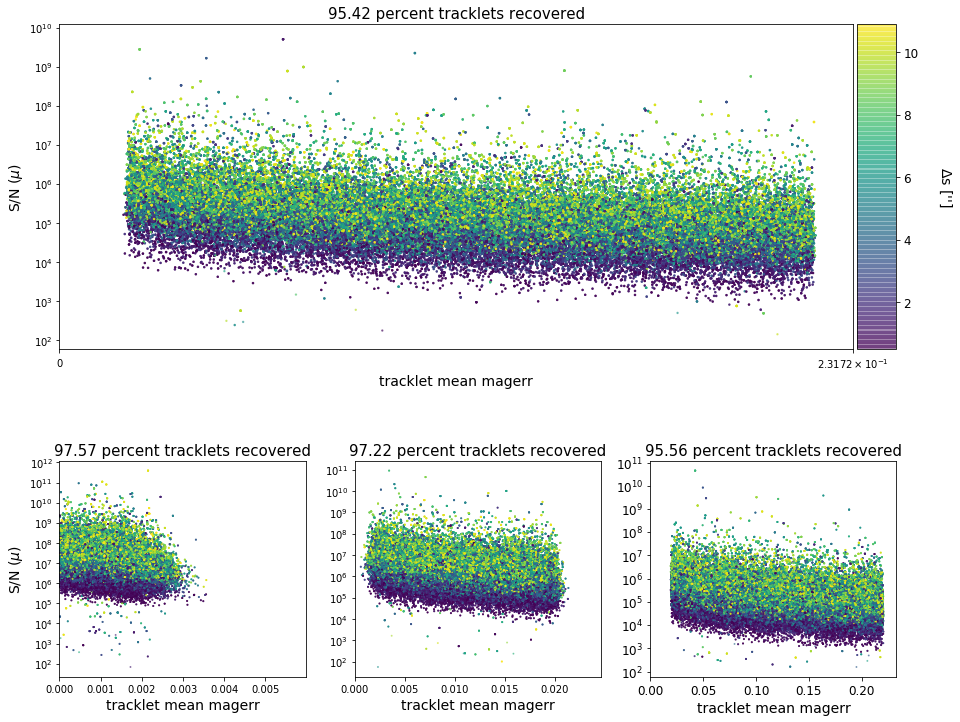

In [4]:
lsize=14
tsize=12

f=plt.figure(figsize=(15,12))
files=["CANFind/sim_mags.fits","CANFind/sim_mags_low.fits","CANFind/sim_mags_med.fits","CANFind/sim_mags_high.fits"]
numbers=[211,337,338,339] #tall,wide,plotnumber
s=[2,1,1,1]
for i in range(0,len(files)):
    all_tracklets=Table.read(files[i])
    t=all_tracklets['d_btw']*3600>=0.5
    t0=all_tracklets[t]['d_btw']*3600<=11
    t1=all_tracklets[t][t0]['cluster_label']!=999999
    t2=all_tracklets[t][t0][t1]['cluster_label']!=-1
    ptitle=round((len(np.unique(all_tracklets[t][t0][t1][t2]['tracklet_id']))/len(np.unique(all_tracklets[t][t0][t1]['tracklet_id'])))*100,2)
    f.add_subplot(numbers[i])
    sa=plt.scatter(abs(all_tracklets[t][t0][t1][t2]['mean_magerr']),abs(all_tracklets[t][t0][t1][t2]['v_out']/all_tracklets[t][t0][t1][t2]['v_btw'])*3600/24,c=all_tracklets[t][t0][t1][t2]['d_btw']*3600,s=s[i],alpha=0.5)
    plt.title("%s percent tracklets recovered"%str(ptitle),fontsize=lsize+1)
    if i==0:
        cbar(sa,title="$\Delta$s ['']",marksize=tsize,titsize=lsize)
        plt.xscale("symlog")
    plt.yscale("symlog")
    plt.xlabel("tracklet mean magerr",fontsize=lsize)
    if i==0 or i==1:
        plt.ylabel("S/N ($\mu$)",fontsize=lsize)
    plt.xlim(left=0)
plt.tick_params(axis="both",labelsize=tsize)
plt.subplots_adjust(hspace=0.01)
plt.show()

The top graph shows tracklet (mean uncertainty in mag_auto) vs (S/N on proper motion $\mu$) for the simulation covering the full range of magerr (0.0002-0.2 with 200,000 tracks).  The bottom three graphs show the same for simulations covering three different error ranges (0.0002-0.002, 0.002-0.02, and 0.02-0.2, all with 100,000 tracks each).  I've added the percentages of these simulations to Section 4 (Efficiency Simulation), <font color="dustyvioletrose">do you think that's enough or should there be some sort of figure?</font>



# II.  Taking a look at tracklets from the galactic plane vs MCs

In [11]:
t_mmts=Table.read("CANFind/gal_mc_test_mmts.fits") #measurements from the tracklets
t_cat=Table.read("CANFind/gal_mc_test_tracklets.fits") #tracklet catalog 
dat_m=Table.read("CANFind/wrupdate_tracklet_cat.fits") #complete tracklet catalog

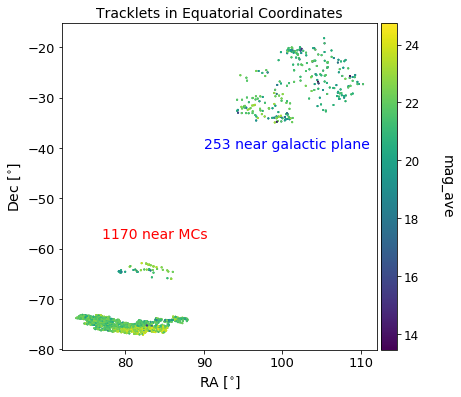

In [12]:
plt.figure(figsize=(6,6))
p1=plt.scatter(t_mmts['ra'],t_mmts['dec'],c=t_mmts['mag_auto'],s=1)
plt.text(x=90,y=-40,s="%i near galactic plane"%len(np.unique(t_cat[t_cat['ra']>90])),fontsize=14,color="blue")
plt.text(x=77,y=-58,s="%i near MCs"%len(np.unique(t_cat[t_cat['ra']<90])),fontsize=14,color="red")
cbar(p1,title="mag_ave",titsize=14,marksize=12)
plt.title("Tracklets in Equatorial Coordinates",fontsize=14)
plt.xlabel("RA [$^{\circ}$]",fontsize=14)
plt.ylabel("Dec [$^{\circ}$]",fontsize=14)
plt.tick_params(axis="both",labelsize=13)
plt.show()

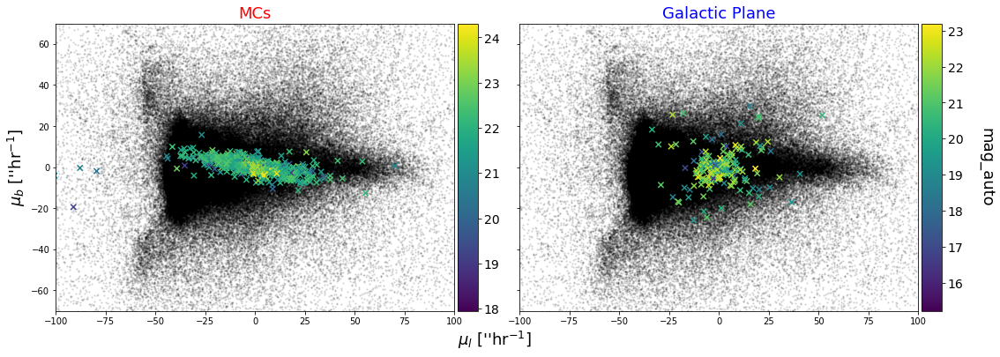

In [13]:
lsize=18
tsize=14

lmct=t_cat[t_cat['ra']<90]
galt=t_cat[t_cat['ra']>90]

f,ax=plt.subplots(1,2,figsize=(18,6),sharey=True,sharex=True)
plt.subplots_adjust(wspace=0.1)
#p1=ax[0].hist2d(lmct['vel']*3600/24,lmct['veb']*3600/24,bins=50,norm=colors.LogNorm())
ax[0].scatter(dat_m['vel']*3600/24,dat_m['veb']*3600/24,c="k",alpha=0.1,s=2)
p1=ax[0].scatter(lmct['vel'],lmct['veb'],c=lmct['mag_auto'],s=40,marker="x")
cbar(p1,marksize=tsize,lpad=0)#[3])
ax[0].set_title("MCs",fontsize=lsize,color="red")
ax[0].set_xlim(-100,100)
ax[0].set_ylim(-70,70)
ax[0].set_ylabel("$\mu_b$ [''hr$^{-1}$]",fontsize=lsize)
ax[0].set_xlabel("$\mu_l$ [''hr$^{-1}$]",x=1.1,fontsize=lsize)
#p2=ax[1].hist2d(galt['vel']*3600/24,galt['veb']*3600/24,bins=50,norm=colors.LogNorm())
ax[1].scatter(dat_m['vel']*3600/24,dat_m['veb']*3600/24,c="k",alpha=0.1,s=2)
p2=ax[1].scatter(galt['vel'],galt['veb'],c=galt['mag_auto'],s=40,marker="x")
cbar(p2,title="mag_auto",titsize=lsize,marksize=tsize)#[3])
ax[1].set_title("Galactic Plane",fontsize=lsize,color="blue")
plt.show()

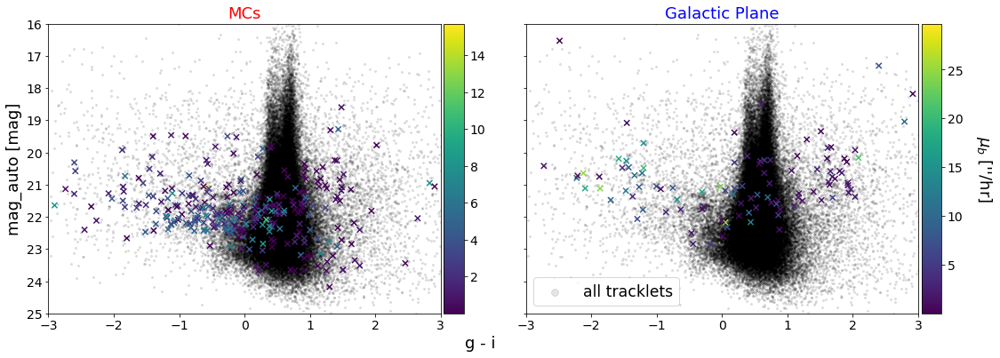

In [14]:
lsize=18
tsize=14

lg=lmct['g']!=-99.99
lr=lmct[lg]['i']!=-99.99

gg=galt['g']!=-99.99
gr=galt[gg]['i']!=-99.99

gs=dat_m['g']!=99.99
iis=dat_m[gs]['i']!=99.99

f,ax=plt.subplots(1,2,figsize=(18,6),sharey=True,sharex=True)
plt.subplots_adjust(wspace=0.15)
ax[0].scatter(dat_m[gs][iis]['g']-dat_m[gs][iis]['i'],dat_m[gs][iis]['mag'],s=4,c="k",alpha=0.1)
p1=ax[0].scatter(lmct[lg][lr]['g']-lmct[lg][lr]['i'],lmct[lg][lr]['mag_auto'],c=abs(lmct[lg][lr]['veb']),s=40,marker="x")
cbar(p1,marksize=tsize,lpad=0)
ax[0].set_ylabel("mag_auto [mag]",fontsize=lsize)
ax[0].set_xlabel("g - i",x=1.1,fontsize=lsize)
ax[0].set_title("MCs",fontsize=lsize,color="red")
ax[0].tick_params(axis="both",labelsize=tsize)
ax[0].set_ylim(25,16)
ax[0].set_xlim(-3,3)
ax[1].scatter(dat_m[gs][iis]['g']-dat_m[gs][iis]['i'],dat_m[gs][iis]['mag'],s=4,c="k",alpha=0.1,label="all tracklets")
p2=ax[1].scatter(galt[gg][gr]['g']-galt[gg][gr]['i'],galt[gg][gr]['mag_auto'],c=abs(galt[gg][gr]['veb']),s=40,marker="x")
cbar(p2,title="$\mu_{b}$ [''/hr]",titsize=lsize,marksize=tsize)
ax[1].set_title("Galactic Plane",fontsize=lsize,color="blue")
ax[1].tick_params(axis="both",labelsize=tsize)
ax[1].legend(fontsize="xx-large",loc="lower left",markerscale=4)
plt.show()

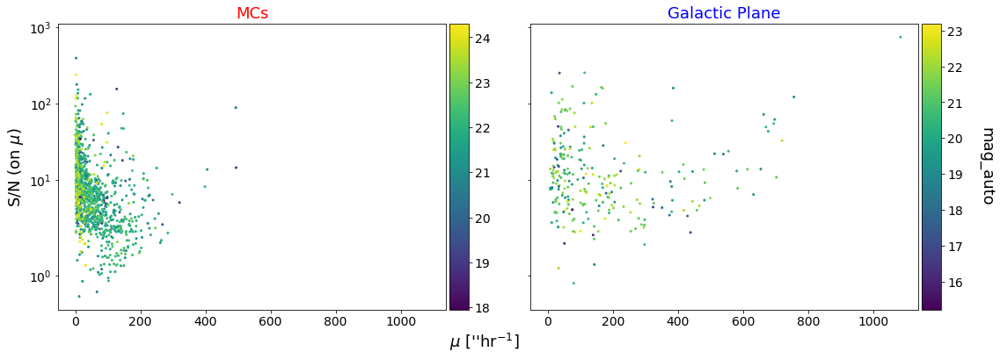

In [15]:
lsize=18
tsize=14

f,ax=plt.subplots(1,2,figsize=(18,6),sharey=True,sharex=True)
plt.subplots_adjust(wspace=0.15)
p1=ax[0].scatter(lmct['pm_tot'],abs(lmct['pm_tot']/lmct['pmerr']),c=lmct['mag_auto'],s=4)
cbar(p1,marksize=tsize,lpad=0)
ax[0].set_ylabel("S/N (on $\mu$)",fontsize=lsize)
ax[0].set_xlabel("$\mu$ [''hr$^{-1}$]",x=1.1,fontsize=lsize)
ax[0].set_title("MCs",fontsize=lsize,color="red")
ax[0].tick_params(axis="both",labelsize=tsize)
ax[0].set_yscale("symlog")
#ax[0].set_xlim(-10,600)
#ax[0].set_ylim(25,16)
#ax[0].set_xlim(-3,3)
p2=ax[1].scatter(galt['pm_tot'],abs(galt['pm_tot']/galt['pmerr']),c=galt['mag_auto'],s=4)
cbar(p2,title="mag_auto",titsize=lsize,marksize=tsize)
ax[1].set_title("Galactic Plane",fontsize=lsize,color="blue")
ax[1].tick_params(axis="both",labelsize=tsize)
plt.show()

### This looks terrible, but here are many plots of the tracklet measurements

The very long list of graphs below show the spacial distribution of tracklet measurements found either near the galactic plane or near the MCs.  Proper motion ("v_ra","v_dec") is printed above each plot in ''/hr.  

v_ra =  -97.61320444447541 , v_dec =  23.43939888207693


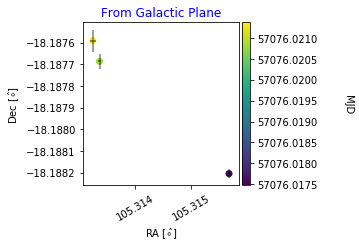

v_ra =  -503.01563290498297 , v_dec =  -306.9196112660383


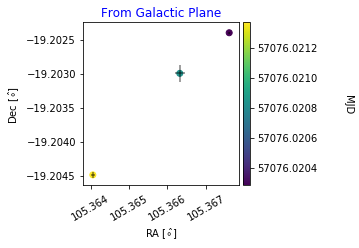

v_ra =  197.56826038486588 , v_dec =  206.07862372758828


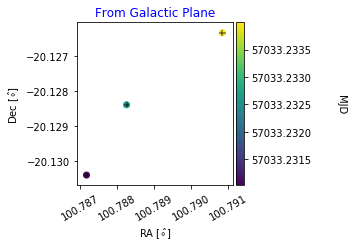

v_ra =  -45.313415252963985 , v_dec =  7.333279529881512


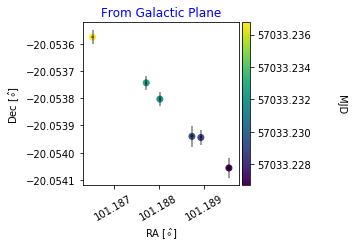

v_ra =  -88.60724586160109 , v_dec =  -17.542416936352886


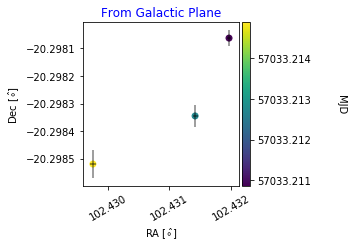

v_ra =  -59.65633283042461 , v_dec =  38.30224324053194


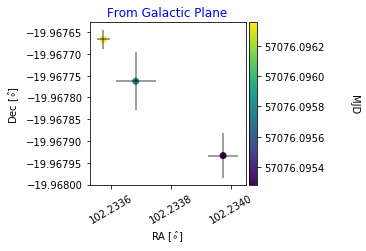

v_ra =  -177.3327771208519 , v_dec =  288.78662723196067


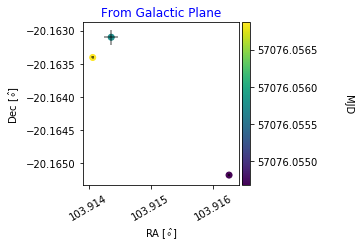

v_ra =  -36.10571761992539 , v_dec =  34.264216563818856


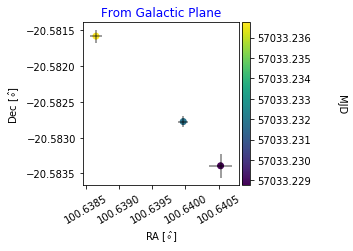

v_ra =  221.62667941640223 , v_dec =  -76.04471004348831


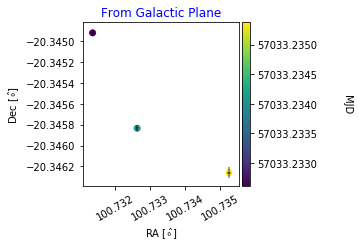

v_ra =  287.0879267293663 , v_dec =  -277.0212925940915


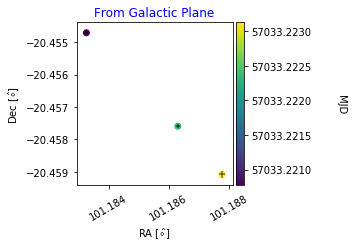

v_ra =  55.121201280021154 , v_dec =  11.613338207194756


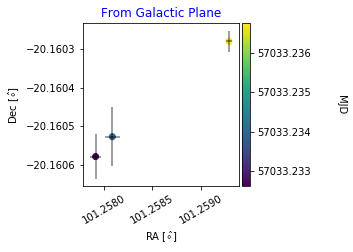

v_ra =  83.6556457262614 , v_dec =  -25.546962196048213


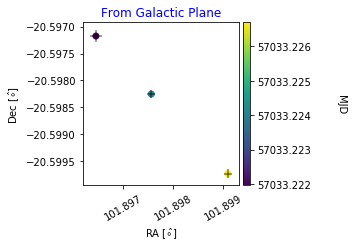

v_ra =  -24.37279941299235 , v_dec =  78.13294320192615


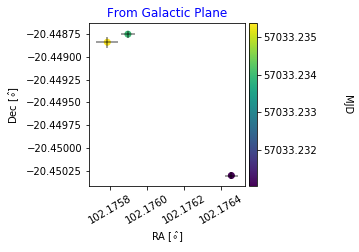

v_ra =  84.67481636223872 , v_dec =  -75.39136438233076


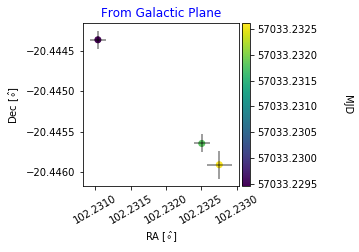

v_ra =  14.949387299026549 , v_dec =  -13.480350626692223


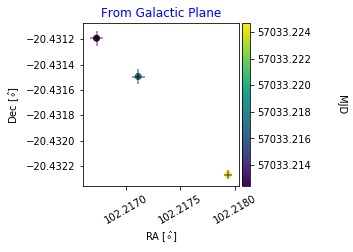

v_ra =  -591.1481288022594 , v_dec =  -156.71386902611303


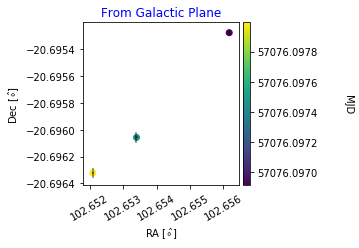

v_ra =  -336.1332335525457 , v_dec =  -585.8833951601154


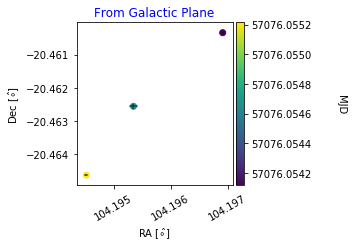

v_ra =  -277.85454173624527 , v_dec =  116.73341682605822


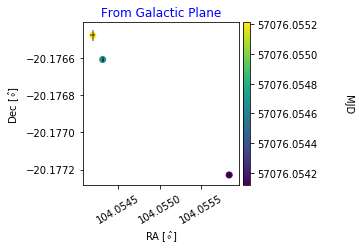

v_ra =  -99.59299177682469 , v_dec =  43.78132007982533


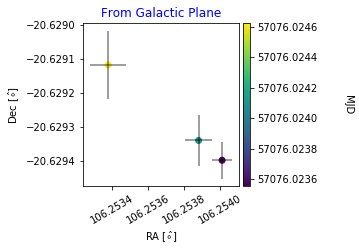

v_ra =  1023.0676938526399 , v_dec =  509.04822033064085


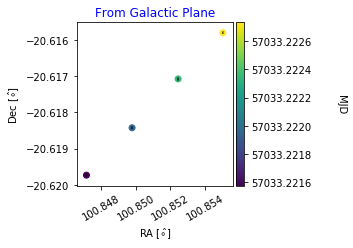

v_ra =  178.71225810669213 , v_dec =  0.6100127135221977


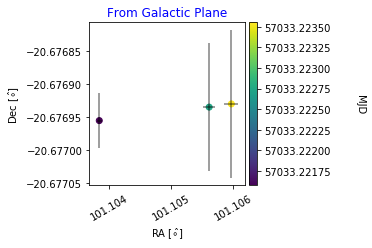

v_ra =  -52.13146436812986 , v_dec =  3.89346094874733


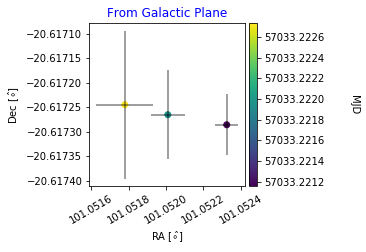

v_ra =  -33.46536307769377 , v_dec =  372.6334587711486


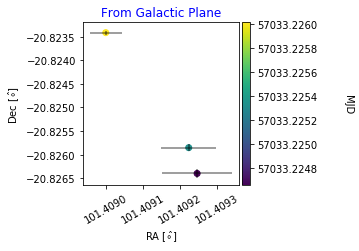

v_ra =  -91.27925520609092 , v_dec =  -5.343157527372788


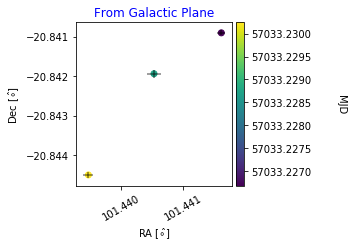

v_ra =  -20.66517747934997 , v_dec =  -28.15663677011813


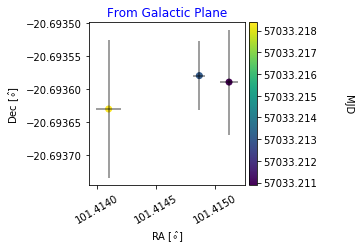

v_ra =  -39.30085837695964 , v_dec =  35.23719108415953


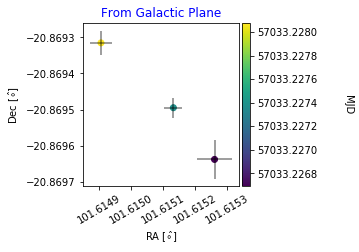

v_ra =  133.15674354957497 , v_dec =  -43.915771626050706


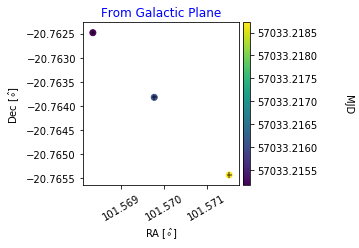

v_ra =  -36.76579281603399 , v_dec =  9.748823459459112


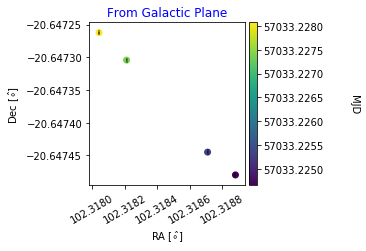

v_ra =  289.0276382975495 , v_dec =  121.40213878459791


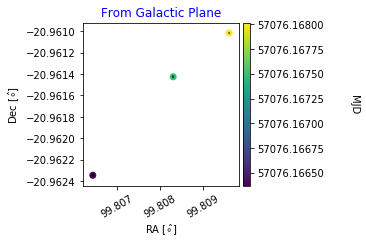

v_ra =  -53.21413976549087 , v_dec =  398.32022359466964


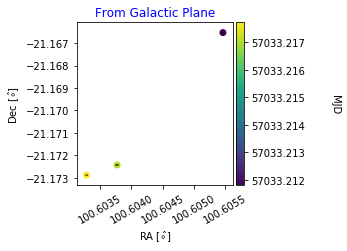

v_ra =  149.83878332957633 , v_dec =  -48.63933311168381


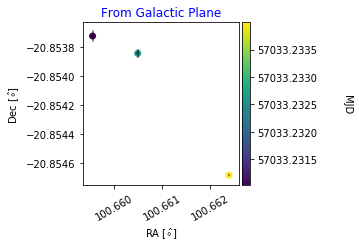

v_ra =  -4.3240073669638575 , v_dec =  10.695826119802675


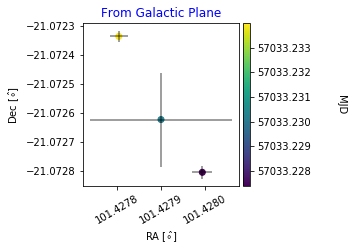

v_ra =  -11.606362329494338 , v_dec =  12.762514933591035


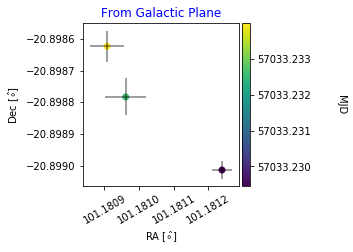

v_ra =  -79.10480778057878 , v_dec =  73.53977477410837


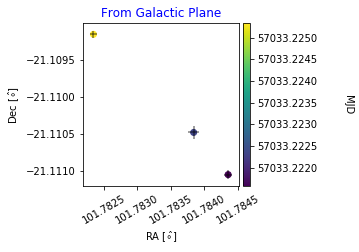

v_ra =  24.104987141794705 , v_dec =  -193.25953626612196


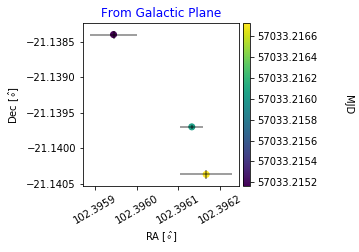

v_ra =  17.39191246157543 , v_dec =  48.75996587813617


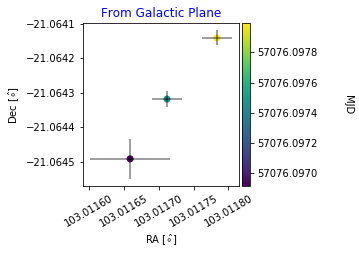

v_ra =  69.33449171645076 , v_dec =  82.82449115068212


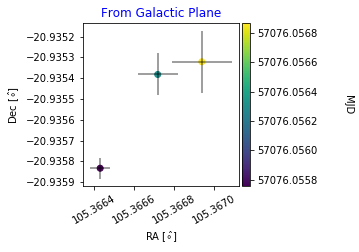

v_ra =  32.816301359043315 , v_dec =  12.559030142941282


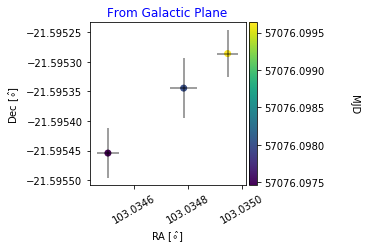

v_ra =  62.1567491560522 , v_dec =  103.84311025745428


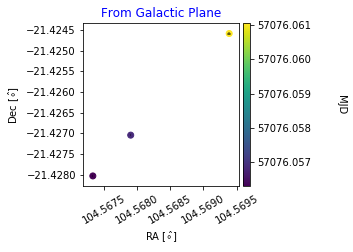

v_ra =  27.182615146713335 , v_dec =  43.19820217322208


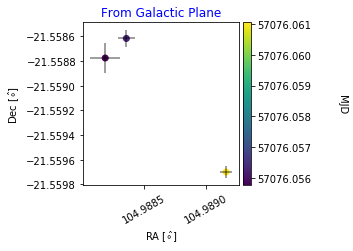

v_ra =  -41.19582075109331 , v_dec =  21.74889320753118


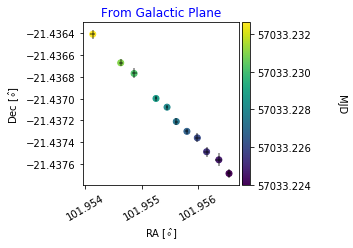

v_ra =  226.32254204731885 , v_dec =  -482.22021652705615


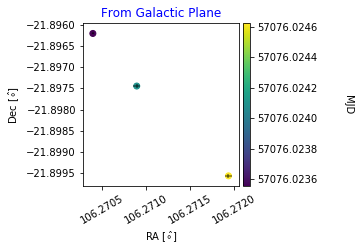

v_ra =  43.76527356183505 , v_dec =  34.722124602759195


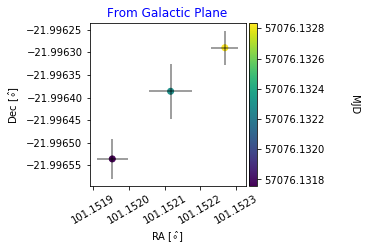

v_ra =  34.70656384625435 , v_dec =  -33.23075546573551


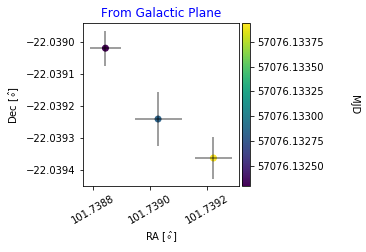

v_ra =  436.62014302427116 , v_dec =  536.915854762102


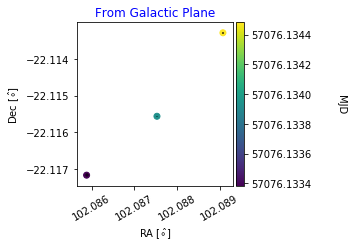

v_ra =  39.42508909962343 , v_dec =  -14.02662509931121


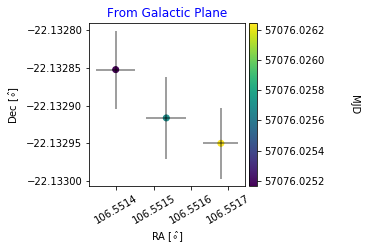

v_ra =  519.4231158096783 , v_dec =  135.88032430385178


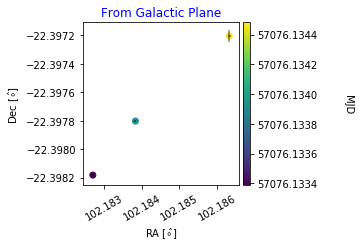

v_ra =  -95.96867013247578 , v_dec =  190.87498969652998


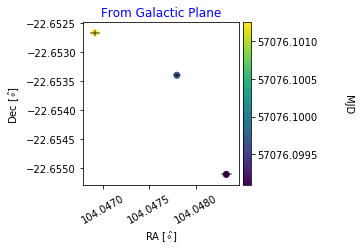

v_ra =  55.553784898862226 , v_dec =  -37.23673063946858


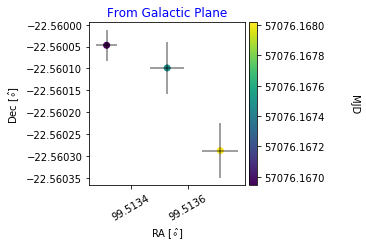

v_ra =  401.25750369207975 , v_dec =  271.2933925420087


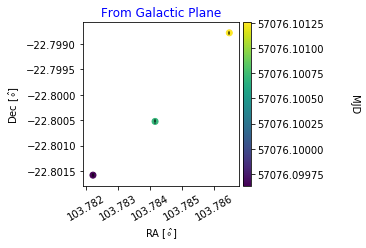

v_ra =  -142.35146703829977 , v_dec =  197.19754575438833


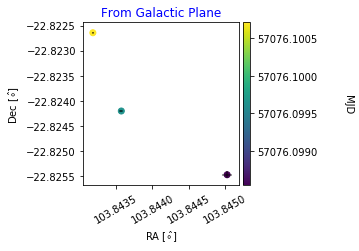

v_ra =  -11.003669443655264 , v_dec =  -26.401289236991364


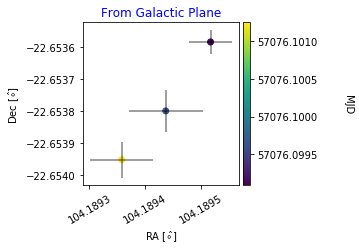

v_ra =  154.93108751872143 , v_dec =  43.8933145628342


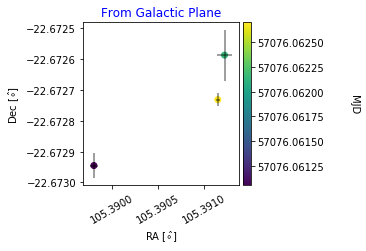

v_ra =  511.6349155758741 , v_dec =  230.3644494416191


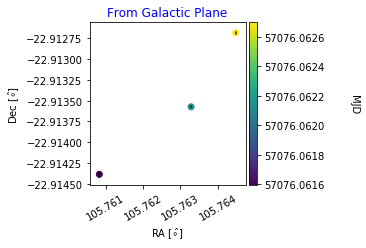

v_ra =  63.29767875303119 , v_dec =  28.964885908702403


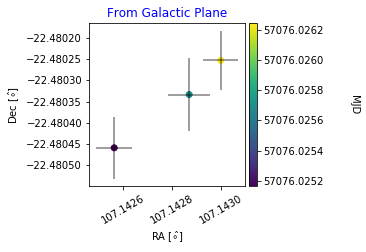

v_ra =  -42.25020927660468 , v_dec =  10.92076239006198


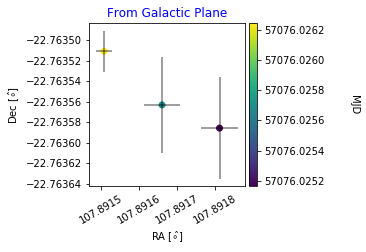

v_ra =  423.6602161763685 , v_dec =  -310.2236948438016


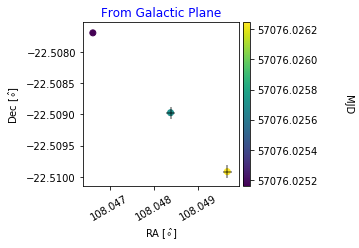

v_ra =  461.6547896635478 , v_dec =  140.11094478293163


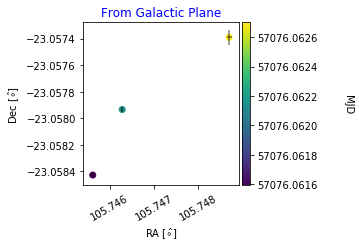

v_ra =  87.87836718795887 , v_dec =  331.8510537261307


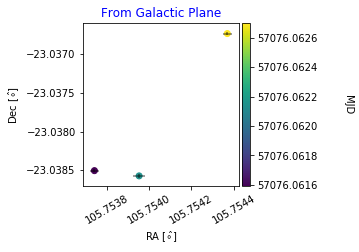

v_ra =  -396.3088956195009 , v_dec =  -305.7341402331179


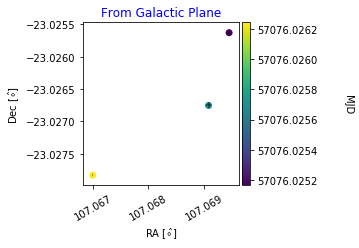

v_ra =  -8.248733006458487 , v_dec =  23.02024261661242


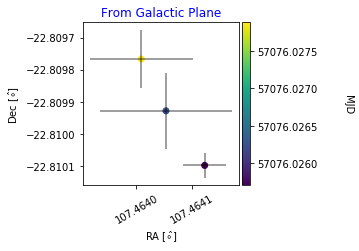

v_ra =  424.32062095250086 , v_dec =  184.01527294976222


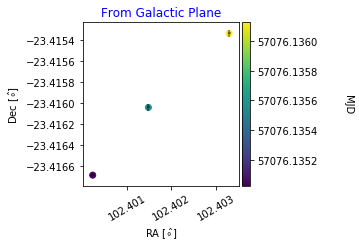

v_ra =  5.677998704791634 , v_dec =  61.35929345437075


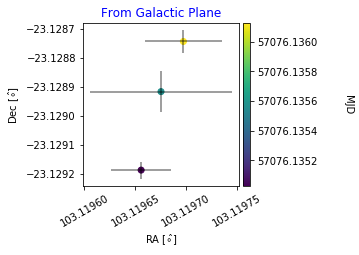

v_ra =  -41.73945166822872 , v_dec =  -58.85792789418013


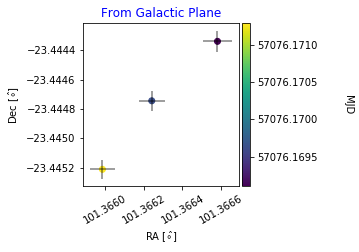

v_ra =  -122.84036985199293 , v_dec =  -246.4687709759871


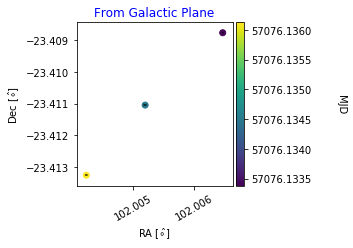

v_ra =  247.2600701164495 , v_dec =  192.67755727022075


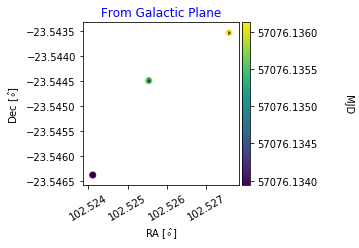

v_ra =  -212.18408496940597 , v_dec =  -57.230412389667784


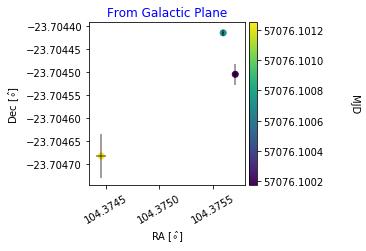

v_ra =  454.05870458298926 , v_dec =  273.3653580254716


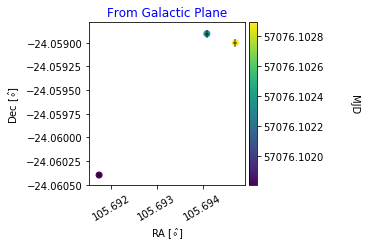

v_ra =  -174.0319761951566 , v_dec =  50.308643000063064


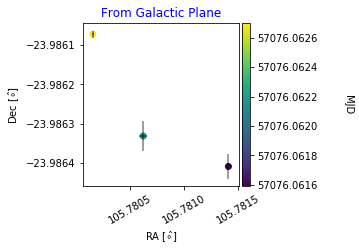

v_ra =  290.71248930089934 , v_dec =  188.6130095205589


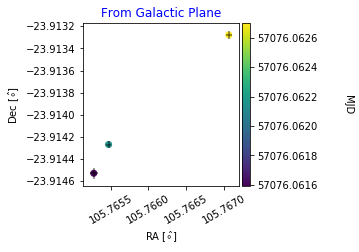

v_ra =  -66.96353634776565 , v_dec =  24.27367656167902


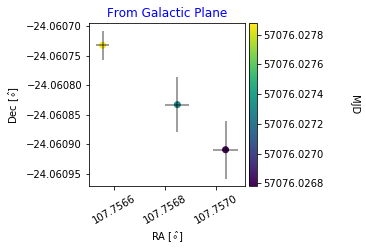

v_ra =  -507.1147244571951 , v_dec =  334.68709006104365


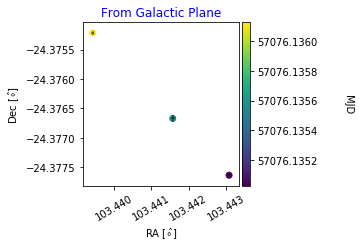

v_ra =  -181.47237768368947 , v_dec =  353.014379730319


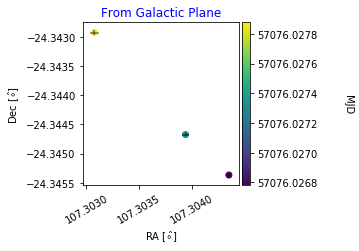

v_ra =  66.87918478391924 , v_dec =  -247.00031049344219


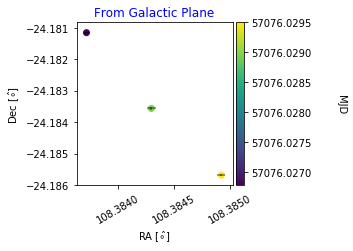

v_ra =  -154.30513212296628 , v_dec =  -126.52531729635666


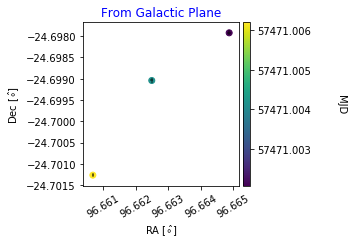

v_ra =  26.513731170636806 , v_dec =  21.04491374860808


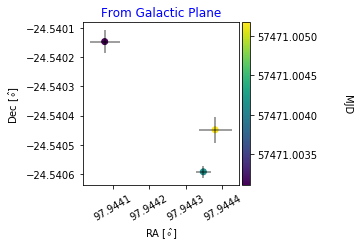

v_ra =  96.8552472016165 , v_dec =  138.51886434502595


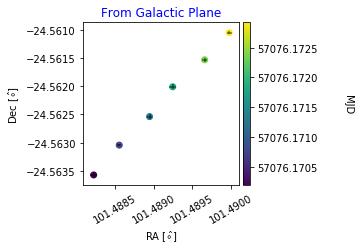

v_ra =  -201.17391928628692 , v_dec =  -200.86333616200002


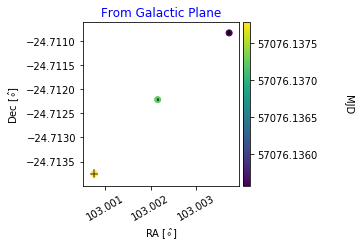

v_ra =  -391.6803589249009 , v_dec =  -373.74174807524804


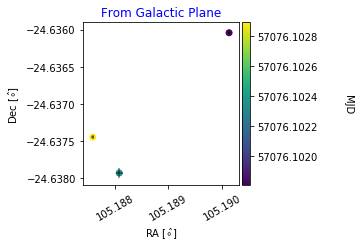

v_ra =  -14.899466605077345 , v_dec =  27.72428422228583


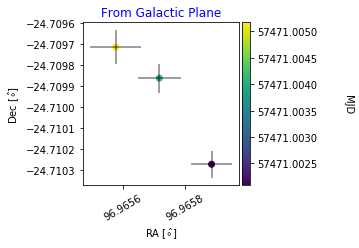

v_ra =  -53.10165779758167 , v_dec =  463.149250084183


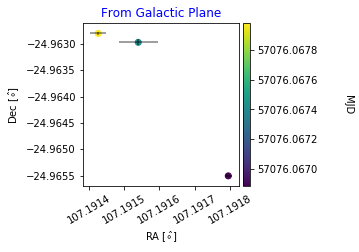

v_ra =  -44.88763814881829 , v_dec =  -59.09653196820591


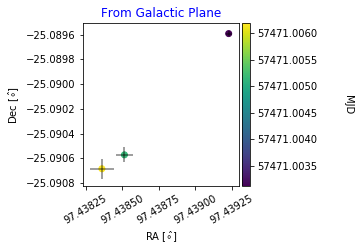

v_ra =  -317.91851822169735 , v_dec =  13.327552408424273


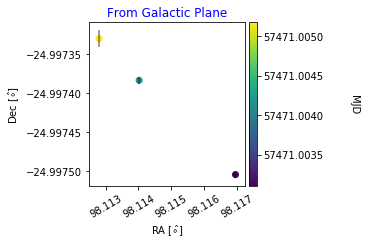

v_ra =  4.527253503580707 , v_dec =  40.150872183648744


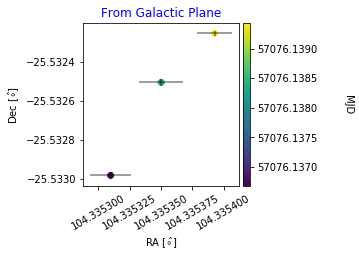

v_ra =  92.66680510584689 , v_dec =  519.1106999385745


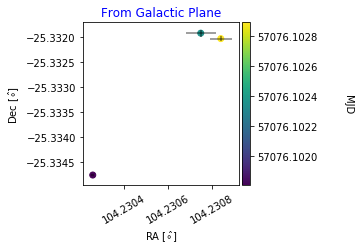

v_ra =  24.21999772541732 , v_dec =  -23.79810223768237


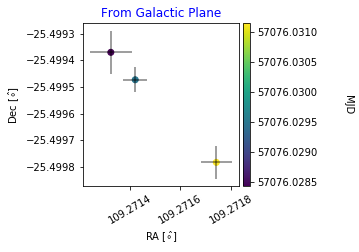

v_ra =  -33.89723287313853 , v_dec =  31.196813415165554


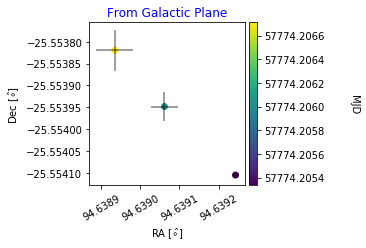

v_ra =  45.9084927221971 , v_dec =  -47.853782361683535


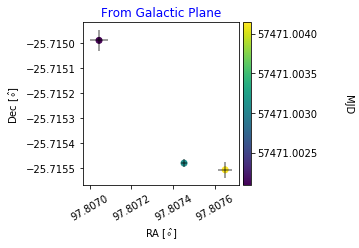

v_ra =  -26.402361308653244 , v_dec =  43.33513578231095


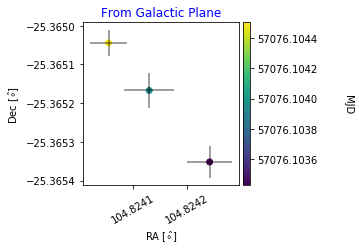

v_ra =  316.3498424498368 , v_dec =  -389.7544791229766


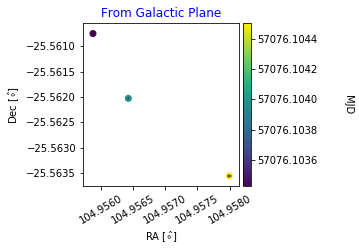

v_ra =  -28.737593613848446 , v_dec =  11.636262892386481


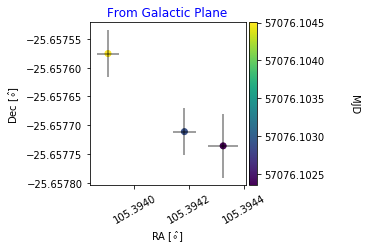

v_ra =  523.6580918810713 , v_dec =  -196.1113887584015


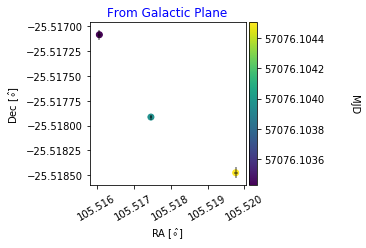

v_ra =  414.05512515581023 , v_dec =  657.2453036304768


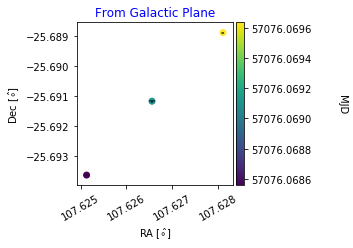

v_ra =  -44.849110826971504 , v_dec =  -4.92098849462239


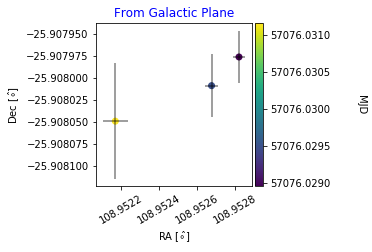

v_ra =  -178.79124584303733 , v_dec =  -115.10819145551385


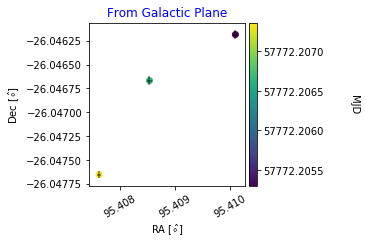

v_ra =  -36.30267372281584 , v_dec =  9.653351534563816


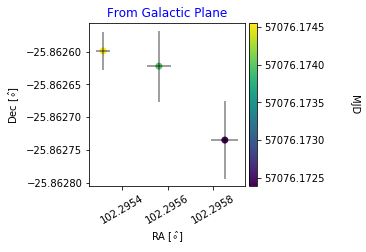

v_ra =  -151.84360879927928 , v_dec =  -202.0928456609149


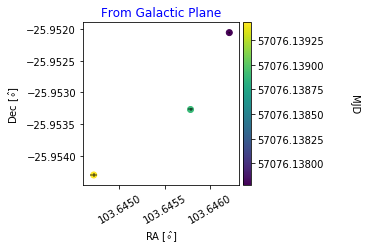

v_ra =  260.568441956456 , v_dec =  217.17167622368456


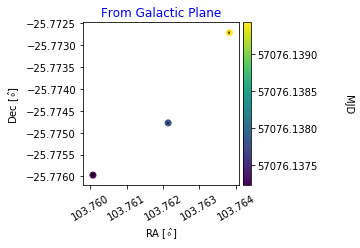

v_ra =  -91.04360856988166 , v_dec =  -489.46635694686285


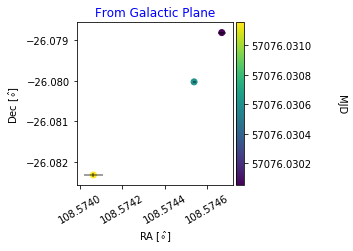

v_ra =  -105.72306838434262 , v_dec =  -120.39092291308833


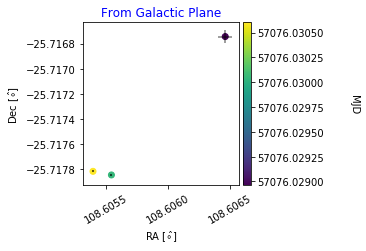

v_ra =  82.1448854427985 , v_dec =  228.25089121425944


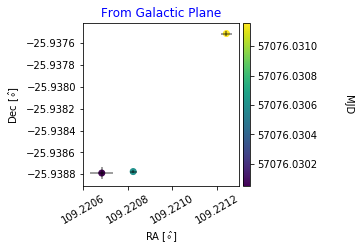

v_ra =  -299.65330425883843 , v_dec =  671.1551927080926


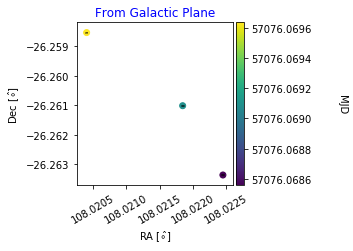

v_ra =  -178.50918931507292 , v_dec =  -107.39076549104152


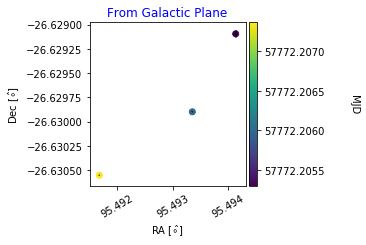

v_ra =  130.34742030883544 , v_dec =  121.36588800218796


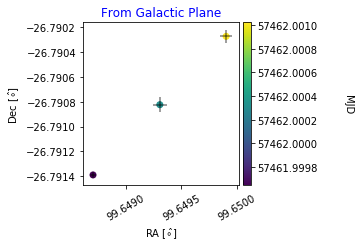

v_ra =  -221.55899517396256 , v_dec =  663.2458478731389


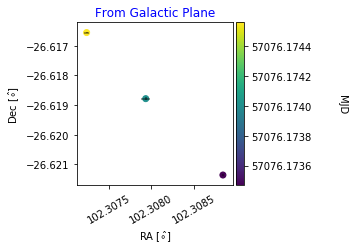

v_ra =  271.41435314965946 , v_dec =  330.0040025140874


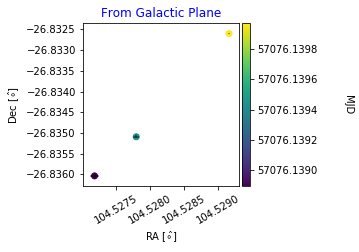

v_ra =  -229.29911289044307 , v_dec =  -497.52426385652865


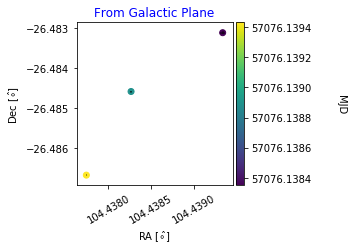

v_ra =  -10.922018635788191 , v_dec =  28.232560970689633


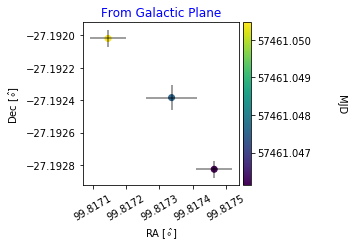

v_ra =  66.17235024613346 , v_dec =  16.97669114927934


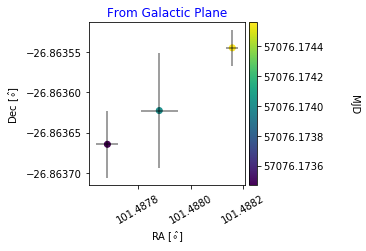

v_ra =  5.032090106086301 , v_dec =  -11.032965781280474


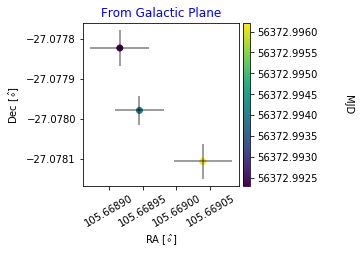

v_ra =  447.56855648060144 , v_dec =  537.4084174116615


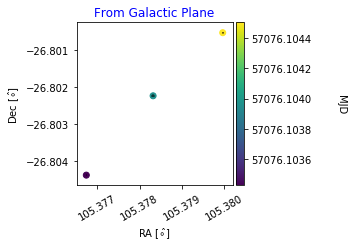

v_ra =  -213.62982375454268 , v_dec =  -315.0854078942516


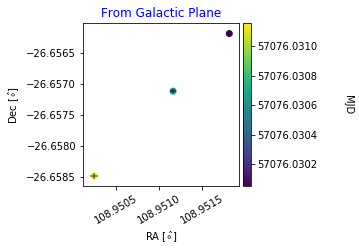

v_ra =  4.540307700956819 , v_dec =  23.6626181995715


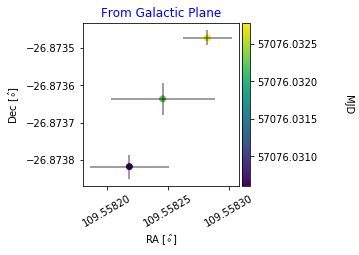

v_ra =  -423.342666836056 , v_dec =  -386.9490553327776


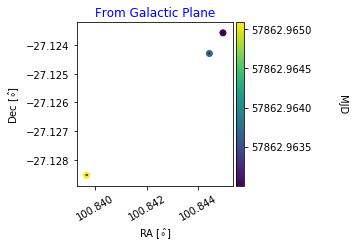

v_ra =  211.05715118280946 , v_dec =  -333.5136138531805


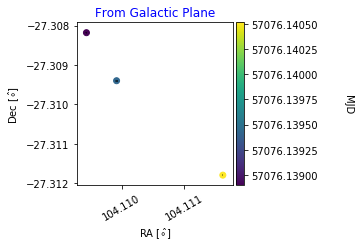

v_ra =  131.0744447335346 , v_dec =  18.70775456528623


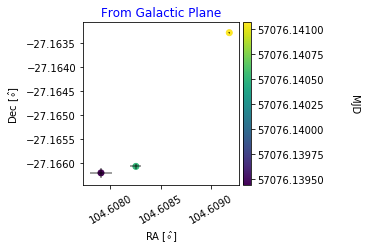

v_ra =  244.1616165671248 , v_dec =  -288.3668384789446


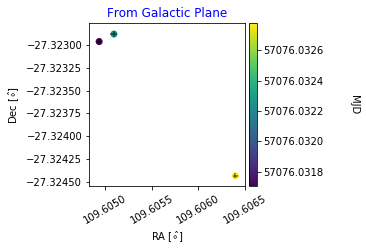

v_ra =  -188.14217090751666 , v_dec =  -128.8570543689022


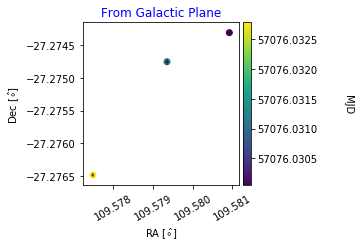

v_ra =  -55.10483740563479 , v_dec =  5.034729246952374


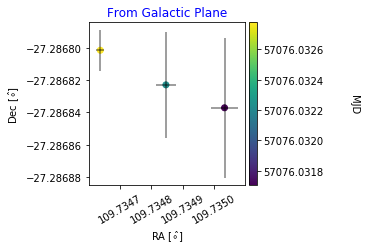

v_ra =  696.7004843829054 , v_dec =  -229.79674098753424


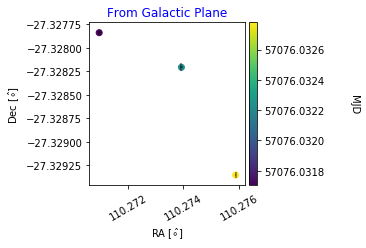

v_ra =  -294.39094335674577 , v_dec =  -247.32118899024388


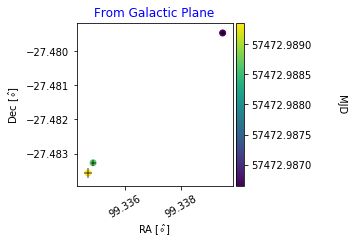

v_ra =  -146.14315096927967 , v_dec =  -32.565443659650796


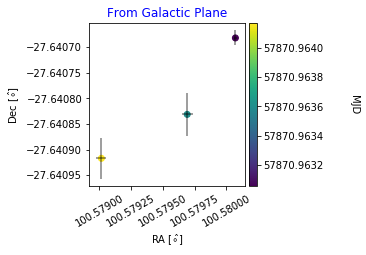

v_ra =  -52.724442373908936 , v_dec =  11.273669766944522


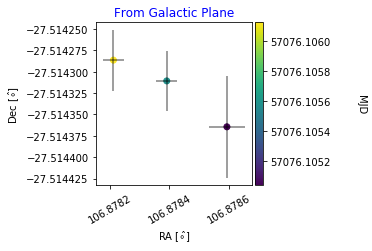

v_ra =  4.974802957734035 , v_dec =  66.71402737269985


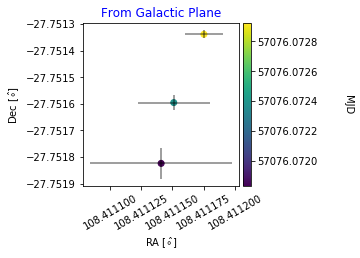

v_ra =  -95.17079916728336 , v_dec =  -173.68034285811675


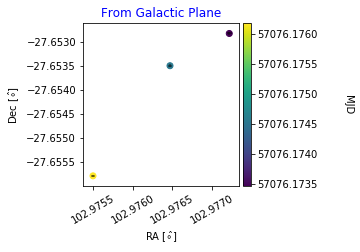

v_ra =  -15.751245208675138 , v_dec =  38.261515710257115


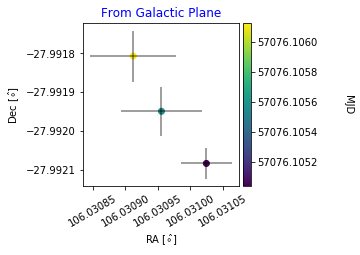

v_ra =  -25.80466967742731 , v_dec =  10.719354212483289


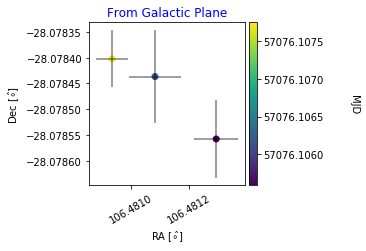

v_ra =  165.7664218653484 , v_dec =  -61.93866642919064


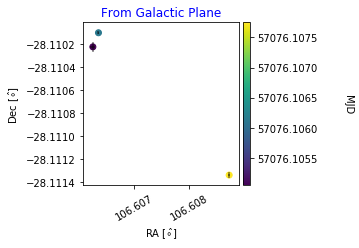

v_ra =  -69.77572989833065 , v_dec =  152.07759716630787


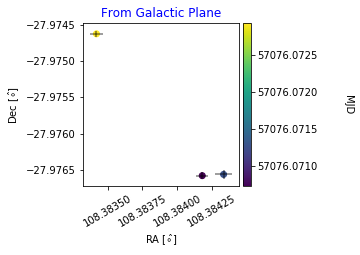

v_ra =  51.550458297129325 , v_dec =  -105.04172209649875


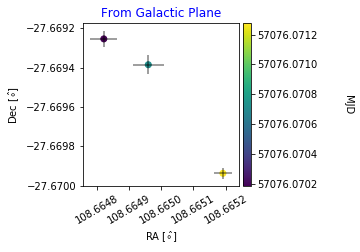

v_ra =  -239.04462545251872 , v_dec =  -568.4394599541165


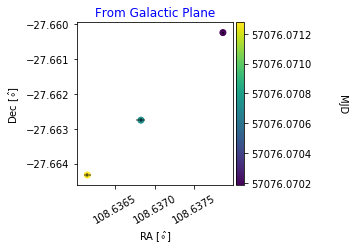

v_ra =  91.38848246205299 , v_dec =  -70.53952000430634


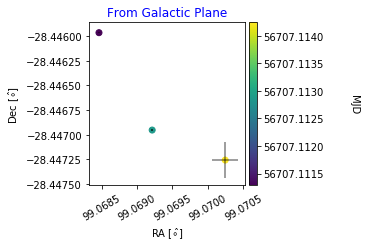

v_ra =  108.62269349365374 , v_dec =  -267.74116649138864


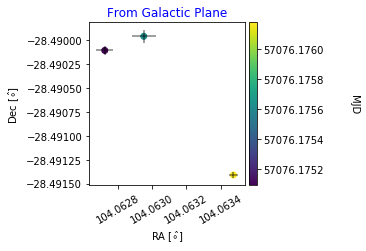

v_ra =  32.87563373538639 , v_dec =  34.775034277148926


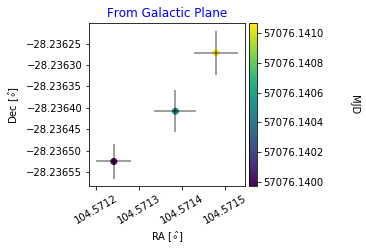

v_ra =  -492.5597452673594 , v_dec =  534.5008063548067


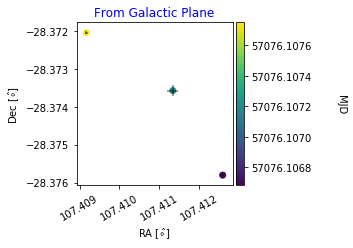

v_ra =  -391.64256060618345 , v_dec =  299.0217261753226


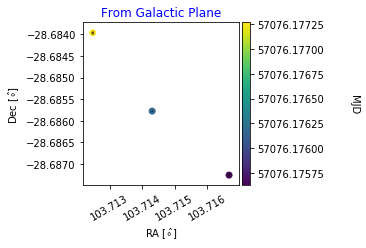

v_ra =  569.3407720955437 , v_dec =  -405.2096845409492


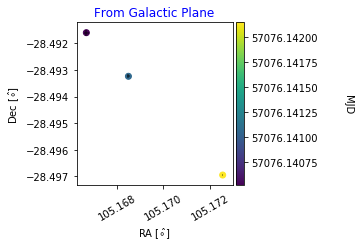

v_ra =  -146.2639351498498 , v_dec =  103.04187061719112


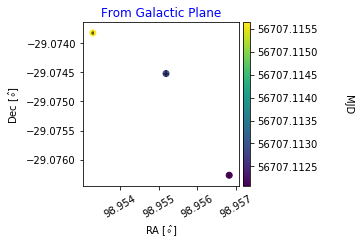

v_ra =  341.71807067689906 , v_dec =  -370.66500093801795


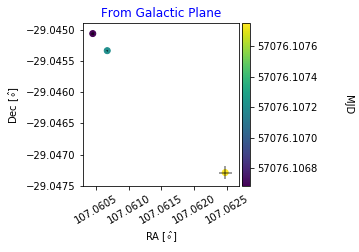

v_ra =  76.39792806212405 , v_dec =  -87.79799871843225


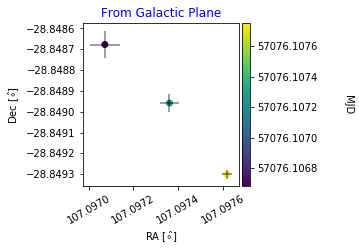

v_ra =  61.78297875815553 , v_dec =  41.39878014329744


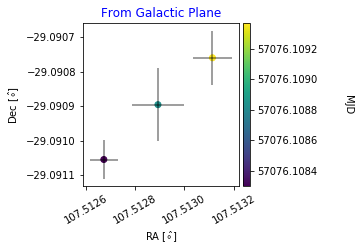

v_ra =  -159.77290764188237 , v_dec =  -139.18074965981344


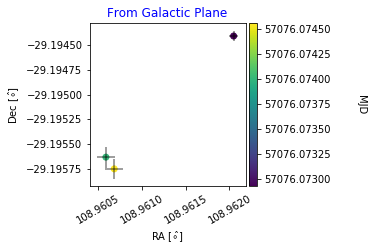

v_ra =  -159.1714608946154 , v_dec =  -18.818039965164157


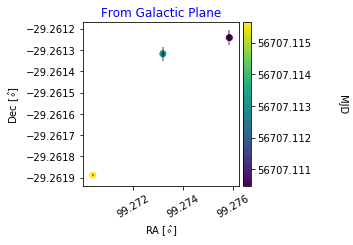

v_ra =  -103.3039493983242 , v_dec =  -112.18157993596624


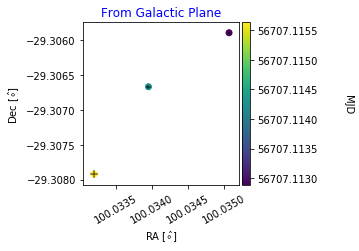

v_ra =  138.4004375212135 , v_dec =  -361.6991255073169


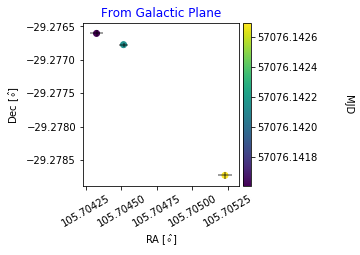

v_ra =  374.2945756852436 , v_dec =  -408.94770154148824


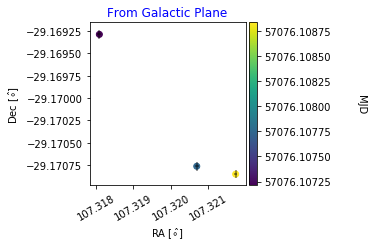

v_ra =  104.91490307493764 , v_dec =  -180.86329008795187


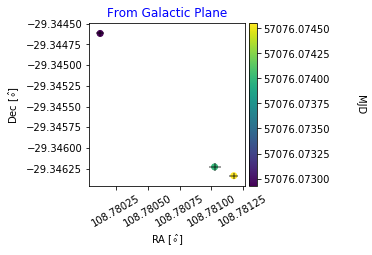

v_ra =  -31.161691054148207 , v_dec =  -7.879391402500829


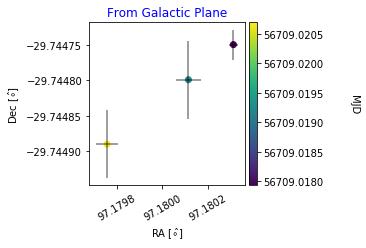

v_ra =  98.57507452426535 , v_dec =  -187.10814874428613


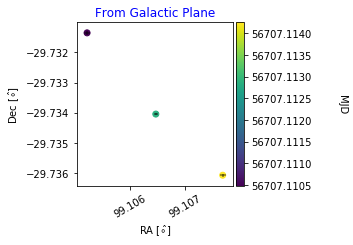

v_ra =  -98.20440039866116 , v_dec =  95.18512622315001


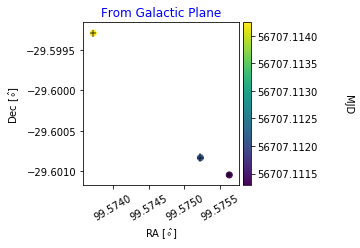

v_ra =  -39.58160750671832 , v_dec =  110.93624701555463


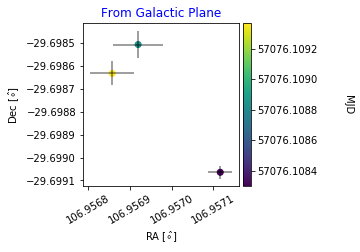

v_ra =  81.11885983583512 , v_dec =  21.0420758877866


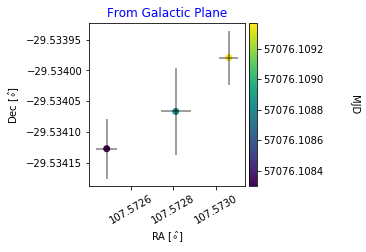

v_ra =  -4.925392451296479 , v_dec =  49.30647730058513


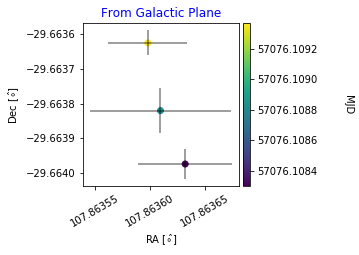

v_ra =  27.48969759525477 , v_dec =  -33.9434745009006


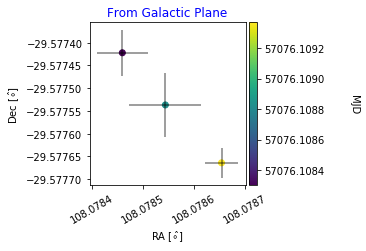

v_ra =  92.62425700568623 , v_dec =  -314.30647821305905


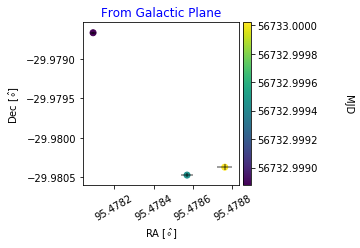

v_ra =  -23.83538833104748 , v_dec =  -1.8329760092433045


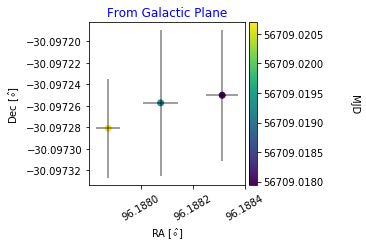

v_ra =  6.89464806594354 , v_dec =  -22.523609076942137


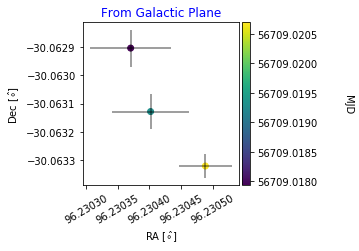

v_ra =  -135.23305978820596 , v_dec =  -134.40962659220057


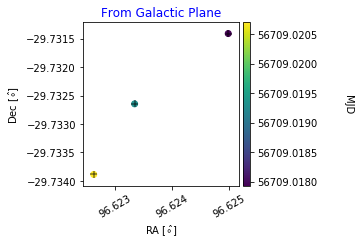

v_ra =  77.38649926333035 , v_dec =  70.7056536281684


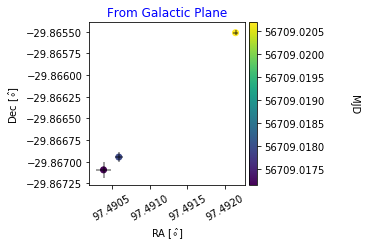

v_ra =  -72.03580975506055 , v_dec =  -91.64556112285076


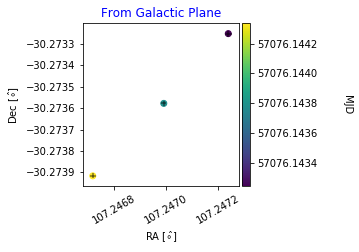

v_ra =  -73.68302230133386 , v_dec =  -79.98266094757936


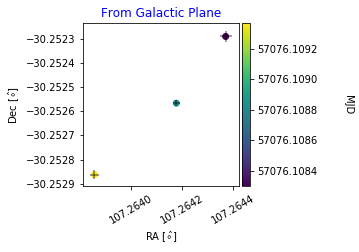

v_ra =  -313.7528227021801 , v_dec =  326.38265958591427


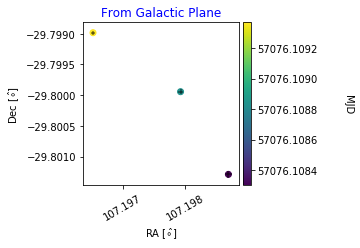

v_ra =  42.33036822442646 , v_dec =  10.507774961679532


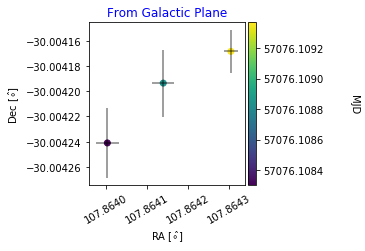

v_ra =  31.51963416331475 , v_dec =  19.84695416518635


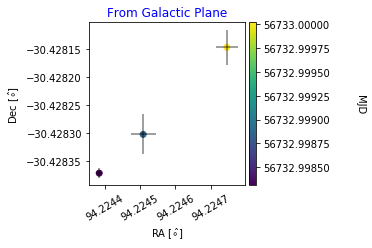

v_ra =  58.18862350686715 , v_dec =  31.622835082272207


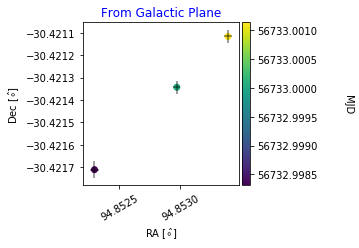

v_ra =  -75.60963393740292 , v_dec =  20.872491018233188


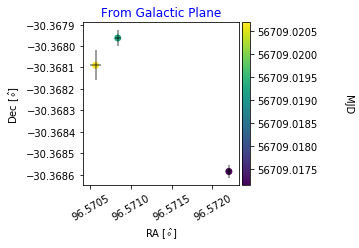

v_ra =  -18.90764155839664 , v_dec =  12.977591581613899


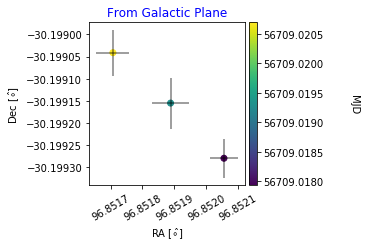

v_ra =  -17.672924112694602 , v_dec =  1.5456743504561015


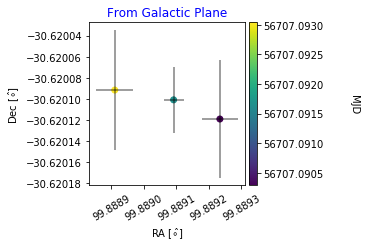

v_ra =  -202.53455843228048 , v_dec =  -20.3217245135779


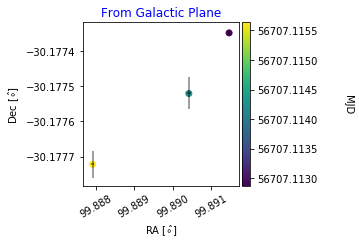

v_ra =  -35.40797296407943 , v_dec =  -25.900565850447496


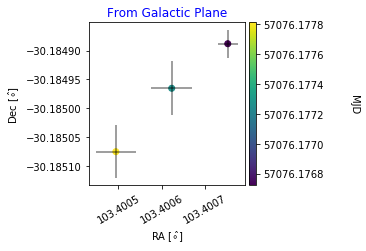

v_ra =  44.41781669706689 , v_dec =  -87.71730025496304


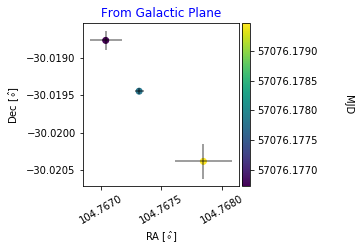

v_ra =  189.8212502980072 , v_dec =  -39.43572766205482


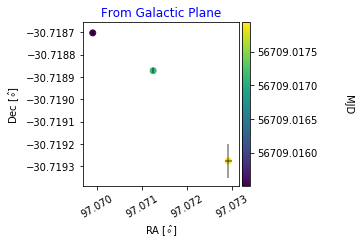

v_ra =  -126.73920140578208 , v_dec =  51.82304555343251


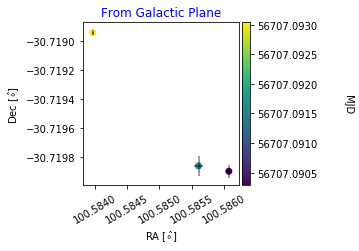

v_ra =  -444.9876783465191 , v_dec =  -334.33415475489676


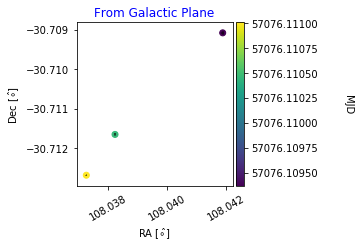

v_ra =  -23.52052960205646 , v_dec =  -122.60677786526641


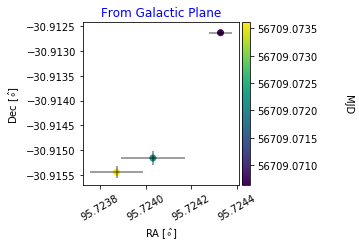

v_ra =  -22.36590874274722 , v_dec =  -565.6128564012466


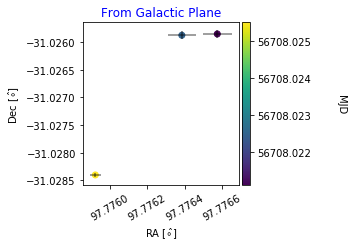

v_ra =  -238.02339629097378 , v_dec =  -194.4833830254307


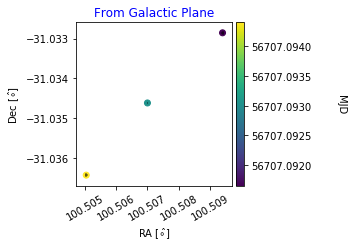

v_ra =  -95.46421357613156 , v_dec =  -8.976370654518549


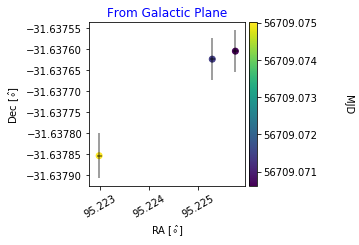

v_ra =  127.3823089578827 , v_dec =  159.6283267168782


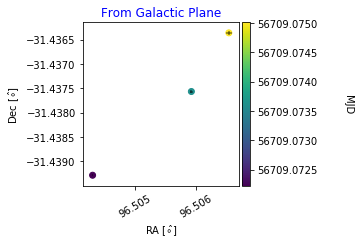

v_ra =  -141.5322641105498 , v_dec =  41.690657368774296


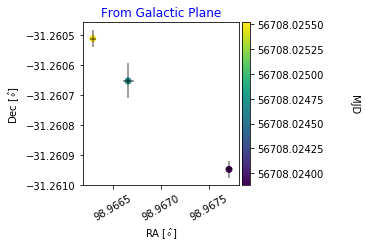

v_ra =  -7.449727601424397 , v_dec =  27.69245675152963


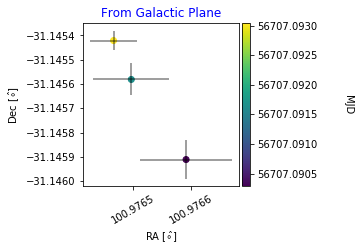

v_ra =  -32.079172456643754 , v_dec =  -45.88454881998877


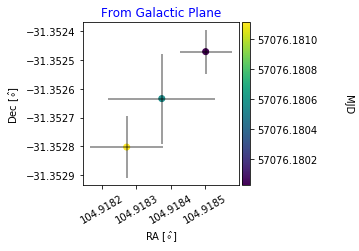

v_ra =  64.94828009318343 , v_dec =  57.972887411057734


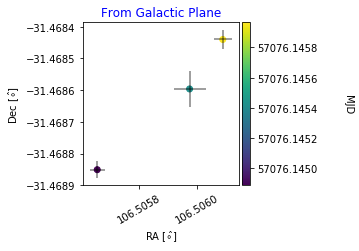

v_ra =  -74.28817070095727 , v_dec =  20.8243439020112


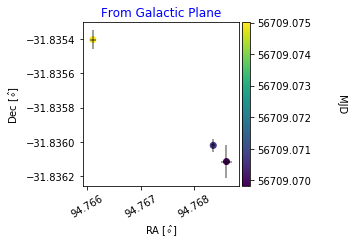

v_ra =  -8.68044809623237 , v_dec =  -124.988270670608


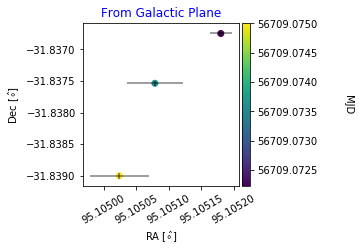

v_ra =  15.130801103139127 , v_dec =  50.5837004483098


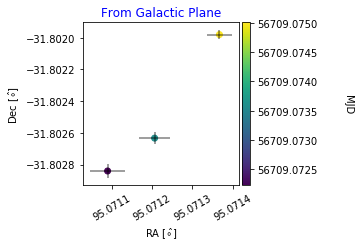

v_ra =  -146.5142001497037 , v_dec =  23.795635728475407


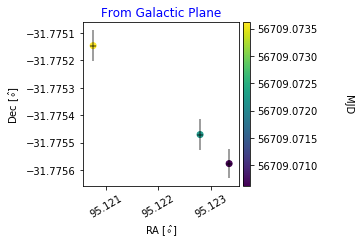

v_ra =  -189.30326236602266 , v_dec =  -110.24183207066481


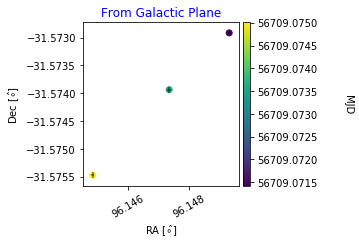

v_ra =  -211.80755007307403 , v_dec =  -49.18839373911212


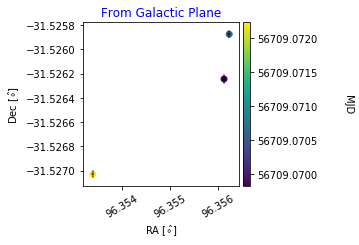

v_ra =  7.335591646472937 , v_dec =  -8.82686413702225


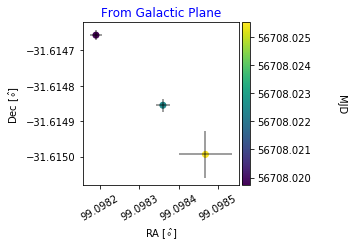

v_ra =  35.72308659498911 , v_dec =  43.49786904218568


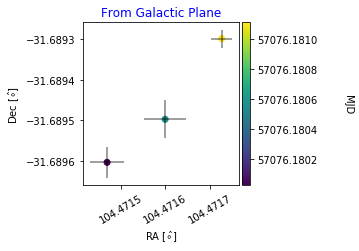

v_ra =  18.46137343725818 , v_dec =  7.1953161964037475


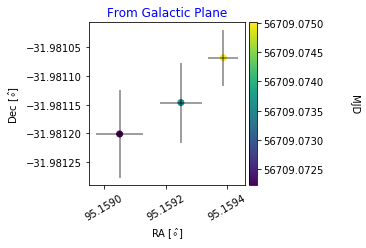

v_ra =  -35.43011179921042 , v_dec =  56.48763730959556


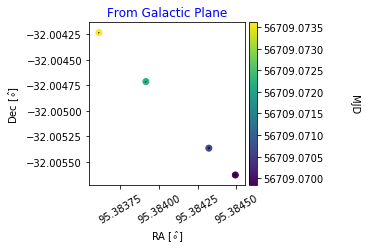

v_ra =  18.280951402936687 , v_dec =  -9.56542170941987


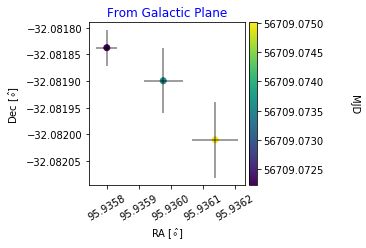

v_ra =  -59.85667863368021 , v_dec =  -138.1270895626893


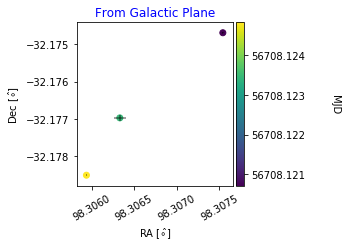

v_ra =  -15.359683025690082 , v_dec =  9.714062309933022


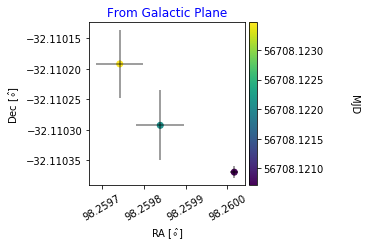

v_ra =  23.553074171100786 , v_dec =  -95.84985910852454


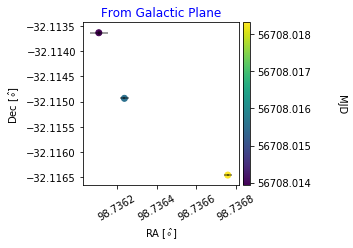

v_ra =  -42.73415822429059 , v_dec =  4.373556787444987


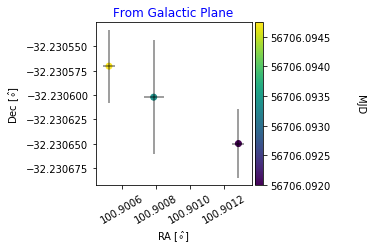

v_ra =  -195.62432483257012 , v_dec =  2.138628654315653


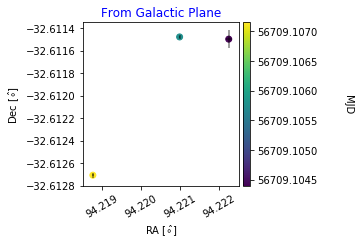

v_ra =  178.01117966999308 , v_dec =  73.54371558296519


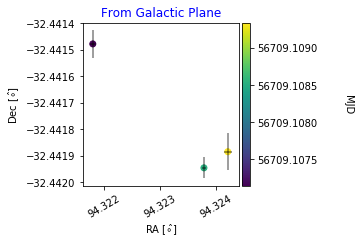

v_ra =  25.058949195288847 , v_dec =  9.632221723045339


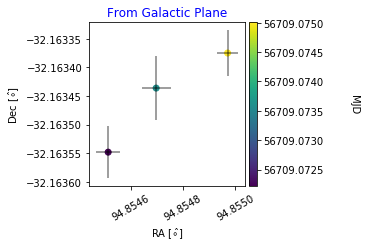

v_ra =  23.35231071528281 , v_dec =  -66.9750694569223


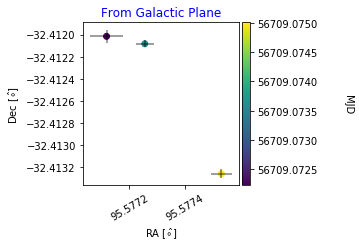

v_ra =  -94.51645525661299 , v_dec =  201.98656817217014


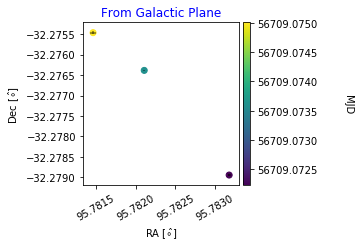

v_ra =  -20.593293593284418 , v_dec =  15.149347390740921


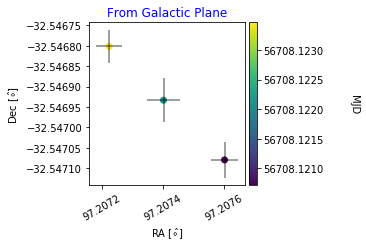

v_ra =  -10.743166921884638 , v_dec =  11.966444694670928


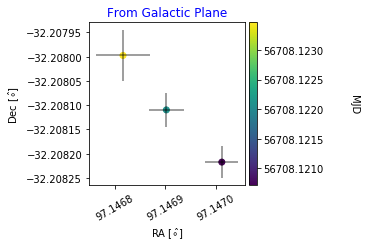

v_ra =  -73.21917594821565 , v_dec =  -43.903452017845495


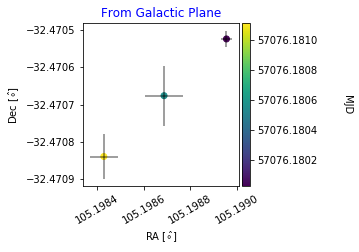

v_ra =  -51.555798368121394 , v_dec =  -169.6543180596793


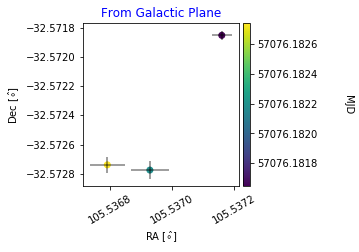

v_ra =  46.49951921755647 , v_dec =  -75.37453276383977


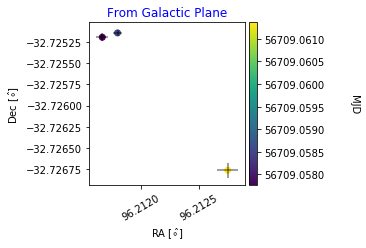

v_ra =  88.73245547687806 , v_dec =  -105.0953032221122


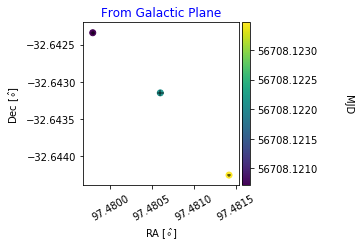

v_ra =  -4.338946616156854 , v_dec =  4.011861534250125


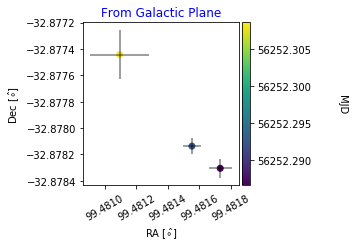

v_ra =  -24.10142532619336 , v_dec =  14.51960261812379


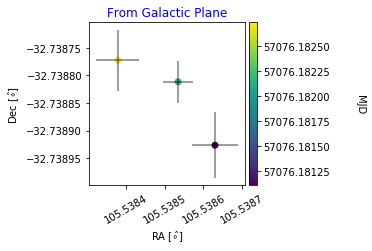

v_ra =  -55.626934735829074 , v_dec =  1.4193894616861682


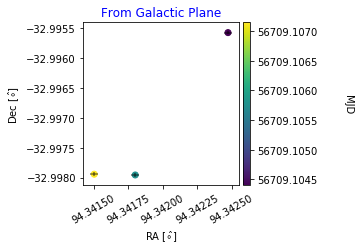

v_ra =  144.9961293663899 , v_dec =  -39.598418695319154


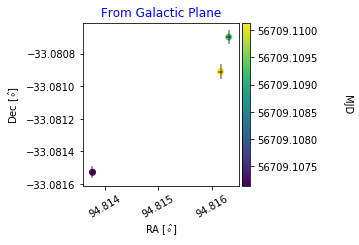

v_ra =  197.35942319976994 , v_dec =  -166.30225895895487


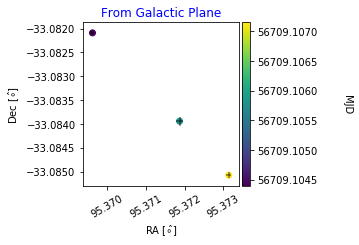

v_ra =  35.00075124367776 , v_dec =  -48.90365401720364


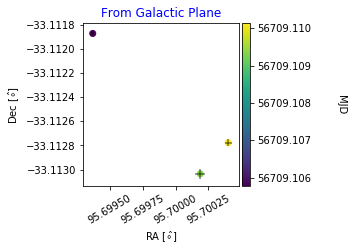

v_ra =  -13.152856398045516 , v_dec =  -14.030257957513568


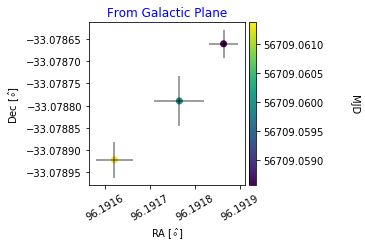

v_ra =  31.75186402262427 , v_dec =  -23.60868383264041


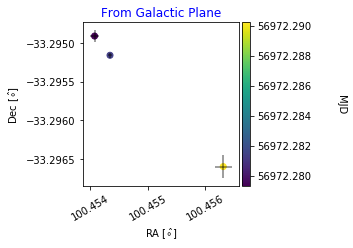

v_ra =  65.10078590367266 , v_dec =  -38.44644042894031


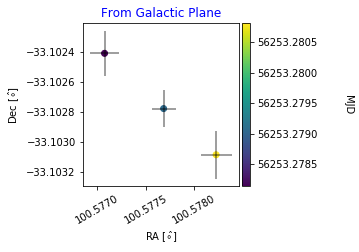

v_ra =  1.7255823795092198 , v_dec =  4.995347931478592


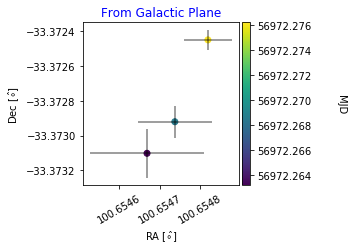

v_ra =  -24.220366643289083 , v_dec =  10.557205952521171


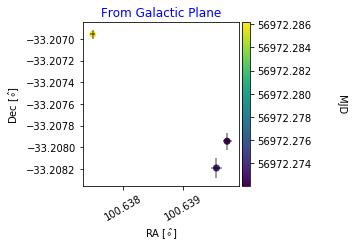

v_ra =  14.359366676160562 , v_dec =  -13.032399943124696


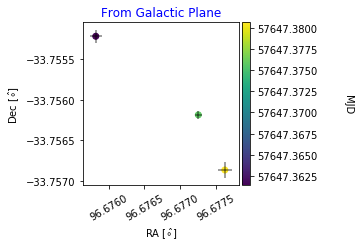

v_ra =  112.42074088539628 , v_dec =  143.16239651145364


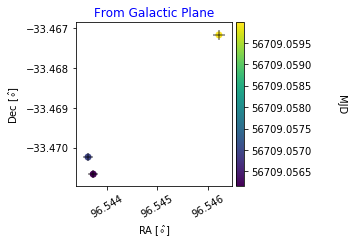

v_ra =  -52.052291994548774 , v_dec =  38.919979660459674


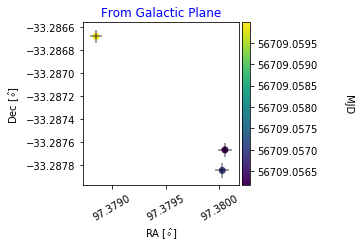

v_ra =  -27.01174368958351 , v_dec =  -130.03267762995597


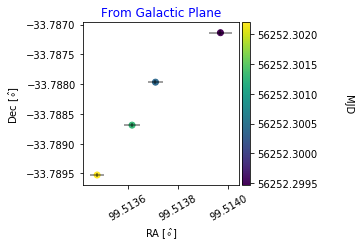

v_ra =  -10.414349539309676 , v_dec =  -119.01280616163717


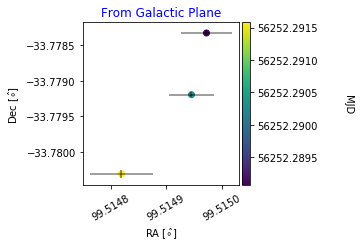

v_ra =  181.31308740810334 , v_dec =  -7.246026991926466


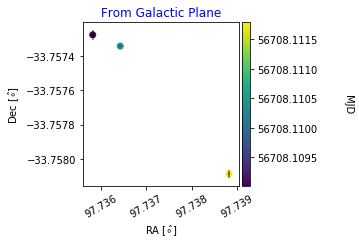

v_ra =  -82.76860606093048 , v_dec =  -77.0199493668322


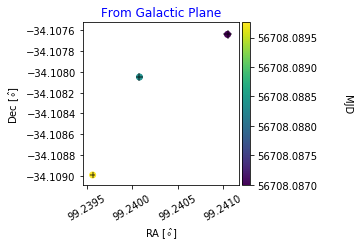

v_ra =  17.375583036285317 , v_dec =  -73.23568075431045


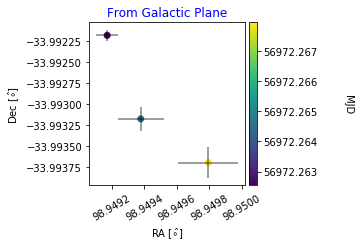

v_ra =  -71.62417631612166 , v_dec =  -15.957521190516252


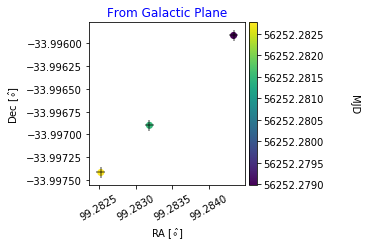

v_ra =  43.36831842940839 , v_dec =  -53.27648892998707


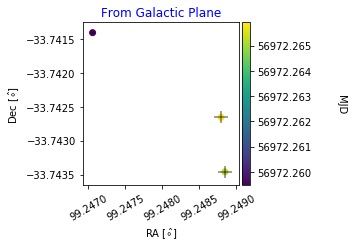

v_ra =  2.182054912391079 , v_dec =  13.605938304146148


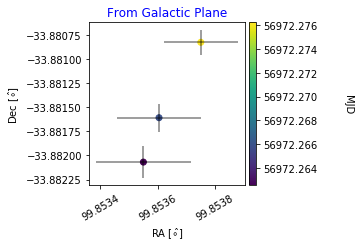

v_ra =  284.6270468207325 , v_dec =  -46.842748740066156


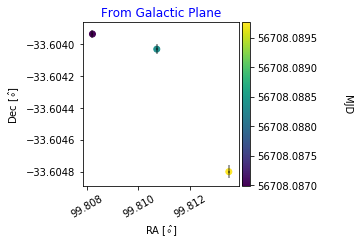

v_ra =  -30.218182213041217 , v_dec =  18.46025802460924


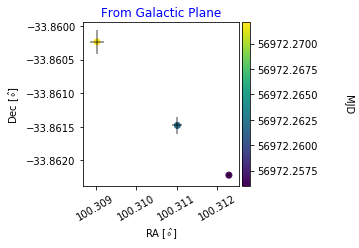

v_ra =  -22.148563603530064 , v_dec =  44.00421670961495


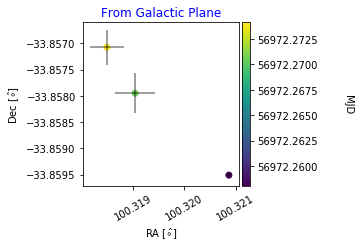

v_ra =  66.46585149445703 , v_dec =  -44.56990317595347


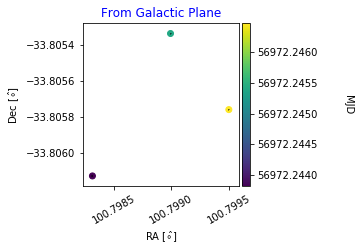

v_ra =  14.041403282584197 , v_dec =  16.440302544041927


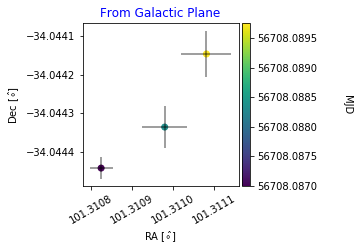

v_ra =  -63.70900259142342 , v_dec =  -18.216721195908168


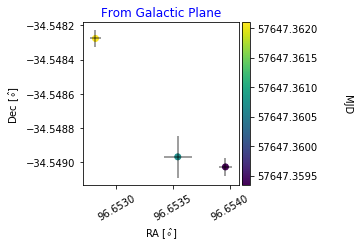

v_ra =  156.69300808106263 , v_dec =  249.85564029298737


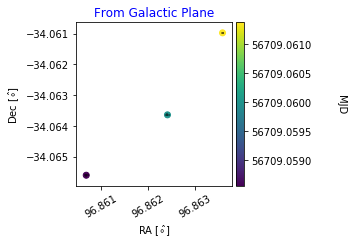

v_ra =  119.95282112451525 , v_dec =  -164.6972398644201


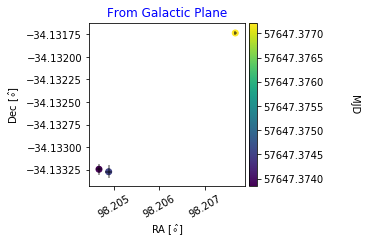

v_ra =  37.003220398125954 , v_dec =  -24.77355156783547


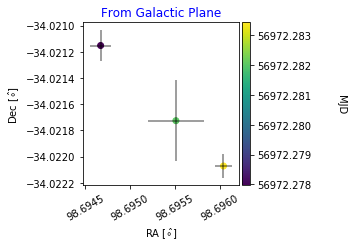

v_ra =  -128.87577982915084 , v_dec =  -156.2786497539699


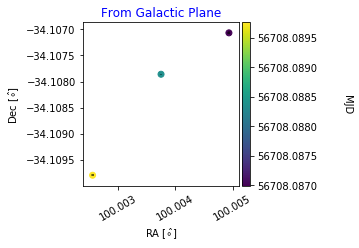

v_ra =  -4.411357340693383 , v_dec =  -23.020727965905817


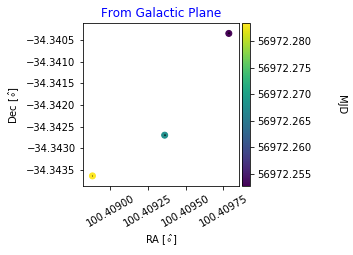

v_ra =  4.211332714290827 , v_dec =  -29.184938465308363


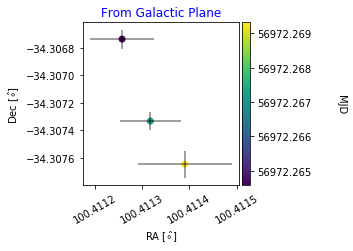

v_ra =  -5.123682345866746 , v_dec =  33.82043677507639


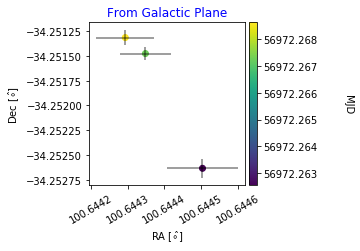

v_ra =  -9.445312144126689 , v_dec =  35.412112708937705


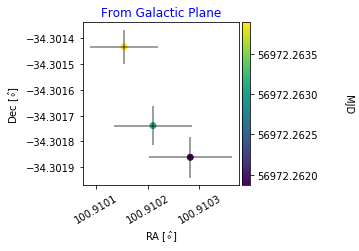

v_ra =  104.67061018173594 , v_dec =  87.03763913576957


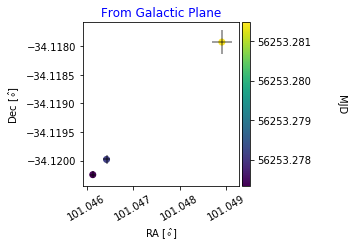

v_ra =  7.346646407370155 , v_dec =  5.19889767254331


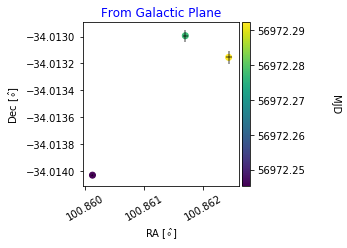

v_ra =  -21.265084146769976 , v_dec =  -133.94951919848492


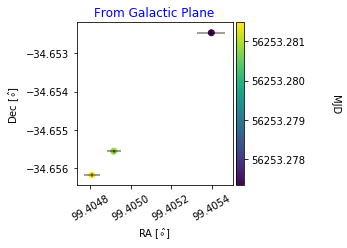

v_ra =  -5.306016933413594 , v_dec =  8.905135778408637


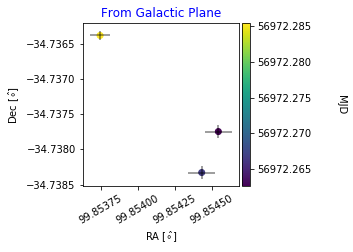

v_ra =  186.47052474826214 , v_dec =  -159.4874549643238


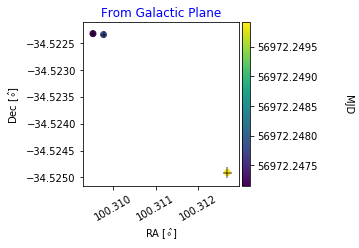

v_ra =  -20.59133137861585 , v_dec =  -27.614706617163492


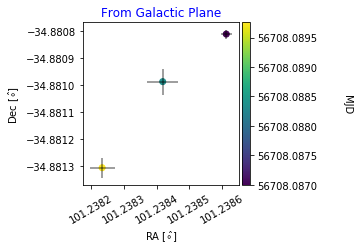

v_ra =  23.749366810708793 , v_dec =  103.75433675790146


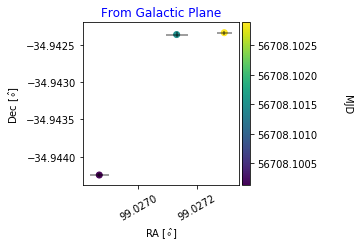

v_ra =  -22.615431199106506 , v_dec =  11.500059892219136


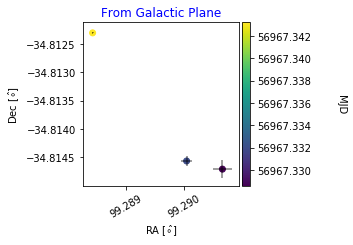

v_ra =  72.88787170232281 , v_dec =  79.61241540989265


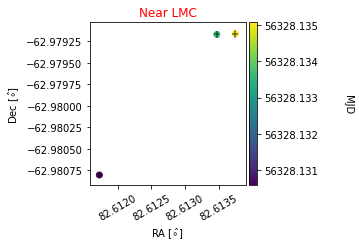

v_ra =  -166.60455662250789 , v_dec =  168.26099288116237


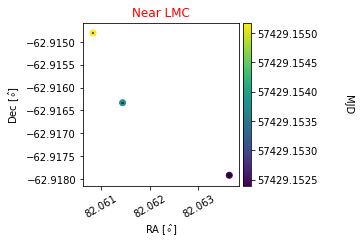

v_ra =  64.24713305801791 , v_dec =  33.63675137932114


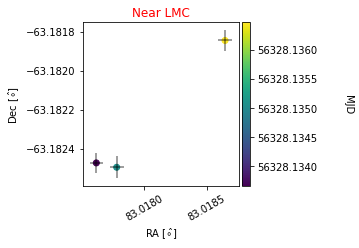

v_ra =  -18.887461609814874 , v_dec =  -1.4713345939476694


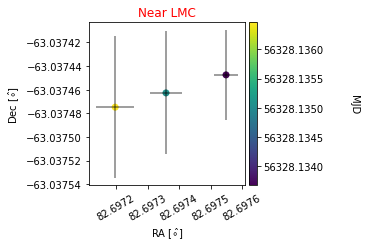

v_ra =  -80.78009691513515 , v_dec =  11.041028766807154


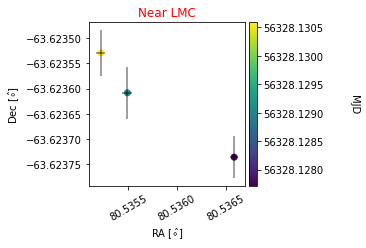

v_ra =  -43.550640984293445 , v_dec =  46.58783554451804


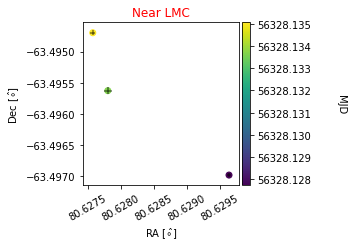

v_ra =  18.770645096488355 , v_dec =  -19.60160072343289


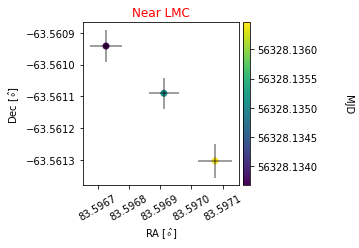

v_ra =  -95.1027710424725 , v_dec =  -55.338358997601176


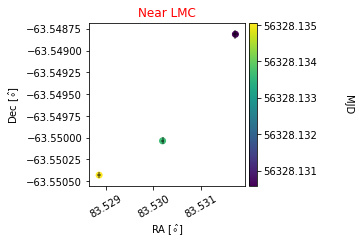

v_ra =  -121.92832135596244 , v_dec =  73.47021359511372


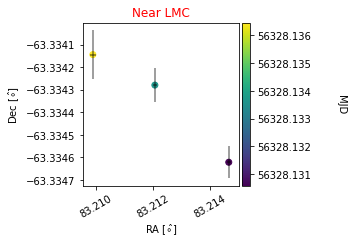

v_ra =  -16.142081464243482 , v_dec =  -2.582997336318726


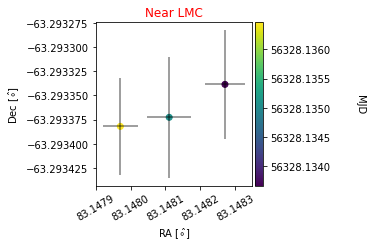

v_ra =  -23.906493256947087 , v_dec =  21.958761178723403


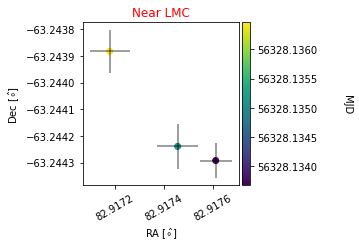

v_ra =  13.667141925345478 , v_dec =  17.092415014975593


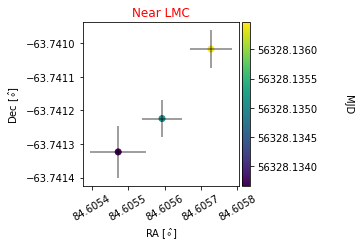

v_ra =  57.69434073090084 , v_dec =  21.38228205405682


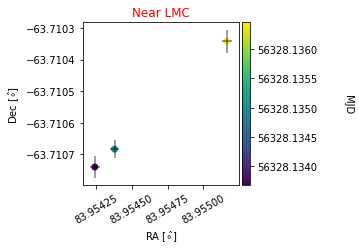

v_ra =  -60.76117320241638 , v_dec =  -238.11046758317534


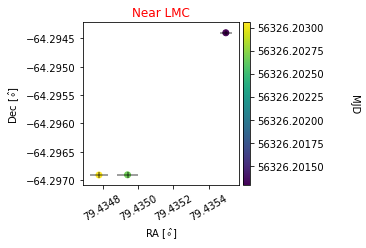

v_ra =  -40.42371270772603 , v_dec =  136.501266220799


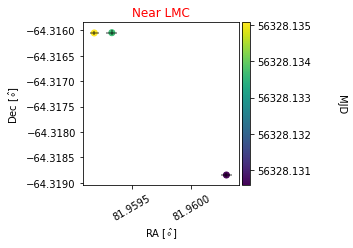

v_ra =  104.654108374838 , v_dec =  -106.4966346040498


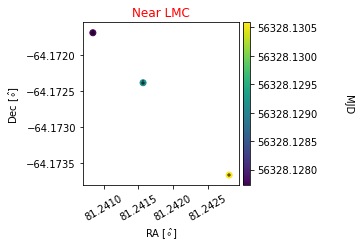

v_ra =  636.8003973162982 , v_dec =  -408.2940691663675


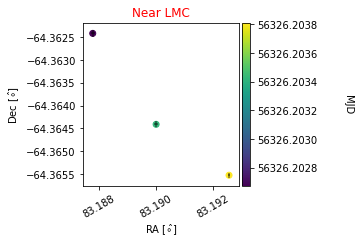

v_ra =  7.695589096314674 , v_dec =  2.2237239174205414


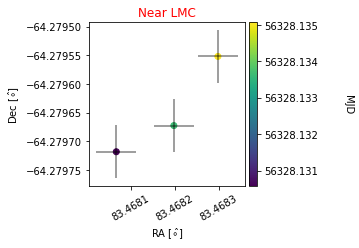

v_ra =  530.7873331163277 , v_dec =  -186.44530502490377


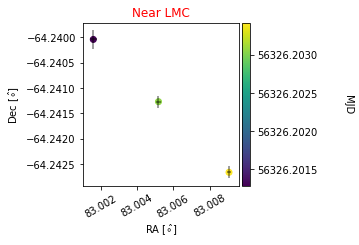

v_ra =  -24.459337499036607 , v_dec =  0.10387773678298595


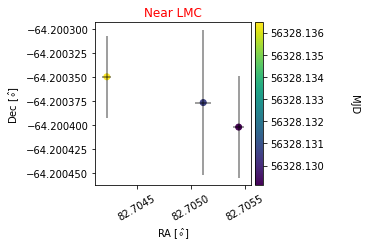

v_ra =  59.08310689129497 , v_dec =  29.186686050948524


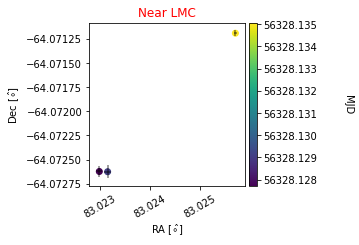

v_ra =  -28.070335115166888 , v_dec =  8.222627257645154


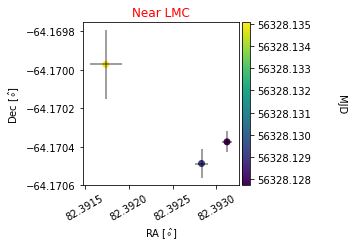

v_ra =  24.95009120128927 , v_dec =  -5.039454302605578


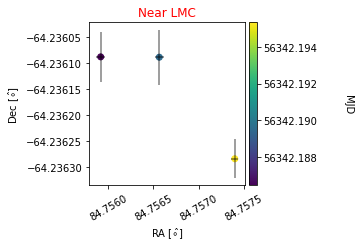

v_ra =  32.03350395552669 , v_dec =  142.43315836562473


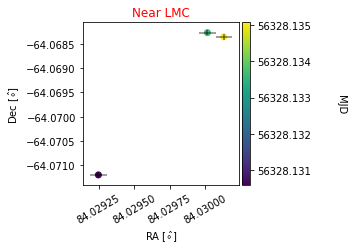

v_ra =  110.61265214824844 , v_dec =  136.9278320191918


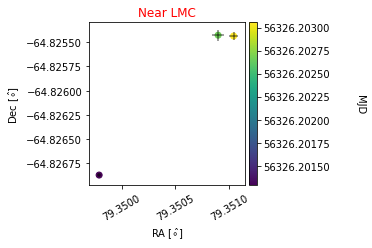

v_ra =  -174.45183511587163 , v_dec =  -163.60198575705812


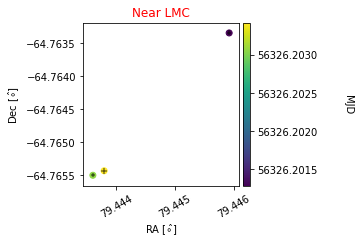

v_ra =  695.830861756186 , v_dec =  130.91738903712618


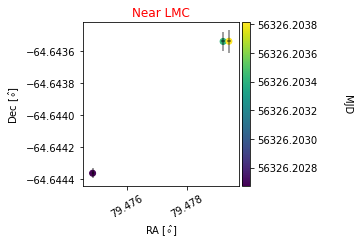

v_ra =  25.760178224889838 , v_dec =  10.744969424628744


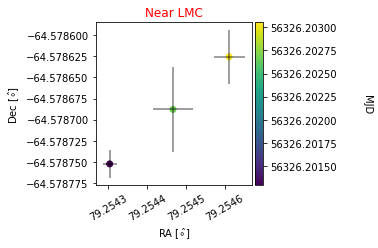

v_ra =  26.52398185124044 , v_dec =  -4.612232034986309


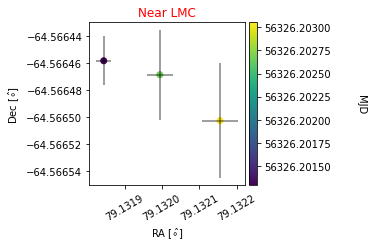

v_ra =  156.49804279058998 , v_dec =  37.55810955085867


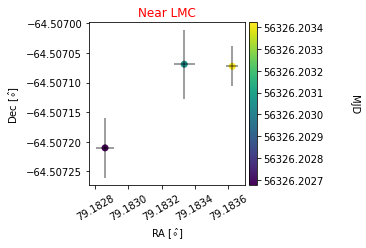

v_ra =  -82.02030215859797 , v_dec =  -158.2527193646492


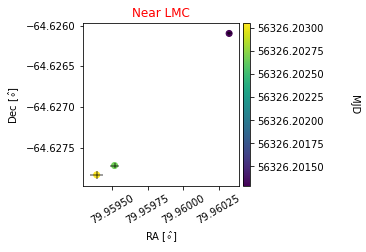

v_ra =  275.8682203910931 , v_dec =  -479.4964238455707


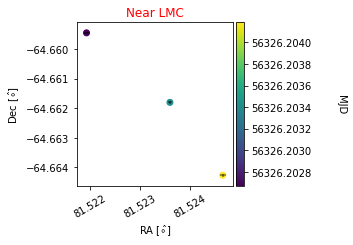

v_ra =  -138.0413978690054 , v_dec =  12.43217131775008


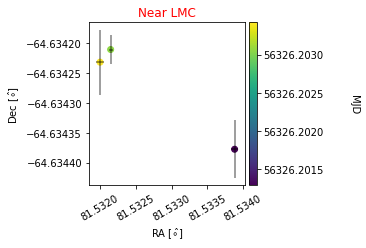

v_ra =  269.3239630625994 , v_dec =  -90.59581362351683


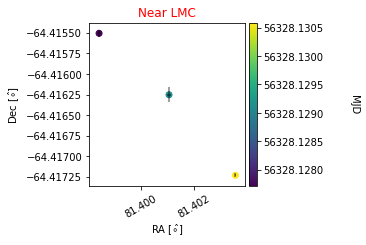

v_ra =  -67.3469392146151 , v_dec =  -12.544432793709648


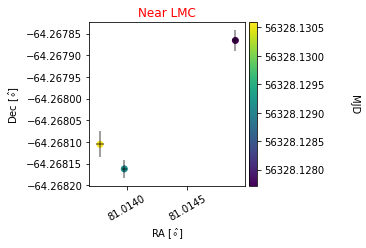

v_ra =  7.72952013471204 , v_dec =  8.43560310493645


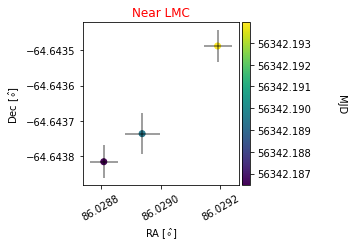

v_ra =  36.780533301313184 , v_dec =  24.162429499538877


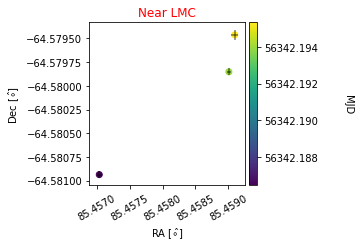

v_ra =  22.180574772906372 , v_dec =  17.852489567322284


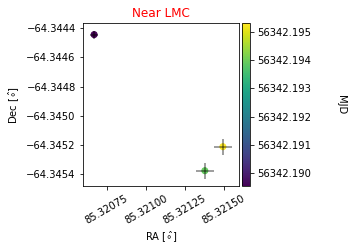

v_ra =  -142.07643548912722 , v_dec =  9.282301760884158


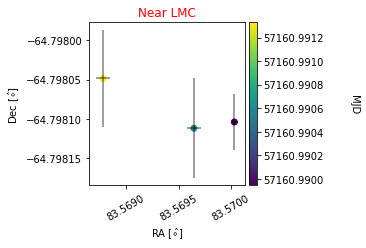

v_ra =  -29.290430753025916 , v_dec =  9.444964962193039


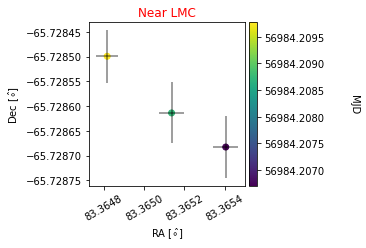

v_ra =  -6.200805062404586 , v_dec =  -12.932267325575282


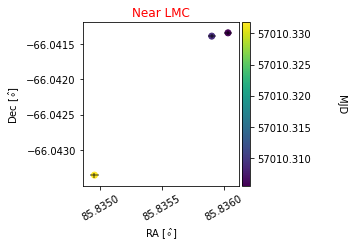

v_ra =  -167.7608043919931 , v_dec =  54.94541089105581


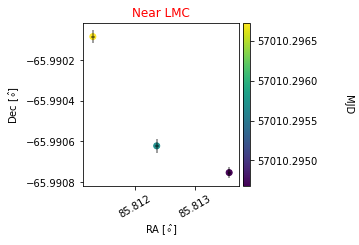

v_ra =  44.97026908468211 , v_dec =  10.165478692177732


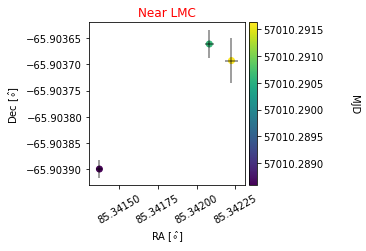

v_ra =  -52.41407269196915 , v_dec =  -17.97662611390449


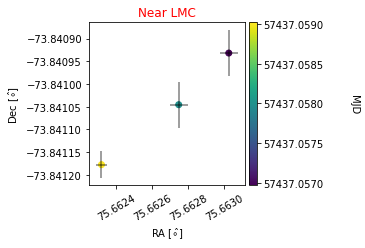

v_ra =  -59.853783045183796 , v_dec =  -56.040789866149474


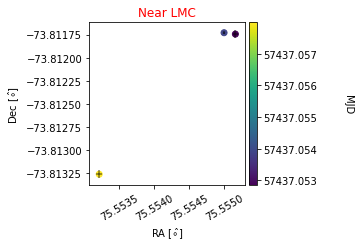

v_ra =  -29.436872531773187 , v_dec =  -169.04582787662312


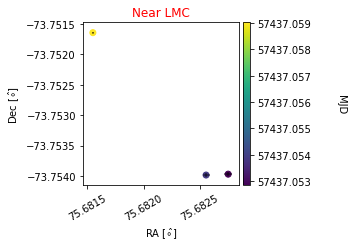

v_ra =  -196.55140561566364 , v_dec =  149.83099269040932


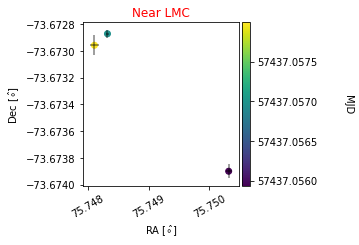

v_ra =  69.37747364328132 , v_dec =  -18.72490171525591


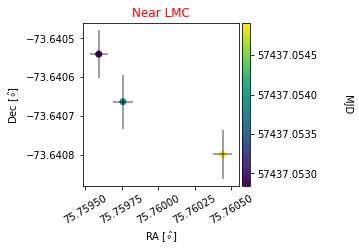

v_ra =  126.75546053898923 , v_dec =  1.9366202849801883


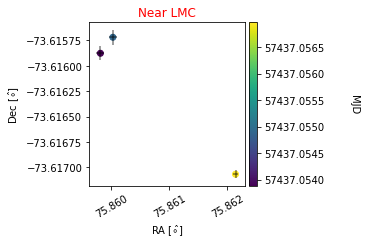

v_ra =  -67.50714356759408 , v_dec =  -8.103056614102654


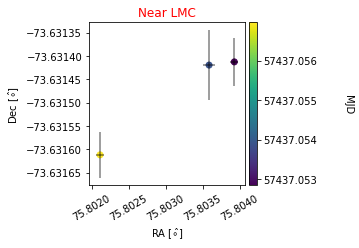

v_ra =  28.4225532722885 , v_dec =  2.9221832663320977


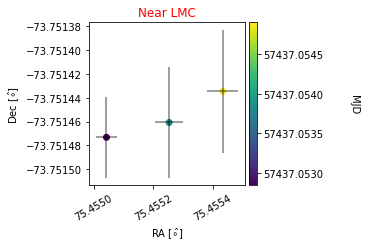

v_ra =  28.439614090762486 , v_dec =  -8.057298841566837


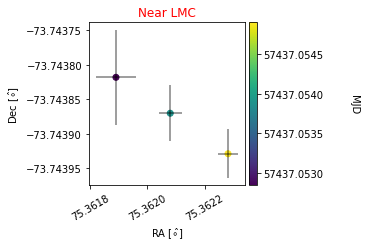

v_ra =  -31.77896895946129 , v_dec =  9.90401716856657


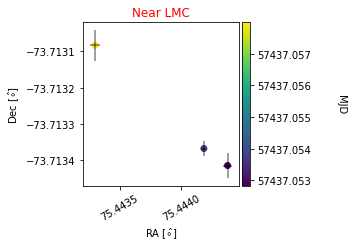

v_ra =  -262.67033902362425 , v_dec =  -79.46214191689886


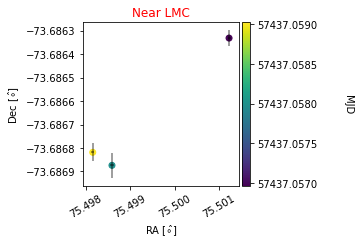

v_ra =  51.328573613650114 , v_dec =  10.44613371751264


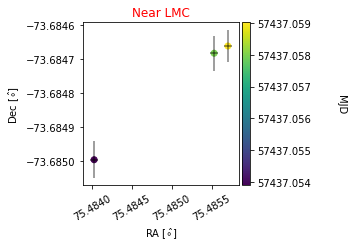

v_ra =  11.921134724953264 , v_dec =  317.9829536326334


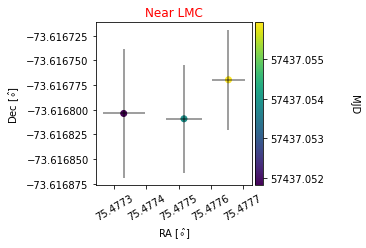

v_ra =  -48.573197371210796 , v_dec =  0.886019477369298


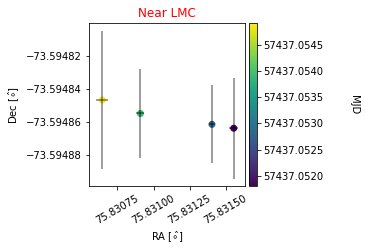

v_ra =  57.3877012013461 , v_dec =  -7.622851617417681


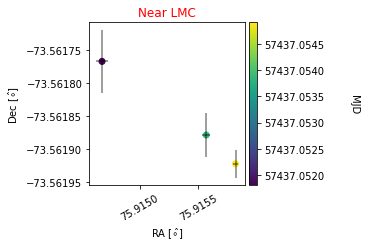

v_ra =  -54.75361094870888 , v_dec =  13.29406626013273


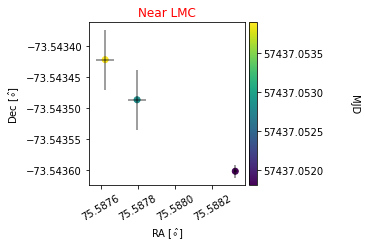

v_ra =  -98.12078970435816 , v_dec =  -107.77306687025727


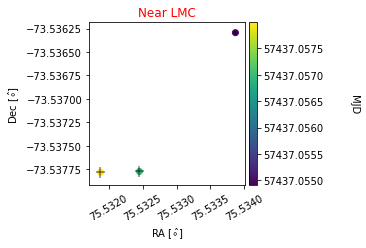

v_ra =  77.61747923324168 , v_dec =  -62.136991861884205


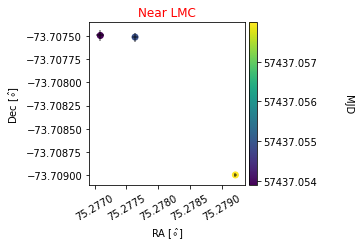

v_ra =  -61.09462203732762 , v_dec =  -13.351943774424562


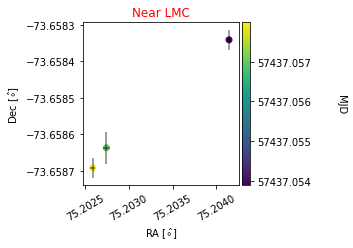

v_ra =  -119.58660897826171 , v_dec =  -36.086898277678365


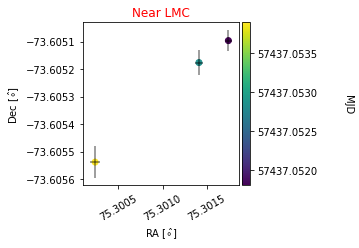

v_ra =  -133.966928594832 , v_dec =  -13.848286463774159


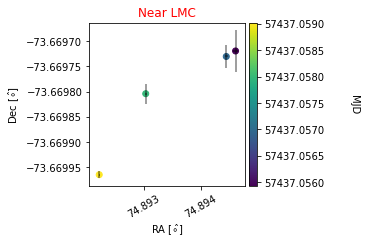

v_ra =  231.29188772538848 , v_dec =  -62.06649841180345


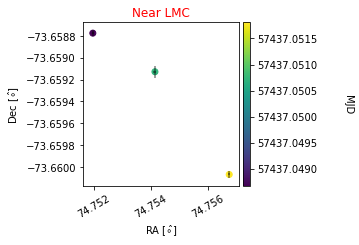

v_ra =  115.4621198416832 , v_dec =  -64.52690404162838


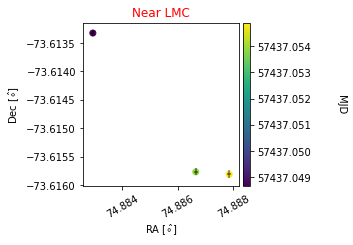

v_ra =  58.137321215794834 , v_dec =  28.684031863676015


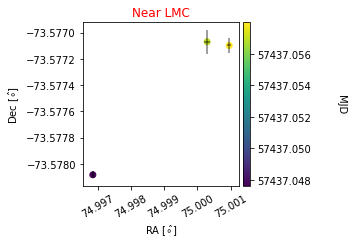

v_ra =  58.74361195992551 , v_dec =  -40.825258435946985


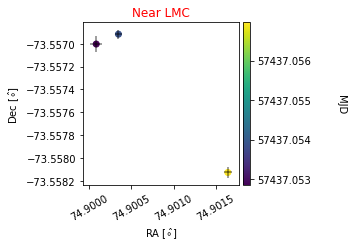

v_ra =  -39.13504198636756 , v_dec =  -6.666510195159297


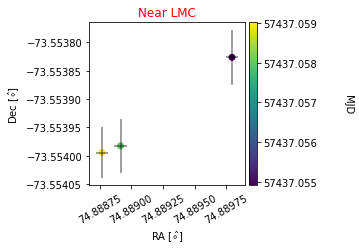

v_ra =  5.844302945095035 , v_dec =  -0.08172983495105923


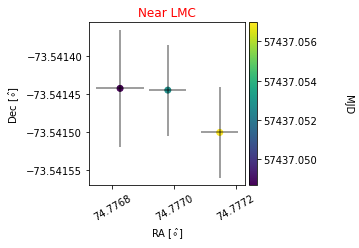

v_ra =  -27.295563269139816 , v_dec =  -2.44702708327317


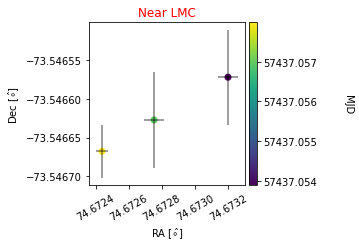

v_ra =  16.740162385611058 , v_dec =  -61.07270524707022


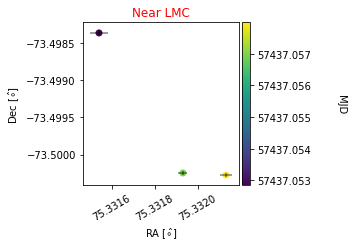

v_ra =  26.652783856155327 , v_dec =  -192.94493582052675


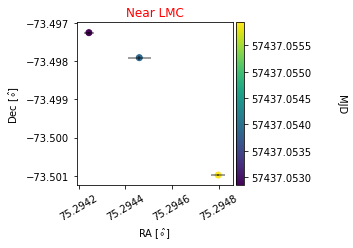

v_ra =  16.08430344403097 , v_dec =  1.1104102588098028


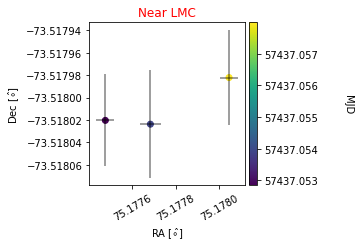

v_ra =  -51.54187960329795 , v_dec =  69.43516176094661


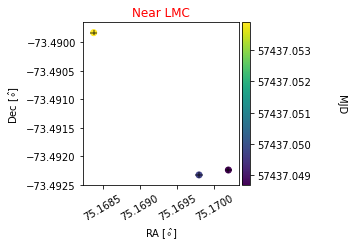

v_ra =  -29.8219493876928 , v_dec =  1.5708867757564837


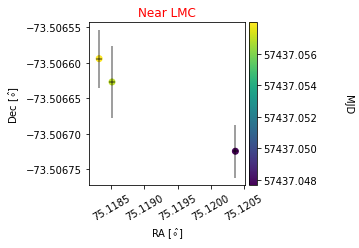

v_ra =  40.415599763708464 , v_dec =  -9.068096462647835


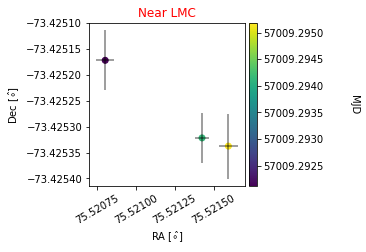

v_ra =  -40.7311967459679 , v_dec =  -12.17389882494652


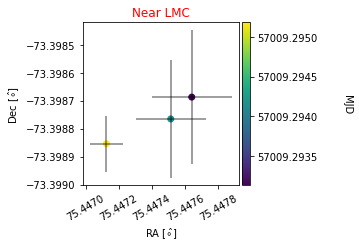

v_ra =  -148.3274462860879 , v_dec =  26.547505330796582


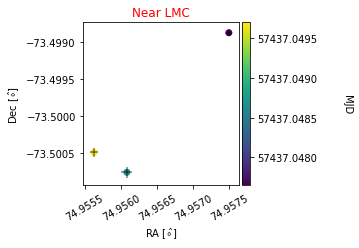

v_ra =  -116.61769643066422 , v_dec =  60.547676549751934


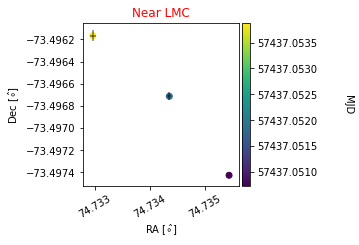

v_ra =  -36.157594066935566 , v_dec =  -11.44989139089901


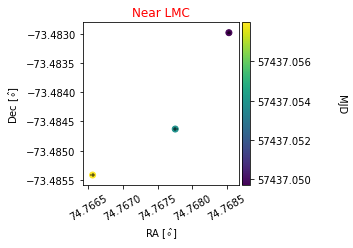

v_ra =  -10.448737490038909 , v_dec =  0.7975324772452067


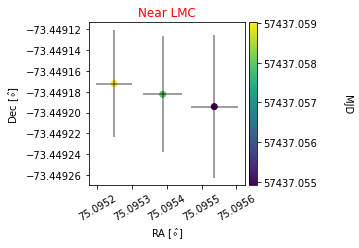

v_ra =  -68.99837792211702 , v_dec =  32.722984130945896


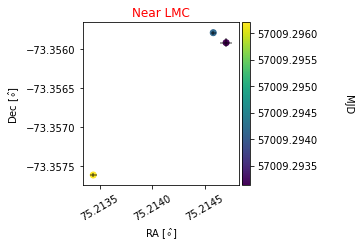

v_ra =  -33.5273007973745 , v_dec =  -7.550244732593284


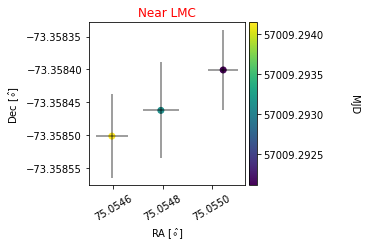

v_ra =  54.07783377764091 , v_dec =  -47.09602770795644


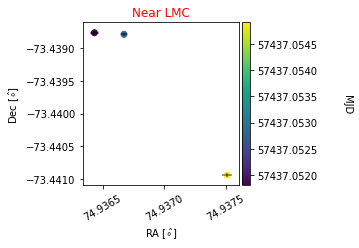

v_ra =  -26.04692884110763 , v_dec =  -4.045548183802634


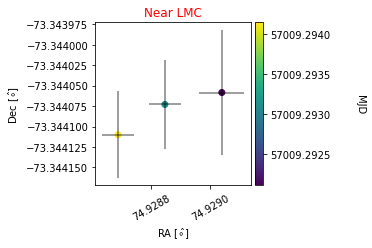

v_ra =  -208.05075922557953 , v_dec =  53.9059533946237


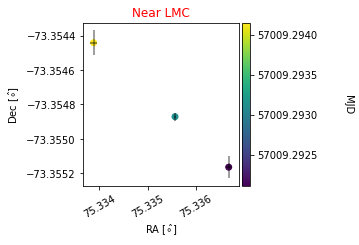

v_ra =  19.066808083253072 , v_dec =  6.8624735129149315


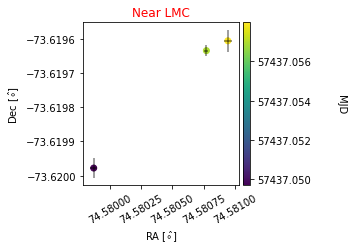

v_ra =  6.627307491235226 , v_dec =  -0.7526129189458097


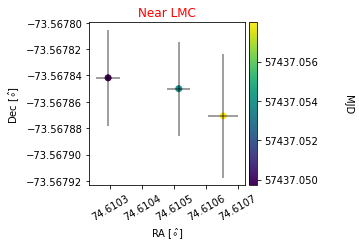

v_ra =  -91.9339013569122 , v_dec =  -23.198467327361715


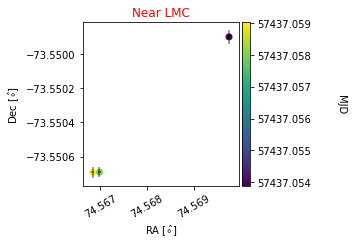

v_ra =  66.61546282280138 , v_dec =  11.387450265065665


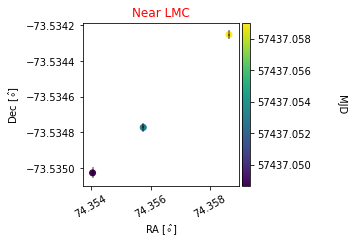

v_ra =  -127.81003112461444 , v_dec =  53.49875756655086


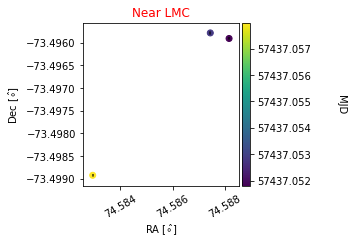

v_ra =  -294.0055876063471 , v_dec =  17.855454917283193


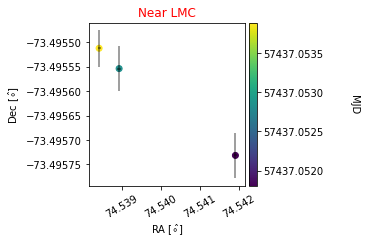

v_ra =  -44.60315337710542 , v_dec =  48.151673480262964


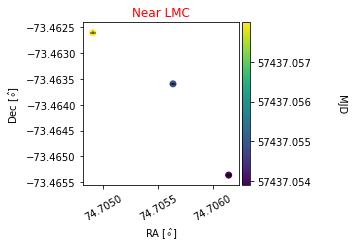

v_ra =  268.54974885681384 , v_dec =  -36.23243881937461


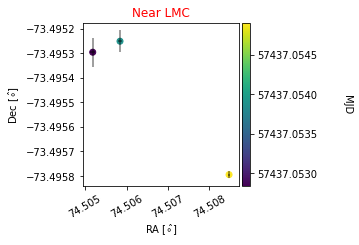

v_ra =  -29.977209582421796 , v_dec =  -11.692008419848705


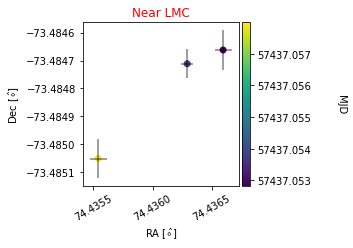

v_ra =  -107.40704561597006 , v_dec =  40.31241415379072


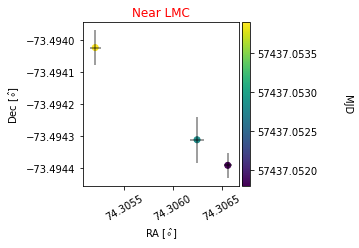

v_ra =  -180.94997751055652 , v_dec =  23.45682755942528


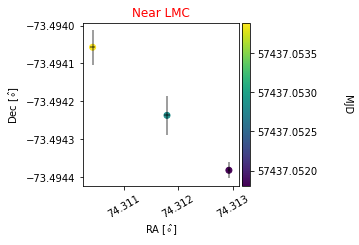

v_ra =  -82.22717134646827 , v_dec =  -53.42810272906809


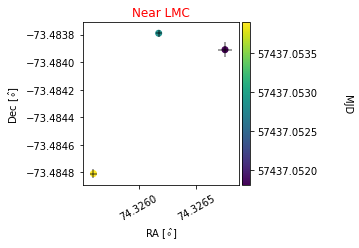

v_ra =  110.6073012493819 , v_dec =  43.9440091915694


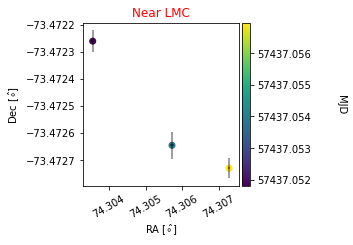

v_ra =  -43.431552995232515 , v_dec =  67.7472054540655


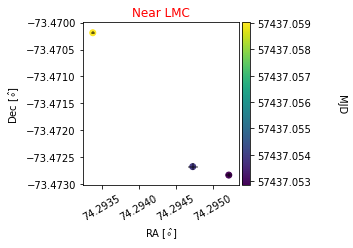

v_ra =  43.62697896849665 , v_dec =  26.28546813166078


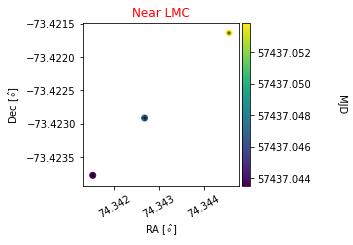

v_ra =  -41.09426108954352 , v_dec =  -61.29907238269691


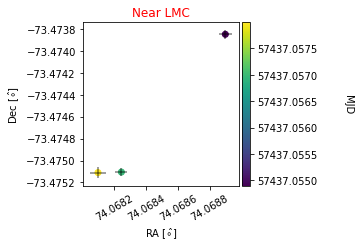

v_ra =  63.94858277531111 , v_dec =  40.33704368289601


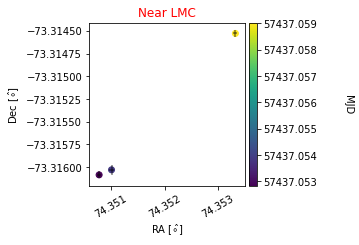

v_ra =  -16.11976476312219 , v_dec =  40.20775325463273


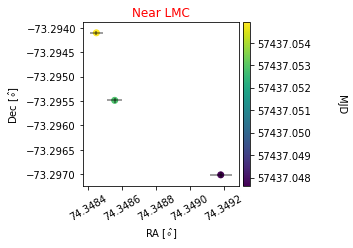

v_ra =  -11.966415632473108 , v_dec =  23.969763948112348


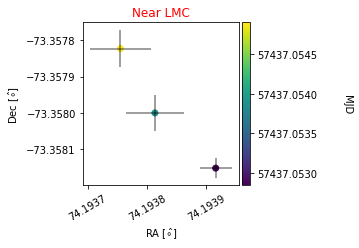

v_ra =  32.09604548132375 , v_dec =  11.79228775809529


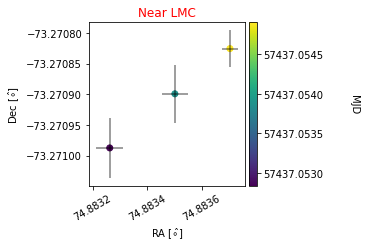

v_ra =  -40.6594673527975 , v_dec =  -91.57186726143567


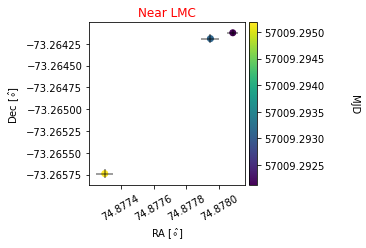

v_ra =  58.97386070947075 , v_dec =  -87.5046484576792


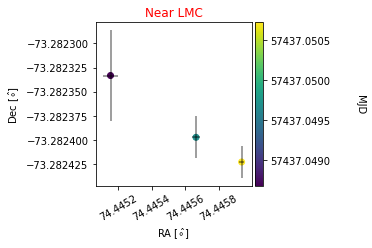

v_ra =  -21.020581441877336 , v_dec =  -5.828347120439105


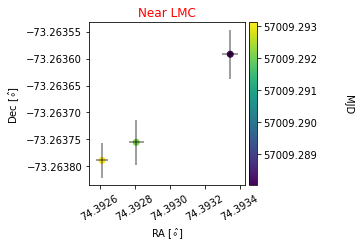

v_ra =  -128.88621596530865 , v_dec =  -44.380021609378026


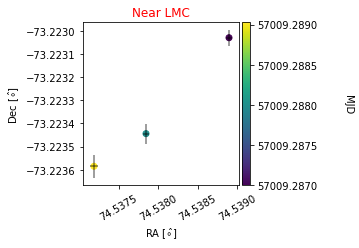

v_ra =  -28.35149341742679 , v_dec =  41.672265424643165


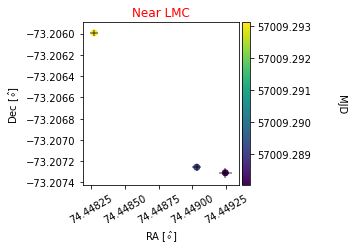

v_ra =  31.665553000353356 , v_dec =  -1.0555282490740687


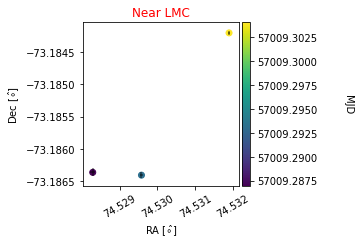

v_ra =  60.092164215802626 , v_dec =  107.7924178590891


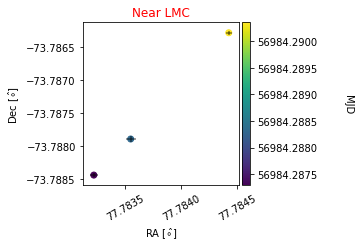

v_ra =  11.10048711440991 , v_dec =  6.034562062059095


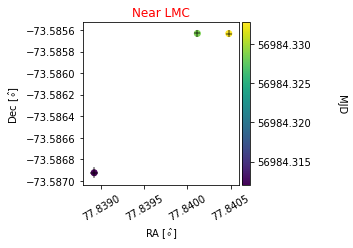

v_ra =  23.17272921275949 , v_dec =  13.874701743763312


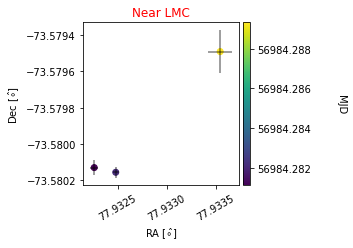

v_ra =  -38.91940064090194 , v_dec =  -82.6047827773064


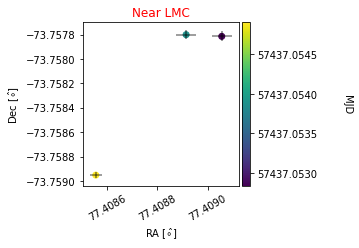

v_ra =  -10.62182514820288 , v_dec =  -5.655554464857854


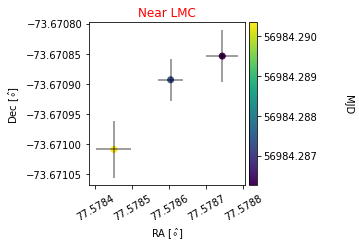

v_ra =  -8.8038055987666 , v_dec =  -1.2272174690391626


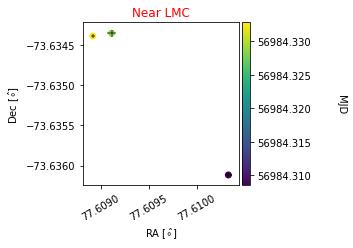

v_ra =  145.7166698252868 , v_dec =  55.770812189569426


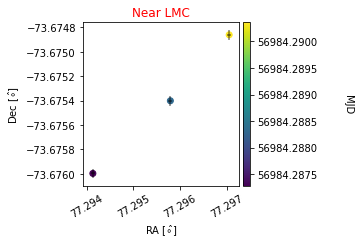

v_ra =  7.542919090164069 , v_dec =  1.6451060487150453


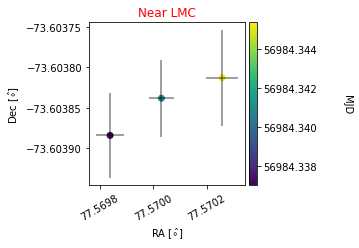

v_ra =  -145.59886543660903 , v_dec =  92.0574726931495


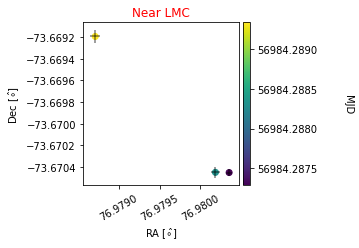

v_ra =  -99.67759266383183 , v_dec =  5.5423982230996875


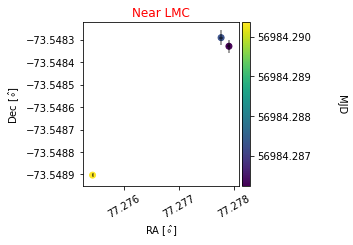

v_ra =  87.2297617084111 , v_dec =  11.376796987284258


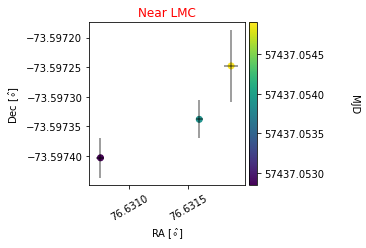

v_ra =  31.401101983762903 , v_dec =  -74.99249012489173


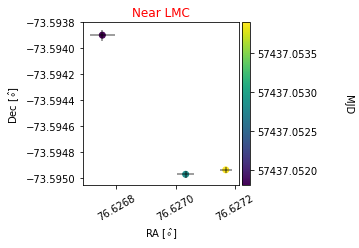

v_ra =  54.58077756358793 , v_dec =  93.37192062853698


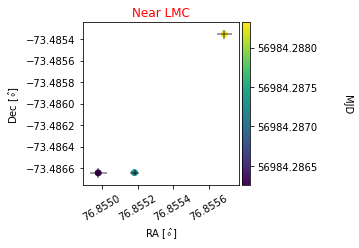

v_ra =  -106.6214708444287 , v_dec =  16.64350140679056


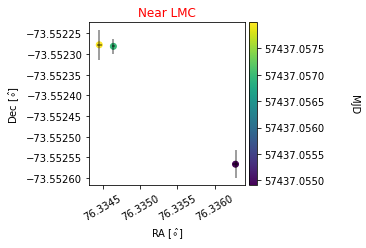

v_ra =  -34.02481107674452 , v_dec =  63.70911764487255


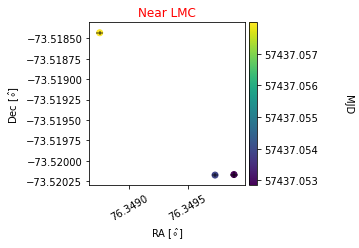

v_ra =  -47.449933076618315 , v_dec =  -41.65762914025731


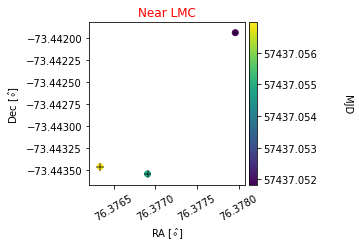

v_ra =  -19.0653927809734 , v_dec =  -1.5547201446304857


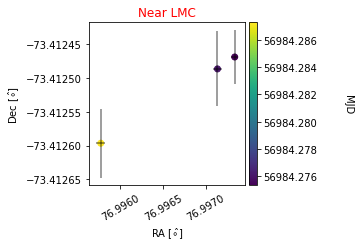

v_ra =  -19.804974998824004 , v_dec =  -4.5239509248244945


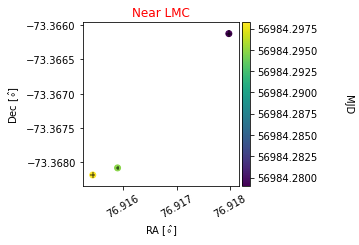

v_ra =  -8.98937982926837 , v_dec =  -3.034440725676394


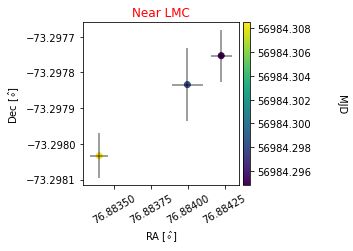

v_ra =  184.6855434900721 , v_dec =  5.424764041707416


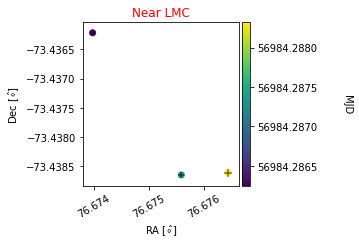

v_ra =  22.140289066714185 , v_dec =  1.7045976015584807


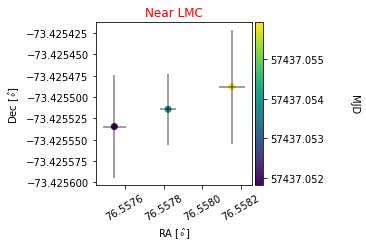

v_ra =  -32.487057542289634 , v_dec =  37.88319252807357


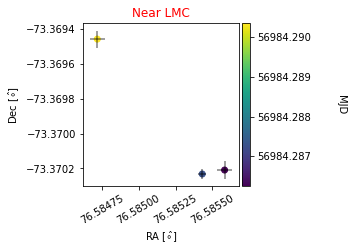

v_ra =  -39.265224908109374 , v_dec =  -3.1234262302097817


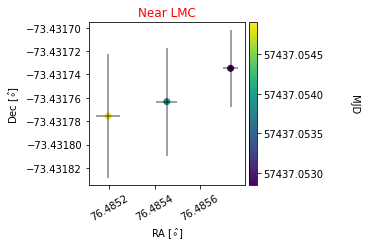

v_ra =  -24.94206144877585 , v_dec =  -7.848512576696891


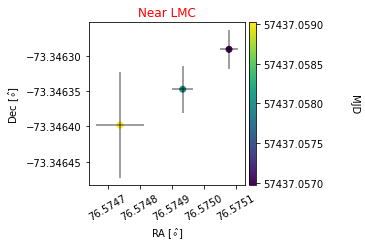

v_ra =  -137.44621248442746 , v_dec =  8.80704711470421


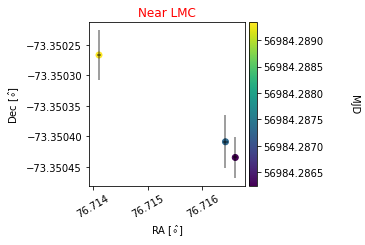

v_ra =  6.601958682920234 , v_dec =  0.23829493102234034


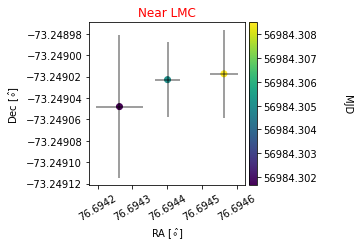

v_ra =  -29.716364904653698 , v_dec =  -21.494053452893166


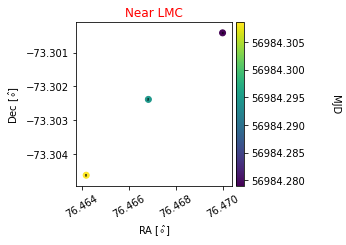

v_ra =  -79.3912665700634 , v_dec =  -38.345694760886154


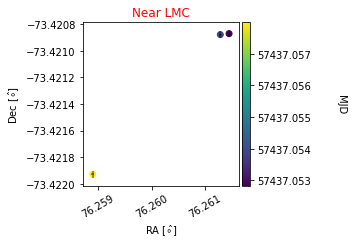

v_ra =  9.84131159379438 , v_dec =  2.310478300529186


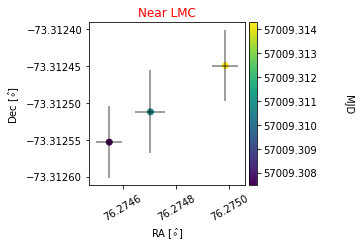

v_ra =  -100.15792883775883 , v_dec =  22.734585970293764


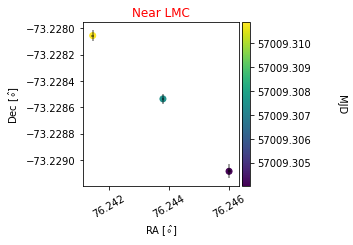

v_ra =  -43.745475842567544 , v_dec =  3.4509846467438603


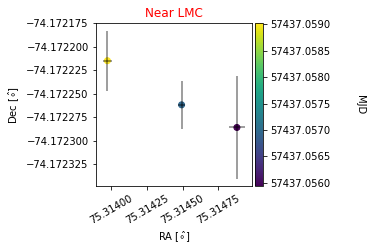

v_ra =  86.07176742092598 , v_dec =  -36.82065226390048


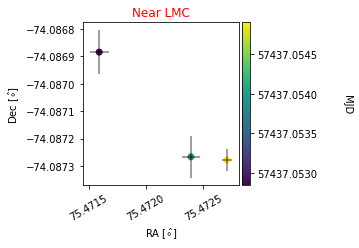

v_ra =  -99.69730511702345 , v_dec =  129.2352125309207


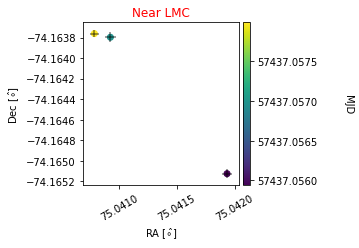

v_ra =  41.86583715778526 , v_dec =  0.8419808137838413


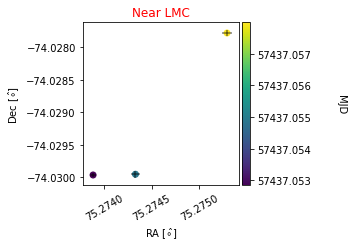

v_ra =  -39.42956335128038 , v_dec =  -1.503420850404568


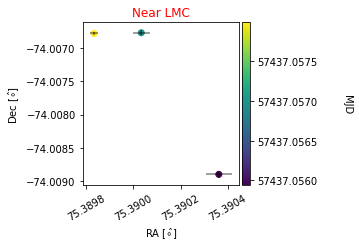

v_ra =  -49.88069056764876 , v_dec =  14.914705827906296


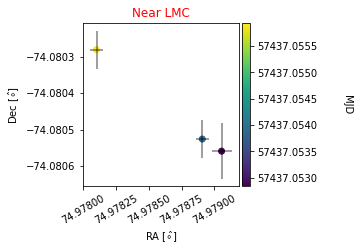

v_ra =  -106.18641747036877 , v_dec =  20.149283440506192


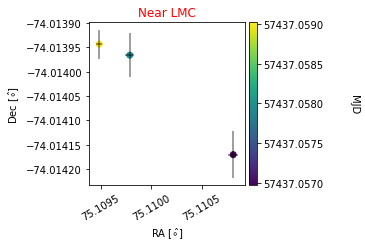

v_ra =  -139.74957190420474 , v_dec =  30.9875369983435


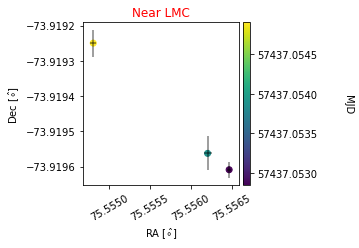

v_ra =  -126.94290429658929 , v_dec =  -57.40120074779599


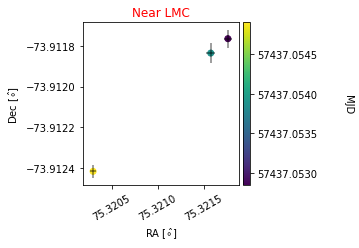

v_ra =  -35.36735815869883 , v_dec =  2.9632408489543494


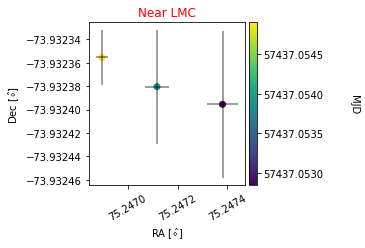

v_ra =  -59.51073432558567 , v_dec =  2.608856936976976


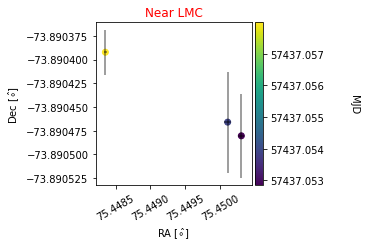

v_ra =  115.54847354394145 , v_dec =  42.785924564847136


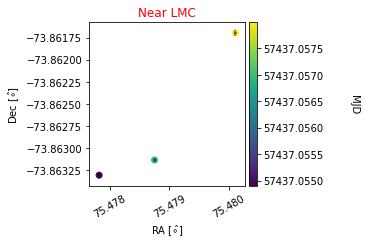

v_ra =  -69.96729005222578 , v_dec =  64.56044236554487


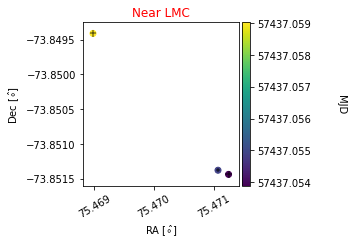

v_ra =  125.42615694249741 , v_dec =  154.41889153581403


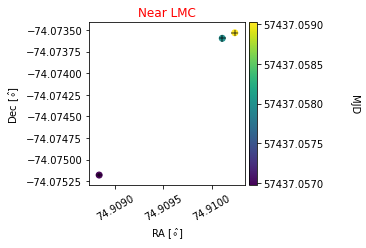

v_ra =  65.2689585063244 , v_dec =  -10.024910244403356


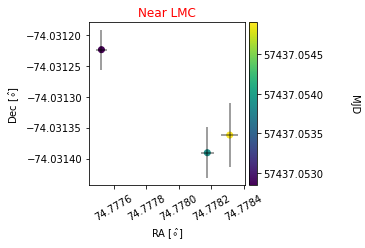

v_ra =  87.4819867949489 , v_dec =  -346.10453038527015


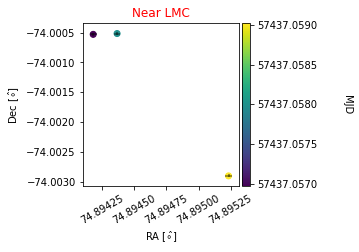

v_ra =  -20.771347013899923 , v_dec =  -28.793945497693098


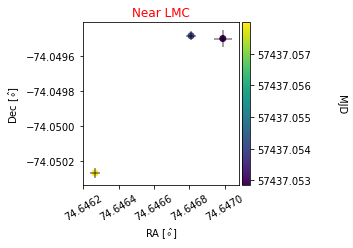

v_ra =  56.30218272975576 , v_dec =  -9.806664087460701


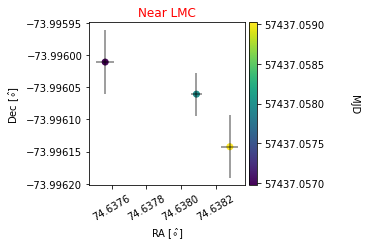

v_ra =  -55.90817251512117 , v_dec =  2.2271976428425675


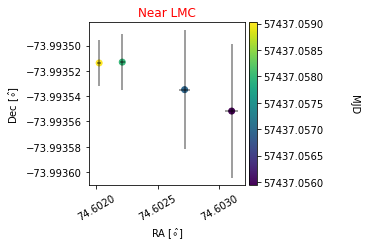

v_ra =  58.62986549539016 , v_dec =  -246.50352200297093


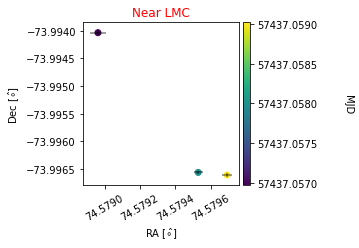

v_ra =  46.30746095278497 , v_dec =  29.770143238019028


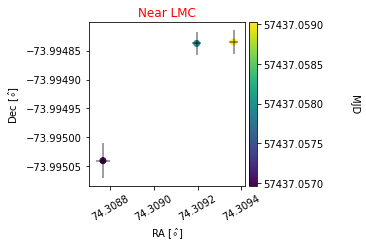

v_ra =  -165.5247445950417 , v_dec =  -65.03555363393785


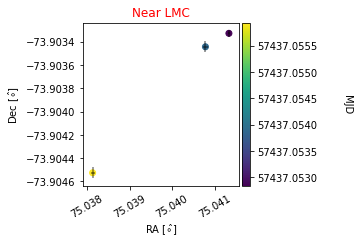

v_ra =  14.054389681848713 , v_dec =  5.321591582511068


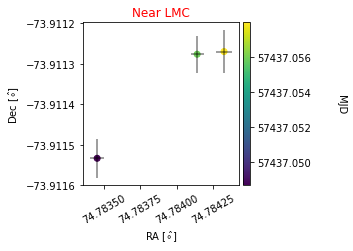

v_ra =  -51.04916106516467 , v_dec =  12.10778917127418


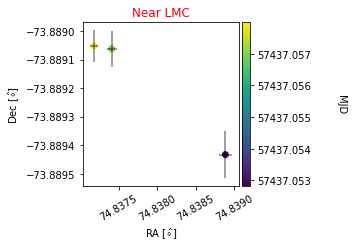

v_ra =  58.6850878068873 , v_dec =  6.318624548960684


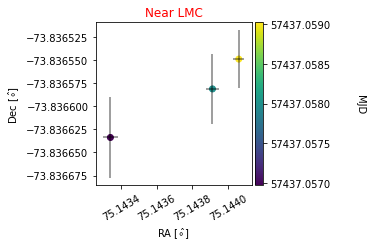

v_ra =  26.137563160295386 , v_dec =  -1.3037243471459565


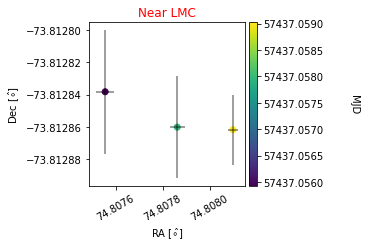

v_ra =  -156.608731268543 , v_dec =  -53.43764924592278


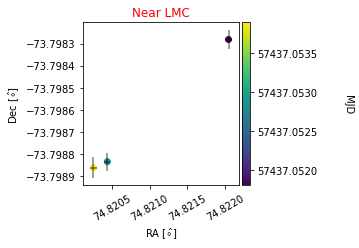

v_ra =  53.34596972775004 , v_dec =  -3.8456416415092183


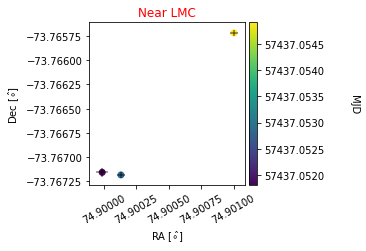

v_ra =  44.70841758912254 , v_dec =  -2.735349213366472


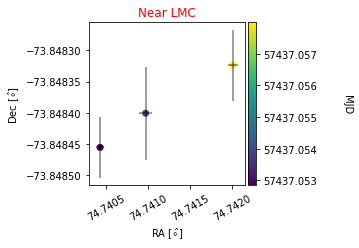

v_ra =  64.53720717119411 , v_dec =  20.430929623278796


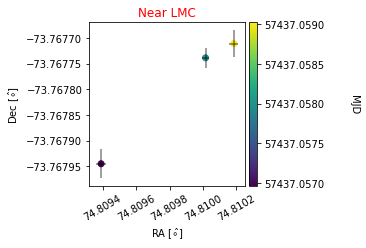

v_ra =  -18.605589635418912 , v_dec =  2.2653344150645105


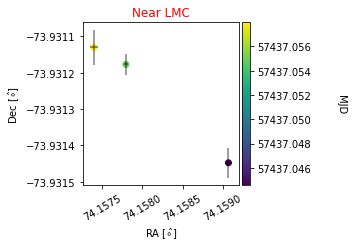

v_ra =  303.8995724802524 , v_dec =  103.52978883846112


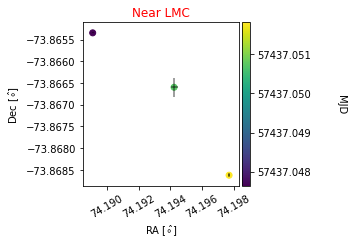

v_ra =  13.813623019791635 , v_dec =  -7.657200172252519


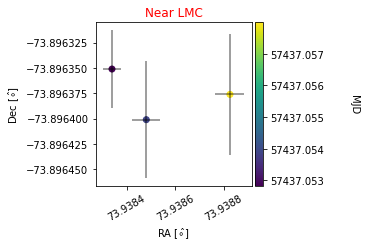

v_ra =  140.73428282711177 , v_dec =  69.82212493390232


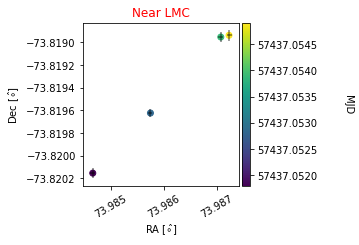

v_ra =  -46.55393918700374 , v_dec =  -39.26981563086216


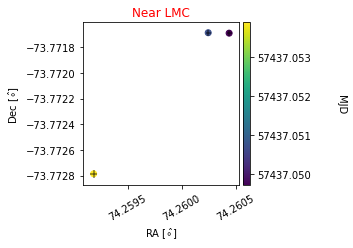

v_ra =  50.264044723362105 , v_dec =  -7.024237033879317


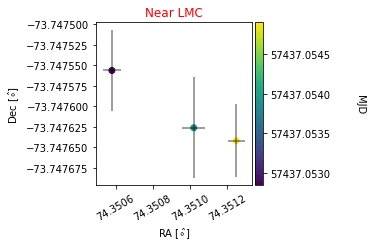

v_ra =  -110.7293160715368 , v_dec =  75.77404993950252


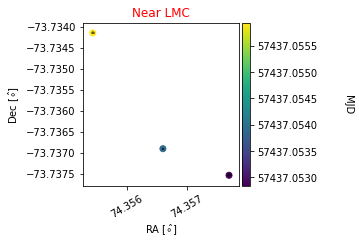

v_ra =  20.287267210224105 , v_dec =  -27.177177140843998


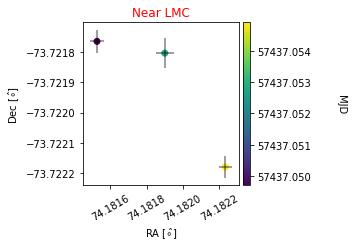

v_ra =  -156.45774820803868 , v_dec =  31.769323831243977


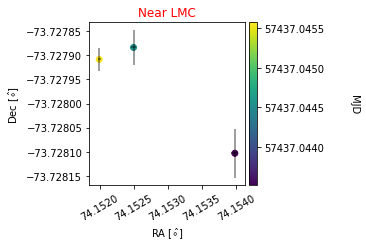

v_ra =  -7.9532593665192515 , v_dec =  0.46711983611541164


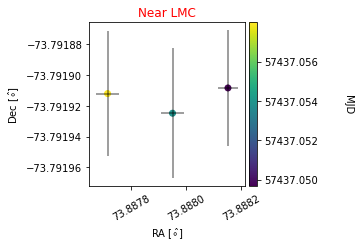

v_ra =  -28.664207847212566 , v_dec =  -10.675521335775924


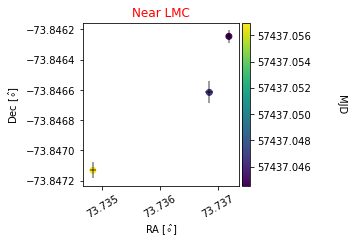

v_ra =  -40.453652340751795 , v_dec =  -45.68516675415858


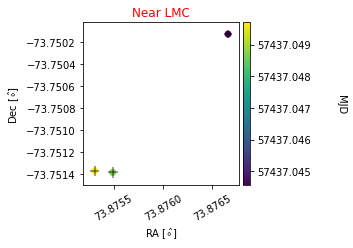

v_ra =  -15.932287868016209 , v_dec =  -15.606504531210101


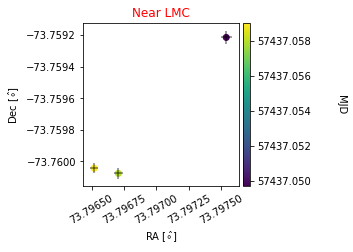

v_ra =  132.93188974828527 , v_dec =  -41.341906075819885


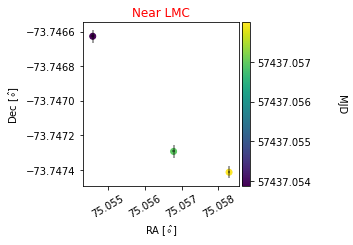

v_ra =  58.75366366396121 , v_dec =  379.96827330865955


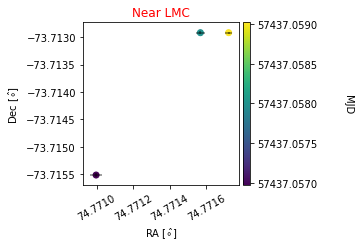

v_ra =  94.79076708590276 , v_dec =  7.135765536494264


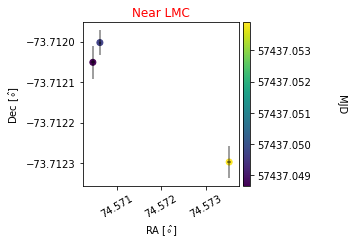

v_ra =  -8.624273730768676 , v_dec =  -1.8952819198692508


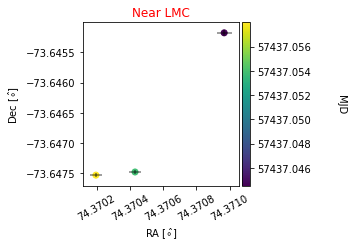

v_ra =  -37.24594067771769 , v_dec =  7.815040562150442


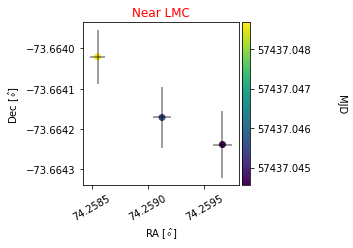

v_ra =  -19.977474760989043 , v_dec =  -1.7568452280601614


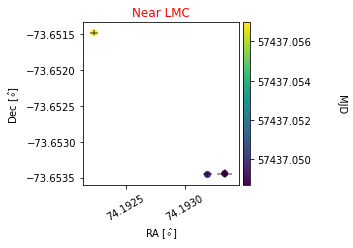

v_ra =  118.81989085589684 , v_dec =  -19.48832308257715


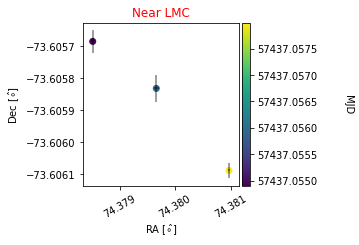

v_ra =  -17.13194730539848 , v_dec =  -3.3798318955020386


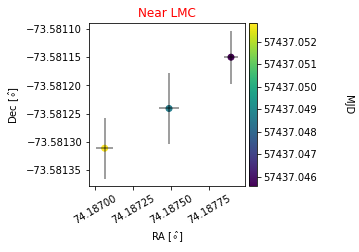

v_ra =  -26.600901119864684 , v_dec =  1.1167582819636366


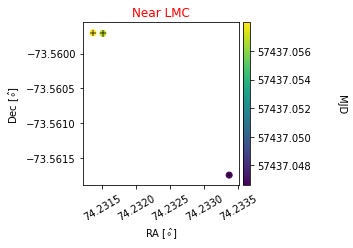

v_ra =  -97.50870357279109 , v_dec =  98.62274093874426


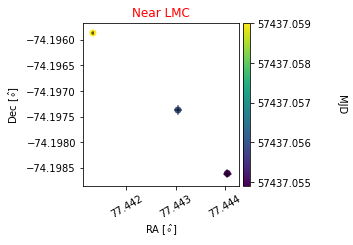

v_ra =  -8.320453308283115 , v_dec =  0.9357764219245323


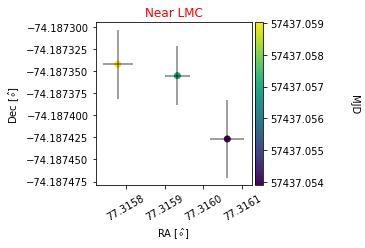

v_ra =  -142.29247234253452 , v_dec =  1.4389390356448517


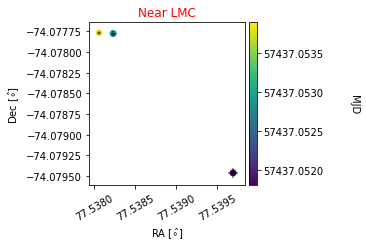

v_ra =  -29.126701136390626 , v_dec =  51.5092828355452


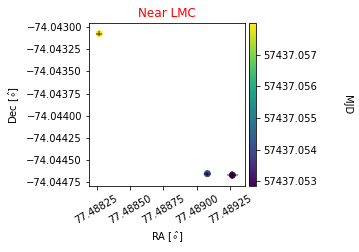

v_ra =  47.76827022683258 , v_dec =  -52.124949584210505


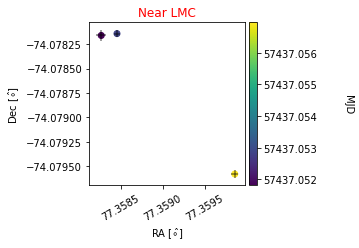

v_ra =  -54.6667135617976 , v_dec =  41.89352382670484


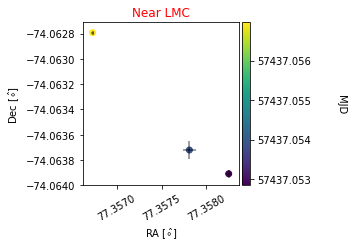

v_ra =  -37.44084676904432 , v_dec =  7.856500934677027


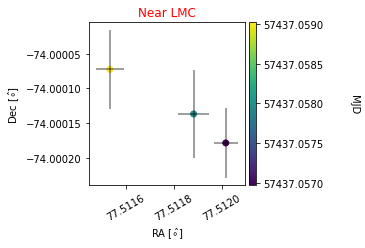

v_ra =  -29.504330577853395 , v_dec =  -3.326635621206419


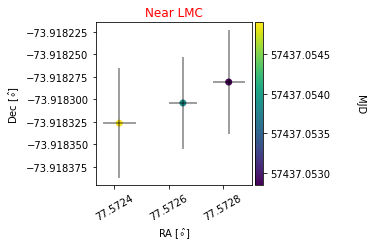

v_ra =  -43.03550853506263 , v_dec =  -4.6441000427054195


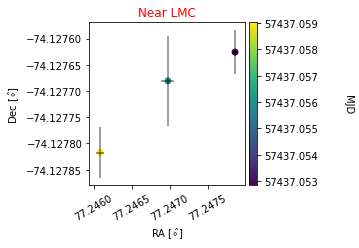

v_ra =  74.46843033094703 , v_dec =  53.9815411898258


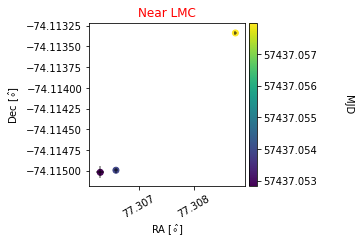

v_ra =  -176.3231573867175 , v_dec =  35.14028034697589


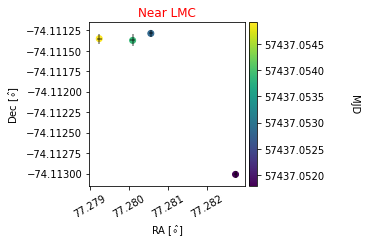

v_ra =  49.30451367794813 , v_dec =  120.61579871062935


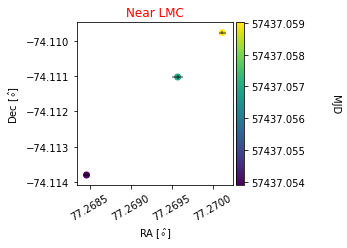

v_ra =  25.058532592984037 , v_dec =  5.162709313367121


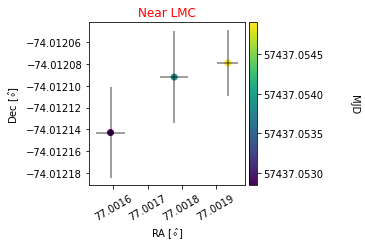

v_ra =  -51.258547918449715 , v_dec =  -60.56765294535523


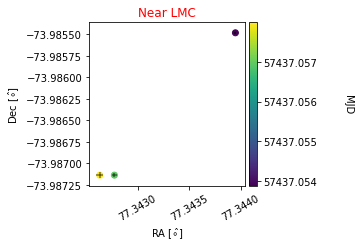

v_ra =  -150.34846705272216 , v_dec =  -112.1882720994198


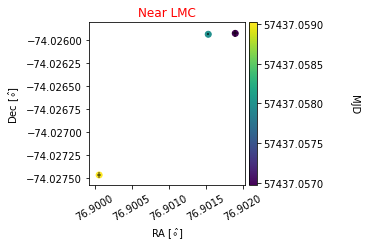

v_ra =  179.78775831061319 , v_dec =  -104.076193483616


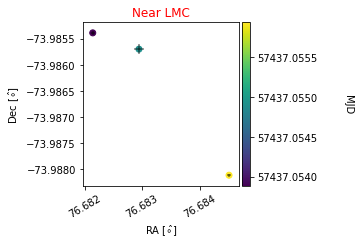

v_ra =  17.35665033037403 , v_dec =  -4.547520191175617


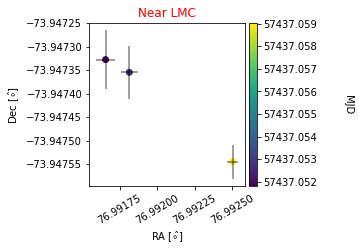

v_ra =  177.339307988227 , v_dec =  38.93110587338105


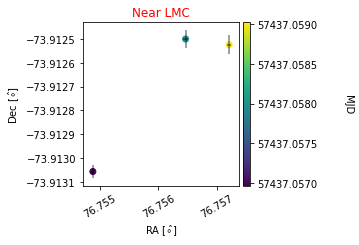

v_ra =  -42.99038318833235 , v_dec =  -129.95328882173067


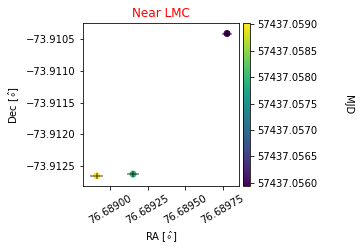

v_ra =  -27.629887935329307 , v_dec =  -8.438940417622971


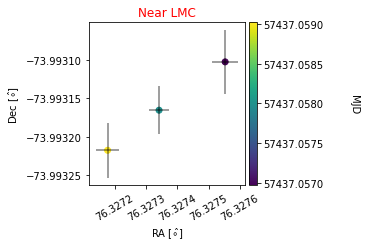

v_ra =  84.94967958680196 , v_dec =  -4.08186573162871


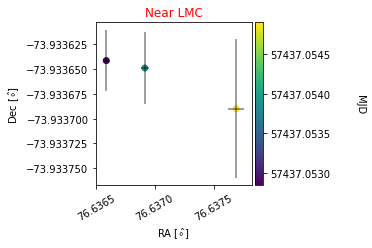

v_ra =  129.14694009334272 , v_dec =  -9.99916099729836


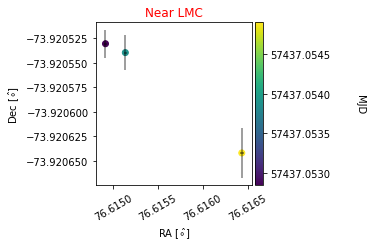

v_ra =  -152.4588462217694 , v_dec =  30.48386561691297


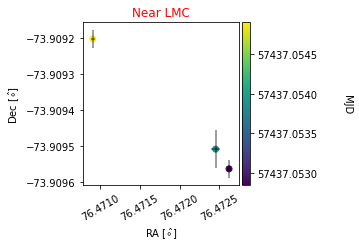

v_ra =  45.562895989469574 , v_dec =  25.952712511898415


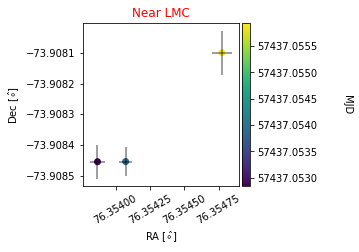

v_ra =  -131.28759457532814 , v_dec =  0.5348992406331147


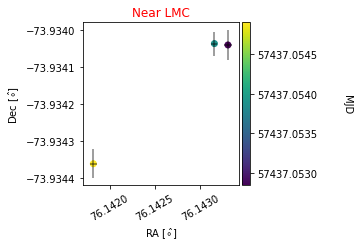

v_ra =  -23.31968288422196 , v_dec =  2.171349936014869


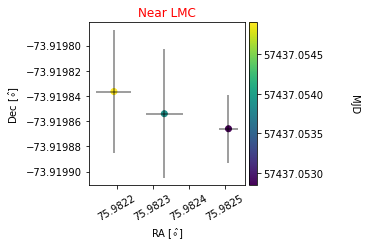

v_ra =  -36.27995065943565 , v_dec =  64.7670283382556


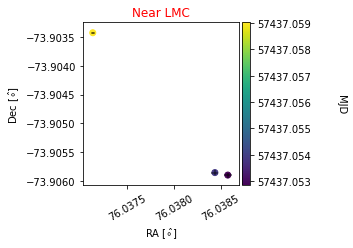

v_ra =  -186.5959357114772 , v_dec =  16.982178034218464


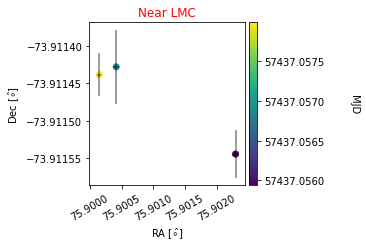

v_ra =  82.42220429681086 , v_dec =  11.506413278092955


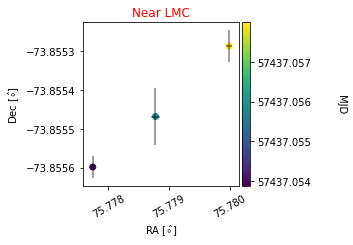

v_ra =  61.16115114849499 , v_dec =  19.15821569314658


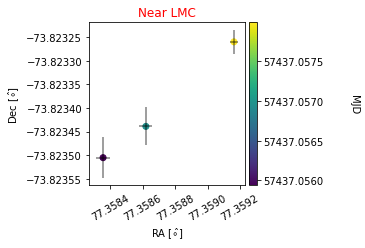

v_ra =  -53.36435560332857 , v_dec =  1.8160119351018675


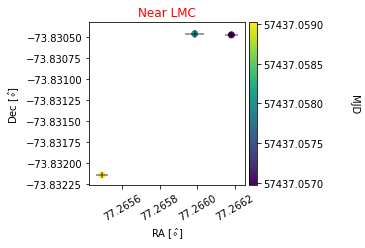

v_ra =  -20.3926157509005 , v_dec =  4.808348667136796


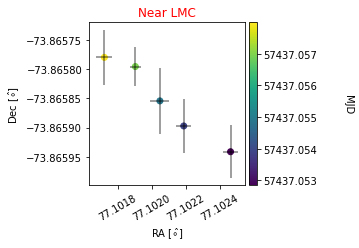

v_ra =  26.065828177118785 , v_dec =  -39.19174967042407


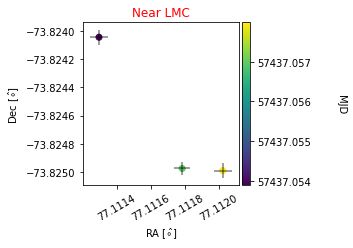

v_ra =  -65.94637293873937 , v_dec =  -157.60405982695212


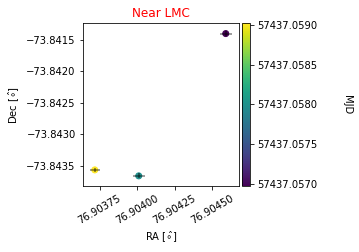

v_ra =  57.34943264627901 , v_dec =  -12.421456736593859


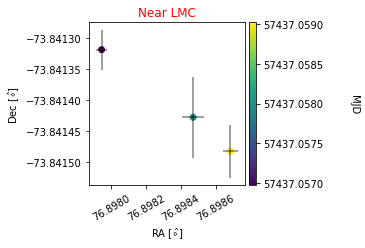

v_ra =  53.526984482188624 , v_dec =  -6.0309105303910036


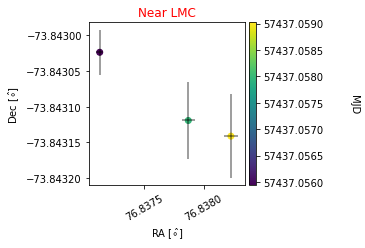

v_ra =  -29.02676799499406 , v_dec =  -0.1930650386149807


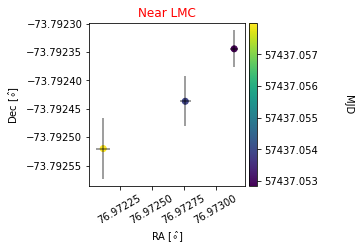

v_ra =  -36.03305543926729 , v_dec =  5.181805188077261


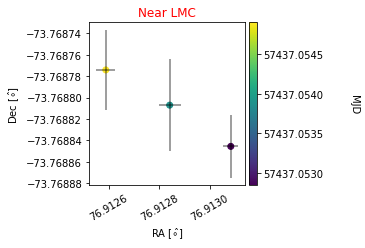

v_ra =  193.6303047166906 , v_dec =  160.31117485375978


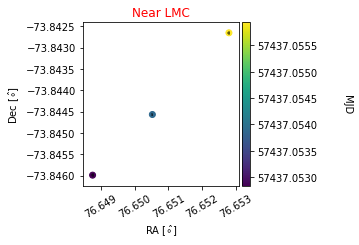

v_ra =  76.57570377406253 , v_dec =  19.40324714670272


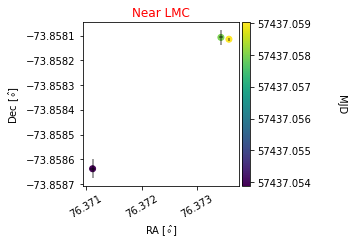

v_ra =  -59.99897642290545 , v_dec =  -8.845578414620176


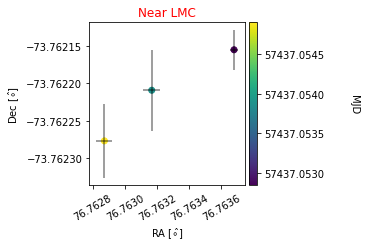

v_ra =  185.72997455080827 , v_dec =  -75.53363769310981


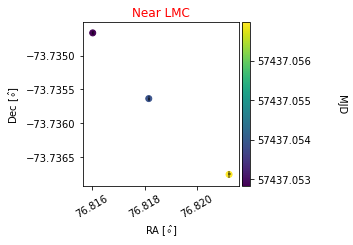

v_ra =  18.61080543509708 , v_dec =  -15.100912860484236


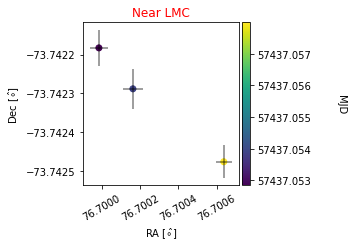

v_ra =  -38.89390983121742 , v_dec =  6.465340365363141


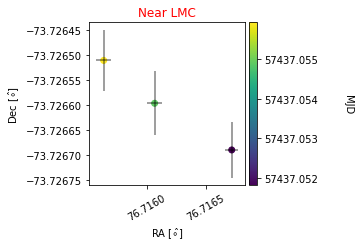

v_ra =  -58.10189921665778 , v_dec =  -102.454785447765


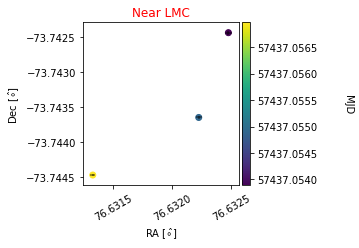

v_ra =  86.60794196549854 , v_dec =  -23.730125754678753


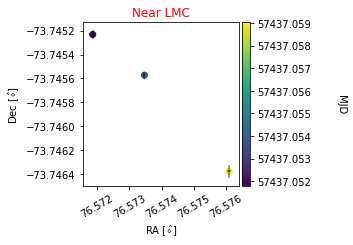

v_ra =  -111.78158969511408 , v_dec =  5.743687393332604


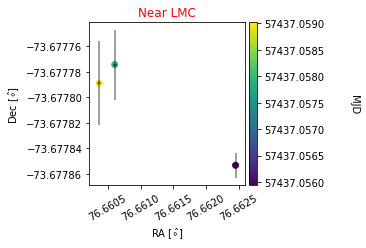

v_ra =  -87.41696950598875 , v_dec =  93.27788913531447


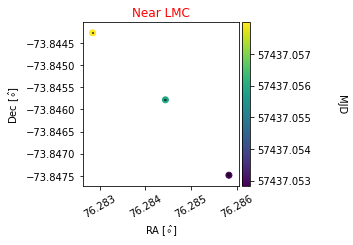

v_ra =  56.578514836096474 , v_dec =  41.64000869330317


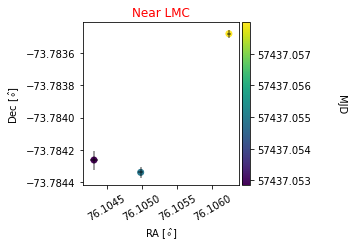

v_ra =  -89.23407452291868 , v_dec =  101.73203350446165


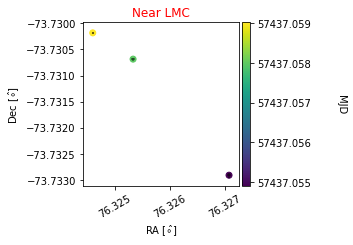

v_ra =  -73.06051470304493 , v_dec =  15.658187661127622


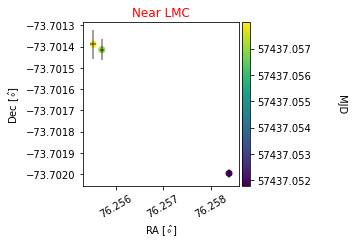

v_ra =  62.81529041744543 , v_dec =  45.835473118711555


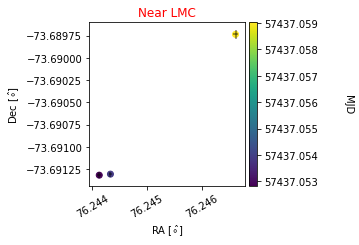

v_ra =  151.994582251954 , v_dec =  0.32485144974964014


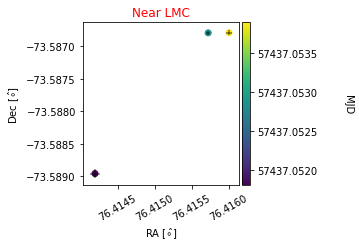

v_ra =  -112.54128673499214 , v_dec =  -171.85422001625193


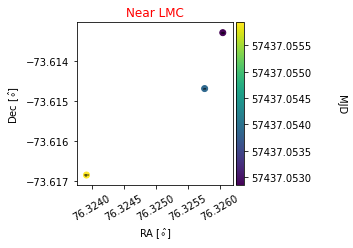

v_ra =  -20.457854014635398 , v_dec =  4.061067555067604


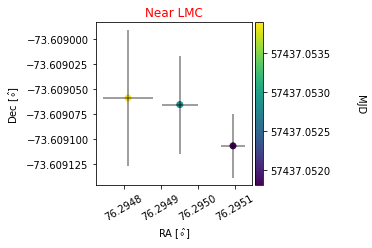

v_ra =  122.2483197298293 , v_dec =  10.102702274133733


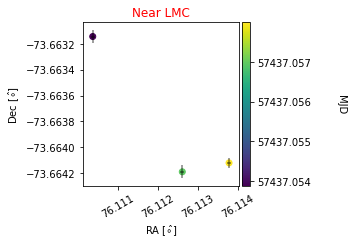

v_ra =  31.167017570860548 , v_dec =  -3.8685153900933806


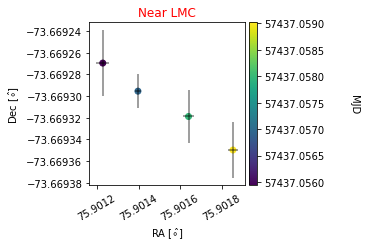

v_ra =  -62.348877328182446 , v_dec =  8.297055910230883


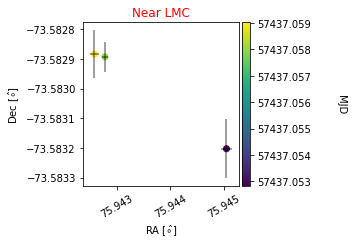

v_ra =  -19.21719105126991 , v_dec =  1.8178816747037025


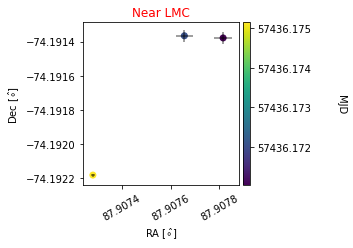

v_ra =  -17.457757915280293 , v_dec =  5.2574293773981875


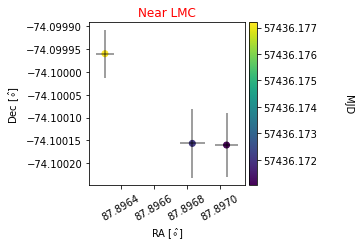

v_ra =  -104.62489756728083 , v_dec =  -83.60531783268337


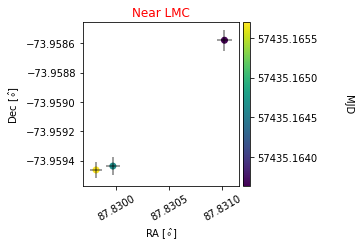

v_ra =  -18.759384093792292 , v_dec =  -19.316980232347074


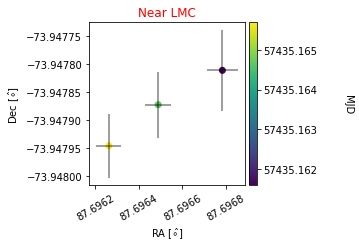

v_ra =  -73.07956069686699 , v_dec =  -105.00489023452201


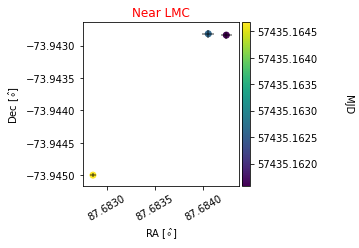

v_ra =  121.609605481968 , v_dec =  10.805250659128568


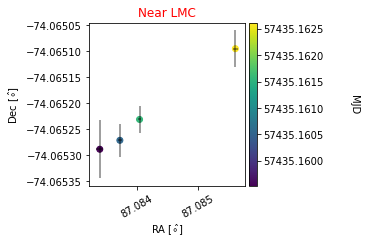

v_ra =  178.65110265212158 , v_dec =  131.34074880598365


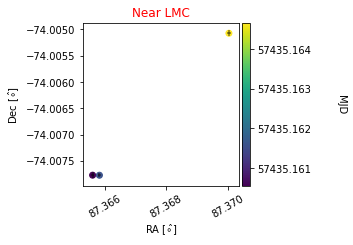

v_ra =  48.3935500761524 , v_dec =  8.838585972745367


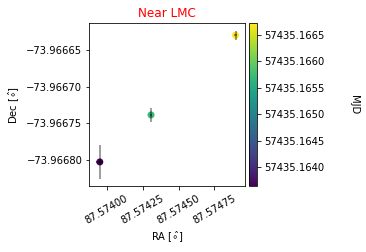

v_ra =  270.9848114015129 , v_dec =  62.39274437322592


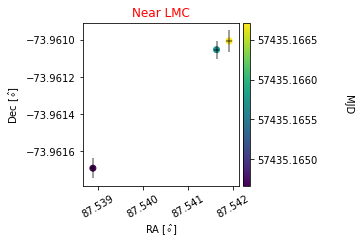

v_ra =  153.01519872634756 , v_dec =  -130.57133986726228


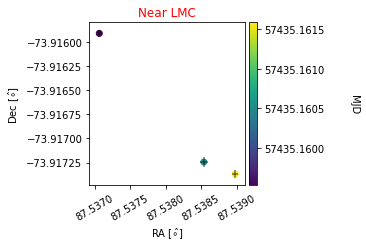

v_ra =  -129.61338617712087 , v_dec =  27.102386816261742


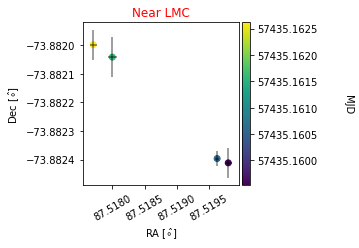

v_ra =  11.521166610286334 , v_dec =  0.1746393483843317


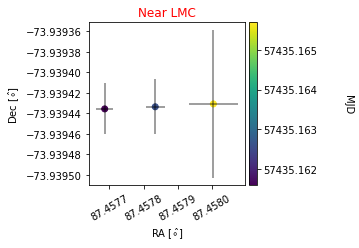

v_ra =  -60.37808795297599 , v_dec =  7.813364741965825


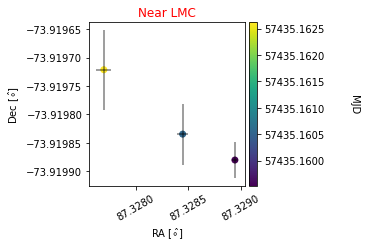

v_ra =  -171.86401965680372 , v_dec =  -30.63831588719872


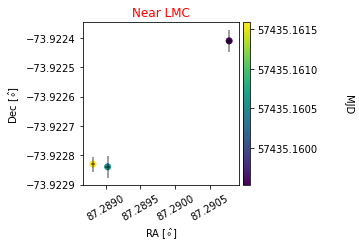

v_ra =  50.73303305885849 , v_dec =  -8.227033588731937


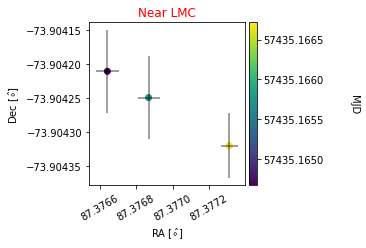

v_ra =  -89.41187057058555 , v_dec =  -37.257366194436266


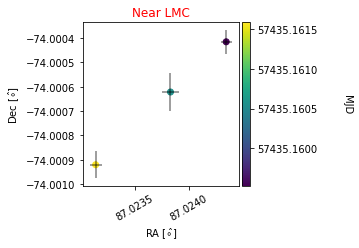

v_ra =  -289.0500133123217 , v_dec =  -23.507613107405763


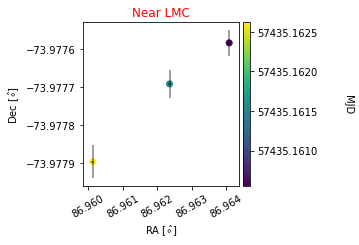

v_ra =  -151.496576039598 , v_dec =  -91.65808510270206


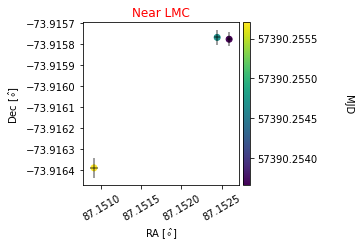

v_ra =  -18.559839318833422 , v_dec =  -2.2232762633273606


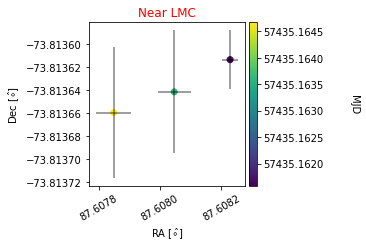

v_ra =  20.33881480890108 , v_dec =  4.151293992592197


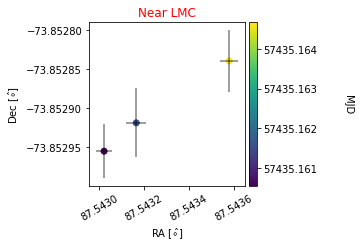

v_ra =  -115.19009001503224 , v_dec =  127.29623273484412


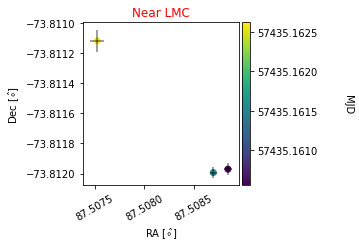

v_ra =  -137.39674385479188 , v_dec =  199.98919035325346


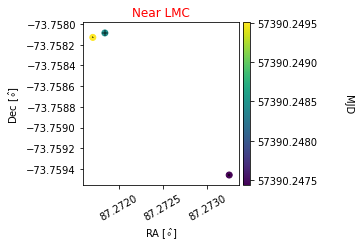

v_ra =  -2.8807047627789646 , v_dec =  18.24648083385559


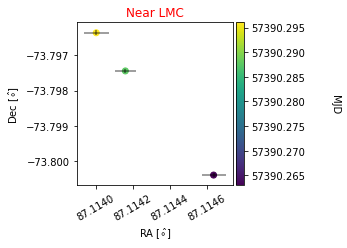

v_ra =  -122.03874051706181 , v_dec =  300.9585060395326


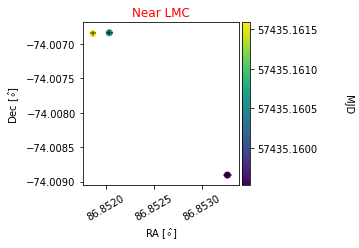

v_ra =  -174.20364597245373 , v_dec =  -54.071862750644875


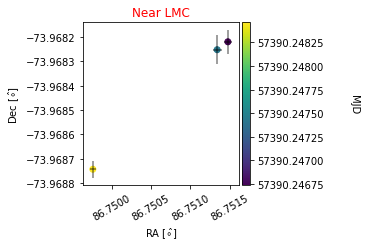

v_ra =  158.70695789927387 , v_dec =  49.397489148196335


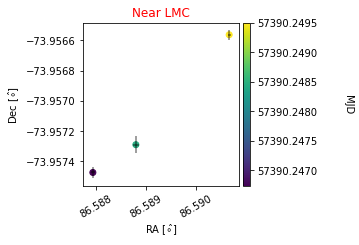

v_ra =  104.42932978663714 , v_dec =  15.710437457521538


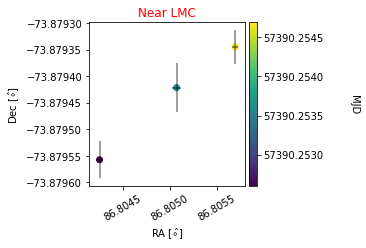

v_ra =  5.605461137880371 , v_dec =  -30.776116629382603


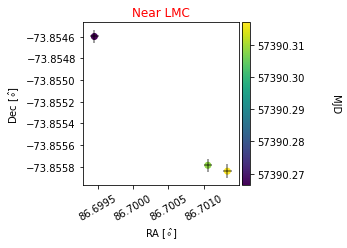

v_ra =  8.496149873565658 , v_dec =  0.6211904994569694


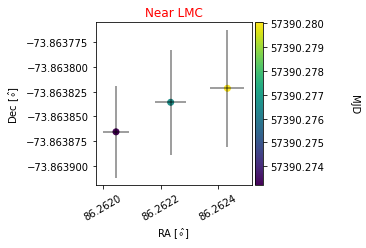

v_ra =  -35.14987968264699 , v_dec =  49.96744822047766


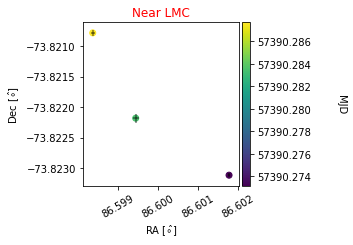

v_ra =  26.99563178123151 , v_dec =  60.59089723257981


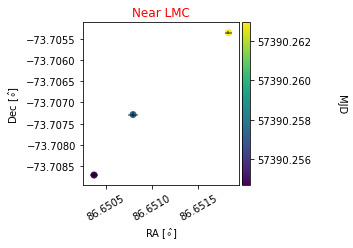

v_ra =  -7.452157369312666 , v_dec =  12.896124496035746


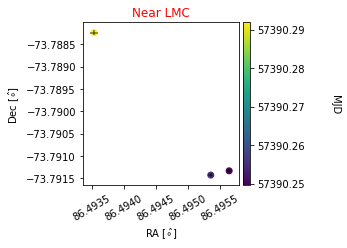

v_ra =  25.51956986608137 , v_dec =  1.1102615662899797


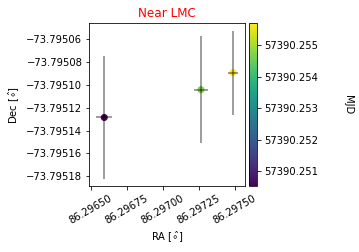

v_ra =  -23.72442928232151 , v_dec =  1.9133509094134518


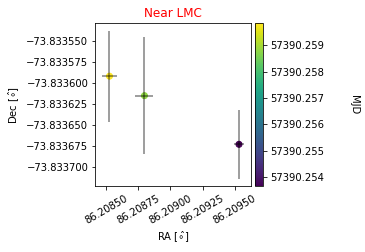

v_ra =  -52.768290864785804 , v_dec =  -315.2941401986348


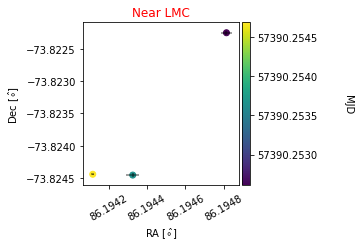

v_ra =  11.470126225627501 , v_dec =  -14.465888757542038


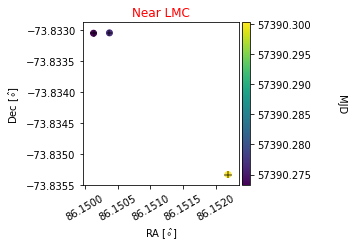

v_ra =  23.649105841046012 , v_dec =  -0.5427612760779154


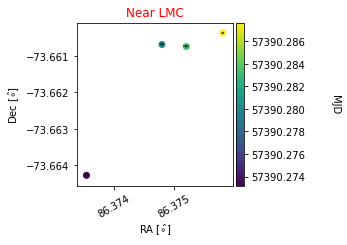

v_ra =  4.08315290468094 , v_dec =  -3.24277857476339


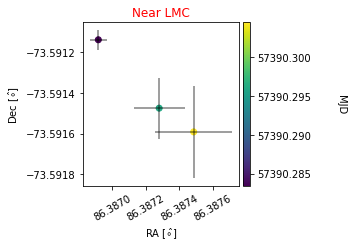

v_ra =  -21.81708889533292 , v_dec =  14.352442775770918


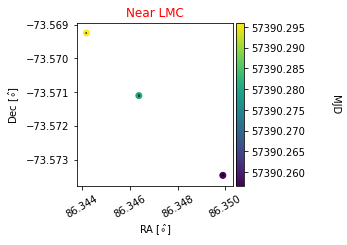

v_ra =  3.4520176442388877 , v_dec =  0.530593293266279


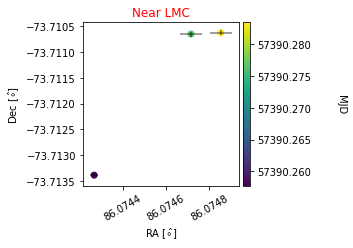

v_ra =  -3.1023596483886173 , v_dec =  -2.4883584985294145


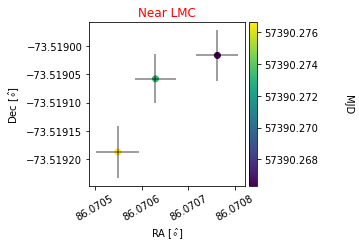

v_ra =  53.5044619594041 , v_dec =  12.532063090178903


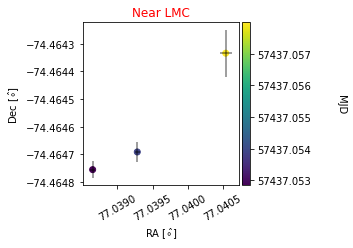

v_ra =  -50.586565502734054 , v_dec =  -10.509214234780663


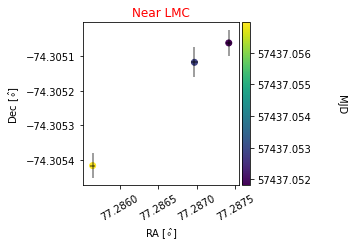

v_ra =  97.87992182118057 , v_dec =  200.9775535772189


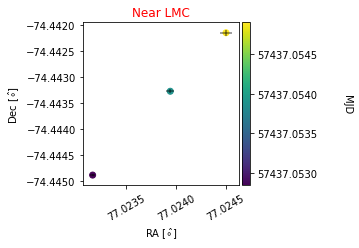

v_ra =  -56.29444064796085 , v_dec =  -1.4601313366257536


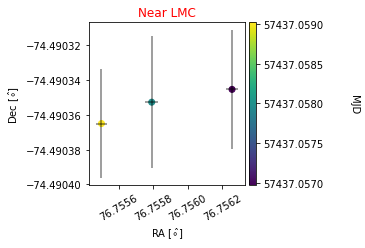

v_ra =  125.29955313711639 , v_dec =  240.30328393809532


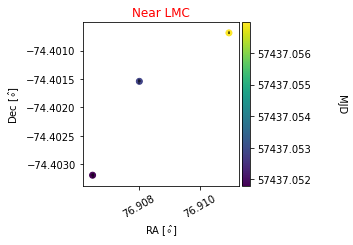

v_ra =  -115.74264940080258 , v_dec =  200.83365005184774


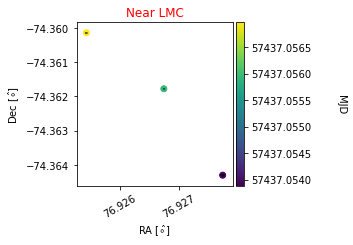

v_ra =  -15.610182628530938 , v_dec =  12.022248758112326


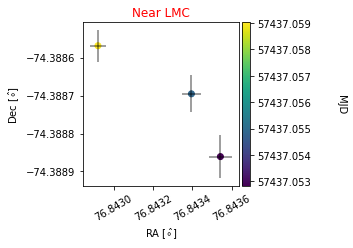

v_ra =  -126.54199437046746 , v_dec =  289.15298509712017


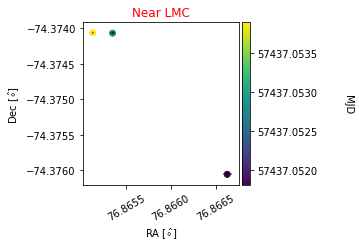

v_ra =  28.488830890107064 , v_dec =  -2.5959383922556456


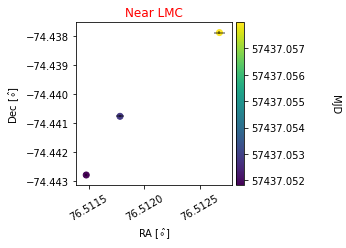

v_ra =  -13.401197943915227 , v_dec =  2.0503546131059704


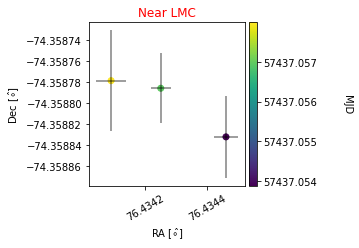

v_ra =  -73.4035970235975 , v_dec =  37.937692147941696


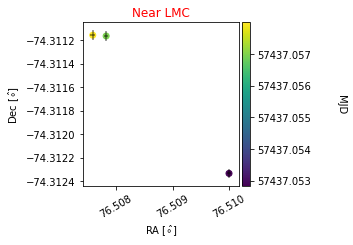

v_ra =  78.39639526005547 , v_dec =  -71.92300220929828


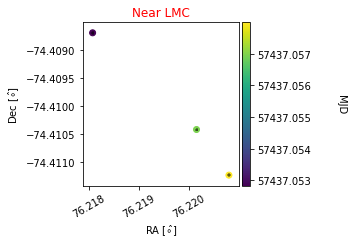

v_ra =  78.41454638238477 , v_dec =  -4.5395380474372


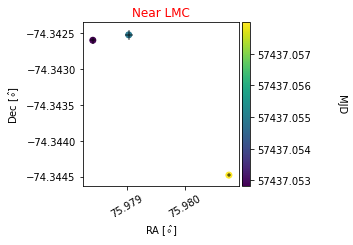

v_ra =  -124.02146191732292 , v_dec =  10.36602637756358


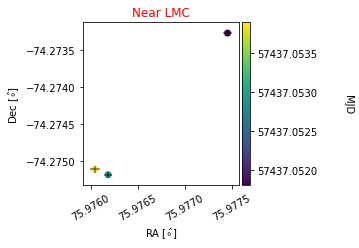

v_ra =  134.1989446396318 , v_dec =  15.304789952247992


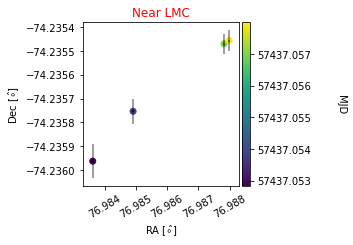

v_ra =  123.05205771299576 , v_dec =  231.7916636987775


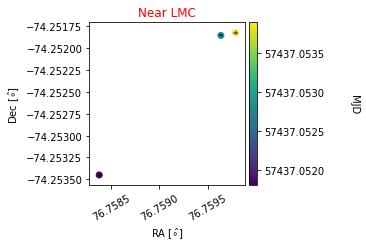

v_ra =  -121.48868948263147 , v_dec =  -6.490550419901774


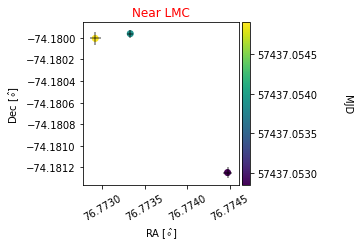

v_ra =  -180.92190632321783 , v_dec =  -186.8141354412544


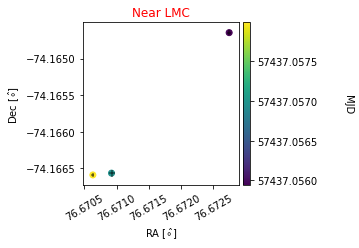

v_ra =  -46.862226442036274 , v_dec =  9.427051041467081


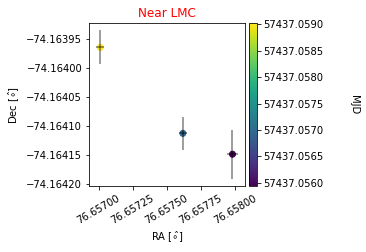

v_ra =  -166.34490161652633 , v_dec =  17.616854344120558


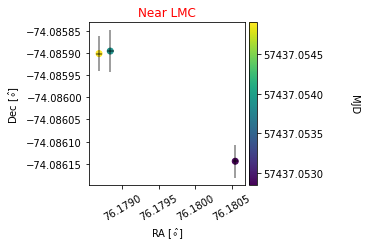

v_ra =  28.610686268957796 , v_dec =  -19.574966201641864


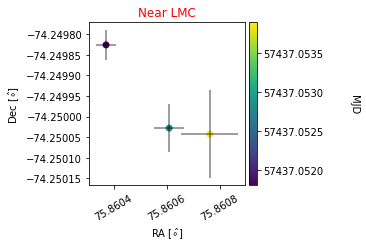

v_ra =  -131.59628023000224 , v_dec =  -5.932801006004165


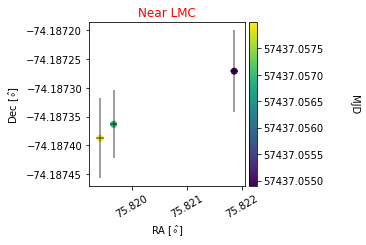

v_ra =  47.8857858635696 , v_dec =  -334.5254847145745


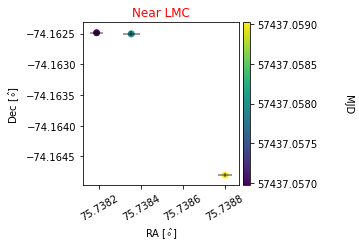

v_ra =  -73.75089253333675 , v_dec =  -63.18387718216565


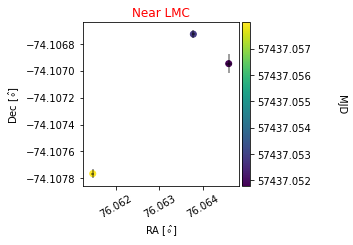

v_ra =  -81.59263458130016 , v_dec =  1.237742373223006


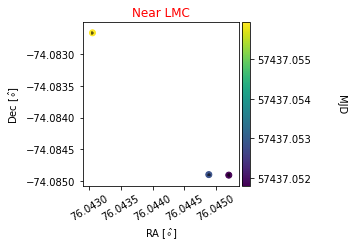

v_ra =  57.262286681229874 , v_dec =  12.481277825730622


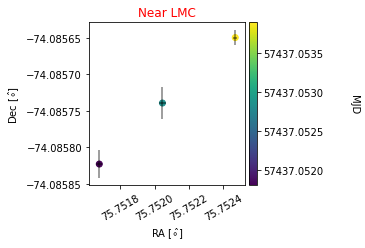

v_ra =  -11.268883690899424 , v_dec =  6.432649422769607


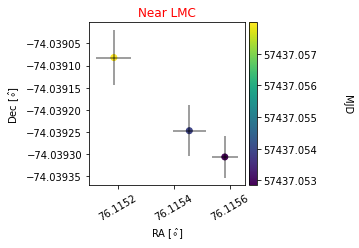

v_ra =  113.1621994311776 , v_dec =  -159.27554825989395


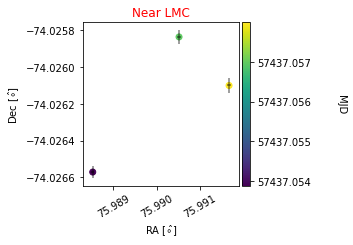

v_ra =  28.220175492380104 , v_dec =  2.966477978336535


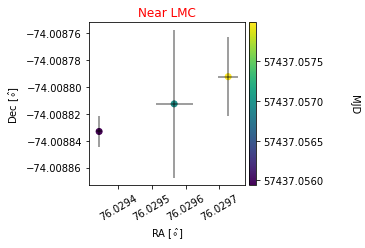

v_ra =  -15.532117569874552 , v_dec =  -34.69176643445654


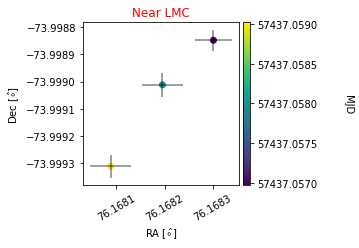

v_ra =  63.27281956927006 , v_dec =  -122.839748041088


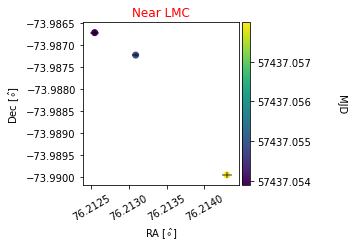

v_ra =  -42.27495137414244 , v_dec =  -32.05825215084359


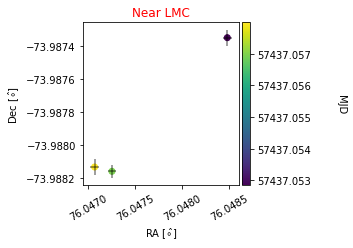

v_ra =  16.53735945046613 , v_dec =  70.21393420263433


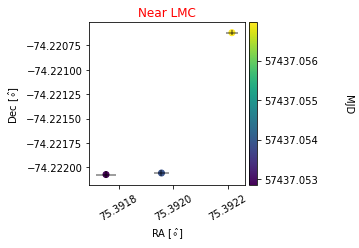

v_ra =  -63.70344339563905 , v_dec =  23.887126918115772


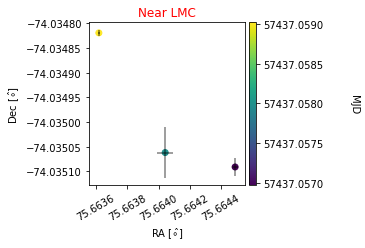

v_ra =  -68.37298780432242 , v_dec =  -78.17400771850285


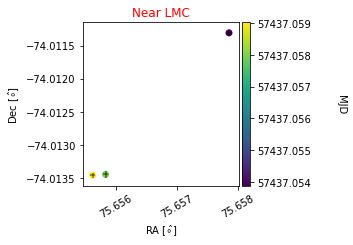

v_ra =  36.87562251393084 , v_dec =  -41.73549054510014


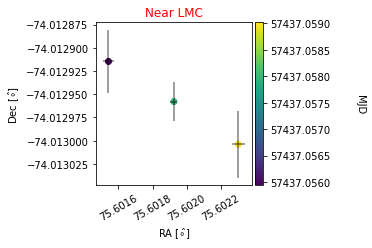

v_ra =  43.10283863942164 , v_dec =  -15.022340841725152


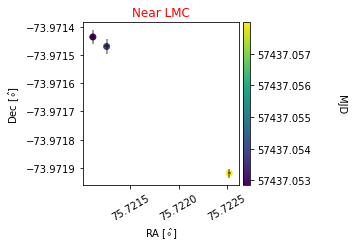

v_ra =  -43.855211864052 , v_dec =  10.289202557089508


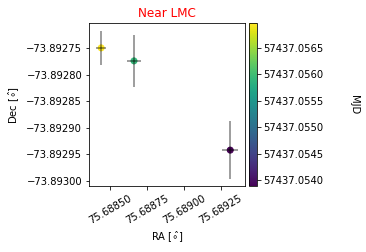

v_ra =  67.84977200229976 , v_dec =  -2.886784164182002


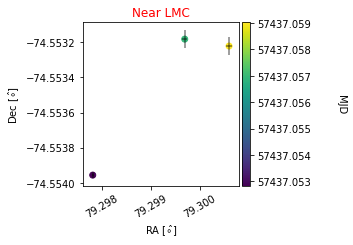

v_ra =  -77.4668902143165 , v_dec =  162.38270237122768


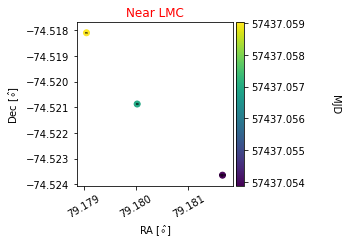

v_ra =  46.2151323025885 , v_dec =  0.923547405832141


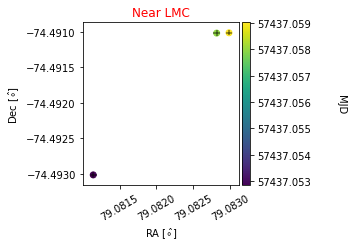

v_ra =  -74.84569881035586 , v_dec =  7.285697891607487


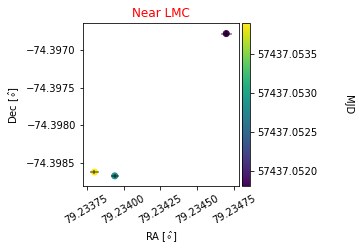

v_ra =  229.47372483177006 , v_dec =  47.29113532314239


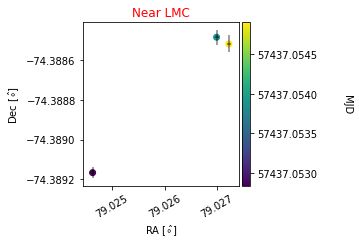

v_ra =  177.84240807127574 , v_dec =  88.84331622375196


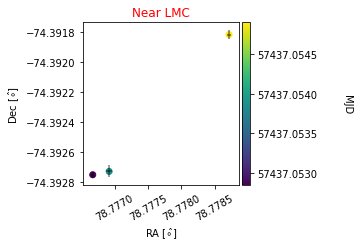

v_ra =  -102.98822417186108 , v_dec =  -53.927296668422265


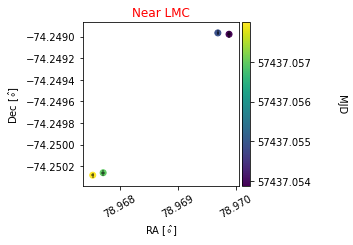

v_ra =  -103.98001026187949 , v_dec =  -75.46799973452035


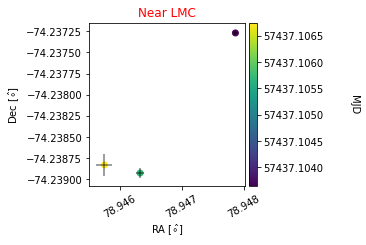

v_ra =  154.5078566685714 , v_dec =  88.45703480083709


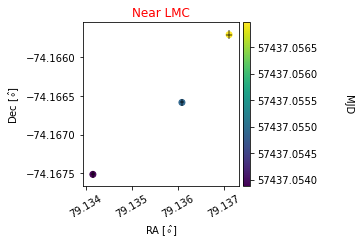

v_ra =  12.948920186971153 , v_dec =  7.791242349702119


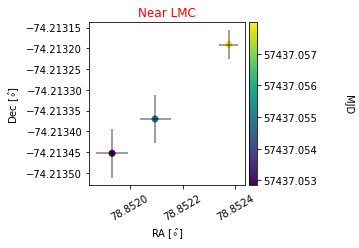

v_ra =  -6.495340787266815 , v_dec =  4.772776093372111


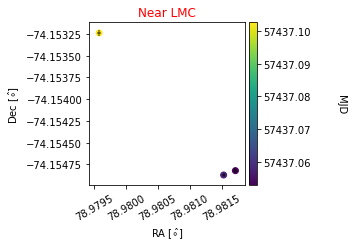

v_ra =  -44.67062535852034 , v_dec =  -32.87354905371451


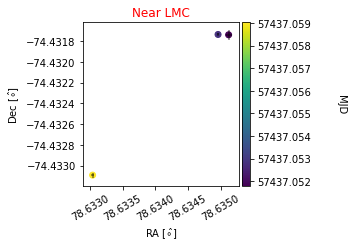

v_ra =  11.383446292075178 , v_dec =  -208.30251651484215


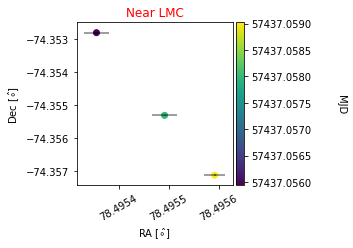

v_ra =  -51.208997343568946 , v_dec =  -5.069411284695495


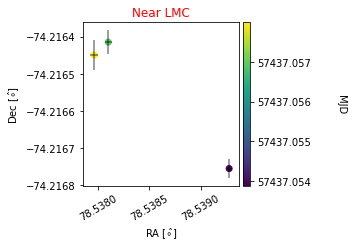

v_ra =  -128.32511549028797 , v_dec =  -54.62511447686097


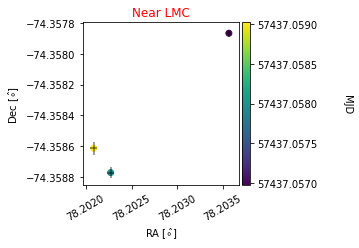

v_ra =  -211.24552779894864 , v_dec =  -316.5585368663072


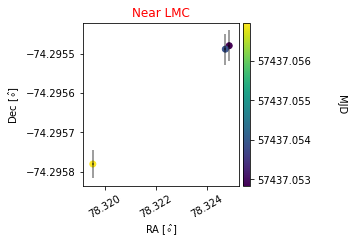

v_ra =  20.63065321539367 , v_dec =  -80.17423001014484


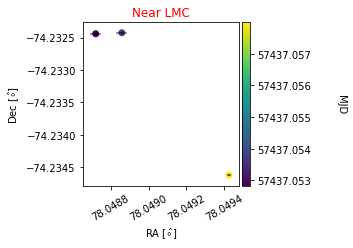

v_ra =  77.31726290460067 , v_dec =  -5.442296743956469


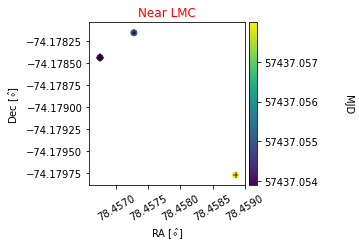

v_ra =  153.44708603729129 , v_dec =  -58.37959678675253


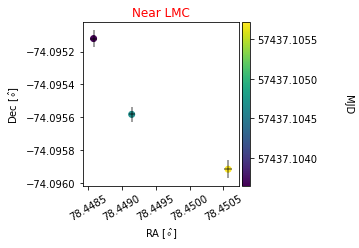

v_ra =  -72.72065363179796 , v_dec =  22.868397404080582


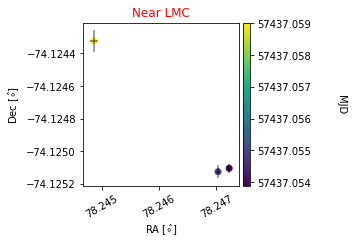

v_ra =  -38.58882230418712 , v_dec =  -37.87731237875278


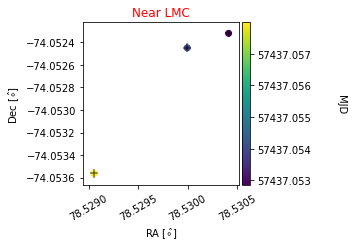

v_ra =  -70.69611630267124 , v_dec =  7.930688354276016


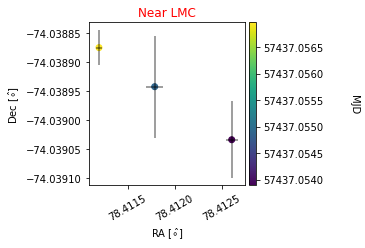

v_ra =  107.68163520605964 , v_dec =  -130.84871655555904


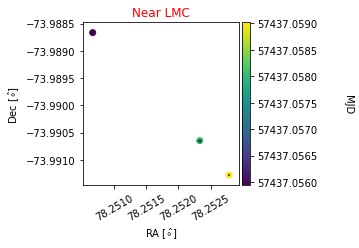

v_ra =  43.78302863149829 , v_dec =  154.7091196986729


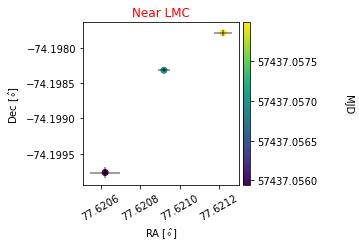

v_ra =  124.19411305978885 , v_dec =  84.74359350397619


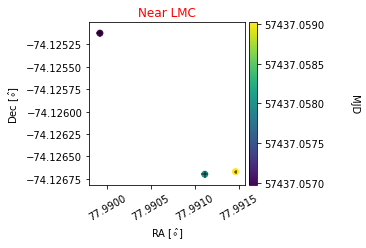

v_ra =  -29.95674944206665 , v_dec =  -47.40673882546372


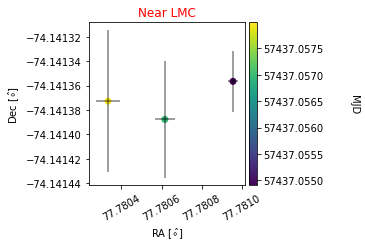

v_ra =  42.550957267438 , v_dec =  -9.151542522948143


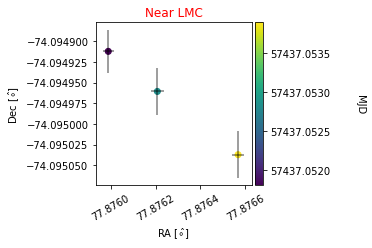

v_ra =  -42.913707336282584 , v_dec =  -1.98138660169193


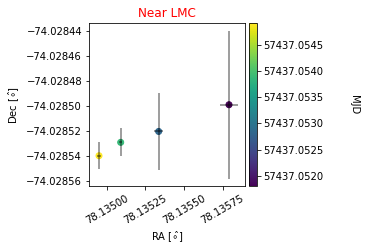

v_ra =  86.8896902860161 , v_dec =  7.243708757134233


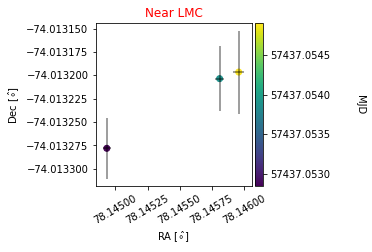

v_ra =  -24.434920482952876 , v_dec =  9.650112492195047


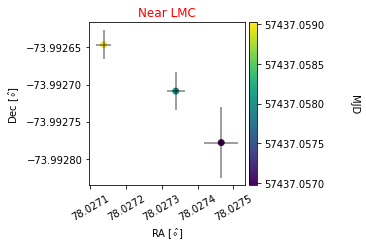

v_ra =  -28.58784495582843 , v_dec =  5.668922132577202


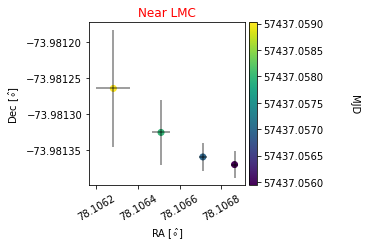

v_ra =  -60.726941065369395 , v_dec =  106.96738021217215


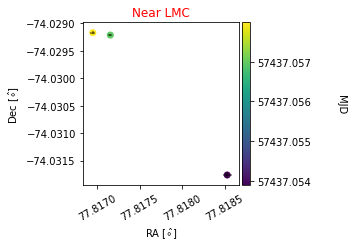

v_ra =  -30.65518031749785 , v_dec =  -5.387609780652177


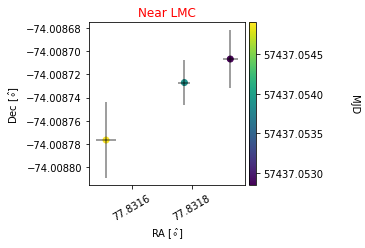

v_ra =  199.81699936519598 , v_dec =  -21.91518870929384


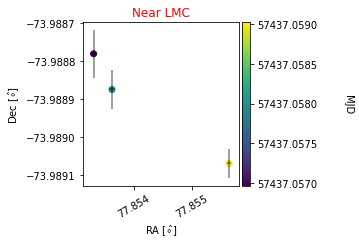

v_ra =  115.73284265509231 , v_dec =  64.91296239854753


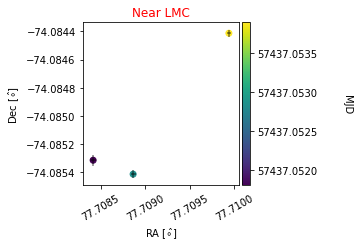

v_ra =  -61.341313730348254 , v_dec =  41.16646375436598


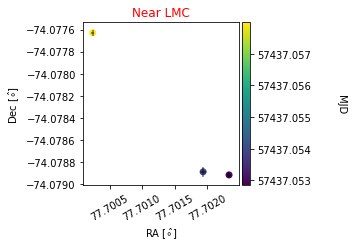

v_ra =  -131.589058783313 , v_dec =  355.81351459380653


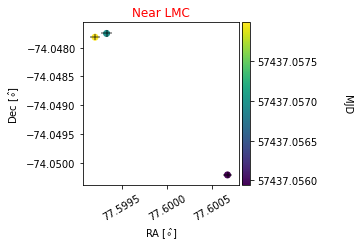

v_ra =  140.64895705627126 , v_dec =  142.7765338214019


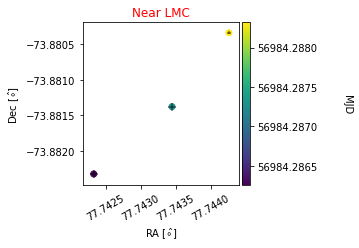

v_ra =  22.293630847965357 , v_dec =  1.7846483057592202


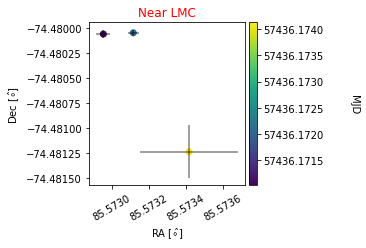

v_ra =  -6.623910017923776 , v_dec =  -1.2250444420950142


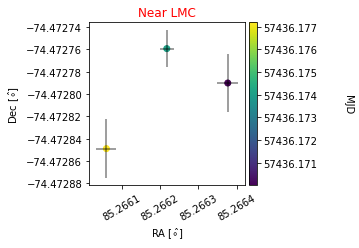

v_ra =  -204.78239309591484 , v_dec =  63.64182478634913


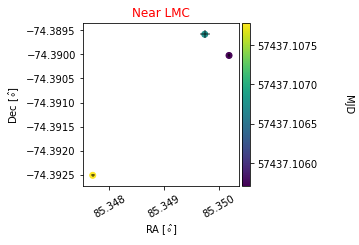

v_ra =  141.4669803447102 , v_dec =  -72.96268551761543


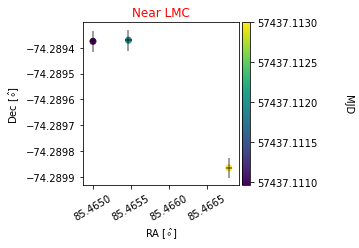

v_ra =  -310.79283850931296 , v_dec =  120.31627122044853


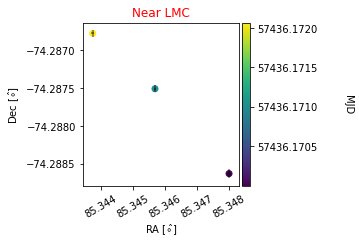

v_ra =  -113.93122679129226 , v_dec =  -113.61321109692786


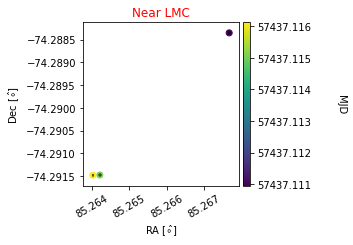

v_ra =  61.8283804467483 , v_dec =  125.1407857330356


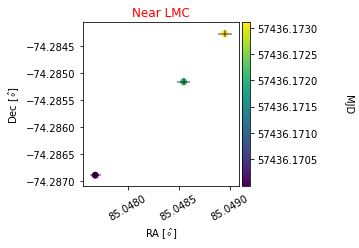

v_ra =  172.41238241019286 , v_dec =  92.0763375820037


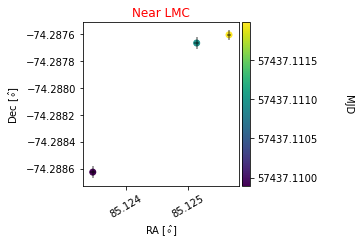

v_ra =  251.0599252652229 , v_dec =  95.66962339072349


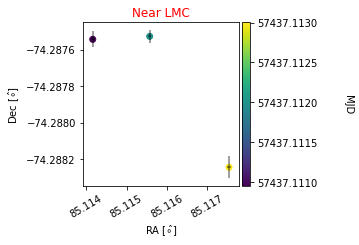

v_ra =  68.55404119969111 , v_dec =  -13.336618154627537


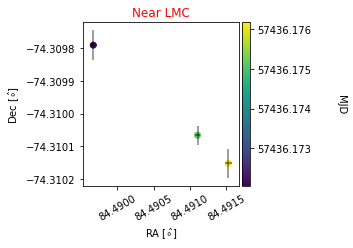

v_ra =  -9.153948877379182 , v_dec =  0.2607674623845562


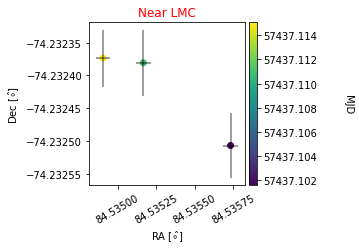

v_ra =  154.20390799030474 , v_dec =  -259.33819215155285


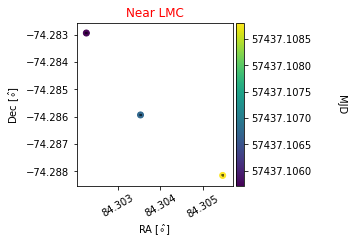

v_ra =  43.09006060199173 , v_dec =  10.704038350397092


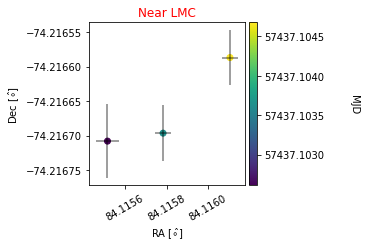

v_ra =  -32.520359946754944 , v_dec =  -20.065465303169557


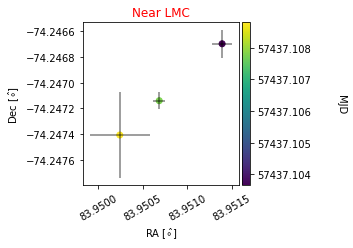

v_ra =  242.50069838331183 , v_dec =  -0.357335745615685


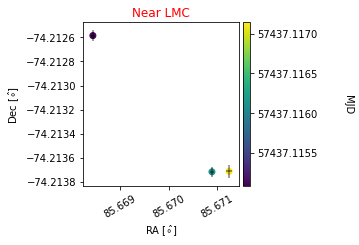

v_ra =  -50.67124800823959 , v_dec =  32.504935554211976


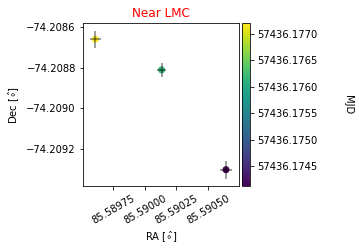

v_ra =  -104.33331861130624 , v_dec =  53.346459701776155


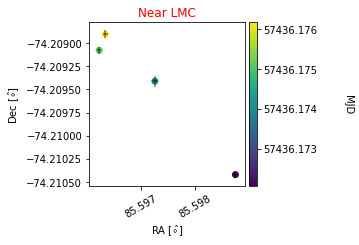

v_ra =  -33.552209504018215 , v_dec =  4.00621647275436


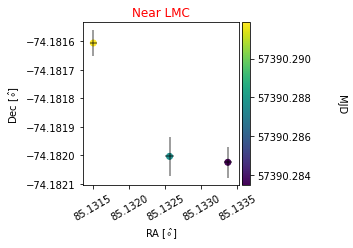

v_ra =  155.55521169521663 , v_dec =  123.63348422089327


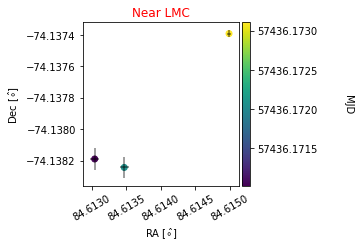

v_ra =  -4.023237775886761 , v_dec =  0.9831829605816078


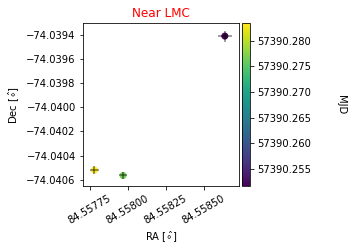

v_ra =  2.669640616485861 , v_dec =  0.4632234346185735


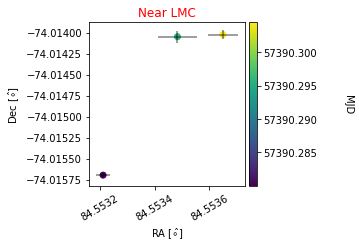

v_ra =  77.27619941003114 , v_dec =  22.818281294798897


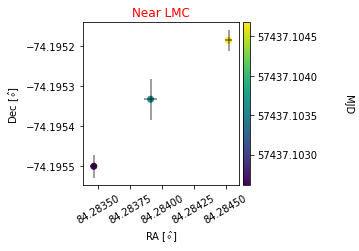

v_ra =  76.51090092112705 , v_dec =  -3.721927152152615


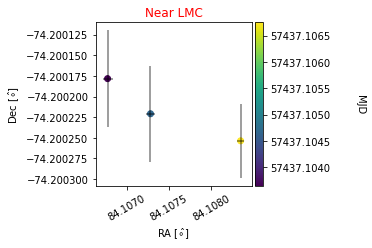

v_ra =  16.046907608107468 , v_dec =  -5.882284150489301


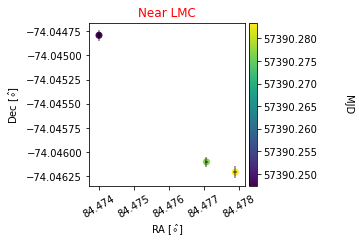

v_ra =  -188.81829360013504 , v_dec =  46.169620522514464


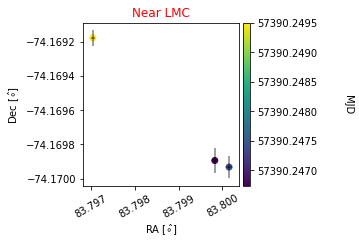

v_ra =  -138.5071816606952 , v_dec =  -30.906139541797


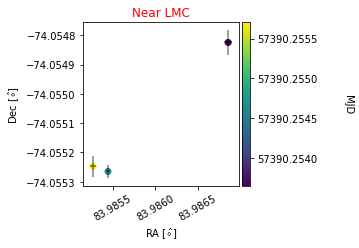

v_ra =  -40.05459802663051 , v_dec =  6.008557661455124


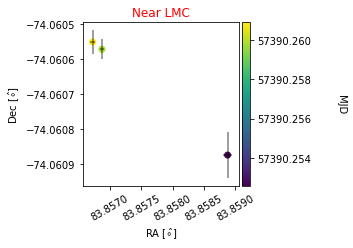

v_ra =  -31.601919858036997 , v_dec =  48.35615415556936


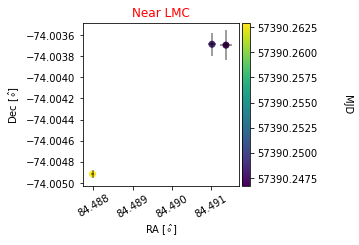

v_ra =  2.694096972529689 , v_dec =  -0.15597167006870857


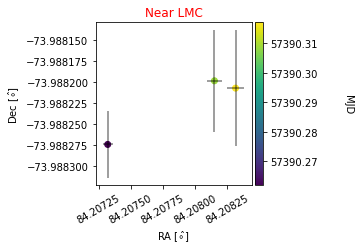

v_ra =  -13.416854266240904 , v_dec =  16.63392892190836


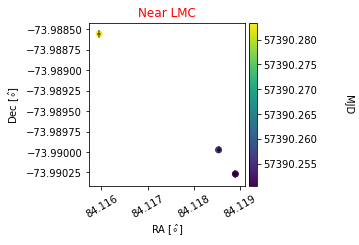

v_ra =  -75.09212373749162 , v_dec =  -36.73496959551206


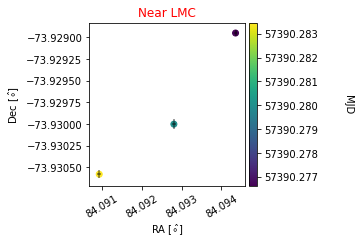

v_ra =  -295.99194180716637 , v_dec =  100.85728958354439


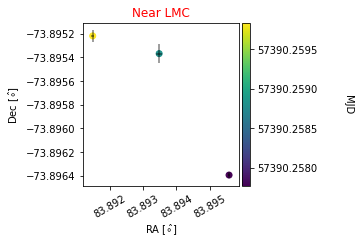

v_ra =  -55.59338178754876 , v_dec =  6.641670277806302


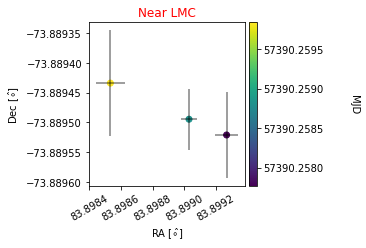

v_ra =  -31.08797760758809 , v_dec =  2.928951665001913


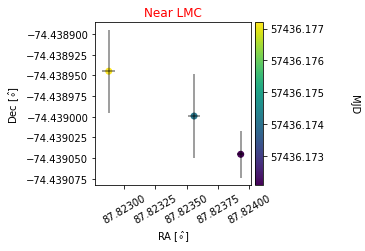

v_ra =  -104.96451878573873 , v_dec =  101.77534348549806


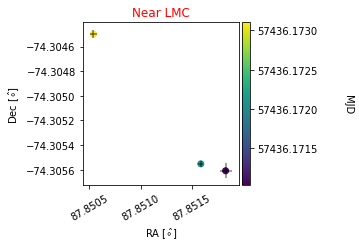

v_ra =  -89.8137633265983 , v_dec =  -7.794757257467311


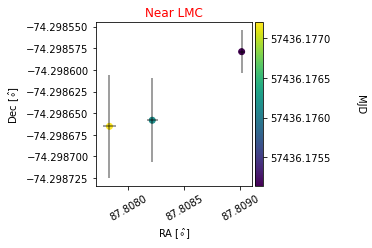

v_ra =  -198.51462950775954 , v_dec =  83.42018949821535


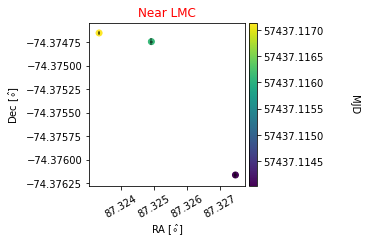

v_ra =  92.39858713072601 , v_dec =  -29.79678234929923


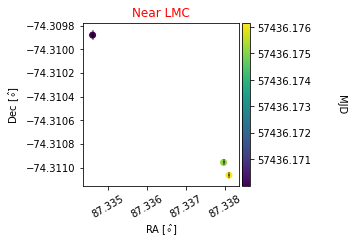

v_ra =  71.99406363317209 , v_dec =  -143.57443165922396


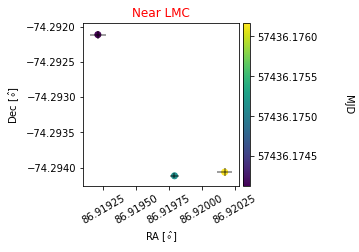

v_ra =  -82.51704311240756 , v_dec =  -73.6030126758338


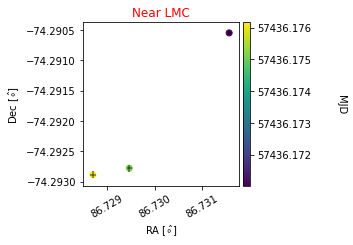

v_ra =  22.370854315525648 , v_dec =  -4.348497904738577


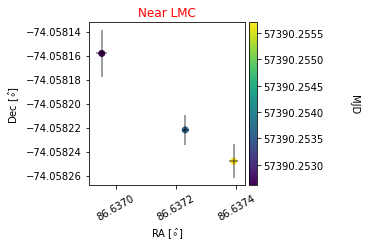

v_ra =  15.592044444115189 , v_dec =  -2.9777270691728415


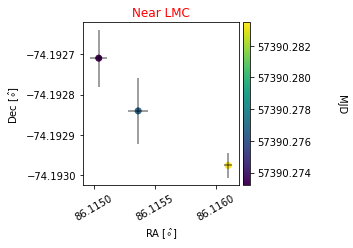

v_ra =  167.4829035033109 , v_dec =  -113.81803511660983


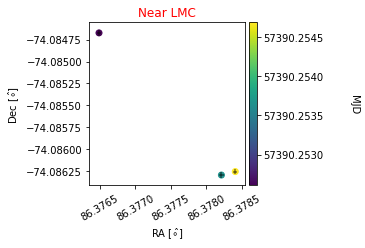

v_ra =  -104.85969970006913 , v_dec =  -112.78014216666953


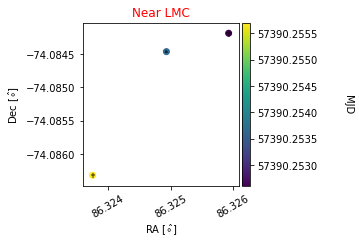

v_ra =  36.90499955505306 , v_dec =  -90.83243441195616


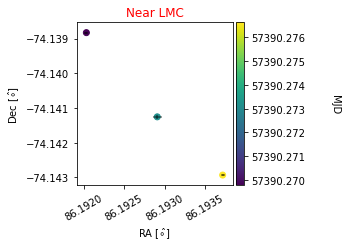

v_ra =  -32.73342587745159 , v_dec =  19.400313318887232


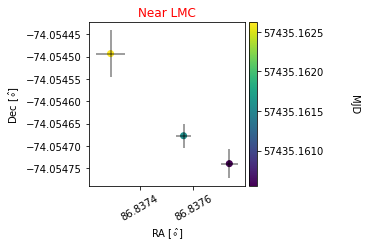

v_ra =  302.40849407746344 , v_dec =  -120.24784097538297


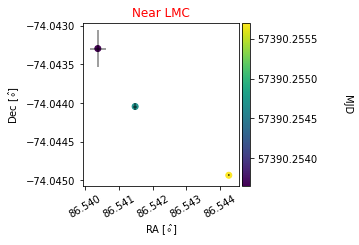

v_ra =  4.391616889981332 , v_dec =  9.62617019685843


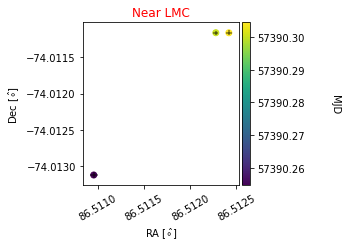

v_ra =  7.441384669731206 , v_dec =  -10.930048989651157


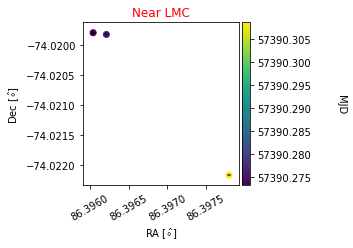

v_ra =  -51.088529403884216 , v_dec =  8.192468092618855


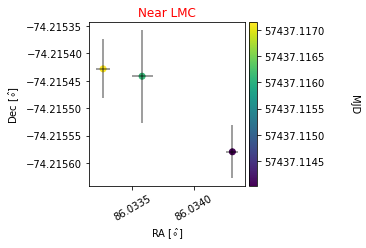

v_ra =  42.47194603359786 , v_dec =  1.618995092990655


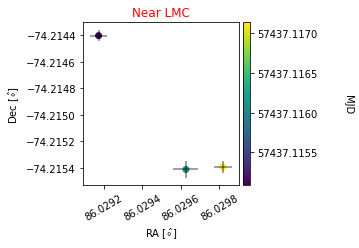

v_ra =  278.5784315682712 , v_dec =  -0.795096311097177


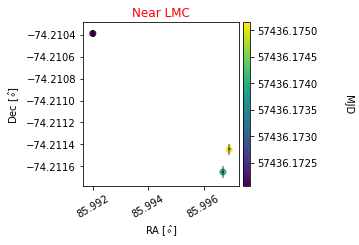

v_ra =  -57.0497416207693 , v_dec =  37.72700000518392


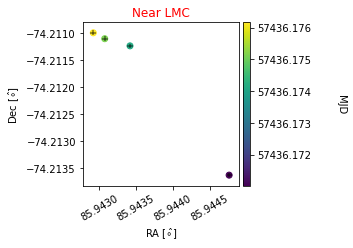

v_ra =  -75.07228013866599 , v_dec =  30.8313550336846


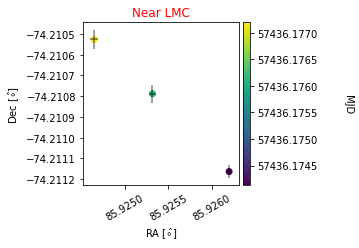

v_ra =  14.014821167660301 , v_dec =  -1.119924605771397


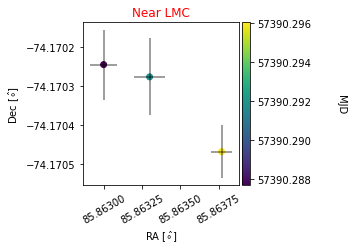

v_ra =  -42.803116554997295 , v_dec =  1.414058518901798


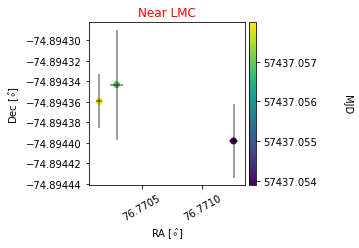

v_ra =  -62.162537924184306 , v_dec =  -33.33589539059719


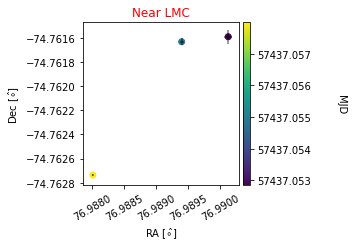

v_ra =  -122.18167529684841 , v_dec =  52.55990934976839


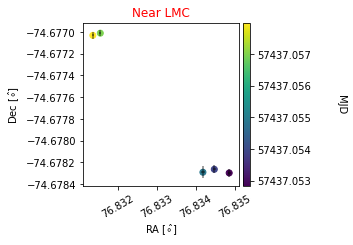

v_ra =  16.473793420433214 , v_dec =  -2.440128772381662


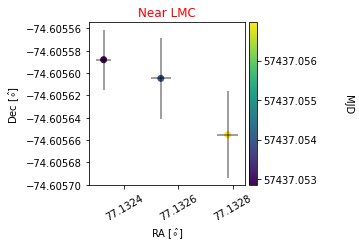

v_ra =  35.16807257499989 , v_dec =  4.818256700703076


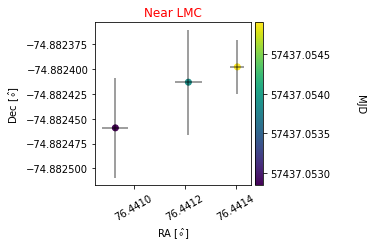

v_ra =  122.01895583236859 , v_dec =  -116.60353297637715


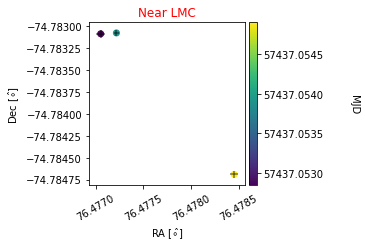

v_ra =  -137.97340444236337 , v_dec =  -18.85573583256939


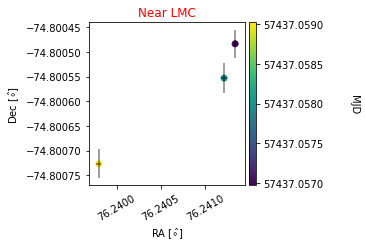

v_ra =  84.88820249414108 , v_dec =  -158.57937983889326


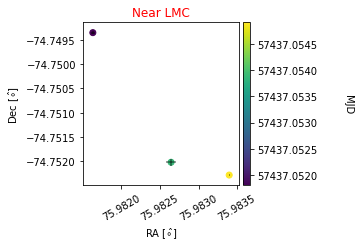

v_ra =  33.50648291986358 , v_dec =  58.00270535204489


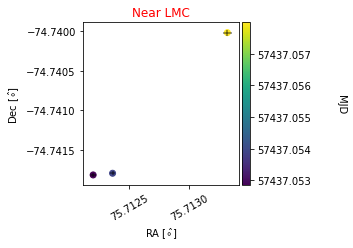

v_ra =  -10.222027527160444 , v_dec =  1.1030823778984447


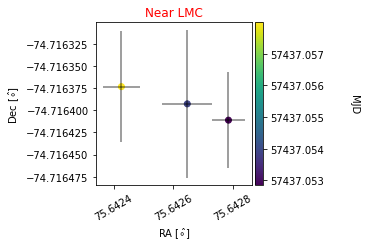

v_ra =  -34.59523675894384 , v_dec =  90.75557273498738


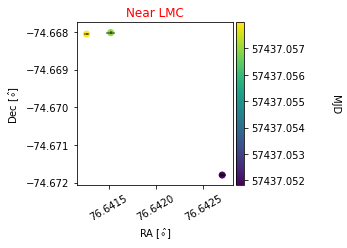

v_ra =  -78.62480091265975 , v_dec =  -130.17958420707


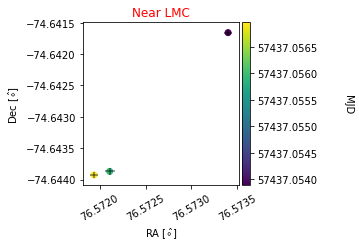

v_ra =  -24.54444104493017 , v_dec =  -37.92023836367792


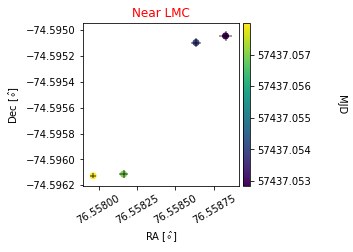

v_ra =  -24.04071941346613 , v_dec =  -45.77355337746787


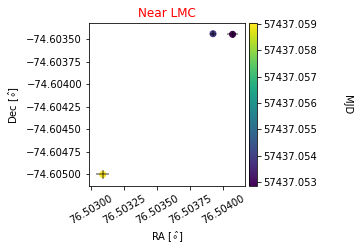

v_ra =  -20.000525637592368 , v_dec =  -34.68552694043563


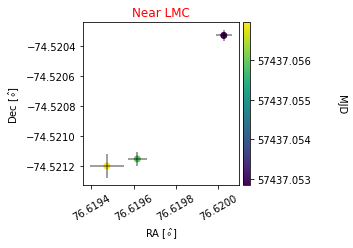

v_ra =  60.48832956519269 , v_dec =  1.9118560420585726


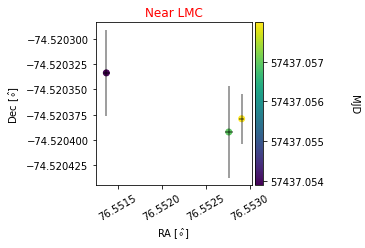

v_ra =  30.455217824634786 , v_dec =  -8.57677236890587


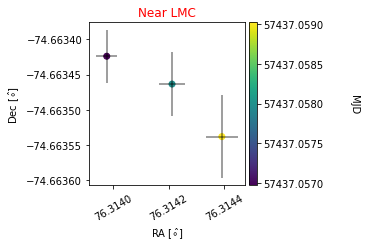

v_ra =  111.42662051722317 , v_dec =  94.26069764555389


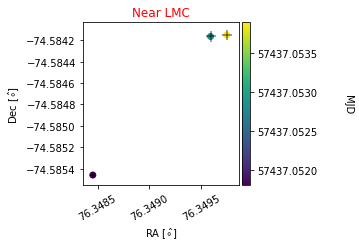

v_ra =  -51.74741573011178 , v_dec =  1.7049462583538182


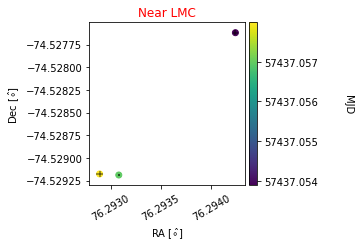

v_ra =  30.69217272196198 , v_dec =  -141.2254970051204


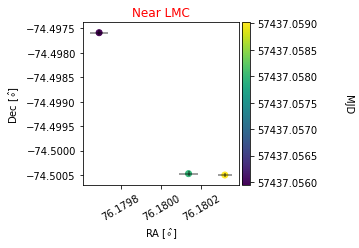

v_ra =  41.8599621010567 , v_dec =  2.6275316295293285


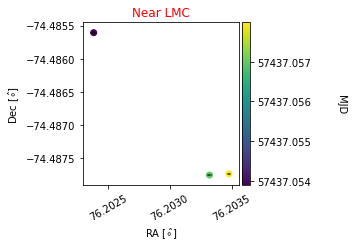

v_ra =  32.539013669111206 , v_dec =  4.806668319577036


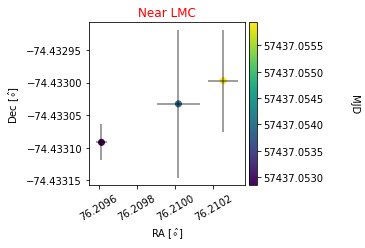

v_ra =  -203.68772321404035 , v_dec =  104.03401391803435


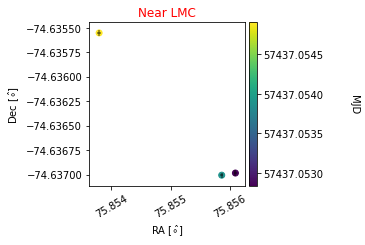

v_ra =  272.49574220584185 , v_dec =  193.28925598528485


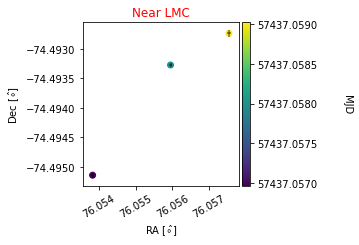

v_ra =  19.208052476668808 , v_dec =  -18.942887130135258


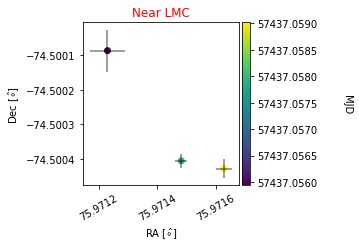

v_ra =  163.5233479322609 , v_dec =  0.535506302451413


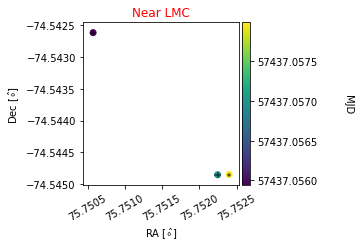

v_ra =  27.412436250962546 , v_dec =  5.246917711971332


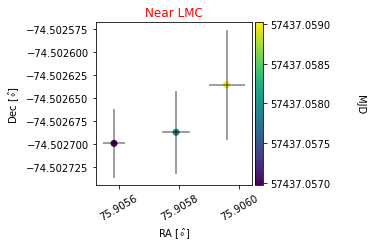

v_ra =  134.51302585694432 , v_dec =  -19.146837274157384


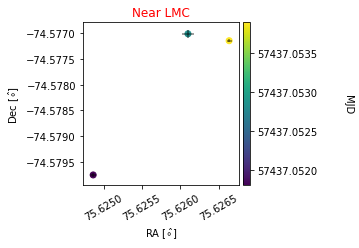

v_ra =  223.79038763902096 , v_dec =  19.104845179337033


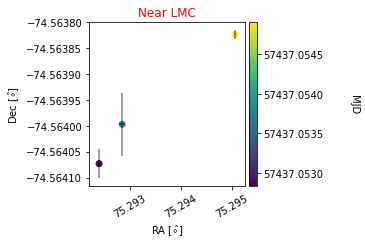

v_ra =  -98.21672932855296 , v_dec =  1.2012623130984397


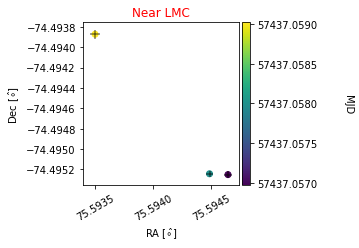

v_ra =  -18.244339574151287 , v_dec =  7.396647650905909


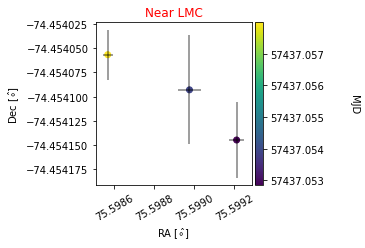

v_ra =  -97.34807702604382 , v_dec =  1.4919789031690074


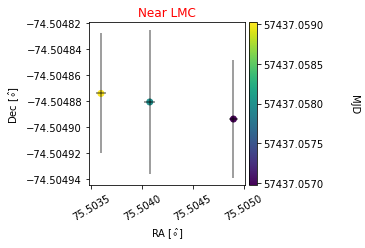

v_ra =  194.31489210941413 , v_dec =  171.89227241339177


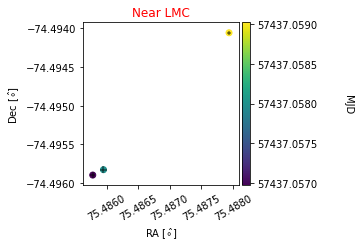

v_ra =  45.92600851605284 , v_dec =  117.05563247045684


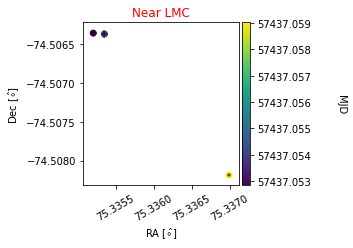

v_ra =  61.379328948594605 , v_dec =  242.21306398782863


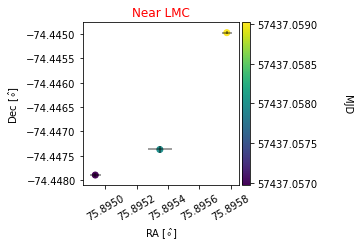

v_ra =  -22.477745862392666 , v_dec =  -105.68157052735336


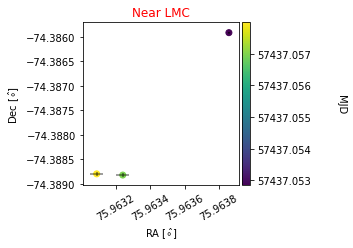

v_ra =  -142.56247739906408 , v_dec =  12.505930485718169


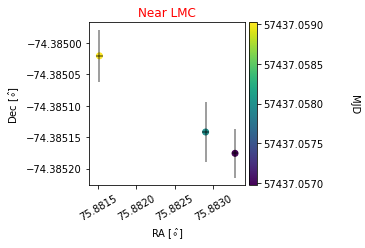

v_ra =  212.49300669152288 , v_dec =  -32.229549477197594


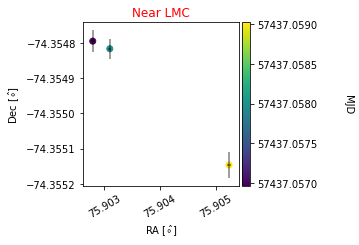

v_ra =  97.58890924767776 , v_dec =  169.5021742294144


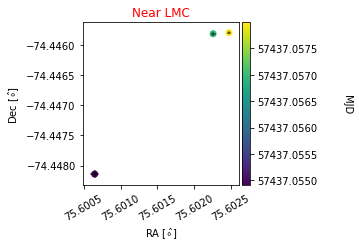

v_ra =  23.655796499216745 , v_dec =  4.641576755959223


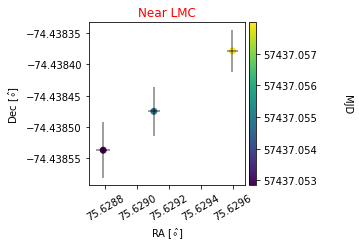

v_ra =  69.97922818525974 , v_dec =  -62.70435497777729


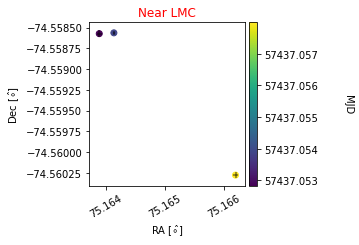

v_ra =  32.47657051809718 , v_dec =  -11.758998180414345


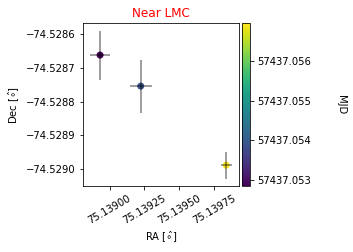

v_ra =  -44.083258430944625 , v_dec =  -324.0207928330432


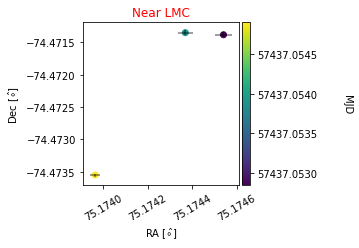

v_ra =  -70.65882486892208 , v_dec =  -233.0449801780825


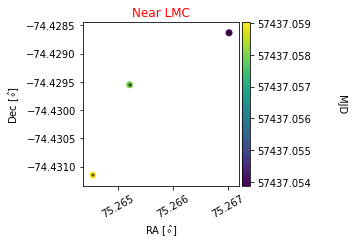

v_ra =  -143.78420416609274 , v_dec =  -46.57799327029428


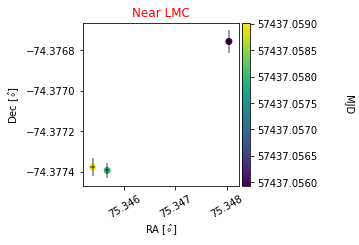

v_ra =  -80.00488568228285 , v_dec =  51.22177249958778


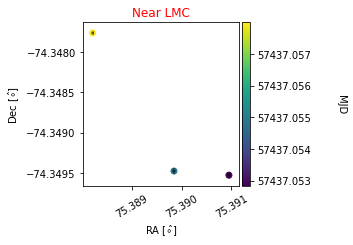

v_ra =  -13.223685327240196 , v_dec =  40.76357994596498


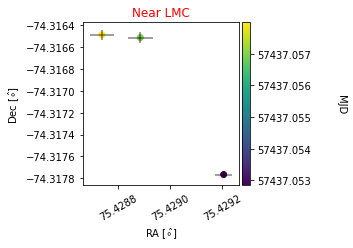

v_ra =  -30.93693862187584 , v_dec =  2.1581943777866903


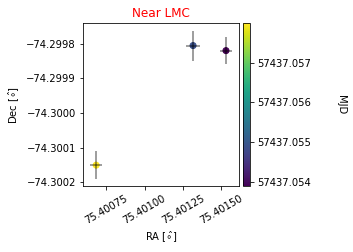

v_ra =  41.41158538186529 , v_dec =  -11.947532347854867


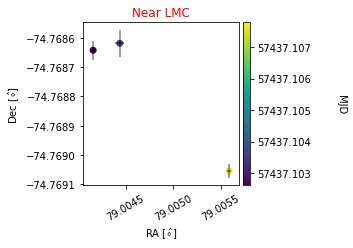

v_ra =  55.429549811520694 , v_dec =  -141.42299077991186


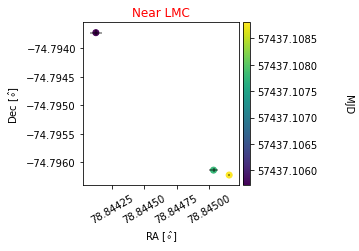

v_ra =  91.6208667650453 , v_dec =  -101.9348608782908


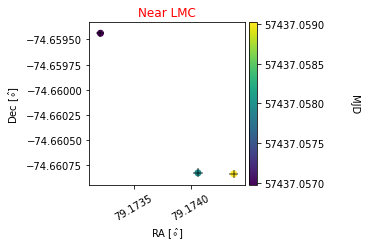

v_ra =  40.492924372545296 , v_dec =  5.180664539720025


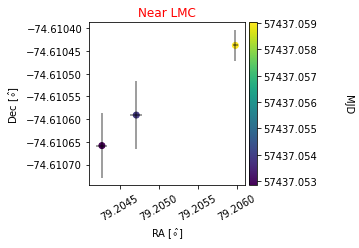

v_ra =  132.25512475087234 , v_dec =  76.95722827037245


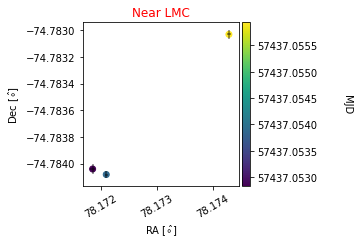

v_ra =  48.26116919702935 , v_dec =  7.992586326387514


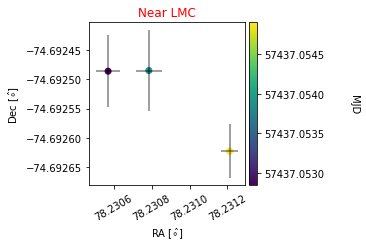

v_ra =  77.28017320236805 , v_dec =  -89.58882030536154


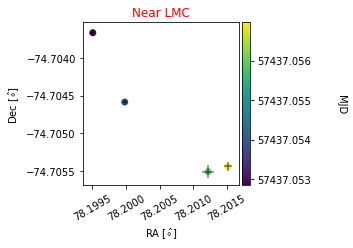

v_ra =  67.2180846847691 , v_dec =  -64.71000813255492


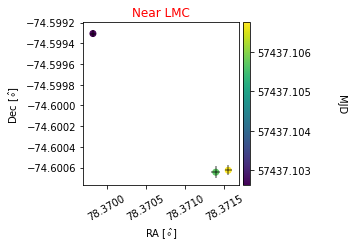

v_ra =  48.013487337516125 , v_dec =  -90.59049959258586


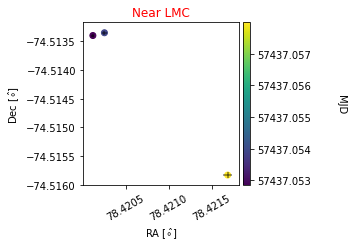

v_ra =  -60.96976904024538 , v_dec =  -0.43959893752507956


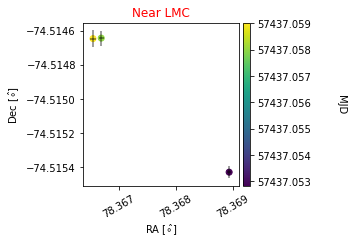

v_ra =  -44.11403907487868 , v_dec =  43.757834099215444


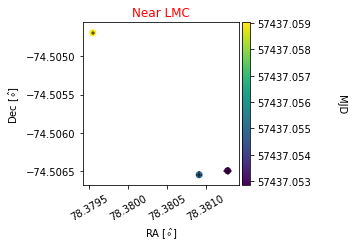

v_ra =  42.34517342072756 , v_dec =  17.462109502251973


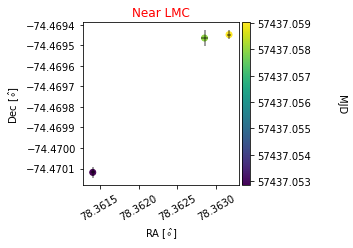

v_ra =  -439.98156333545927 , v_dec =  -374.4741413466401


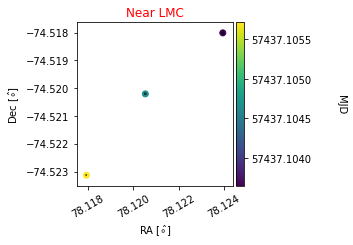

v_ra =  -52.67226863253271 , v_dec =  41.92887033523335


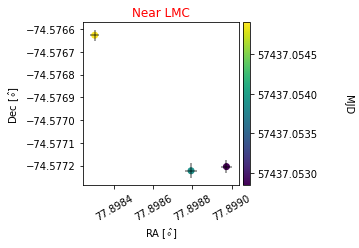

v_ra =  -118.21617119723895 , v_dec =  -89.43479490197358


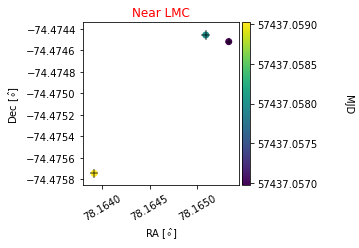

v_ra =  91.38020779090927 , v_dec =  -90.48529753920026


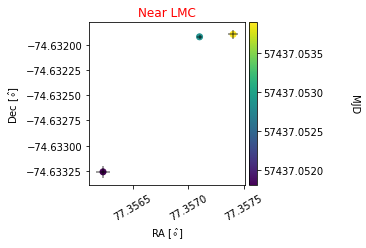

v_ra =  -19.010113956976557 , v_dec =  0.4240843818185398


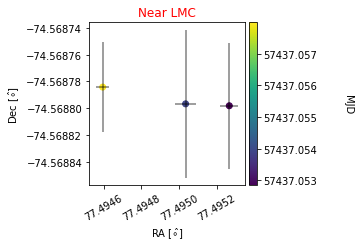

v_ra =  26.595570775319974 , v_dec =  -1.4041140596534605


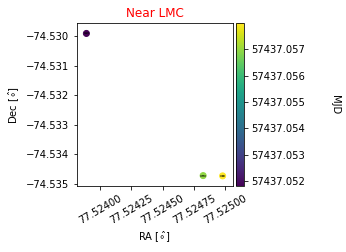

v_ra =  -285.0771596344498 , v_dec =  -117.02343998886727


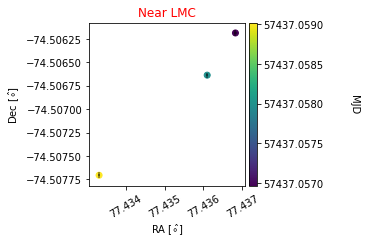

v_ra =  30.901690302231696 , v_dec =  84.89080176997973


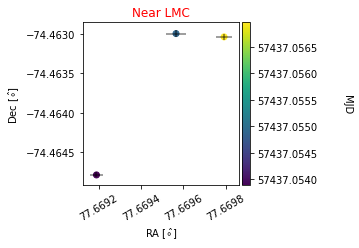

v_ra =  95.99805413456289 , v_dec =  -89.51476846340556


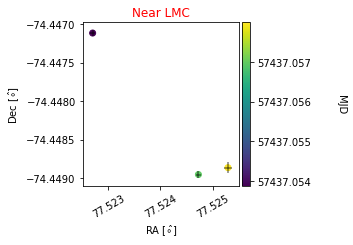

v_ra =  -6.128996010273144 , v_dec =  -37.236716573117924


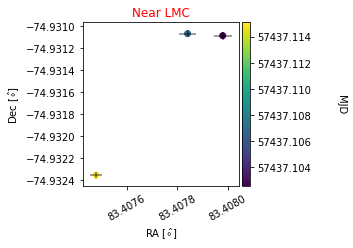

v_ra =  105.48858539562794 , v_dec =  14.747755852844888


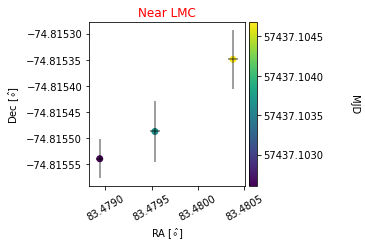

v_ra =  -244.57495383602443 , v_dec =  -185.27210865693658


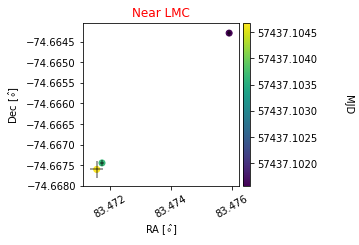

v_ra =  -111.02681644056996 , v_dec =  116.64733057192792


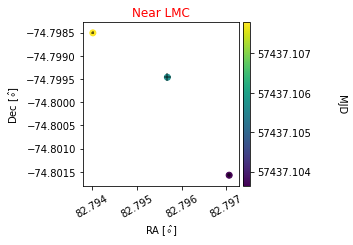

v_ra =  80.59130329466291 , v_dec =  -32.91951460215103


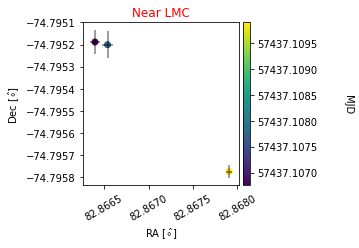

v_ra =  -24.087740696177764 , v_dec =  7.272628224650533


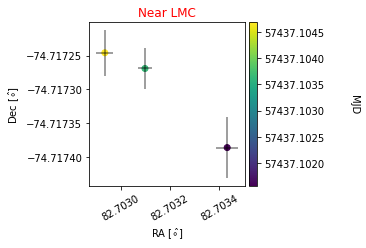

v_ra =  29.594591427816614 , v_dec =  -5.425975560657371


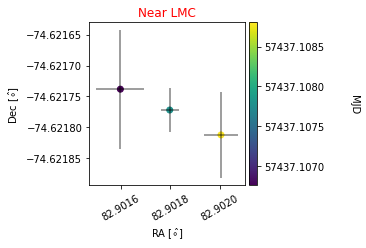

v_ra =  62.54504182780858 , v_dec =  42.97335876638359


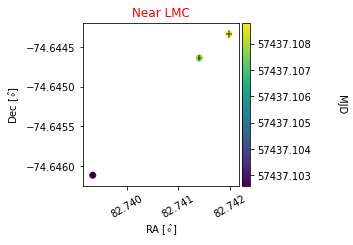

v_ra =  -93.81411618182436 , v_dec =  -375.3256007119244


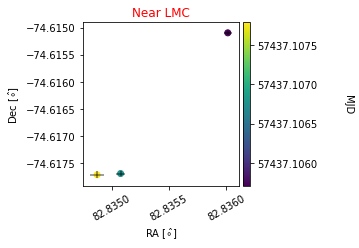

v_ra =  -147.9328543192191 , v_dec =  -132.4074221850936


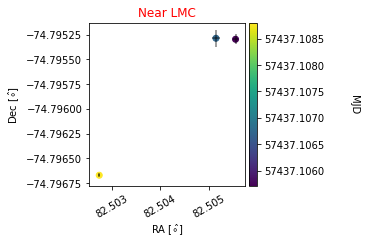

v_ra =  -27.080727088864318 , v_dec =  -4.084961651763545


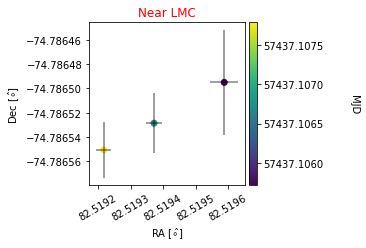

v_ra =  -23.135989343336988 , v_dec =  1.391129501357275


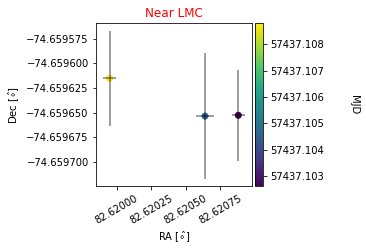

v_ra =  46.39116905426048 , v_dec =  -1.7494748518315841


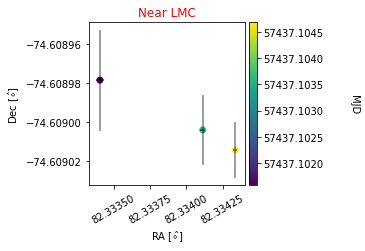

v_ra =  104.43912948779264 , v_dec =  47.96985157475982


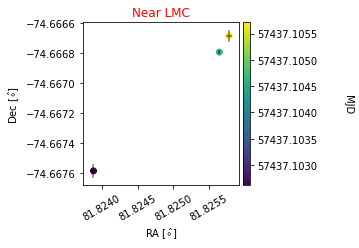

v_ra =  48.39259563090794 , v_dec =  4.0786831438124915


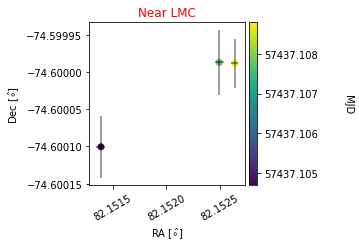

v_ra =  131.59947792372637 , v_dec =  9.772340769138813


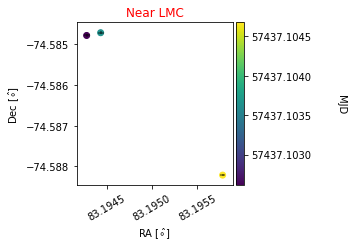

v_ra =  116.22728310532754 , v_dec =  5.578170225088481


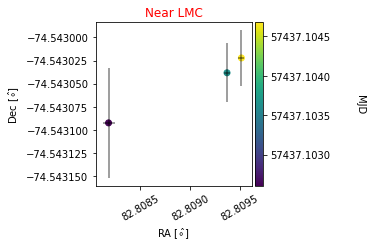

v_ra =  -111.94436673239397 , v_dec =  9.750624176970804


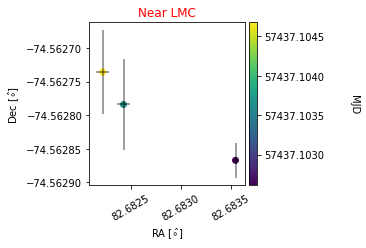

v_ra =  53.840969455671626 , v_dec =  -61.791116336364404


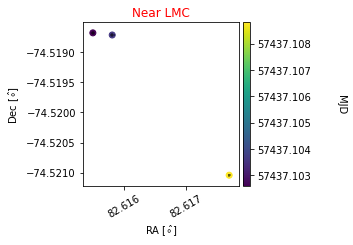

v_ra =  22.723930388573066 , v_dec =  8.048362830422843


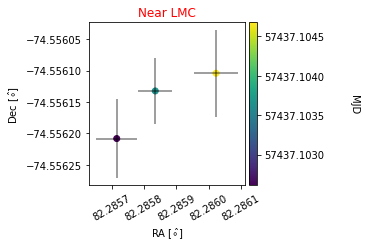

v_ra =  149.39242327387112 , v_dec =  175.90345282921203


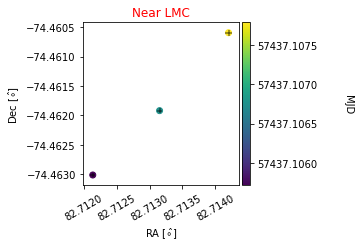

v_ra =  52.54164539272597 , v_dec =  27.66035449858477


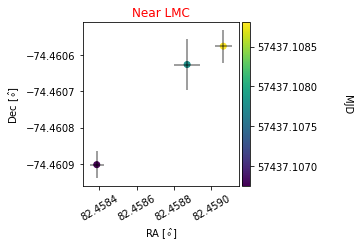

v_ra =  -51.71436914023527 , v_dec =  25.512102569683666


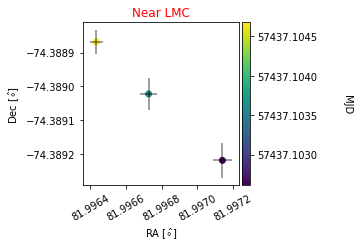

v_ra =  -18.566884071480004 , v_dec =  73.9463318453552


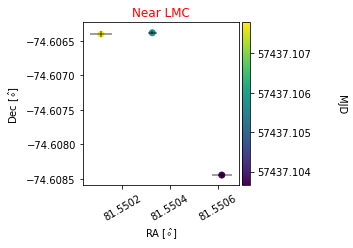

v_ra =  -151.57453942953626 , v_dec =  -167.09923365355468


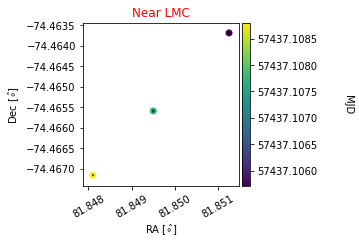

v_ra =  -25.572670027688446 , v_dec =  51.745189141750735


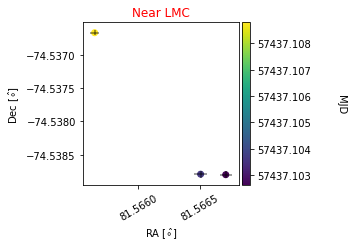

v_ra =  -63.771249495349764 , v_dec =  -69.68320149824007


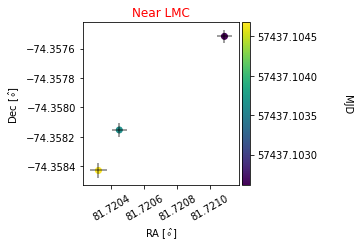

v_ra =  36.919137345654754 , v_dec =  5.778683173999938


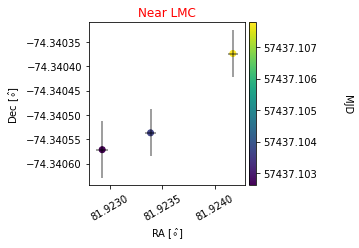

v_ra =  -23.44534506534019 , v_dec =  -9.213431749006654


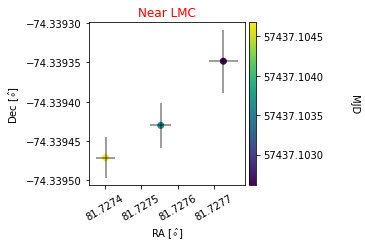

v_ra =  -172.16386528044336 , v_dec =  -108.28496851285284


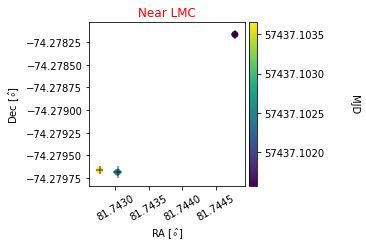

v_ra =  -44.40702605882586 , v_dec =  2.864788770367552


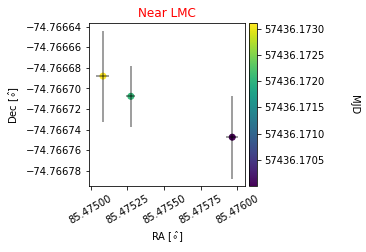

v_ra =  53.77439786696024 , v_dec =  3.8034953188955907


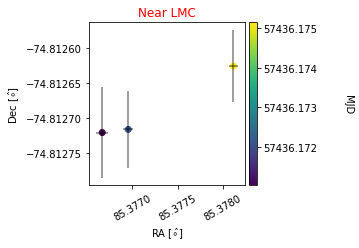

v_ra =  -147.5837172025717 , v_dec =  -72.15582811920704


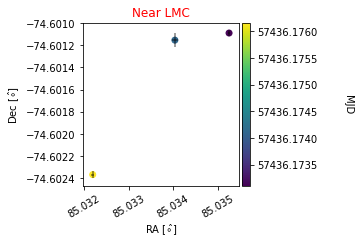

v_ra =  144.97516917948755 , v_dec =  225.49723767383216


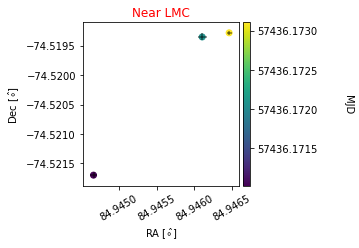

v_ra =  271.2118493199791 , v_dec =  83.93388543726593


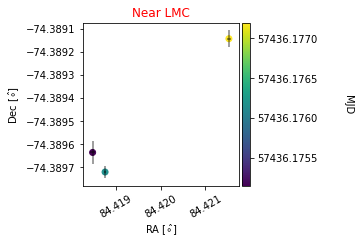

v_ra =  -73.85424589079949 , v_dec =  -62.81281220449524


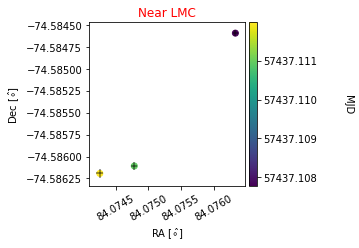

v_ra =  -18.670746592294858 , v_dec =  -1.264795430337672


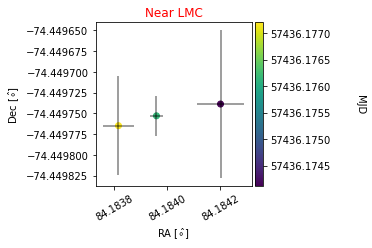

v_ra =  36.5129223411534 , v_dec =  3.9371059994908837


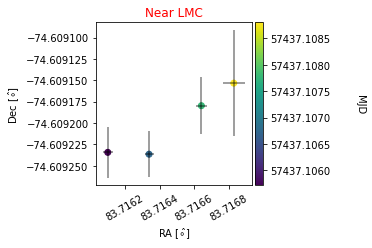

v_ra =  -138.2316097280133 , v_dec =  4.2380122728015746


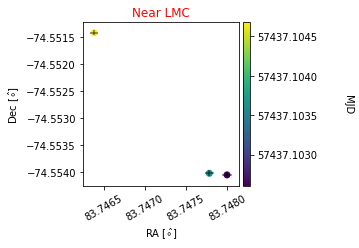

v_ra =  -24.410975349140173 , v_dec =  33.679400573118286


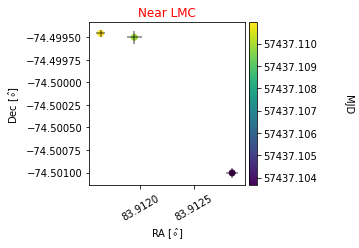

v_ra =  30.796516472683777 , v_dec =  2.1391697566062793


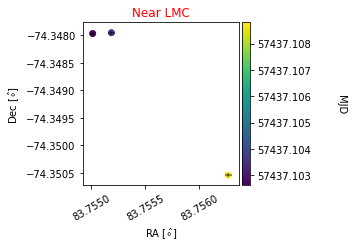

v_ra =  -101.41953850071671 , v_dec =  -15.539358509870041


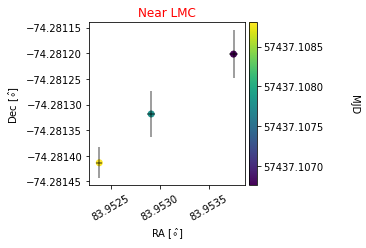

v_ra =  35.778053702872164 , v_dec =  -65.41525707742608


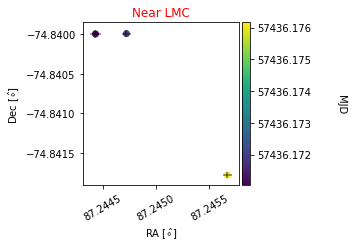

v_ra =  193.44058631845704 , v_dec =  -150.23150603279302


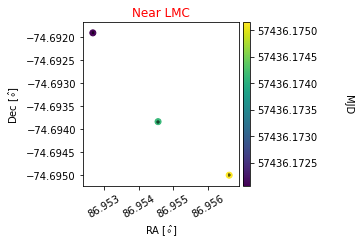

v_ra =  336.7188019132058 , v_dec =  83.06682492697497


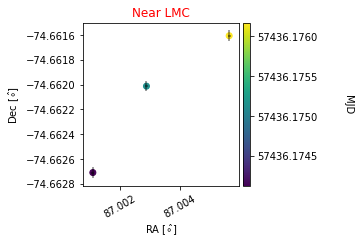

v_ra =  118.86667222490864 , v_dec =  -7.5473314450249775


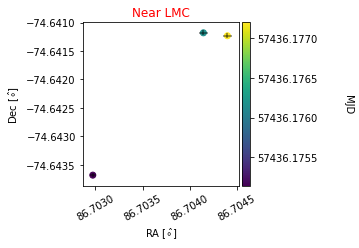

v_ra =  356.68327748957716 , v_dec =  -132.71212794422985


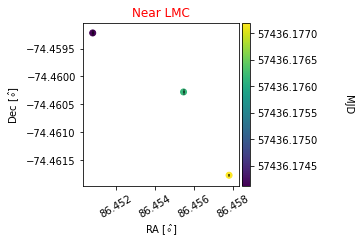

v_ra =  19.721493012978232 , v_dec =  0.575130502135069


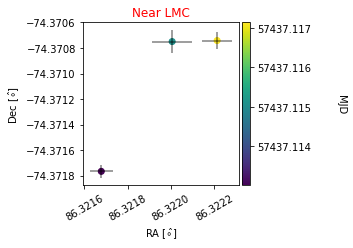

v_ra =  96.24843972580356 , v_dec =  14.034449738510832


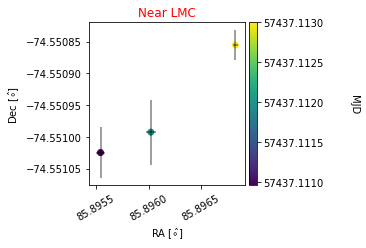

v_ra =  -138.91221518019512 , v_dec =  216.9281033641873


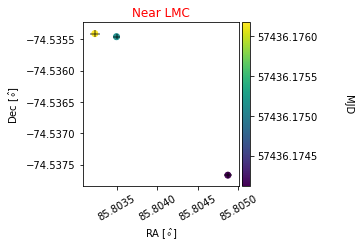

v_ra =  -25.462928476136806 , v_dec =  -19.815130523571593


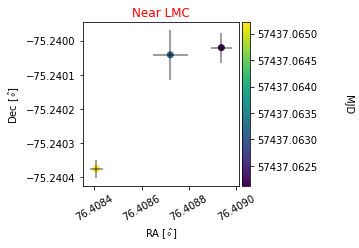

v_ra =  32.370913579486505 , v_dec =  1.7726716117598291


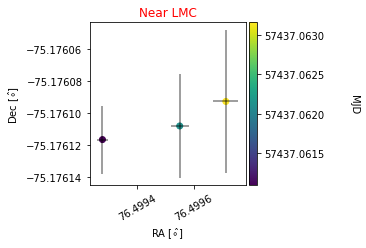

v_ra =  92.97198563495245 , v_dec =  162.67394785938987


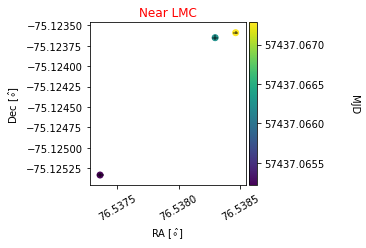

v_ra =  -75.55117605202594 , v_dec =  107.01179904849148


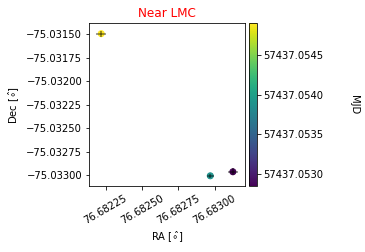

v_ra =  42.69444496477354 , v_dec =  -4.603583233448226


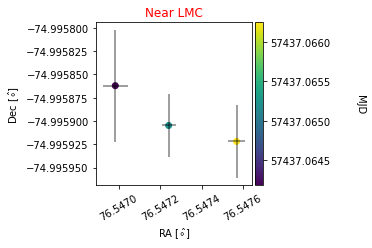

v_ra =  77.78757018820588 , v_dec =  -13.030704544187957


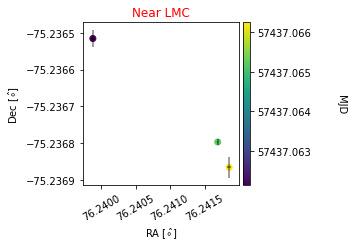

v_ra =  -335.01815499897805 , v_dec =  118.07618508362015


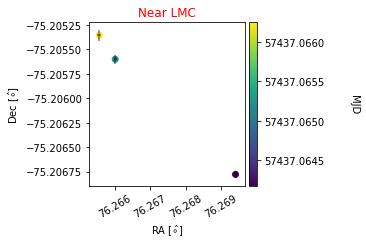

v_ra =  -179.35159819700075 , v_dec =  100.77509450597523


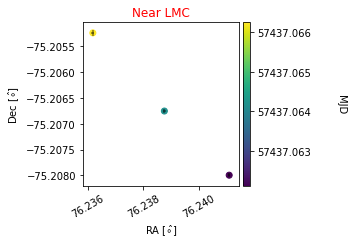

v_ra =  -50.84444636756833 , v_dec =  37.25663844246967


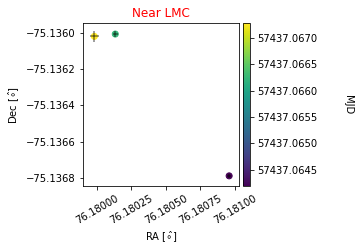

v_ra =  26.55359635386064 , v_dec =  86.42679164791518


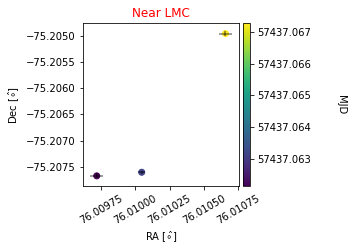

v_ra =  -24.00172153720537 , v_dec =  12.549429421795033


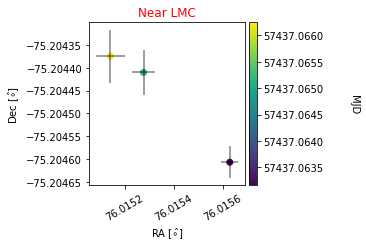

v_ra =  41.16293440162513 , v_dec =  -13.208970893894248


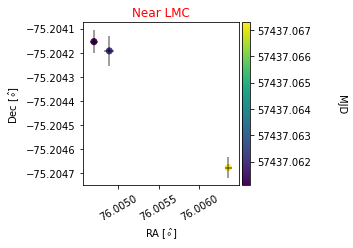

v_ra =  123.60936303533218 , v_dec =  -2.1130866231941887


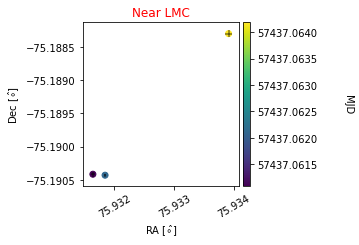

v_ra =  -123.61157152082188 , v_dec =  56.604252828382336


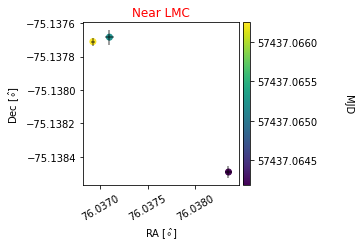

v_ra =  -152.72846867459594 , v_dec =  -161.96858577296058


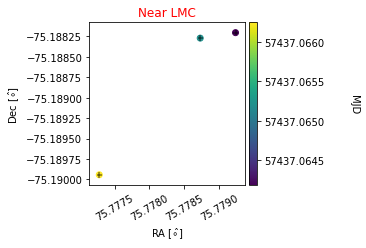

v_ra =  25.922704688298385 , v_dec =  -7.941190675491051


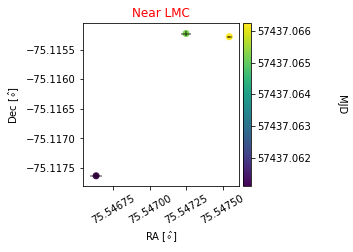

v_ra =  44.168507711870376 , v_dec =  28.59375305566466


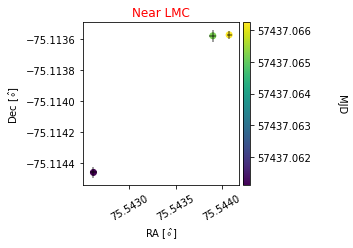

v_ra =  -95.19303933263178 , v_dec =  -124.4200708263678


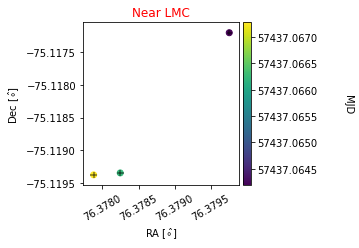

v_ra =  151.3040652404064 , v_dec =  -122.351243279362


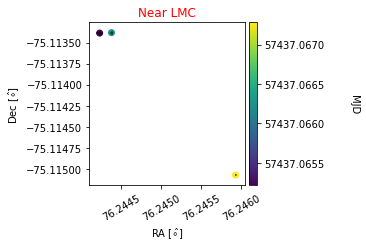

v_ra =  -51.70071585245529 , v_dec =  -140.32723142176584


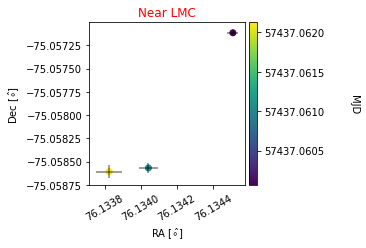

v_ra =  79.74600817989578 , v_dec =  0.6624586054076486


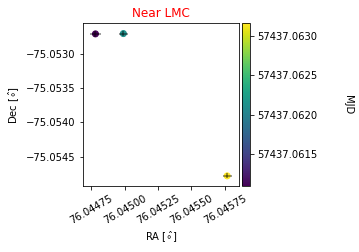

v_ra =  -94.01917305134832 , v_dec =  -21.831093040604618


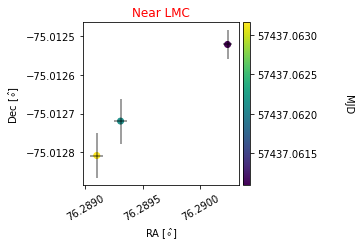

v_ra =  79.77261476385304 , v_dec =  -5.153158128021604


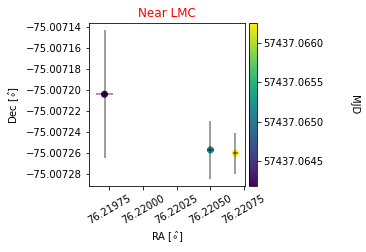

v_ra =  -99.03627540832662 , v_dec =  -3.770547172724244


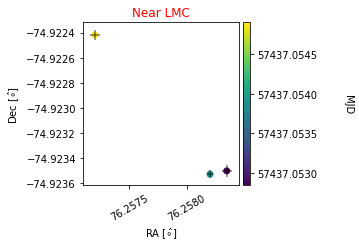

v_ra =  -395.25553281977454 , v_dec =  65.04913433029658


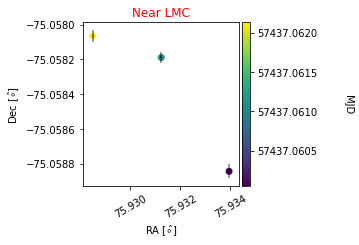

v_ra =  -52.09258252582089 , v_dec =  34.594865030871325


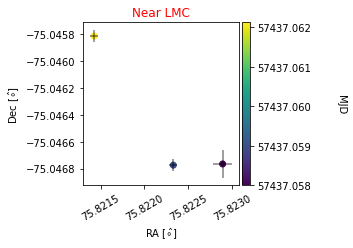

v_ra =  159.1245994351245 , v_dec =  -137.2194944003645


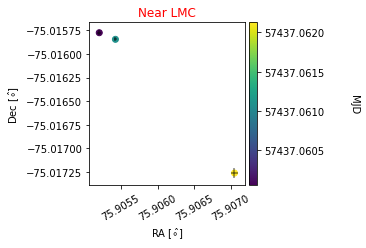

v_ra =  -47.98851774745133 , v_dec =  13.607665477954448


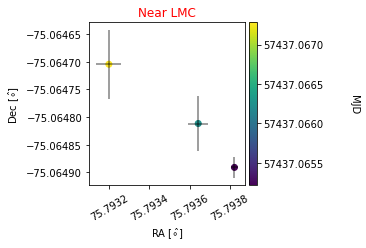

v_ra =  41.3970784318628 , v_dec =  35.75277388194798


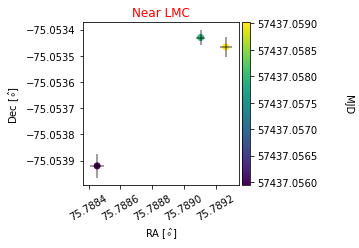

v_ra =  -113.00261370509115 , v_dec =  -6.813252276768272


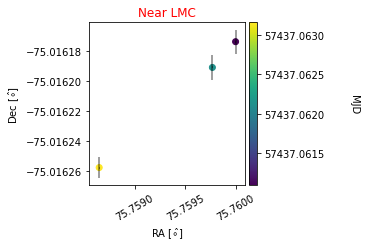

v_ra =  -68.9949108191223 , v_dec =  -13.514307737800578


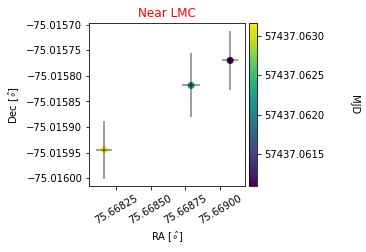

v_ra =  133.7287243972539 , v_dec =  -139.96112846563105


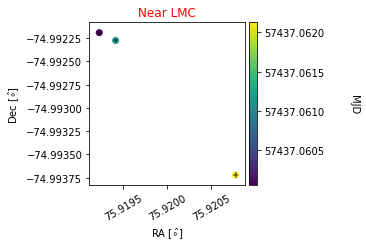

v_ra =  -86.77397131992814 , v_dec =  40.32120936132059


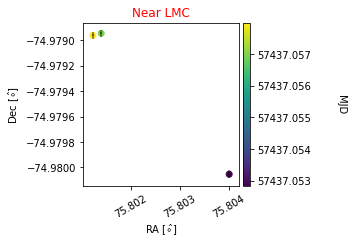

v_ra =  216.2460948946649 , v_dec =  194.8710114504183


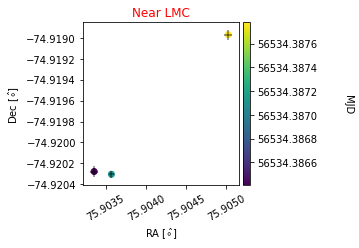

v_ra =  41.41851353741924 , v_dec =  -5.434372602806305


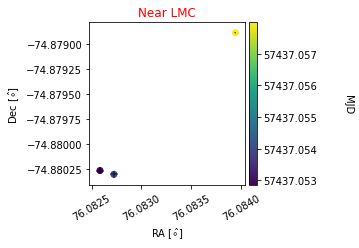

v_ra =  27.897781964032816 , v_dec =  -8.396135750371451


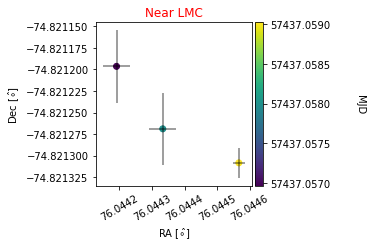

v_ra =  90.53371473540473 , v_dec =  -93.28174871080154


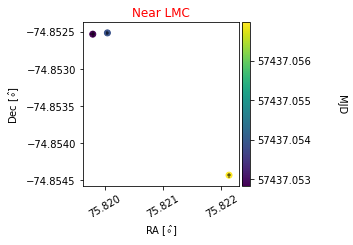

v_ra =  48.24901797371135 , v_dec =  -116.44981317604775


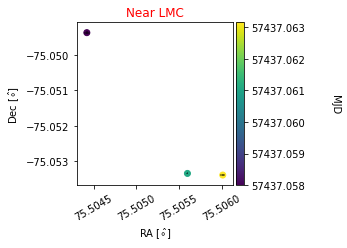

v_ra =  38.562753833111685 , v_dec =  -75.8141327109799


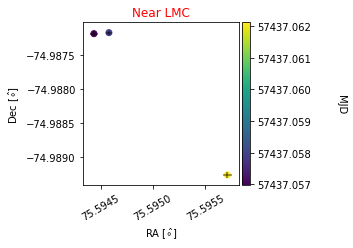

v_ra =  18.79459566829394 , v_dec =  12.889453982409712


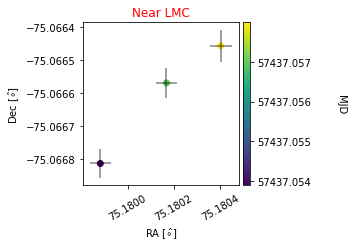

v_ra =  -37.4377382469946 , v_dec =  -7.776572553857182


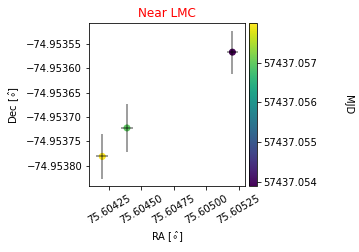

v_ra =  20.846759582846392 , v_dec =  107.71525735895612


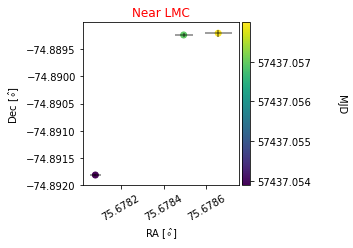

v_ra =  -23.31733315933252 , v_dec =  -1.6324740328984326


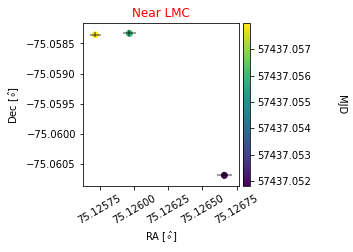

v_ra =  44.714070990065466 , v_dec =  13.458324594698878


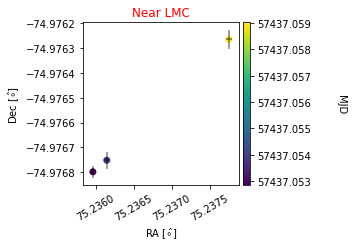

v_ra =  -66.25426536958905 , v_dec =  6.638482451204214


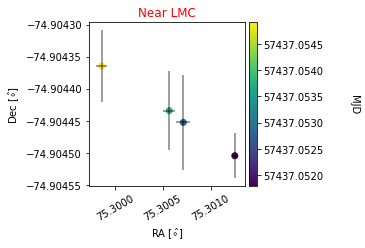

v_ra =  8.8739458392851 , v_dec =  -24.410247952153536


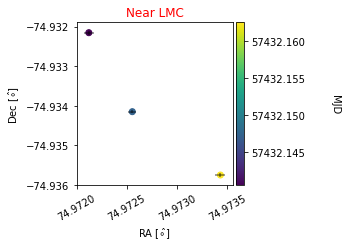

v_ra =  -10.343378379871877 , v_dec =  1.0496446752656738


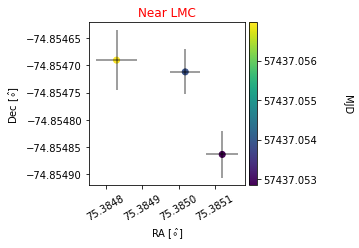

v_ra =  41.406363478424474 , v_dec =  20.354174595075364


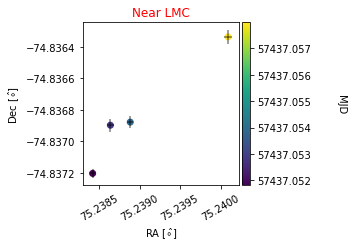

v_ra =  76.96429468546098 , v_dec =  127.47490955223056


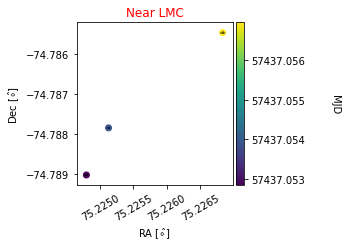

v_ra =  -79.11645744304828 , v_dec =  -183.42461610165608


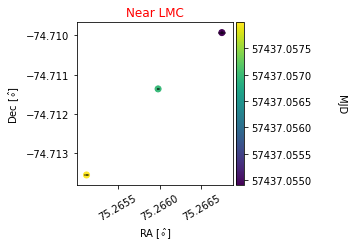

v_ra =  -12.362243575052808 , v_dec =  56.520089872699934


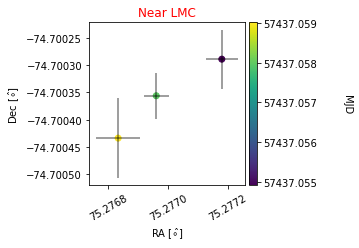

v_ra =  -49.0195026035801 , v_dec =  -41.4669137862602


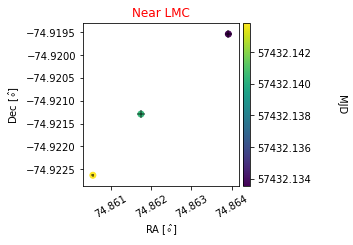

v_ra =  -29.351823162237324 , v_dec =  -25.160531771169847


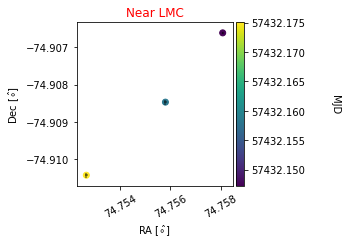

v_ra =  -59.87823539437554 , v_dec =  0.8856726125948476


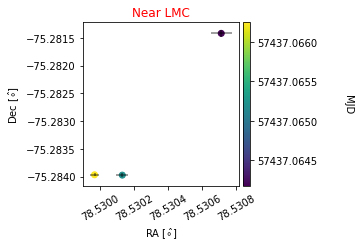

v_ra =  46.635425194407055 , v_dec =  -139.5890246275728


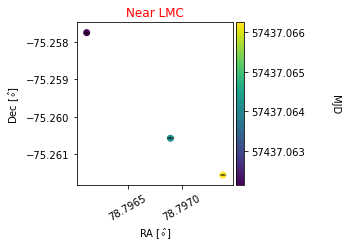

v_ra =  -157.71290086012453 , v_dec =  -1.6168557901394014


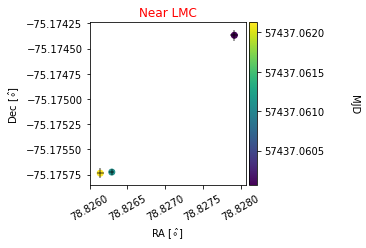

v_ra =  46.665625291494386 , v_dec =  27.926522334041525


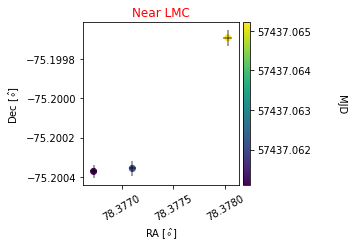

v_ra =  85.02727643460496 , v_dec =  411.7101042237668


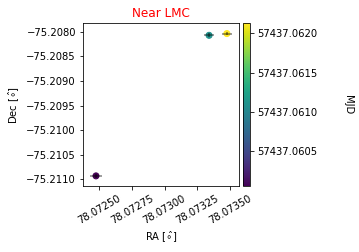

v_ra =  -78.09022220296772 , v_dec =  -18.540384519517815


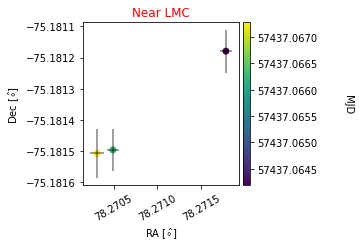

v_ra =  -65.13215716762049 , v_dec =  -62.058427297947965


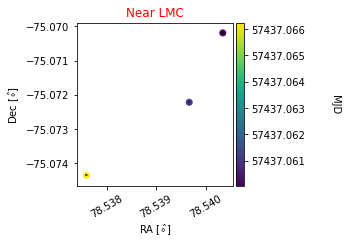

v_ra =  210.37364974630773 , v_dec =  -56.10124820420438


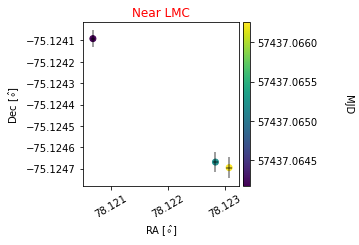

v_ra =  294.336251654585 , v_dec =  324.17070225964613


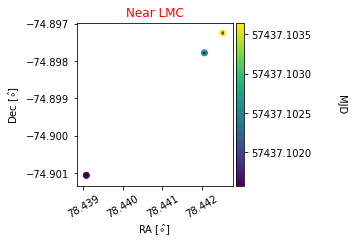

v_ra =  -63.72296708993505 , v_dec =  -19.84358653949744


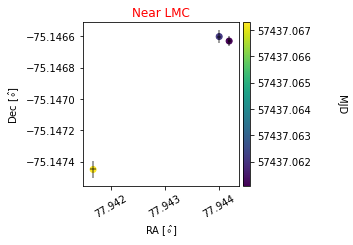

v_ra =  86.45164248870923 , v_dec =  59.877055306844454


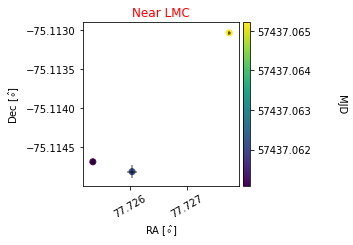

v_ra =  39.588027409145546 , v_dec =  17.16282515852941


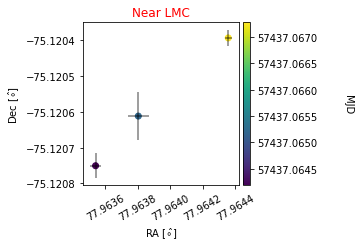

v_ra =  119.6654342888934 , v_dec =  0.8126509036115106


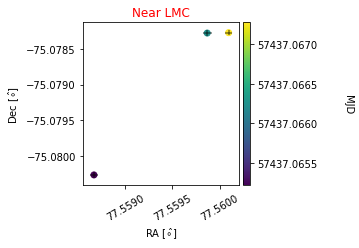

v_ra =  -18.213617835919237 , v_dec =  -18.48738379498037


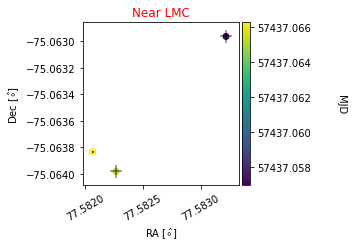

v_ra =  -126.91401887044454 , v_dec =  -2.6055485130682468


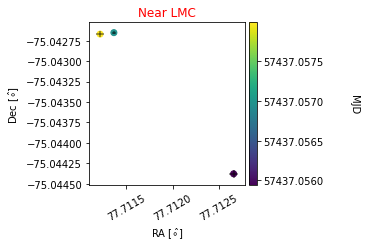

v_ra =  -5.507386771647405 , v_dec =  -2.059881757545693


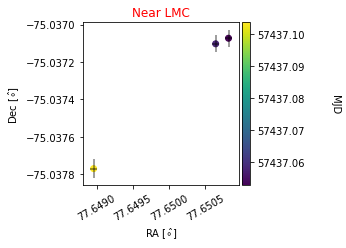

v_ra =  -19.70346473770599 , v_dec =  4.823903248434995


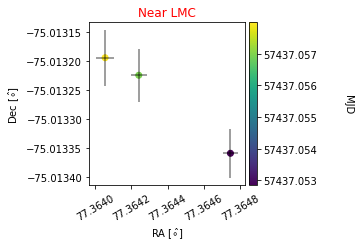

v_ra =  -96.2250866702014 , v_dec =  38.846192284521074


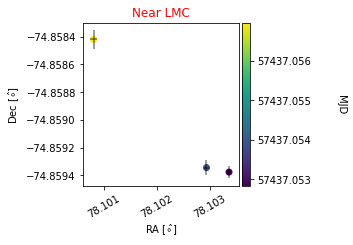

v_ra =  -13.800111123901317 , v_dec =  -4.701663532252299


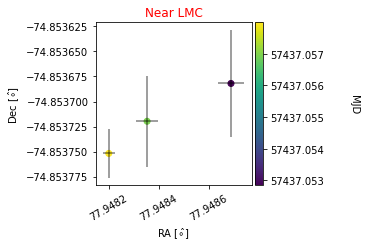

v_ra =  -303.46622959613757 , v_dec =  207.92609765604138


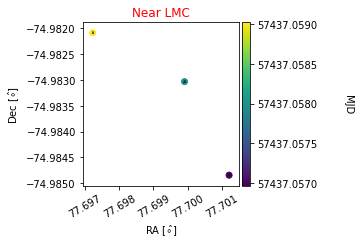

v_ra =  -168.92871210234128 , v_dec =  136.55166753991435


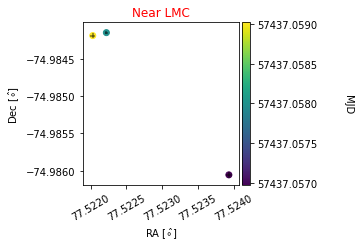

v_ra =  -59.8520948860791 , v_dec =  8.638358862894654


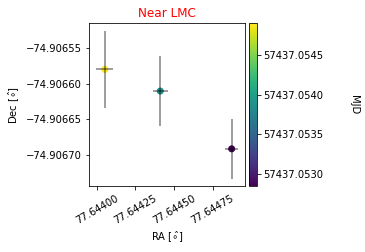

v_ra =  66.97763561373529 , v_dec =  214.28710168300907


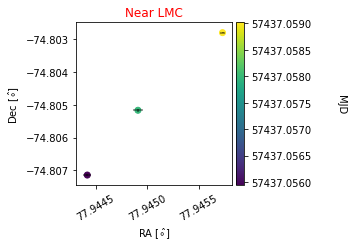

v_ra =  -77.27510190465881 , v_dec =  374.5606682115374


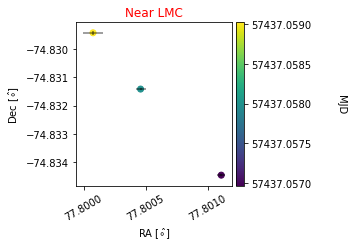

v_ra =  -58.02622637892765 , v_dec =  -72.07653327647706


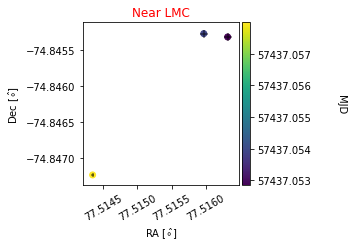

v_ra =  16.82769645255352 , v_dec =  10.269224963412693


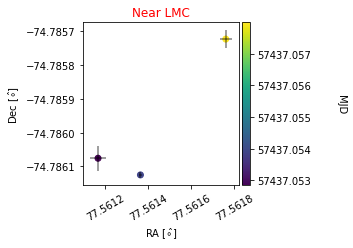

v_ra =  -108.69897115209875 , v_dec =  -72.29704745265143


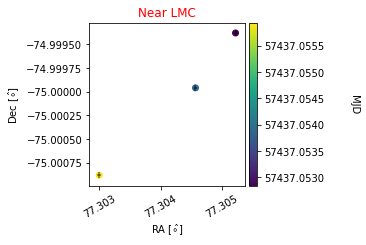

v_ra =  40.104041680025 , v_dec =  -94.13388308708267


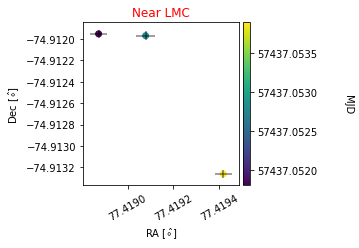

v_ra =  -104.62581200753426 , v_dec =  -9.953970440593771


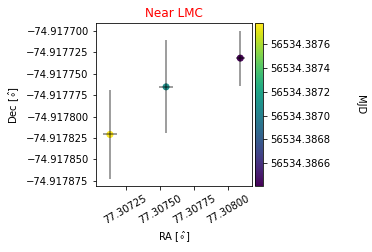

v_ra =  22.2135882895644 , v_dec =  30.387612643302756


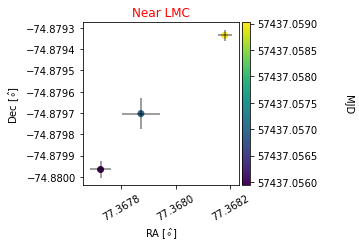

v_ra =  -140.76054166071495 , v_dec =  -46.67384783792483


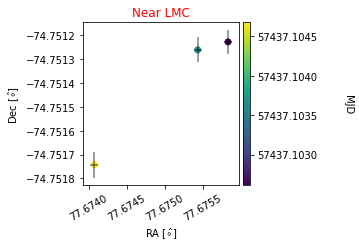

v_ra =  49.47229896387896 , v_dec =  -4.023225346906705


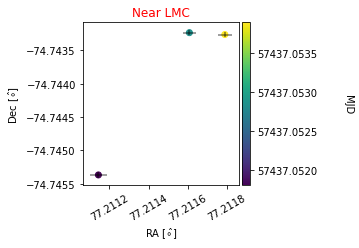

v_ra =  -177.51222881480172 , v_dec =  -6.512928670377271


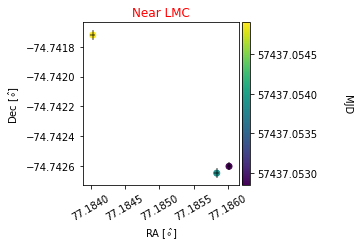

v_ra =  -26.280551573421093 , v_dec =  4.888744658962302


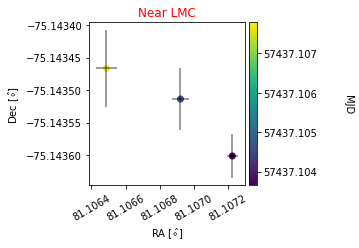

v_ra =  -52.83966950365465 , v_dec =  -10.391005516774785


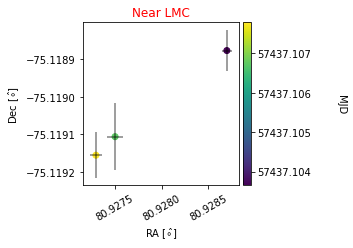

v_ra =  102.51749036288619 , v_dec =  3.910084390449241


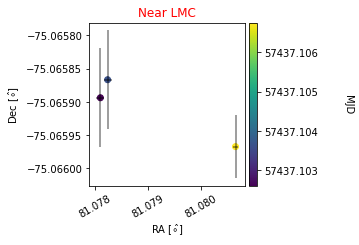

v_ra =  -79.41008223892177 , v_dec =  -2.056917274711721


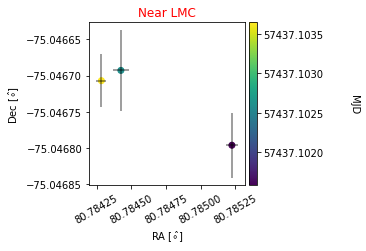

v_ra =  -157.91609267356577 , v_dec =  42.55725087583484


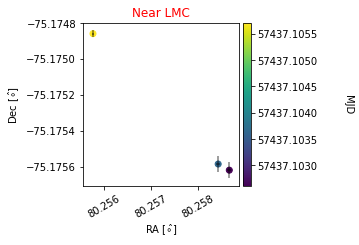

v_ra =  -90.03921163427073 , v_dec =  -40.06580319739474


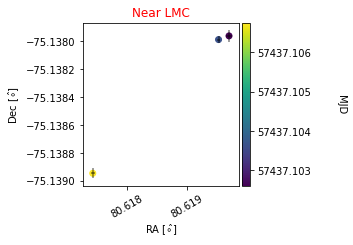

v_ra =  52.210654724674214 , v_dec =  -81.33812482496418


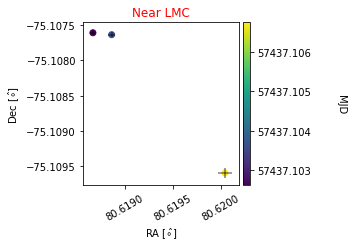

v_ra =  184.8587214077303 , v_dec =  -219.17210003900425


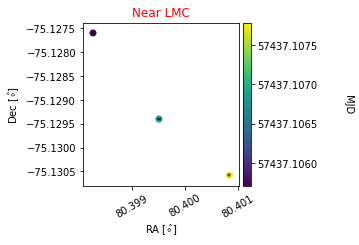

v_ra =  39.644671471175236 , v_dec =  -27.185506088580397


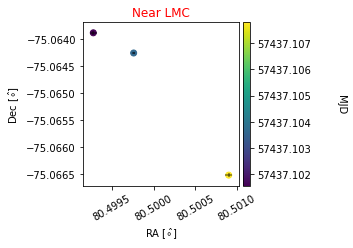

v_ra =  -18.268372091128665 , v_dec =  -7.272868083266345


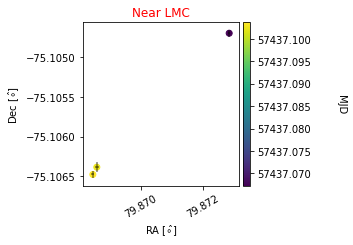

v_ra =  -80.44558088727115 , v_dec =  -54.9387532962185


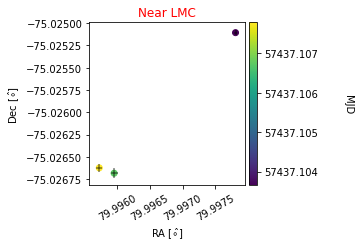

v_ra =  -67.56129041705208 , v_dec =  88.43728407994935


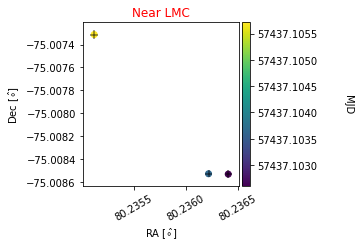

v_ra =  108.31090956380127 , v_dec =  -20.31473396037543


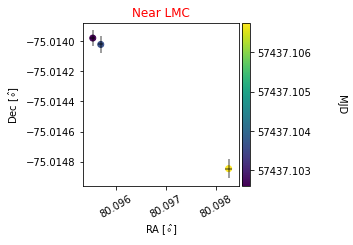

v_ra =  -70.34743862421907 , v_dec =  62.34837593256274


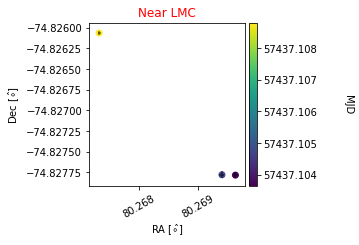

v_ra =  -88.30553547903116 , v_dec =  -17.401229694362627


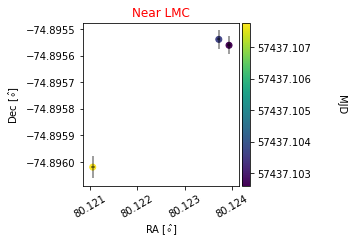

v_ra =  -35.722084317182784 , v_dec =  -7.784522765175883


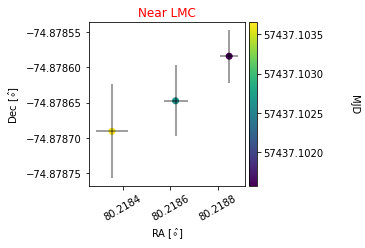

v_ra =  22.428734413747282 , v_dec =  58.94920197004651


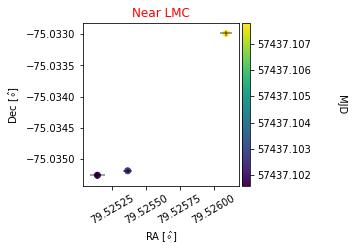

v_ra =  43.91940560736942 , v_dec =  -42.475953157093734


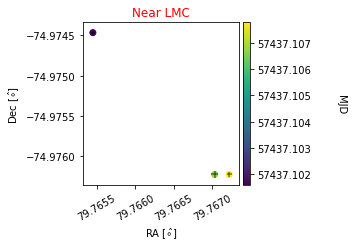

v_ra =  -41.295229972239675 , v_dec =  21.44351487588938


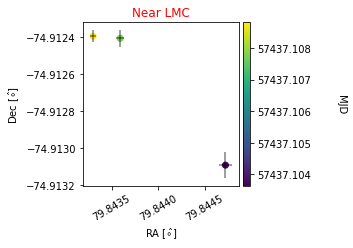

v_ra =  -74.4390014382086 , v_dec =  -127.60987074178917


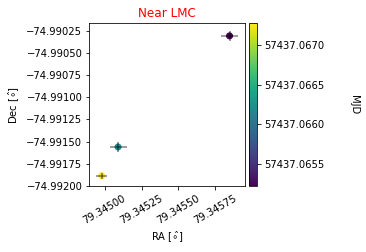

v_ra =  134.41961710048113 , v_dec =  -266.0680429913167


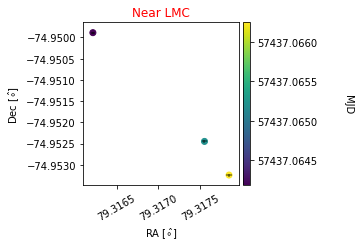

v_ra =  -64.7369496503316 , v_dec =  214.22635308469464


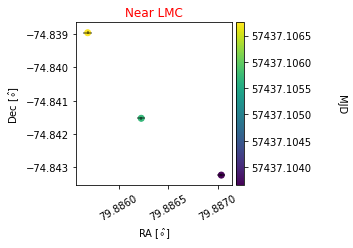

v_ra =  181.09350732359974 , v_dec =  1.981136249444753


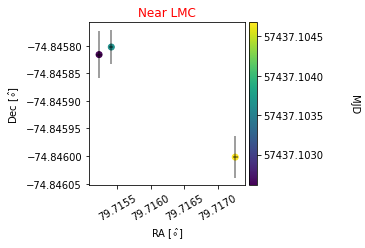

v_ra =  39.083710497208436 , v_dec =  -200.0880090597667


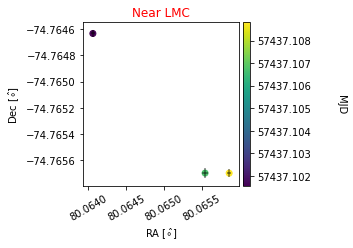

v_ra =  26.300301798836912 , v_dec =  5.462681858534238


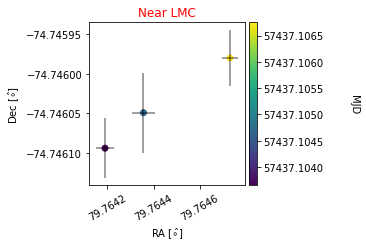

v_ra =  89.61267644880257 , v_dec =  -15.09722502462563


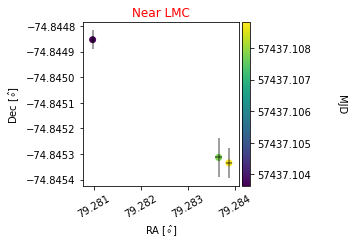

v_ra =  -72.8519763258811 , v_dec =  -4.2217412579242595


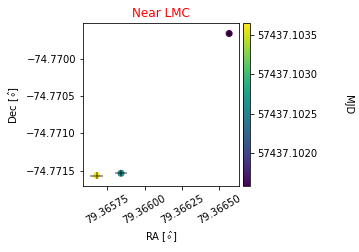

v_ra =  84.72179893186264 , v_dec =  12.172655915102915


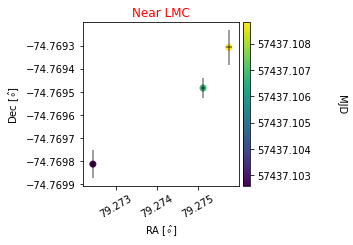

v_ra =  -66.24472213895858 , v_dec =  -29.45071521683542


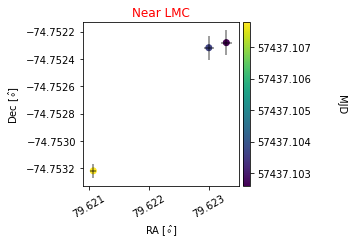

v_ra =  14.885819271413977 , v_dec =  0.9502628726341605


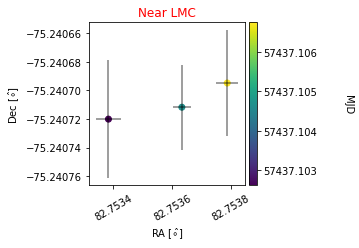

v_ra =  48.32397985643801 , v_dec =  -21.571515149887162


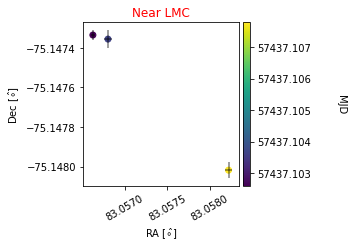

v_ra =  -117.42442639385847 , v_dec =  -1.0223577883469288


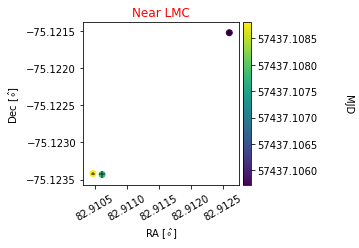

v_ra =  112.94080766307974 , v_dec =  38.27022041345892


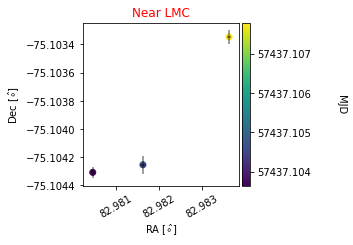

v_ra =  37.01025035574572 , v_dec =  -4.381107248081011


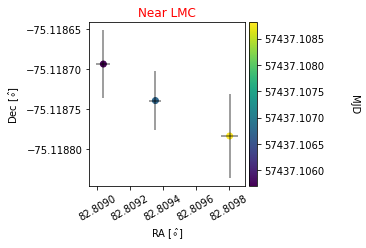

v_ra =  92.1811446916231 , v_dec =  47.3429116603975


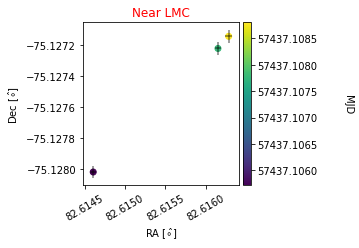

v_ra =  -12.343473410606073 , v_dec =  -0.7065855641102695


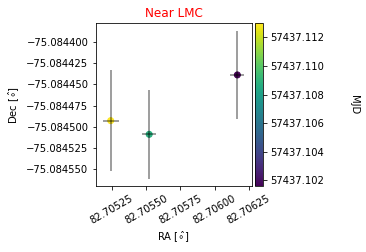

v_ra =  29.95631173052946 , v_dec =  -4.183847281069402


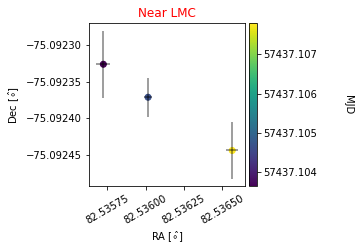

v_ra =  13.675528926341116 , v_dec =  5.4552983234987105


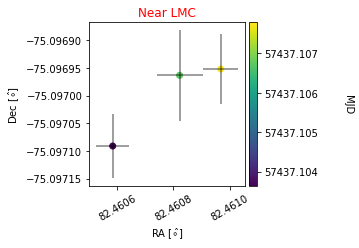

v_ra =  -21.345917404924517 , v_dec =  -2.074111935900001


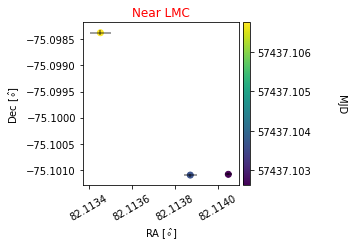

v_ra =  -209.74909193948963 , v_dec =  15.558542652957632


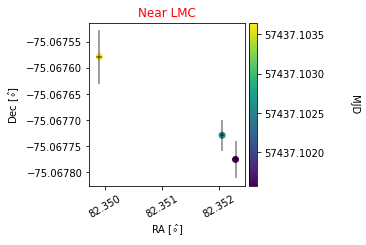

v_ra =  -86.1342703269023 , v_dec =  82.61799021583586


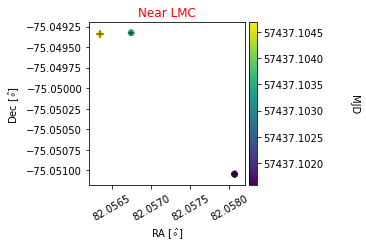

v_ra =  72.54808155482415 , v_dec =  42.88640766422086


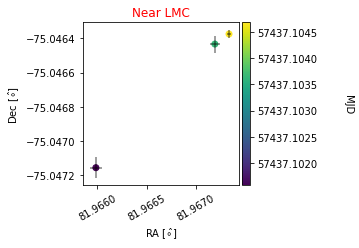

v_ra =  13.855713518302657 , v_dec =  91.01853978169214


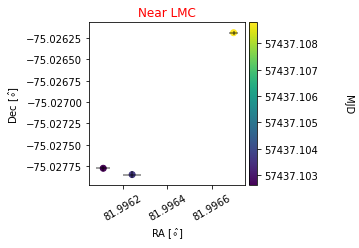

v_ra =  278.08079095248655 , v_dec =  -16.857749996712496


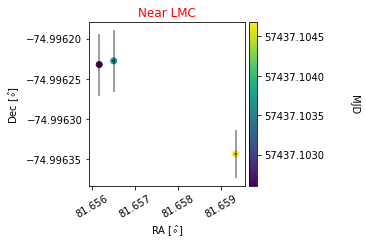

v_ra =  55.39682181655922 , v_dec =  -2.5537947845438276


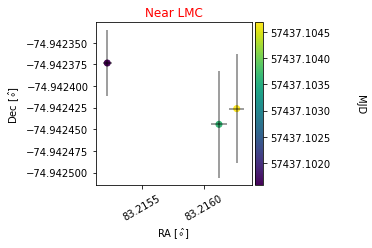

v_ra =  -18.170254629313753 , v_dec =  -63.54395751291585


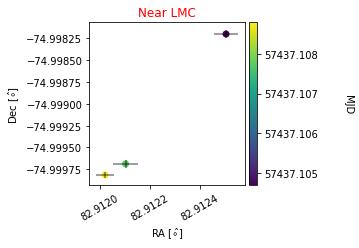

v_ra =  -279.38487875230186 , v_dec =  -43.349637310910026


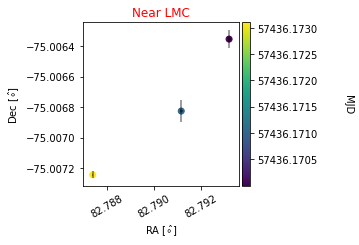

v_ra =  -12.741559074108743 , v_dec =  -3.7811531753599064


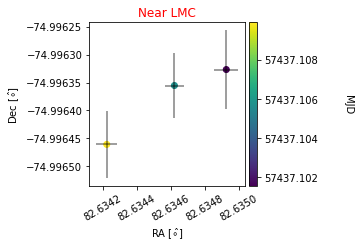

v_ra =  -93.33809687015645 , v_dec =  90.09514593942798


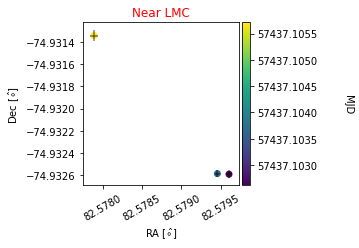

v_ra =  -373.0062814708162 , v_dec =  -130.82139305037


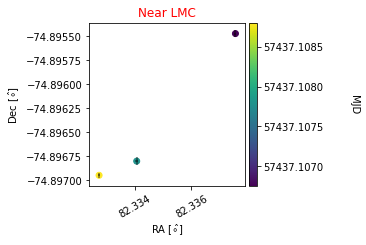

v_ra =  89.5441099484426 , v_dec =  -153.14780642816837


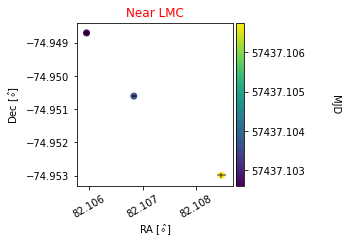

v_ra =  42.94324447580464 , v_dec =  3.6224456560898086


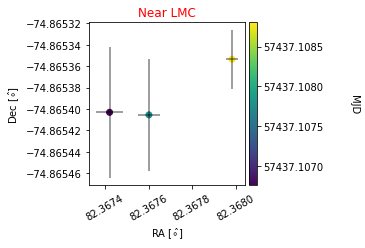

v_ra =  267.96506838630995 , v_dec =  -4.429306465489378


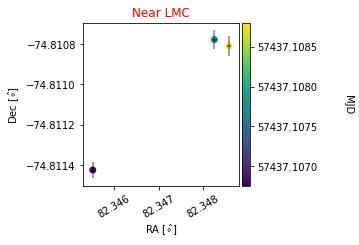

v_ra =  184.5069830337576 , v_dec =  -153.67922004184584


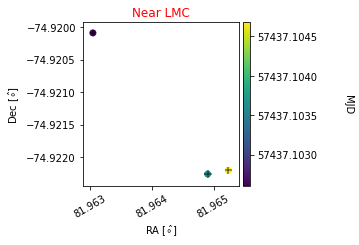

v_ra =  134.73418404196676 , v_dec =  -7.672929857965929


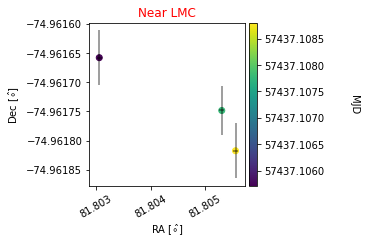

v_ra =  106.94674525934818 , v_dec =  -1.9190383241283933


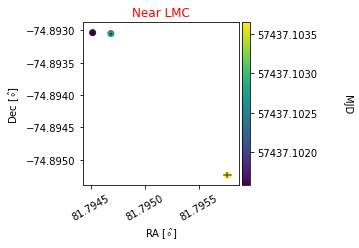

v_ra =  -13.15727983773219 , v_dec =  -11.055620880180507


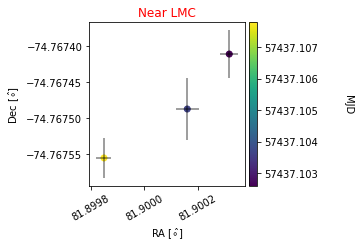

v_ra =  66.8132502212476 , v_dec =  -44.47213041302291


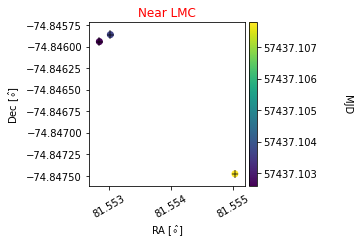

v_ra =  36.56508930681611 , v_dec =  -3.114461544920267


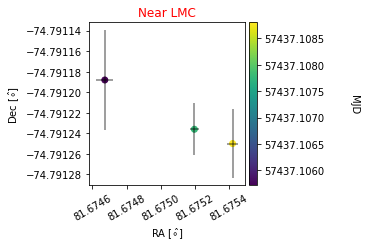

v_ra =  -32.181133139976446 , v_dec =  -12.968926607990639


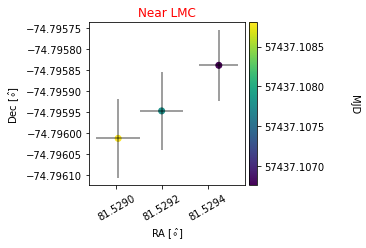

v_ra =  28.492198011856285 , v_dec =  23.40822367844544


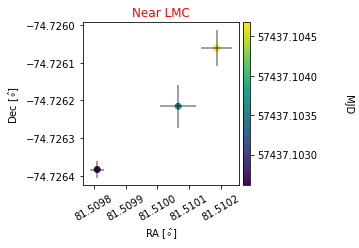

v_ra =  62.452165313710786 , v_dec =  53.37431405713419


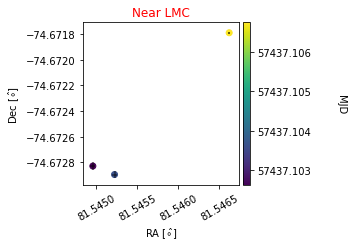

v_ra =  8.428797807231044 , v_dec =  -7.030112190672253


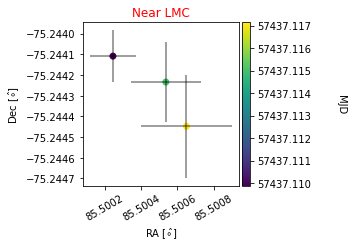

v_ra =  -49.2577010509078 , v_dec =  -8.751376829807372


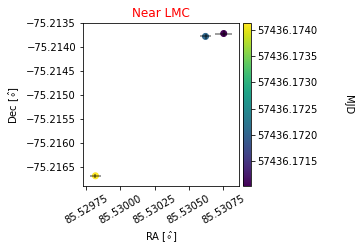

v_ra =  59.36260822191921 , v_dec =  32.65312127502864


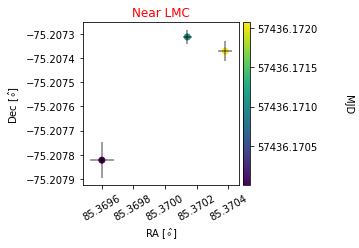

v_ra =  -24.77433391959664 , v_dec =  -4.439731540325146


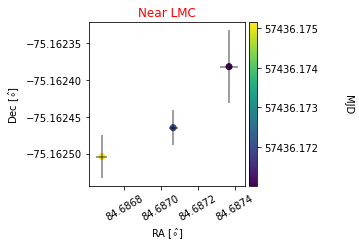

v_ra =  -446.11001193879207 , v_dec =  -191.29274183587077


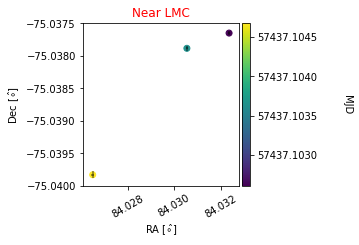

v_ra =  -57.95687357183618 , v_dec =  13.690369182190144


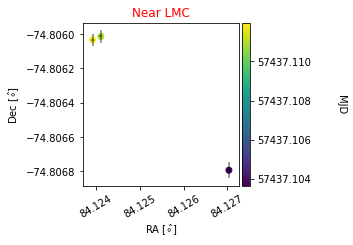

v_ra =  10.174850779495628 , v_dec =  9.441779761136296


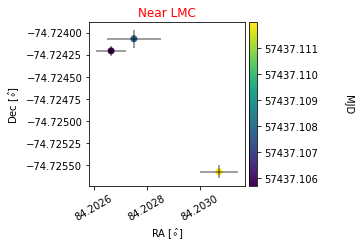

v_ra =  -106.12941487569559 , v_dec =  3.441425039886541


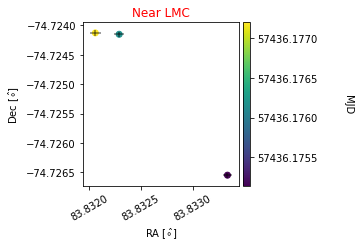

v_ra =  -24.118110720641415 , v_dec =  53.50200020626034


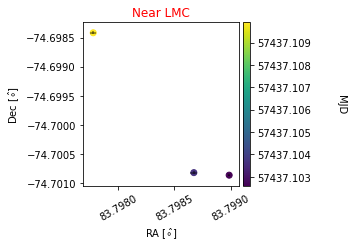

v_ra =  -73.14045256583465 , v_dec =  -55.2019873278581


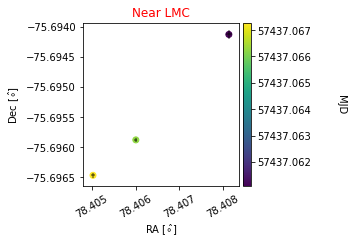

v_ra =  34.0463461926919 , v_dec =  4.265921108483726


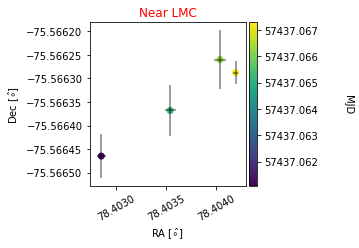

v_ra =  -157.02055351314343 , v_dec =  22.036517638483062


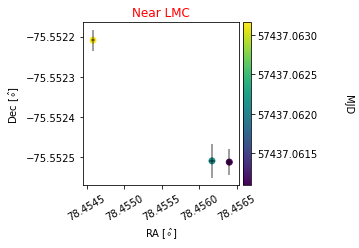

v_ra =  -55.82861483622901 , v_dec =  3.86509388878474


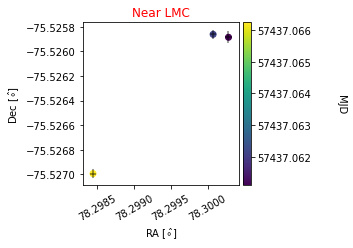

v_ra =  24.562435476650673 , v_dec =  -5.264318282024855


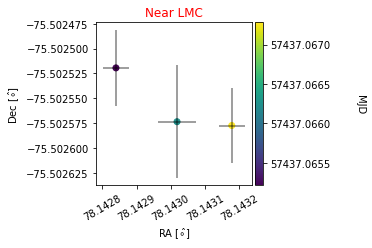

v_ra =  -6.9131868006067725 , v_dec =  0.14750313286143305


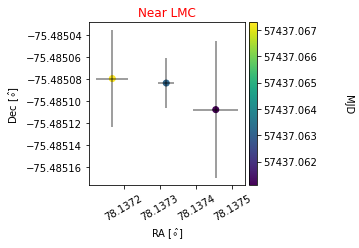

v_ra =  64.4892698722221 , v_dec =  51.07566294754064


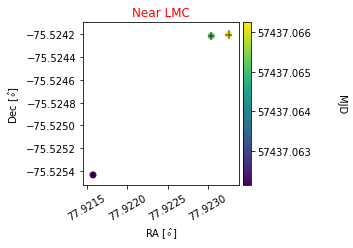

v_ra =  82.83752878339529 , v_dec =  15.080022873250932


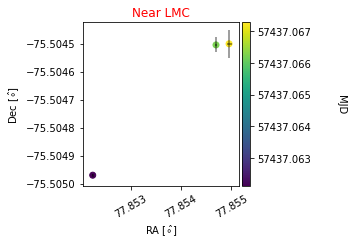

v_ra =  -176.93524333718418 , v_dec =  3.9204405762351957


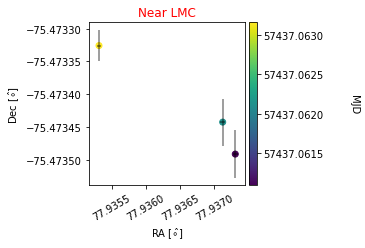

v_ra =  -202.34398465803895 , v_dec =  -227.06707080189298


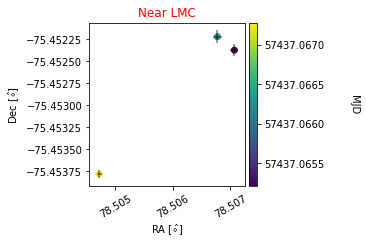

v_ra =  -283.3508790524959 , v_dec =  161.62860609914168


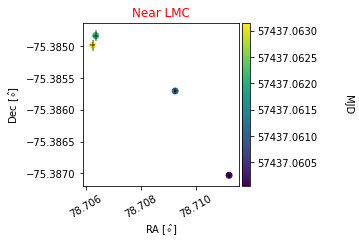

v_ra =  -24.98636847108048 , v_dec =  3.9215611854811514


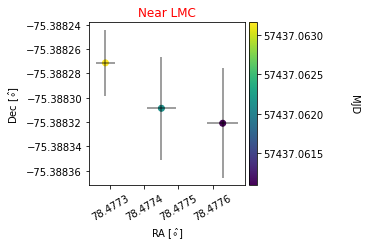

v_ra =  -88.61585704589709 , v_dec =  19.064696457596757


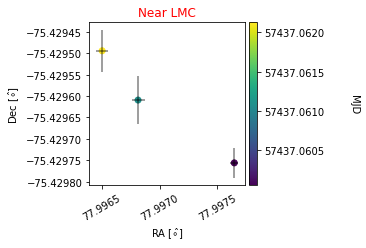

v_ra =  -42.98251244114587 , v_dec =  -5.1748474941706135


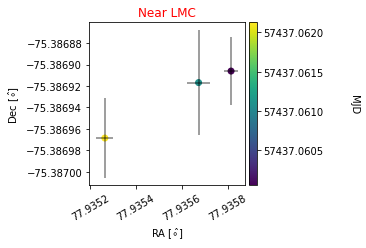

v_ra =  -75.03971852850398 , v_dec =  170.0448170629397


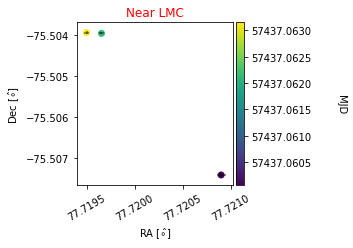

v_ra =  64.3841953859313 , v_dec =  208.33717311992802


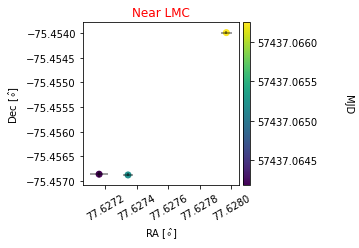

v_ra =  58.30706076802128 , v_dec =  90.4747603789214


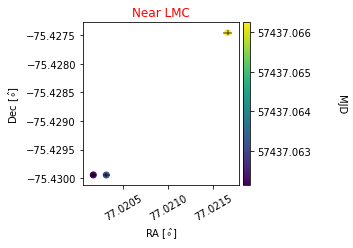

v_ra =  -38.67827072630065 , v_dec =  -10.236431226310716


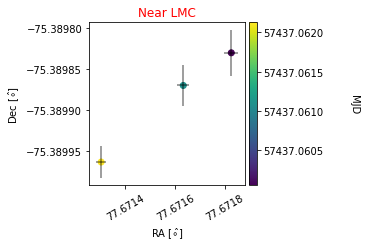

v_ra =  -58.12649189918998 , v_dec =  -10.348039001329136


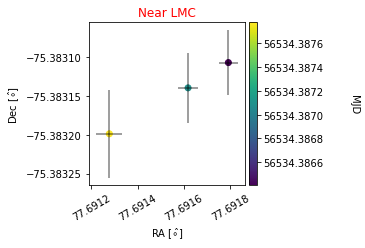

v_ra =  46.95381734834899 , v_dec =  68.45087472507014


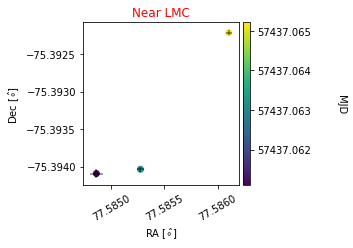

v_ra =  -87.17394996922538 , v_dec =  93.01891948586153


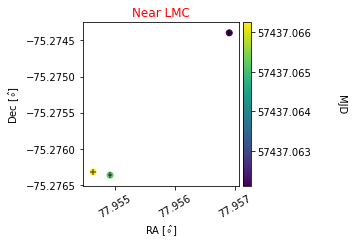

v_ra =  28.868691700195395 , v_dec =  -0.5049772843070172


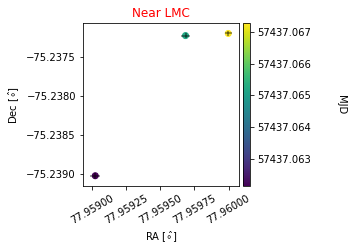

v_ra =  130.26375344677618 , v_dec =  -77.42137850776274


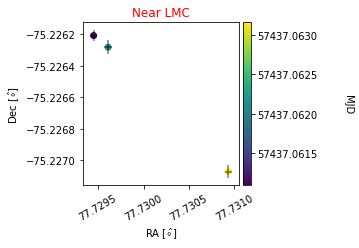

v_ra =  -34.32903170506866 , v_dec =  -0.6702581048841294


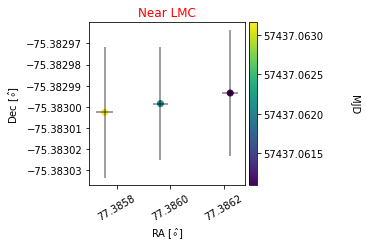

v_ra =  73.0203511944372 , v_dec =  -4.974736222580955


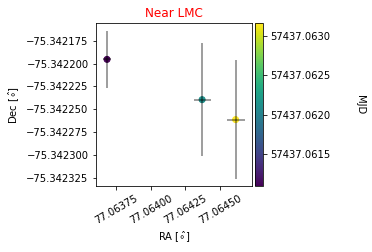

v_ra =  54.99122253894895 , v_dec =  8.735714196449662


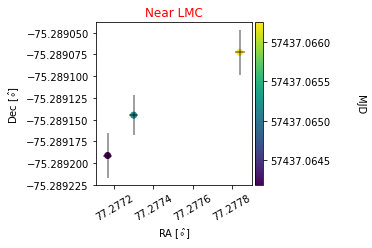

v_ra =  53.85562151164228 , v_dec =  -21.645595536665894


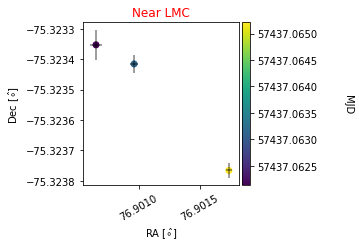

v_ra =  -150.24254157972302 , v_dec =  -157.7826818922438


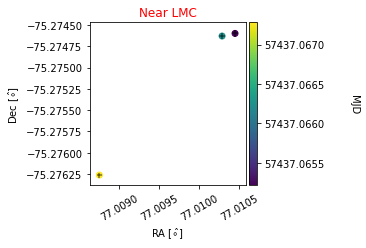

v_ra =  58.80543489379167 , v_dec =  -36.77465944650076


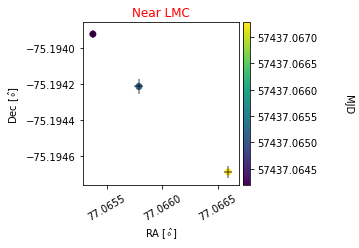

v_ra =  -95.82369798701346 , v_dec =  -27.306940333242213


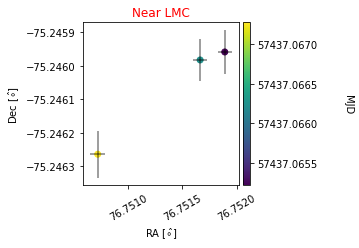

v_ra =  -289.3967698955932 , v_dec =  24.486823230677004


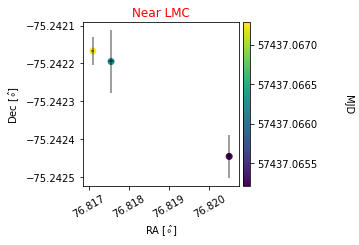

v_ra =  -39.09412169620423 , v_dec =  -3.091198587378038


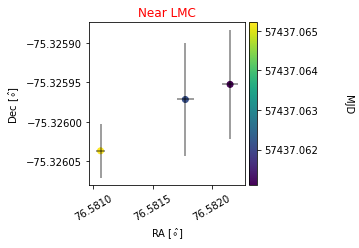

v_ra =  -59.58307732368462 , v_dec =  91.35493078719554


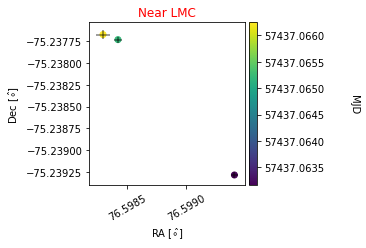

v_ra =  125.39091823199527 , v_dec =  -50.75384219793806


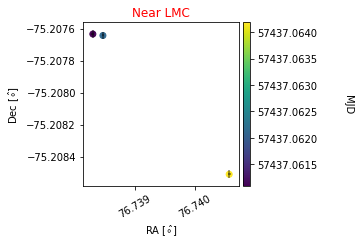

v_ra =  -15.537269271685384 , v_dec =  -0.5184505394397653


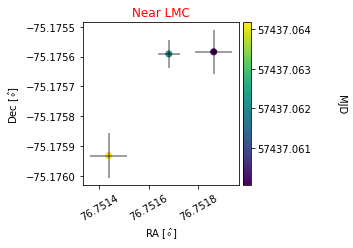

v_ra =  -257.0949532213196 , v_dec =  -109.75745660624847


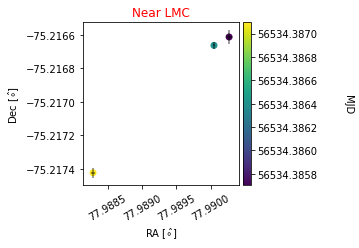

v_ra =  -128.88857471612903 , v_dec =  -74.4205323242599


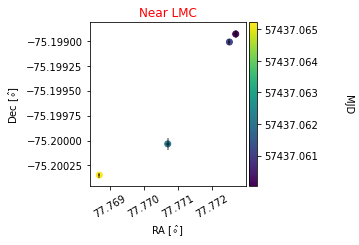

v_ra =  12.845502504560272 , v_dec =  -1.3327842500800913


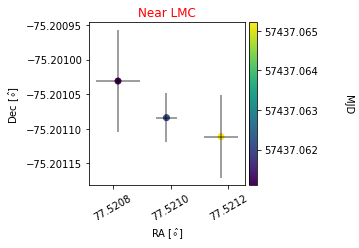

v_ra =  284.6037677736063 , v_dec =  -79.28668732600154


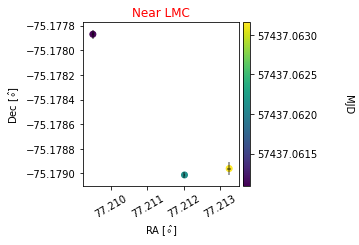

v_ra =  -34.53313420359253 , v_dec =  2.5640336262388517


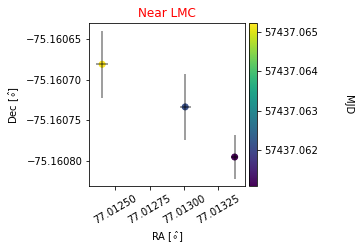

v_ra =  -132.270071129599 , v_dec =  21.57754051387036


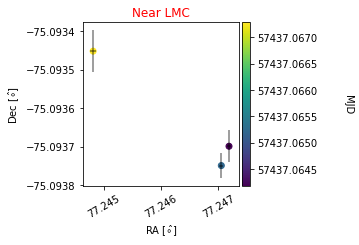

v_ra =  -17.81577579264289 , v_dec =  -7.656847250812152


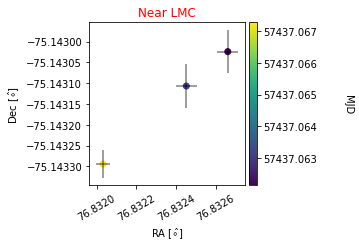

v_ra =  -40.74386813602984 , v_dec =  83.42889473409484


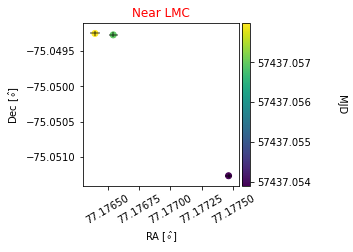

v_ra =  -52.23844191844905 , v_dec =  -102.48699684665449


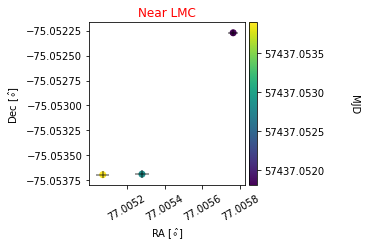

v_ra =  -63.197236084496325 , v_dec =  24.894422296282954


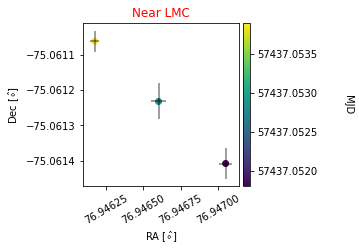

v_ra =  -219.64259704972952 , v_dec =  12.412088107855128


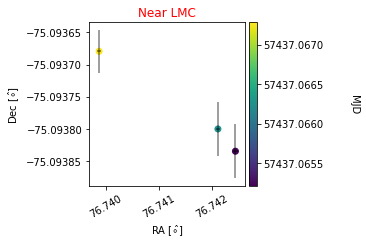

v_ra =  8.733160441419331 , v_dec =  -9.780948100871287


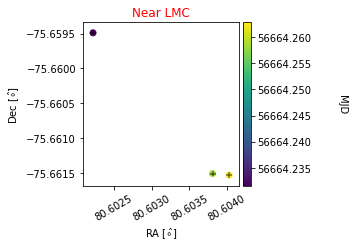

v_ra =  -28.6707402006293 , v_dec =  -3.0228440212388334


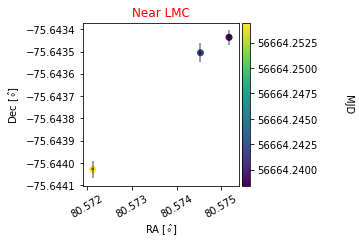

v_ra =  107.0862675770768 , v_dec =  48.0304203368082


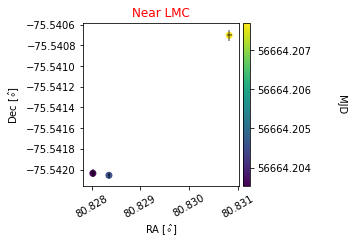

v_ra =  45.831389627008356 , v_dec =  -7.899390014595632


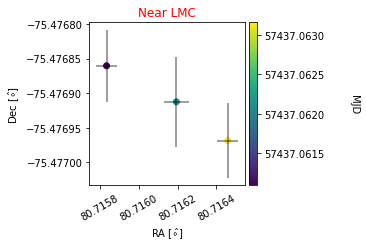

v_ra =  -56.98640416525409 , v_dec =  -77.52655283306267


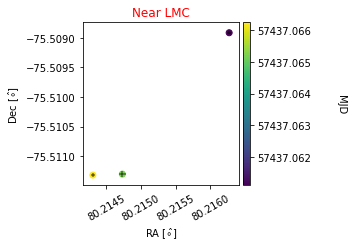

v_ra =  117.6914572086675 , v_dec =  -9.148927417411135


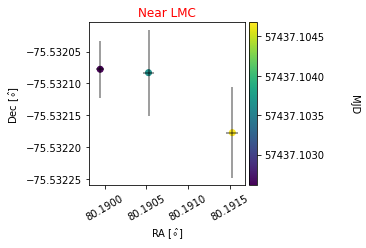

v_ra =  144.7430537836263 , v_dec =  -58.47898989990653


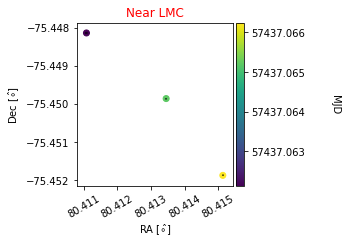

v_ra =  23.356625634311182 , v_dec =  3.6567839528864563


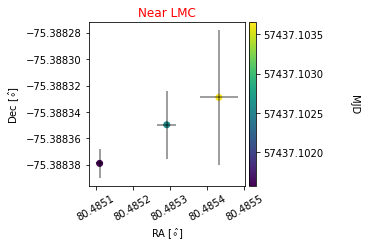

v_ra =  118.57905932978785 , v_dec =  -226.6697696516054


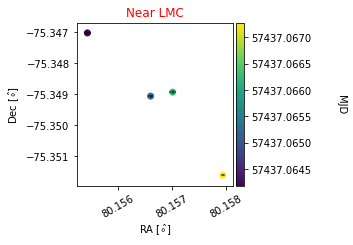

v_ra =  15.6328445828157 , v_dec =  -8.066516145424071


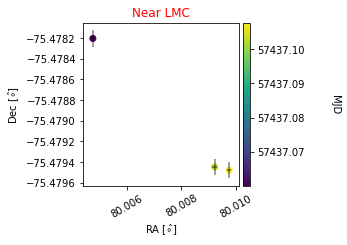

v_ra =  -50.72548410202629 , v_dec =  1.5915372856445436


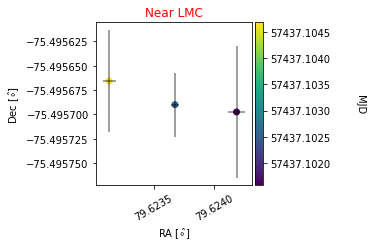

v_ra =  -22.982999440431485 , v_dec =  10.366885315933539


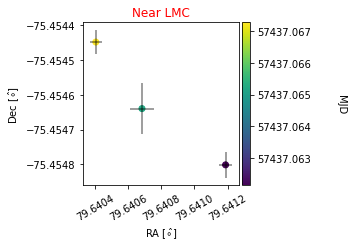

v_ra =  -179.5409834415199 , v_dec =  90.41190424023381


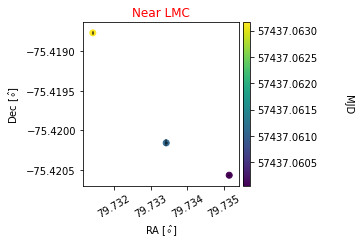

v_ra =  -15.960454769725944 , v_dec =  39.566714381858674


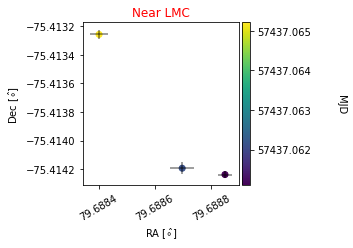

v_ra =  129.38434468132075 , v_dec =  -48.829803482685314


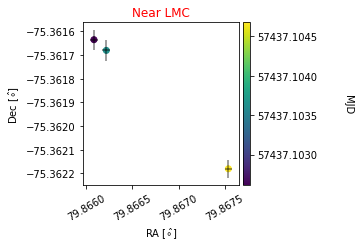

v_ra =  -25.296757702573704 , v_dec =  2.923734363466183


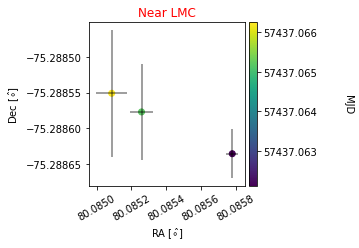

v_ra =  101.22867324343866 , v_dec =  -61.65610131421153


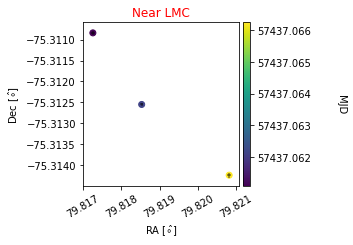

v_ra =  26.31817205066498 , v_dec =  7.345132415582273


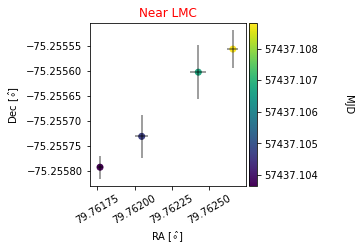

v_ra =  160.0050646921541 , v_dec =  -21.047219198446562


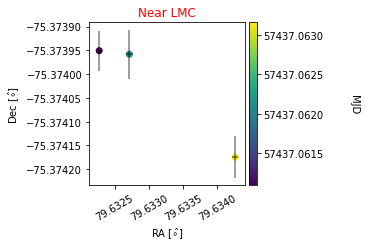

v_ra =  -91.67710585254753 , v_dec =  1.961506777914467


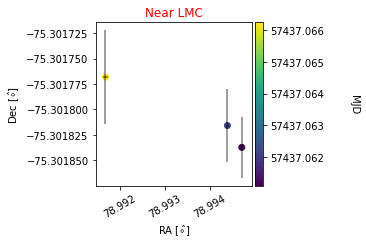

v_ra =  33.70157258112824 , v_dec =  -2.412740977008902


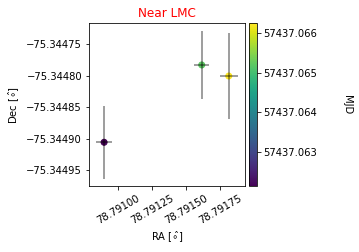

v_ra =  47.9259730281945 , v_dec =  0.22569482139056163


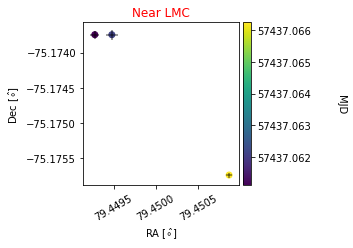

v_ra =  -21.863995745433055 , v_dec =  -1.81111370810982


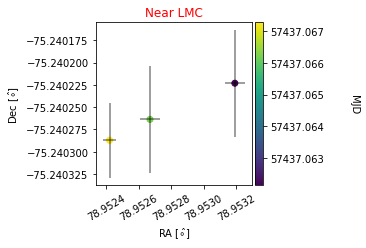

v_ra =  9.823718953971998 , v_dec =  -2.8034960776098443


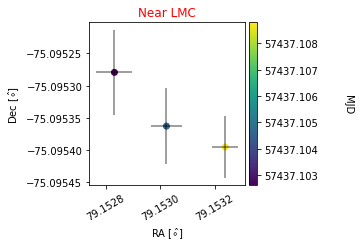

v_ra =  48.88197411561014 , v_dec =  46.16071753990155


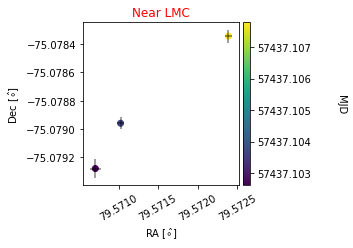

v_ra =  148.56746371366611 , v_dec =  36.60153867642882


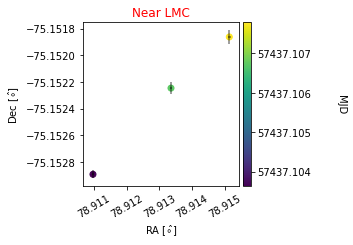

v_ra =  11.891279412273484 , v_dec =  -2.499642284742911


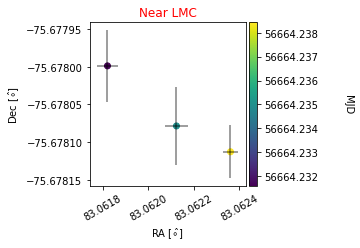

v_ra =  8.280136816970158 , v_dec =  0.7970900105431667


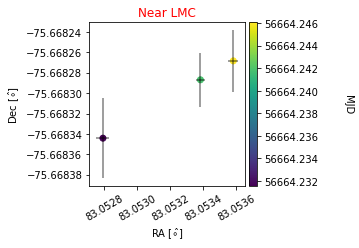

v_ra =  6.441746099708893 , v_dec =  7.746905659232336


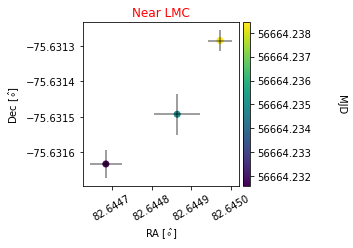

v_ra =  -155.5405913603548 , v_dec =  124.01611796853761


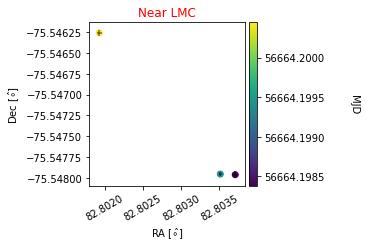

v_ra =  -33.87518940632997 , v_dec =  -4.986729391994693


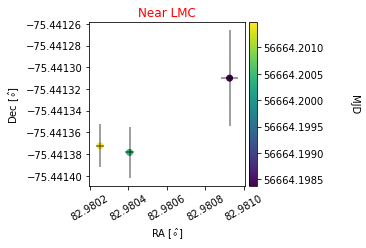

v_ra =  194.4552697695655 , v_dec =  32.95080474118814


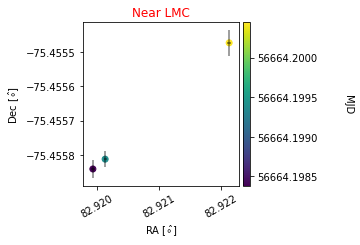

v_ra =  11.971079125430885 , v_dec =  -1.650987663728112


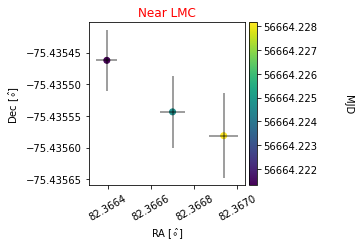

v_ra =  5.803631404547727 , v_dec =  -18.181713939591106


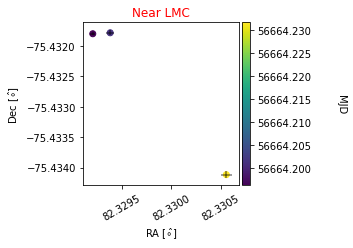

v_ra =  5.87108170057006 , v_dec =  -0.09164413758037293


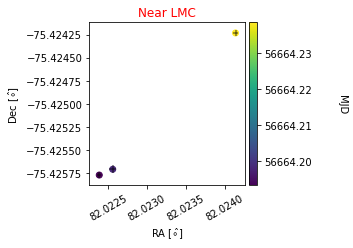

v_ra =  74.31236044653832 , v_dec =  -148.56616690588055


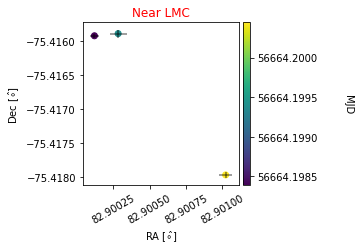

v_ra =  128.92948728560728 , v_dec =  137.2770762559002


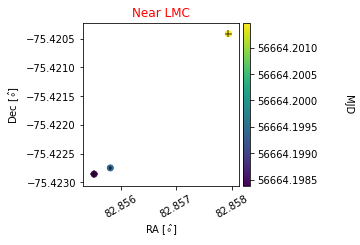

v_ra =  -33.399057866746105 , v_dec =  4.039243300088312


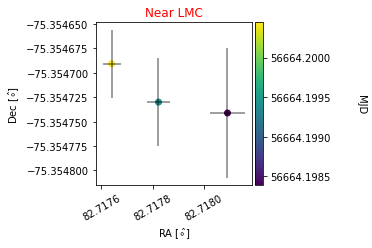

v_ra =  -64.86581254437894 , v_dec =  -49.415604615286696


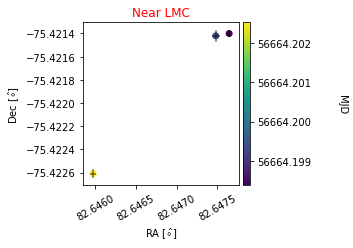

v_ra =  46.36722767590923 , v_dec =  17.659818618391533


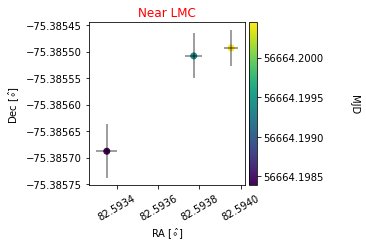

v_ra =  155.825922625952 , v_dec =  -123.33824878245396


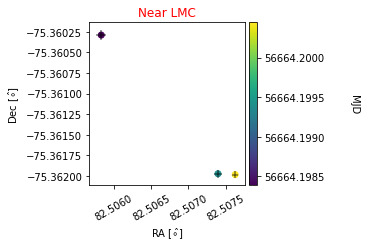

v_ra =  60.805022894761436 , v_dec =  14.93926464731336


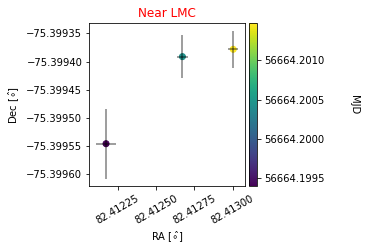

v_ra =  108.28769539418467 , v_dec =  -10.262202679560477


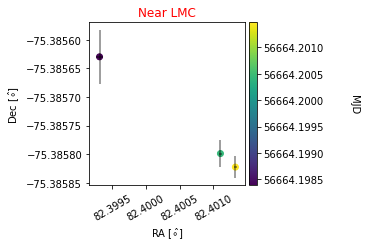

v_ra =  45.89864240756646 , v_dec =  -281.04681334322026


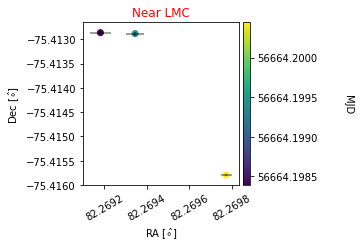

v_ra =  -102.26661305523875 , v_dec =  -29.92939983514333


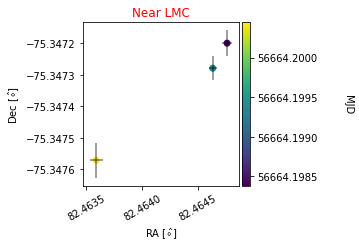

v_ra =  -50.42336149805465 , v_dec =  -88.40648450733482


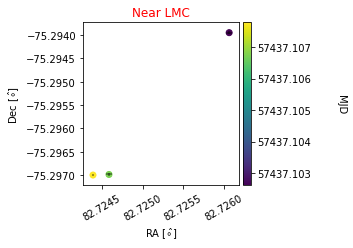

v_ra =  85.22457873505931 , v_dec =  97.50059295026944


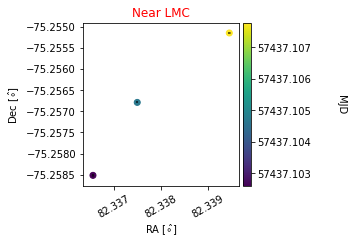

v_ra =  -68.5942045288998 , v_dec =  -84.88501036637389


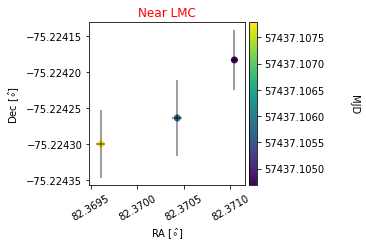

v_ra =  -62.00965178058541 , v_dec =  152.0448986856052


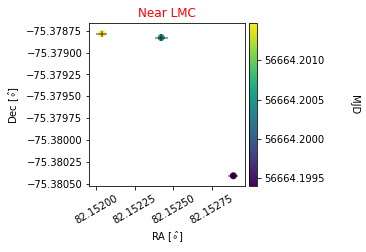

v_ra =  62.36771460628663 , v_dec =  -69.11005379493857


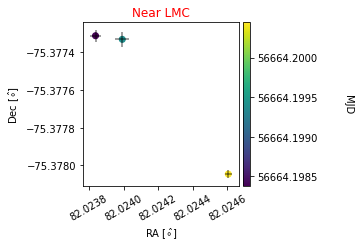

v_ra =  309.1898224770198 , v_dec =  -127.21682109416338


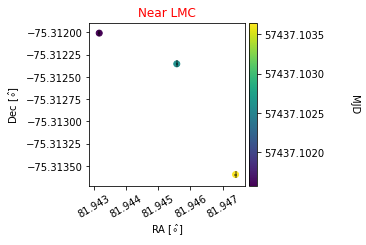

v_ra =  -146.5209067672117 , v_dec =  -352.8266604507954


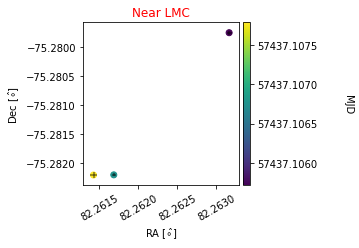

v_ra =  53.911458944284014 , v_dec =  2.9658925895722663


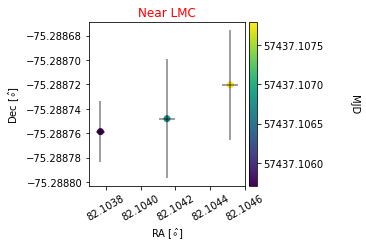

v_ra =  -44.12630923130157 , v_dec =  5.598631330028501


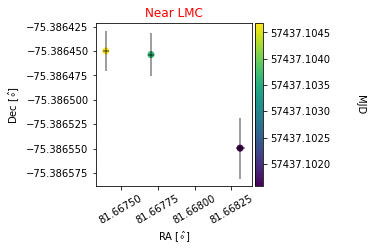

v_ra =  -172.53446992109923 , v_dec =  109.03307583956371


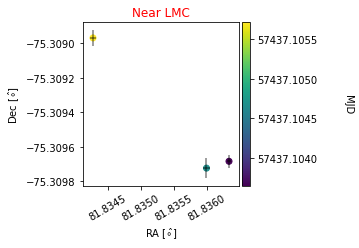

v_ra =  12.668472656664735 , v_dec =  3.384237419199536


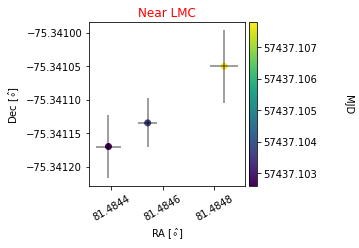

v_ra =  180.6108267053257 , v_dec =  -34.804506192155166


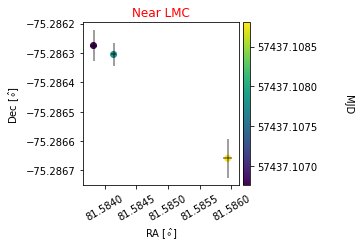

v_ra =  42.380859201241975 , v_dec =  -78.16972787357442


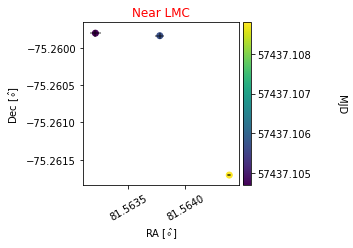

v_ra =  -107.22684211245416 , v_dec =  62.67996010293041


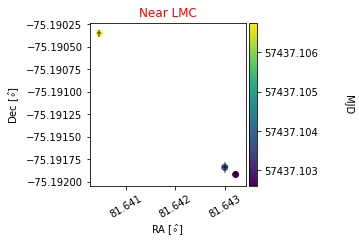

v_ra =  176.19743644976634 , v_dec =  216.34296818973837


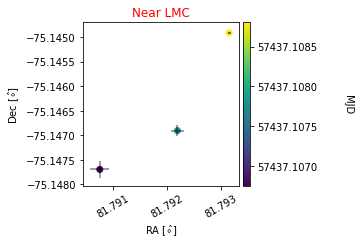

v_ra =  93.20986108925484 , v_dec =  12.114994997086812


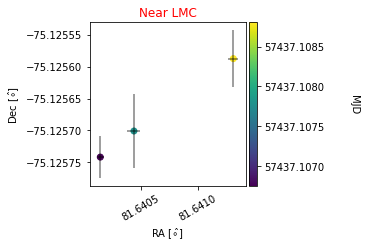

v_ra =  48.53324318431235 , v_dec =  -31.09368264192084


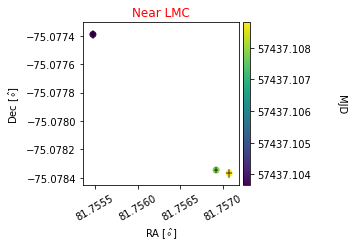

v_ra =  -241.8513708871816 , v_dec =  29.008554566673457


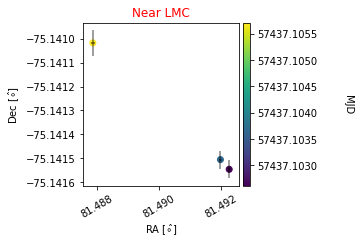

v_ra =  -64.62393720940445 , v_dec =  -124.05888214010396


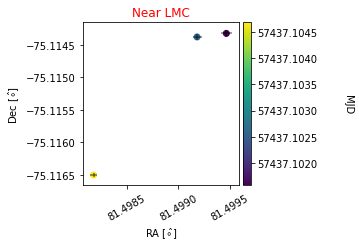

v_ra =  -4.191357806877769 , v_dec =  7.117698496613183


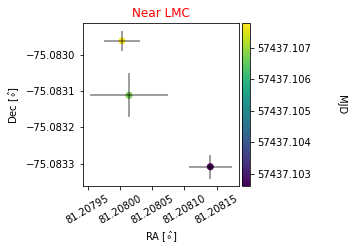

v_ra =  -32.503624261549696 , v_dec =  -1.3645744611877149


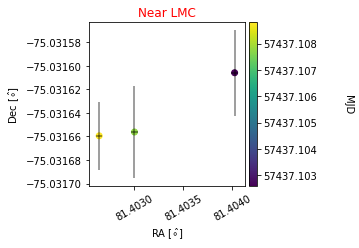

v_ra =  -26.505184653697764 , v_dec =  7.7874214700367475


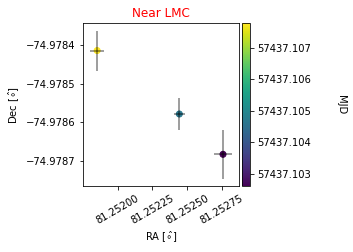

v_ra =  -6.85536673491428 , v_dec =  0.3020797436514777


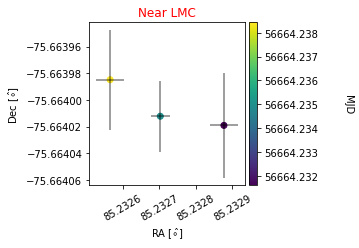

v_ra =  390.2896528602302 , v_dec =  -241.02885063032167


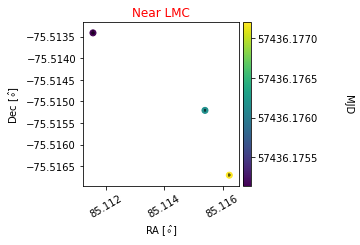

v_ra =  -36.499863133256575 , v_dec =  5.996214741368889


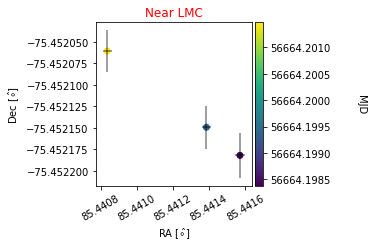

v_ra =  -27.291464282980783 , v_dec =  -66.92553459206611


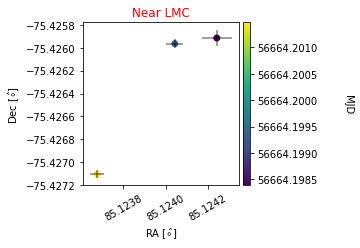

v_ra =  158.5272912257947 , v_dec =  32.725061663542


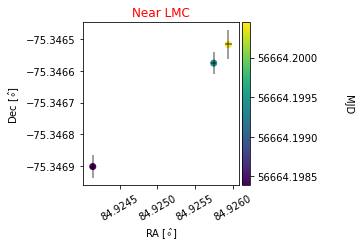

v_ra =  -13.498423565967384 , v_dec =  -15.665452706520107


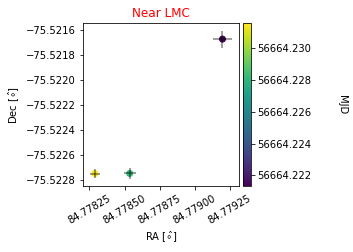

v_ra =  -6.697253787707825 , v_dec =  -1.685549381075937


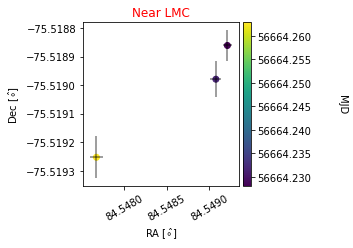

v_ra =  18.28232858494955 , v_dec =  0.2938972500742973


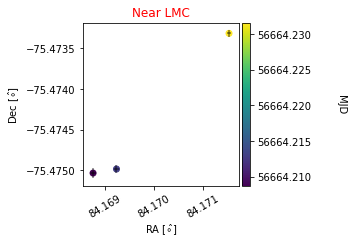

v_ra =  27.5492735874404 , v_dec =  6.301115361835719


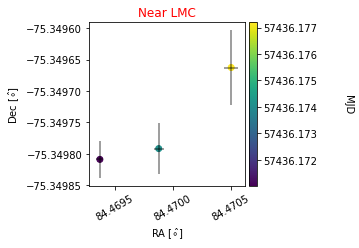

v_ra =  -8.852576339338048 , v_dec =  2.34835552219551


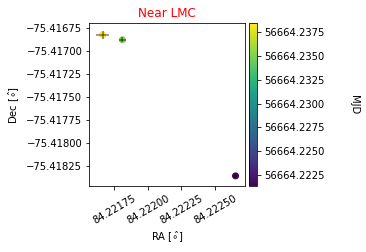

v_ra =  -79.91582842363438 , v_dec =  94.4572336031175


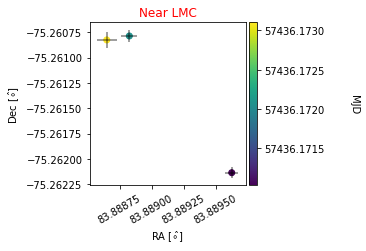

v_ra =  56.094591945689864 , v_dec =  48.69105562378747


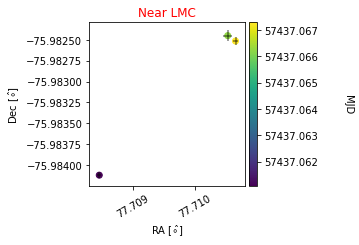

v_ra =  -42.684483087945786 , v_dec =  18.128202408121776


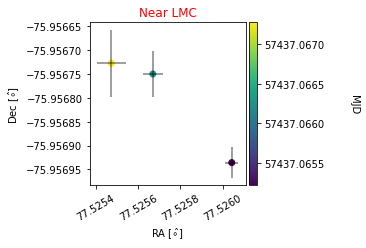

v_ra =  -81.94593641256643 , v_dec =  -4.175944597539095


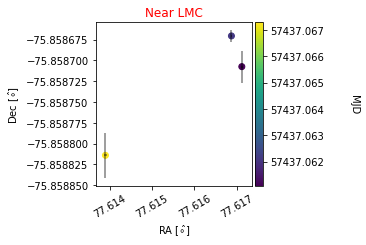

v_ra =  -83.33747305717884 , v_dec =  150.24584554918448


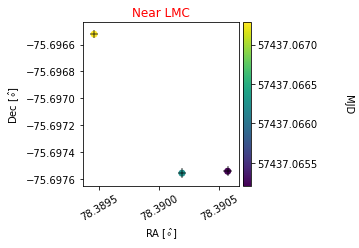

v_ra =  -32.382709925266845 , v_dec =  -5.995631995852758


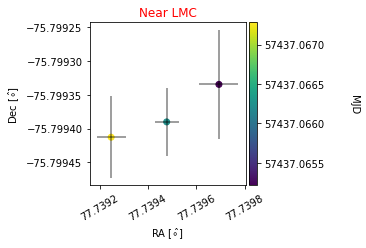

v_ra =  15.853503644208295 , v_dec =  -4.329127369734686


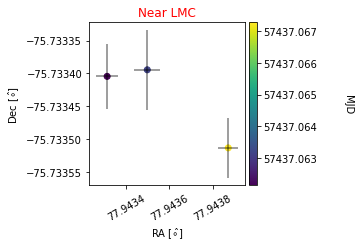

v_ra =  -67.3886691916306 , v_dec =  31.23650365961882


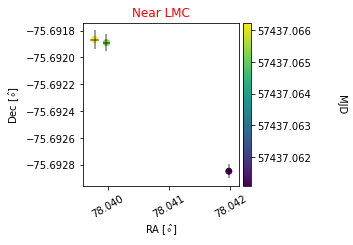

v_ra =  -79.33036203632051 , v_dec =  41.3757576190768


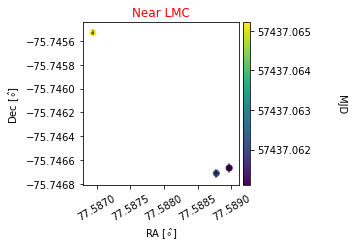

v_ra =  -89.16787364695894 , v_dec =  -1.2226141745561152


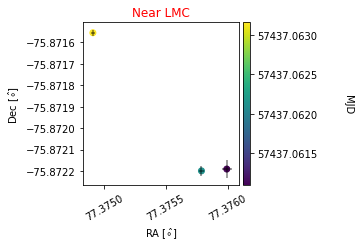

v_ra =  -24.127183261574036 , v_dec =  32.097378449450225


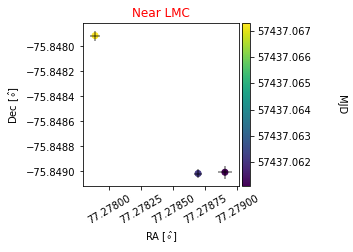

v_ra =  189.94811536055389 , v_dec =  4.290203338755948


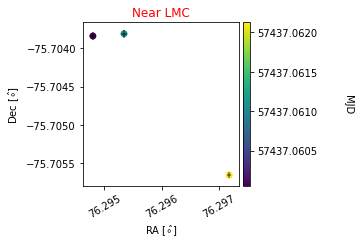

v_ra =  58.89748450694453 , v_dec =  -75.6203893173845


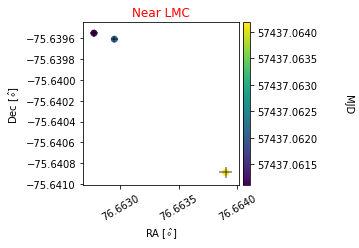

v_ra =  -92.08874339340917 , v_dec =  2.934826628069603


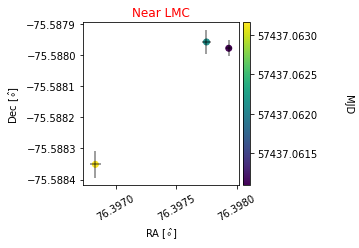

v_ra =  -94.34533766779406 , v_dec =  16.93949073563434


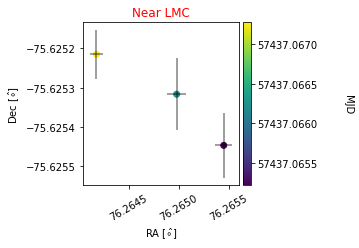

v_ra =  -35.83912883250908 , v_dec =  -88.71512157779817


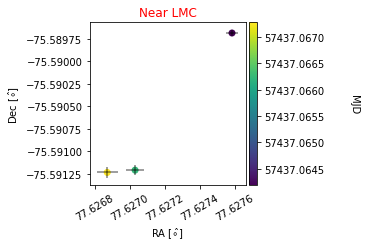

v_ra =  -267.7527162390496 , v_dec =  45.48990797867453


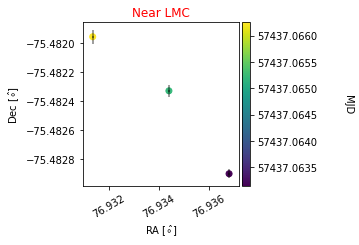

v_ra =  37.38190372697421 , v_dec =  -2.784544955969182


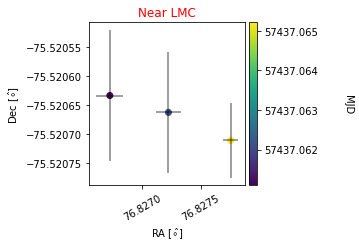

v_ra =  -49.07796537274509 , v_dec =  41.748118073147886


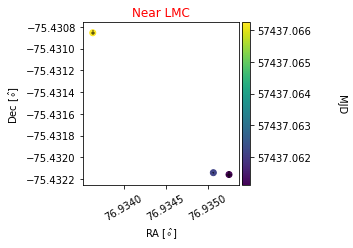

v_ra =  50.68473471783921 , v_dec =  -141.84983330244455


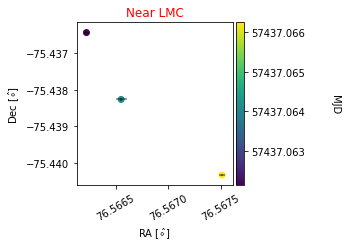

v_ra =  9.607876258046103 , v_dec =  0.8179603225613047


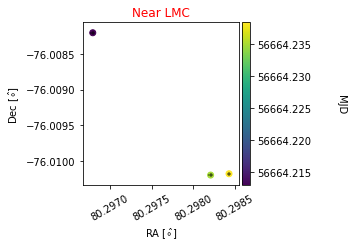

v_ra =  -7.755325219884171 , v_dec =  1.2165075543116968


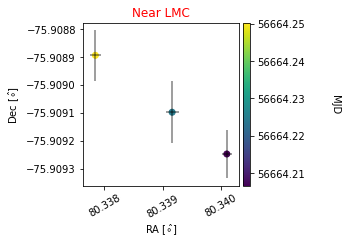

v_ra =  -7.988820938327493 , v_dec =  -14.496631823767565


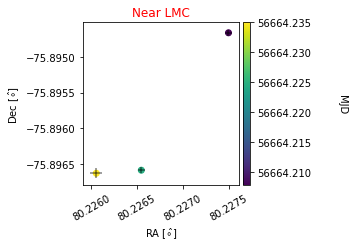

v_ra =  -2.4975910485650608 , v_dec =  -5.098430784127278


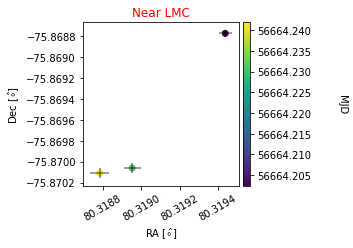

v_ra =  8.247589583811717 , v_dec =  0.7559482349222164


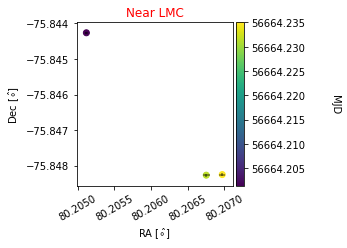

v_ra =  12.590101350432725 , v_dec =  -0.22648880517232015


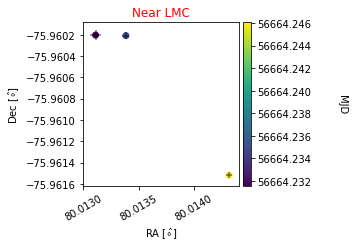

v_ra =  -4.860831164144702 , v_dec =  -0.0863262545079626


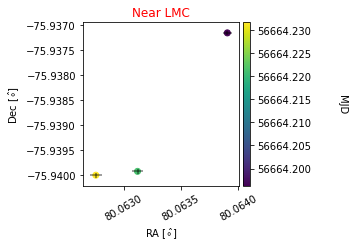

v_ra =  8.698545053573673 , v_dec =  -9.575740836316735


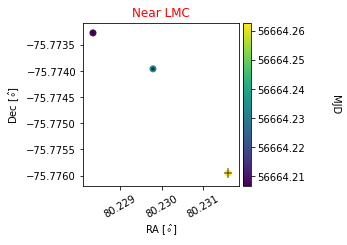

v_ra =  9.14702562495956 , v_dec =  -2.548366131000138


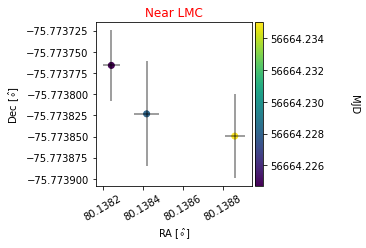

v_ra =  224.4566649859363 , v_dec =  -296.34928088354155


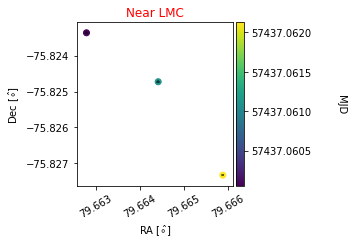

v_ra =  39.411757745127716 , v_dec =  -3.9670024754441386


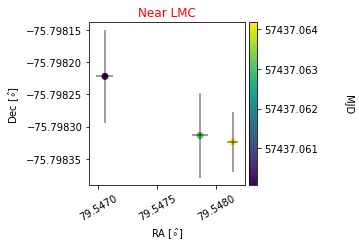

v_ra =  70.08406444783228 , v_dec =  -128.93924187937827


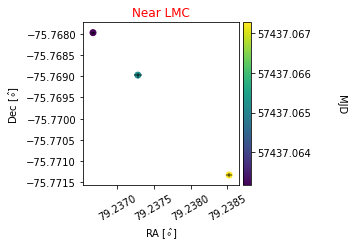

v_ra =  -17.75797959985353 , v_dec =  -2.4111730616181393


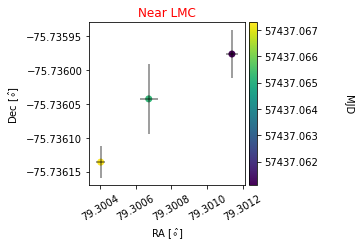

v_ra =  107.62153249498085 , v_dec =  10.516489235061998


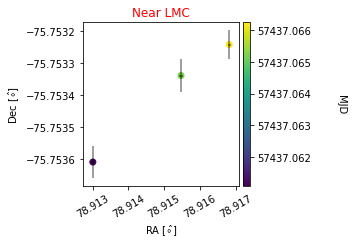

v_ra =  32.35721195405965 , v_dec =  -1.9682820521716833


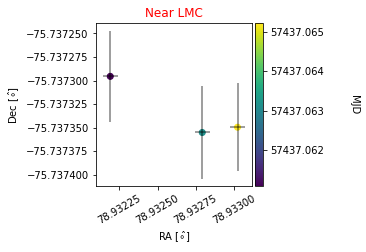

v_ra =  173.67676469305522 , v_dec =  134.38567136792747


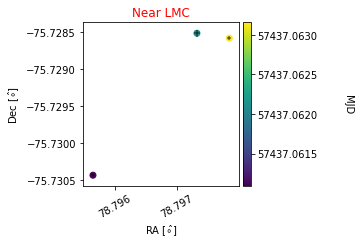

v_ra =  -168.14343784836987 , v_dec =  89.6423417757847


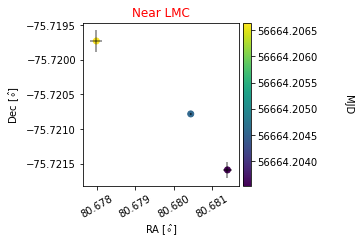

v_ra =  84.90474111404929 , v_dec =  -3.262212465712231


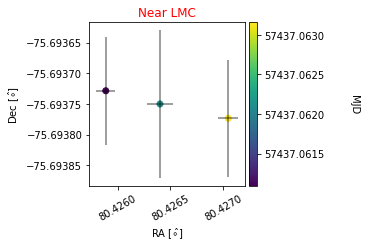

v_ra =  91.73307588850601 , v_dec =  -37.178479296054796


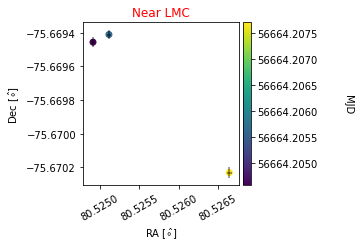

v_ra =  -81.94115508198301 , v_dec =  24.33141721614781


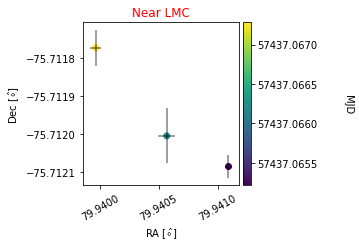

v_ra =  -89.8394923546618 , v_dec =  19.070130853003878


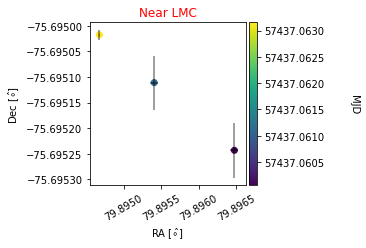

v_ra =  117.04421670312841 , v_dec =  65.05951121569815


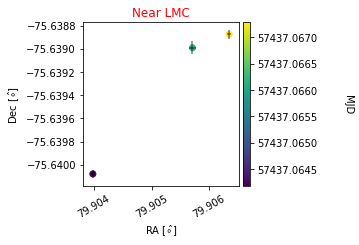

v_ra =  -59.19205352434815 , v_dec =  49.14874855376099


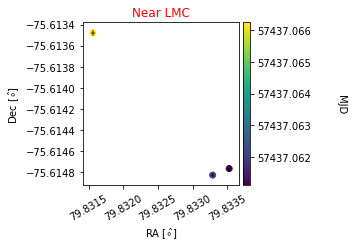

v_ra =  67.15268389658142 , v_dec =  -64.44949302651317


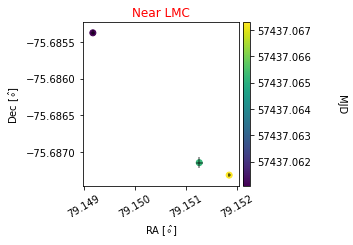

v_ra =  52.14116851888888 , v_dec =  -10.621151682328135


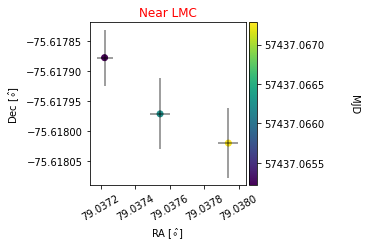

v_ra =  45.03167055641007 , v_dec =  3.794699802850419


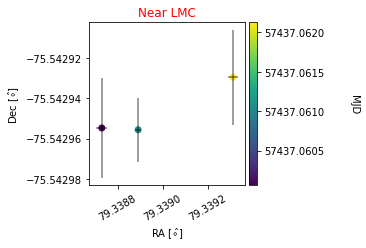

v_ra =  -83.14256018450567 , v_dec =  9.071094122541473


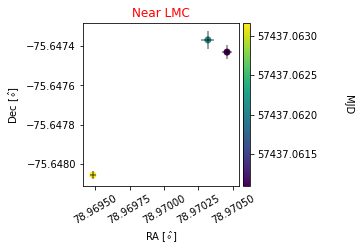

v_ra =  -21.894132149003894 , v_dec =  -27.614177121890496


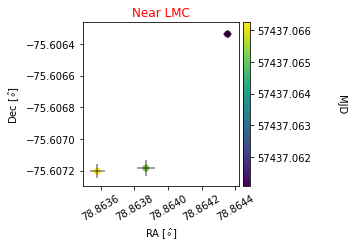

v_ra =  -121.53842632723844 , v_dec =  64.84764656656267


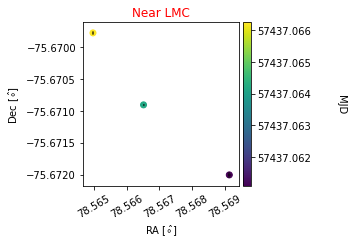

v_ra =  48.865542818762485 , v_dec =  9.861394512795103


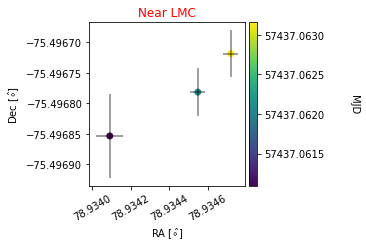

v_ra =  -134.56279121156246 , v_dec =  -133.8502128984606


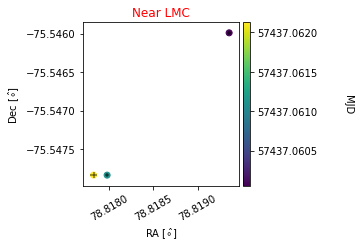

v_ra =  -20.384133705783725 , v_dec =  -6.952807766066441


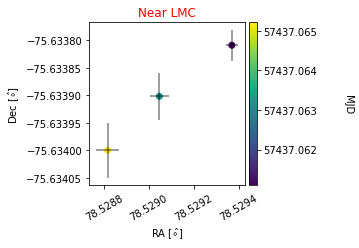

v_ra =  10.657837106879496 , v_dec =  -7.322649148607027


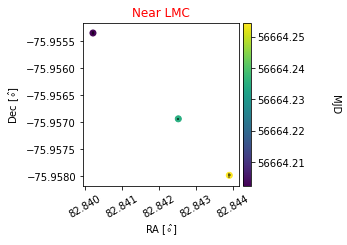

v_ra =  -35.13855673237195 , v_dec =  -2.6357571112870937


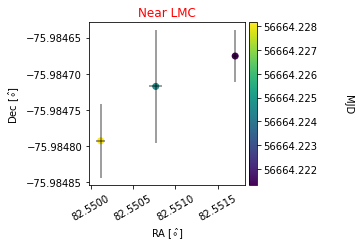

v_ra =  14.912789722847043 , v_dec =  16.519594645357774


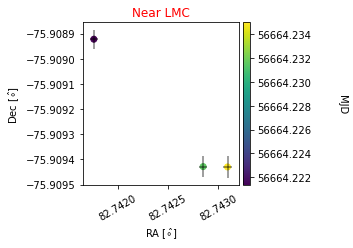

v_ra =  62.092907154345774 , v_dec =  3.082129487136369


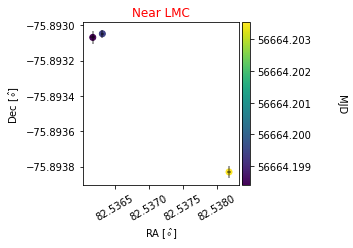

v_ra =  -5.805609432347752 , v_dec =  13.886836335452935


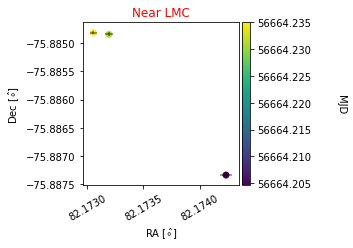

v_ra =  -6.55342879791839 , v_dec =  -0.8070417417660622


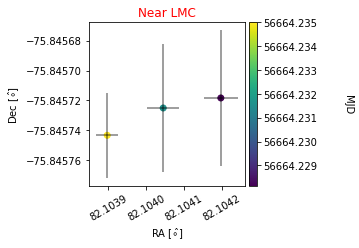

v_ra =  -7.7873180069266335 , v_dec =  19.946385500523082


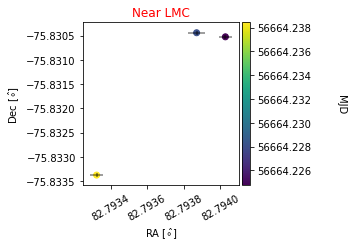

v_ra =  -4.200553575201618 , v_dec =  0.2769924431819512


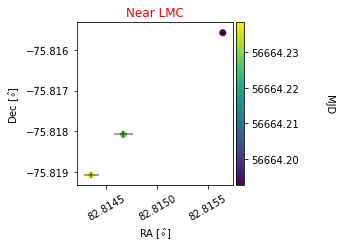

v_ra =  2.208863235992288 , v_dec =  -0.1883419274295199


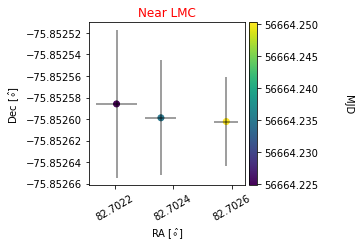

v_ra =  -33.71733027848951 , v_dec =  -1.5250670672460604


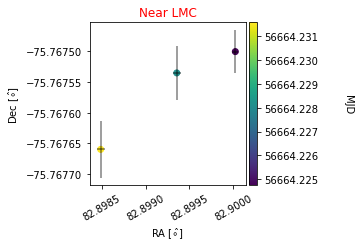

v_ra =  6.388474774124325 , v_dec =  -1.9107280799551098


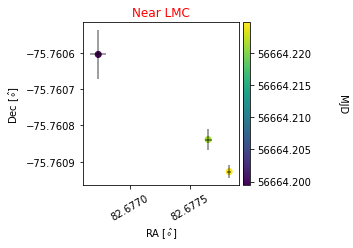

v_ra =  41.958494090971776 , v_dec =  2.33226662857471


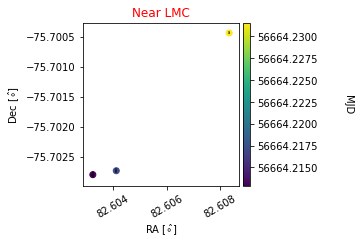

v_ra =  10.594659345598428 , v_dec =  5.029696486104646


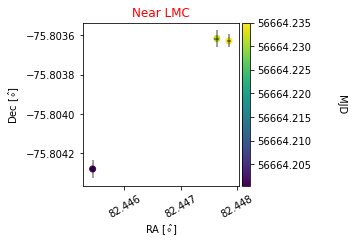

v_ra =  16.546212852254005 , v_dec =  -9.809630911342424


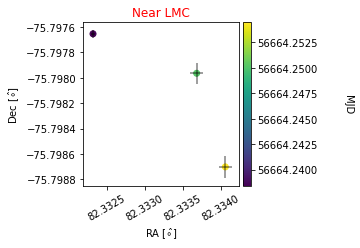

v_ra =  -13.656753288681251 , v_dec =  18.498987683669892


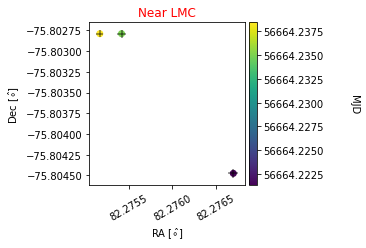

v_ra =  -53.183236904447305 , v_dec =  -314.82362846286526


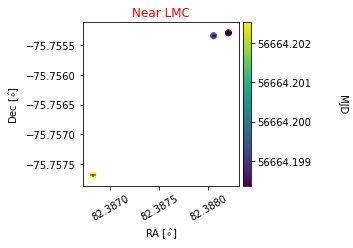

v_ra =  -12.543096398465897 , v_dec =  2.993852771536512


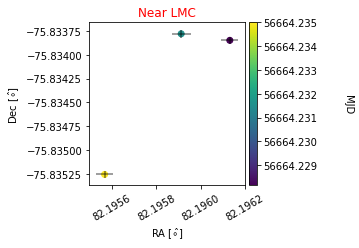

v_ra =  -38.12159735525085 , v_dec =  8.324078945989134


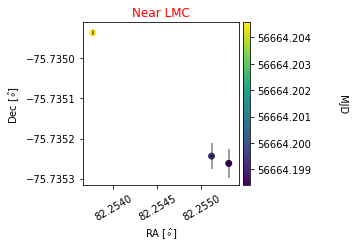

v_ra =  28.56030722064369 , v_dec =  -67.00322004108152


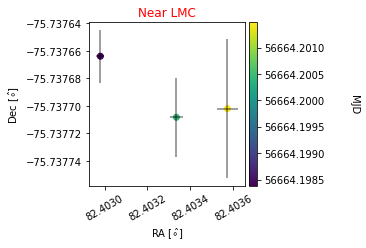

v_ra =  -18.703658703498114 , v_dec =  6.368843315423533


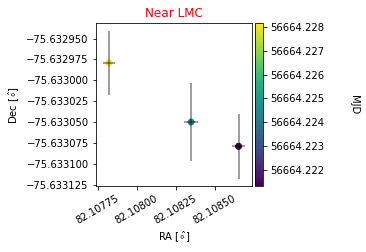

v_ra =  -5.738719366661083 , v_dec =  -4.518256799651748


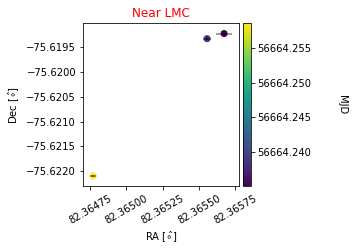

v_ra =  -7.245074723461157 , v_dec =  -3.6615864346982554


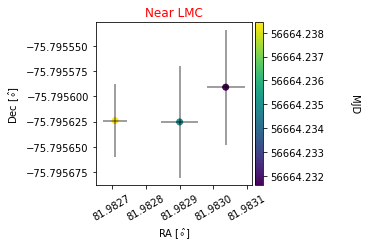

v_ra =  -28.990397529386016 , v_dec =  0.5851733450971803


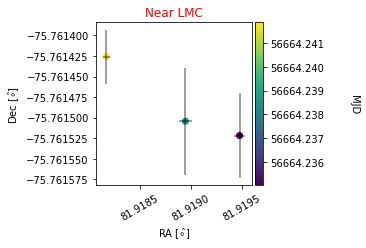

v_ra =  35.001825950226866 , v_dec =  -16.839697114016534


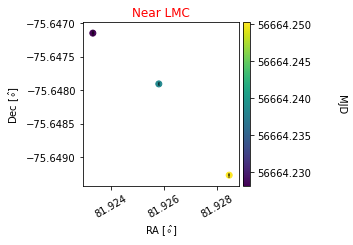

v_ra =  20.316753860616533 , v_dec =  -25.49157927422175


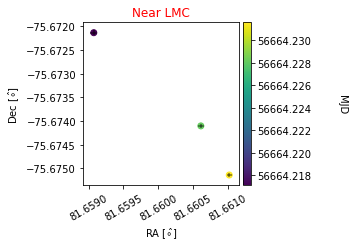

v_ra =  -8.473923716547498 , v_dec =  -43.9769749060056


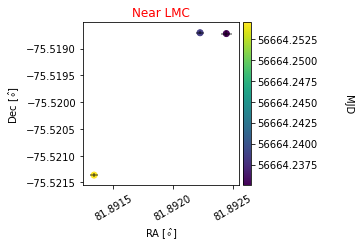

v_ra =  -10.02540105438485 , v_dec =  1.028473769214256


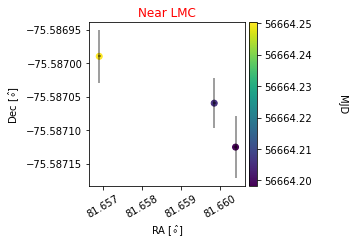

v_ra =  27.511949945679333 , v_dec =  -3.355834413914176


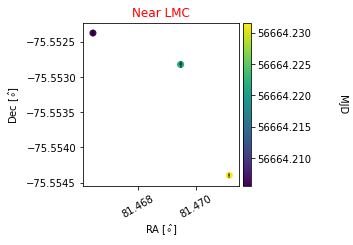

v_ra =  -18.947729673782565 , v_dec =  -15.044570547419616


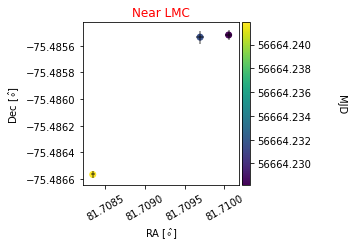

v_ra =  -5.791992887924905 , v_dec =  -13.655640428024823


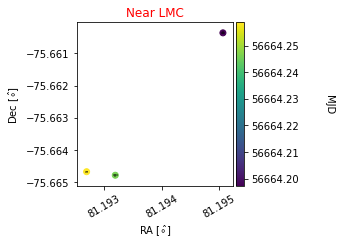

v_ra =  -5.1526713899150245 , v_dec =  3.6619586613479584


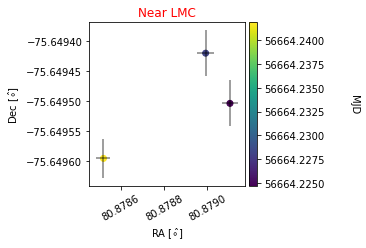

v_ra =  11.39229590568416 , v_dec =  -13.236987168420876


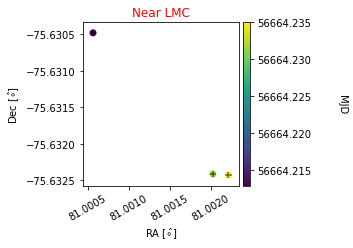

v_ra =  -12.879622911916812 , v_dec =  -10.30484781729219


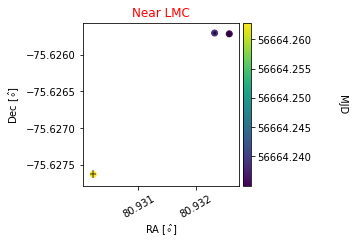

v_ra =  -15.61322545556866 , v_dec =  -0.1165487707719624


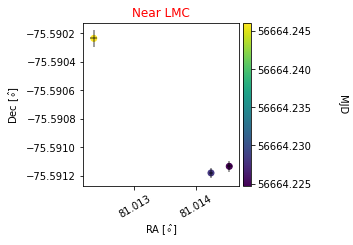

v_ra =  -51.55332994217275 , v_dec =  7.354610145755824


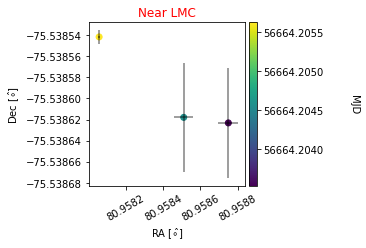

v_ra =  -38.92308778157368 , v_dec =  2.036013567331404


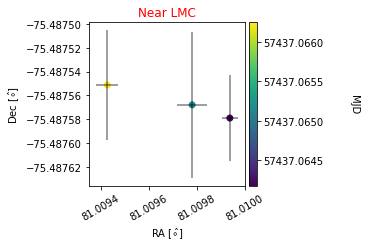

v_ra =  25.484577291109122 , v_dec =  -4.906270072425204


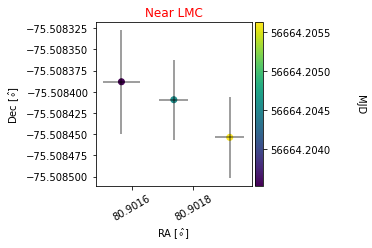

v_ra =  244.0645786758861 , v_dec =  176.0204136819508


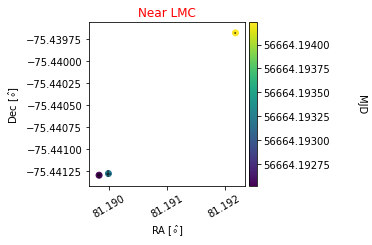

v_ra =  11.194524013589323 , v_dec =  -39.981671831977145


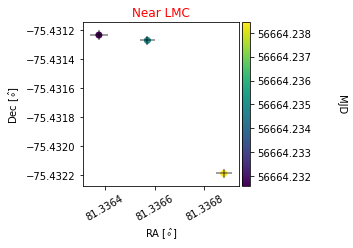

v_ra =  14.24003954807101 , v_dec =  21.32636038542274


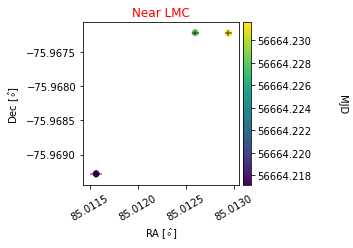

v_ra =  8.112604110198955 , v_dec =  0.9806169562720172


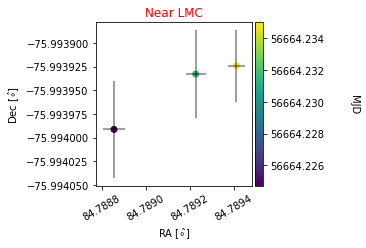

v_ra =  -8.521611267397548 , v_dec =  -8.834382115546253


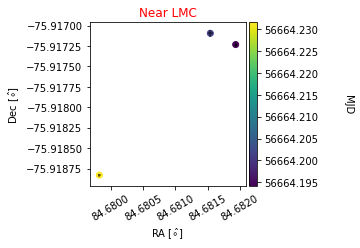

v_ra =  -6.59099435428222 , v_dec =  2.1073500543650794


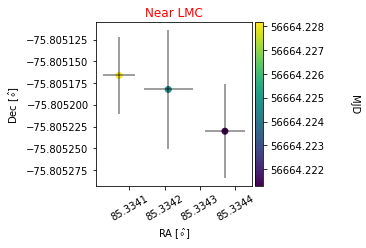

v_ra =  -10.713032256465489 , v_dec =  3.586385069638625


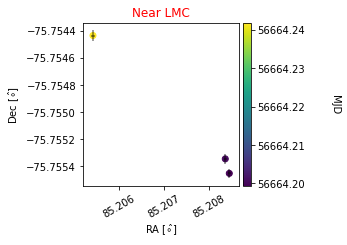

v_ra =  9.963656397714944 , v_dec =  4.283464287563203


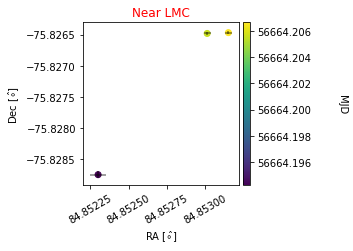

v_ra =  -34.46089411980879 , v_dec =  -24.448140573253355


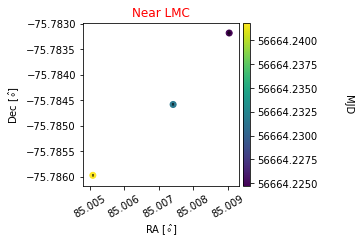

v_ra =  14.202660624991951 , v_dec =  3.8787026041780446


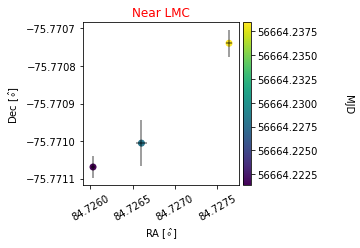

v_ra =  13.416158747470666 , v_dec =  1.718904450969987


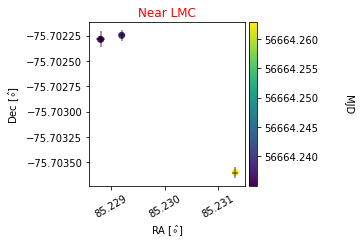

v_ra =  -7.231479308975801 , v_dec =  -2.78592837920619


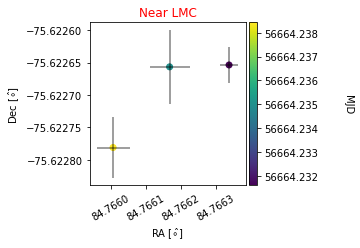

v_ra =  -9.675511365059725 , v_dec =  -13.482077905017858


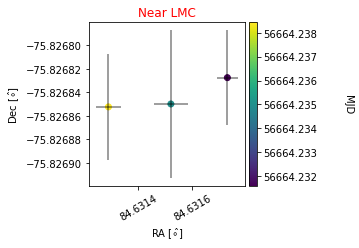

v_ra =  -7.813580576212932 , v_dec =  -4.264348906471594


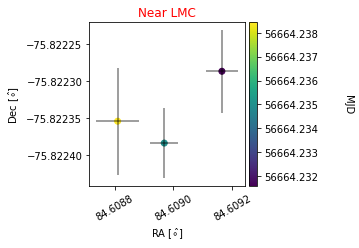

v_ra =  -8.20645656027706 , v_dec =  -1.8994789438699595


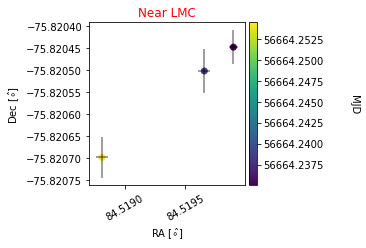

v_ra =  15.315358194790706 , v_dec =  0.6108674716398752


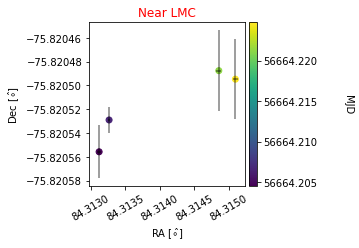

v_ra =  10.550497897879273 , v_dec =  3.504739741838064


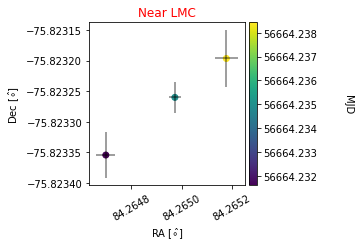

v_ra =  36.553228146771716 , v_dec =  14.367043819680584


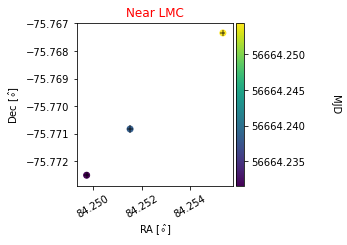

v_ra =  18.34645119900369 , v_dec =  12.045348423205581


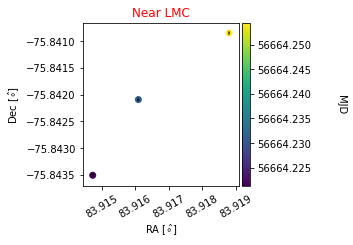

v_ra =  -3.959240900599195 , v_dec =  5.955376741432338


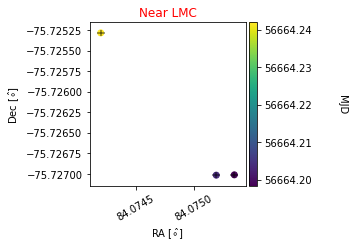

v_ra =  -79.08746306474083 , v_dec =  25.032799467853366


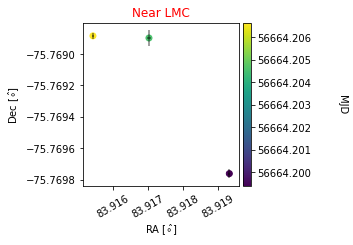

v_ra =  -11.26656892464664 , v_dec =  -0.42791923910646346


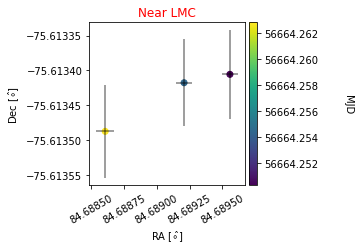

v_ra =  -6.473001393457692 , v_dec =  0.7244894741289567


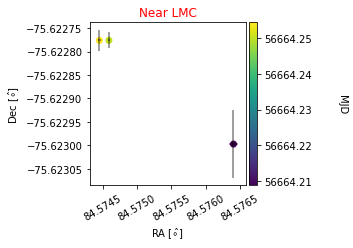

v_ra =  -20.10810827151654 , v_dec =  -32.89329182106284


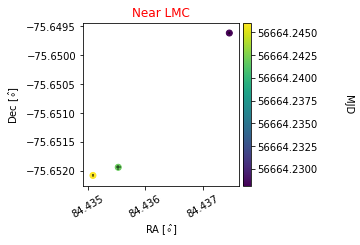

v_ra =  0.9283924858527982 , v_dec =  0.007682838674987376


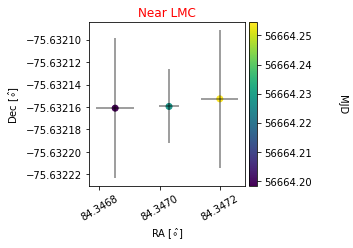

v_ra =  167.97384540565878 , v_dec =  -143.34215007355655


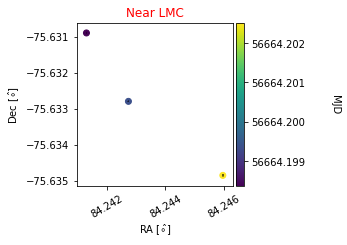

v_ra =  -7.92821962189056 , v_dec =  -0.5151083416906658


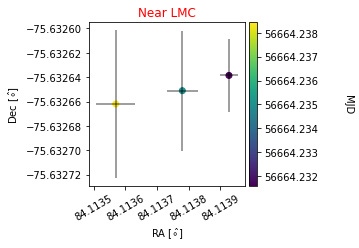

v_ra =  -7.609125058775171 , v_dec =  -2.219058785224747


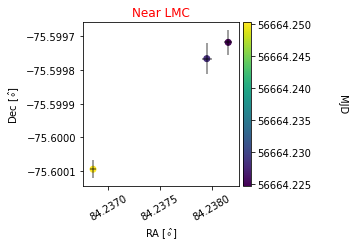

v_ra =  -7.023114623208734 , v_dec =  -12.924975059140058


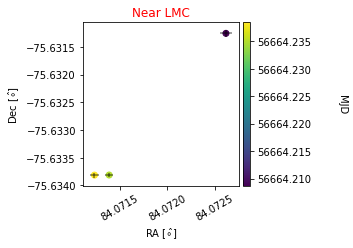

v_ra =  -89.26843491170133 , v_dec =  9.32146042181598


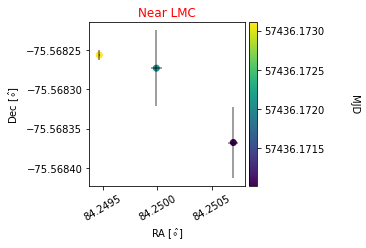

v_ra =  8.564980836558727 , v_dec =  -120.66948678985278


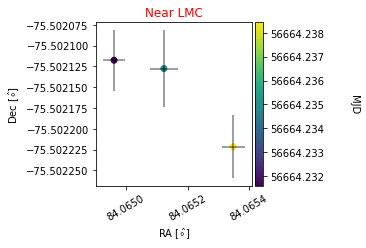

v_ra =  9.514544919800459 , v_dec =  5.354284080568025


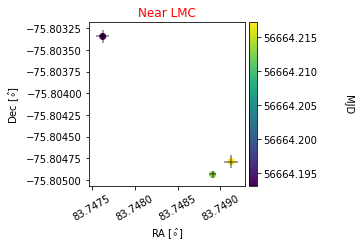

v_ra =  -5.318893722075258 , v_dec =  23.940971452182044


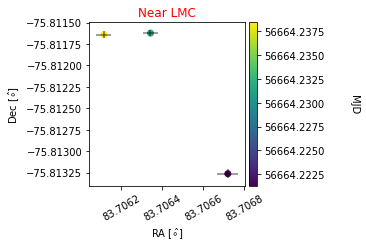

v_ra =  -86.52547772657546 , v_dec =  19.86328605117753


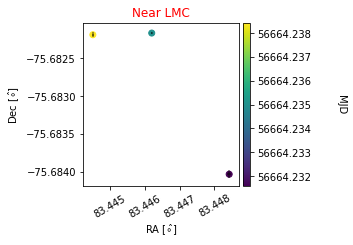

v_ra =  -3.333770558141372 , v_dec =  2.762947423749392


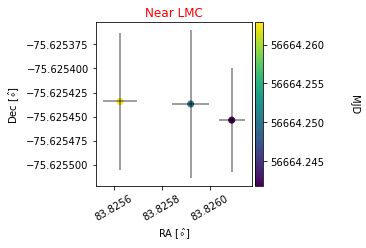

v_ra =  13.46349518859543 , v_dec =  -5.758672727253791


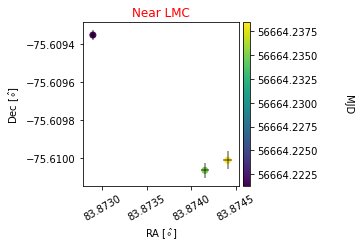

v_ra =  11.317890860673147 , v_dec =  1.9210904532850448


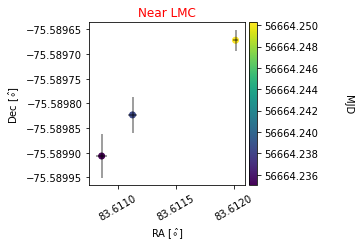

v_ra =  16.781778531440448 , v_dec =  -5.914977143330751


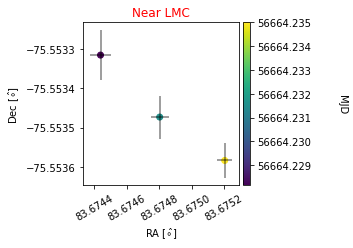

v_ra =  41.183455227464826 , v_dec =  4.3608847804544


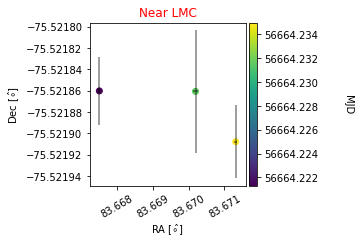

v_ra =  145.38410667087422 , v_dec =  -184.41453777720255


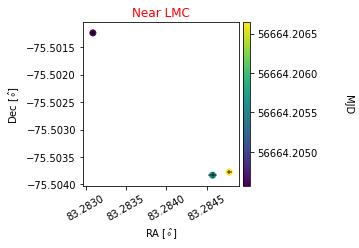

v_ra =  -6.539082469083844 , v_dec =  -1.2889134376188889


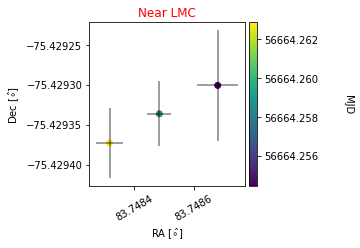

v_ra =  -27.85852328524928 , v_dec =  -2.050277551893473


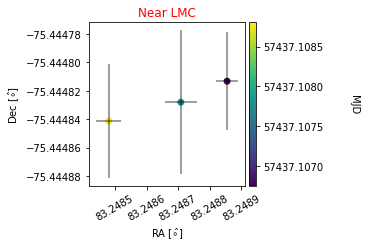

v_ra =  48.91758842914891 , v_dec =  9.868129867646248


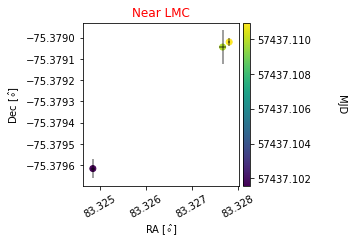

v_ra =  141.36434091370543 , v_dec =  -46.14198192869275


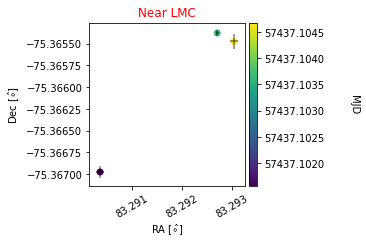

v_ra =  85.36761040201704 , v_dec =  -11.64106651698475


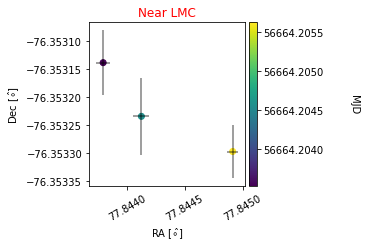

v_ra =  -73.4622246472113 , v_dec =  3.5762261499078085


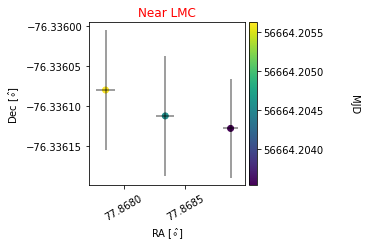

v_ra =  -38.57843945349735 , v_dec =  7.333363599508022


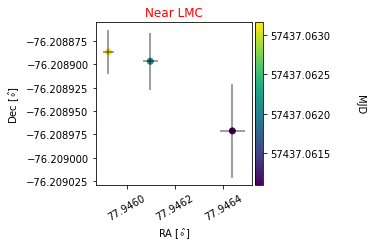

v_ra =  -47.75505278635277 , v_dec =  -2.0481051836537487


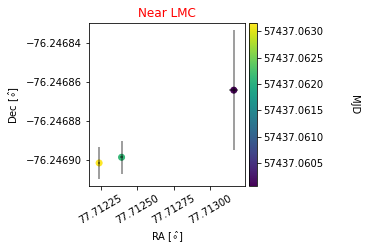

v_ra =  74.57490082714553 , v_dec =  -26.4219953634416


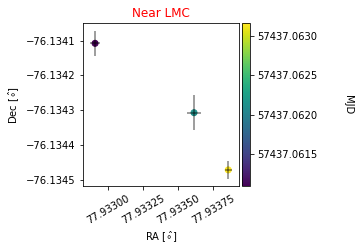

v_ra =  84.64569812881835 , v_dec =  -24.466628367594108


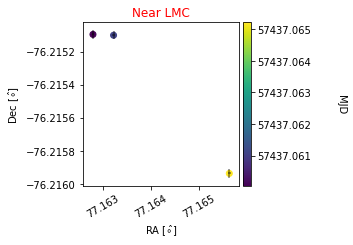

v_ra =  84.52278727499295 , v_dec =  -95.39592320299181


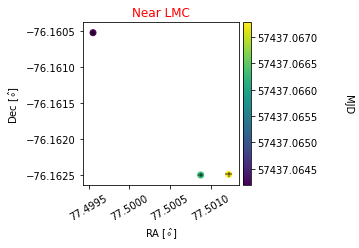

v_ra =  136.2198625891822 , v_dec =  8.288785799497457


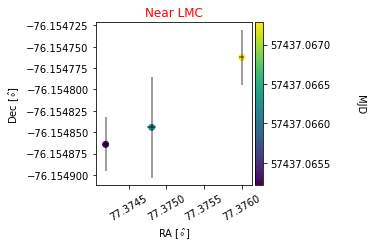

v_ra =  12.645873888021884 , v_dec =  -3.515204710363508


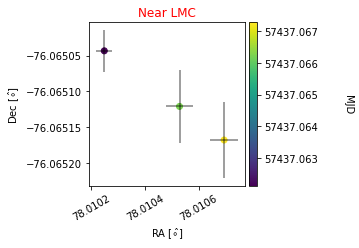

v_ra =  44.642335007063075 , v_dec =  -203.97179258583355


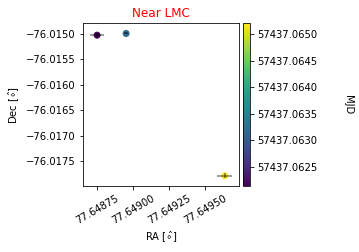

v_ra =  186.6314420700212 , v_dec =  -166.10744487704363


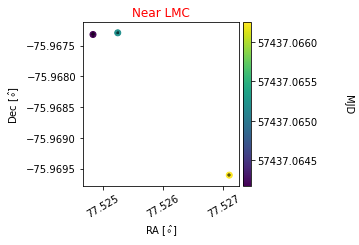

v_ra =  -24.885064494892195 , v_dec =  -8.841592050552974


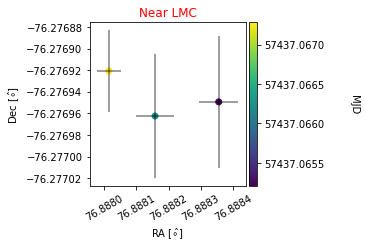

v_ra =  61.918046230521014 , v_dec =  -33.94333194470632


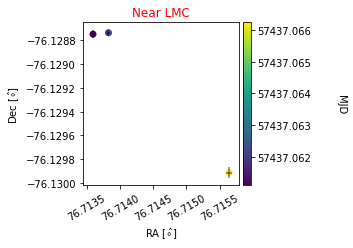

v_ra =  -85.16971250803748 , v_dec =  380.4572855285635


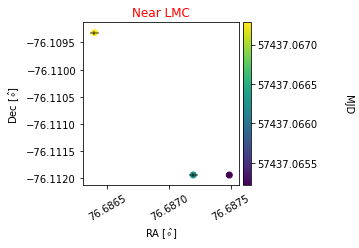

v_ra =  -82.78250697818545 , v_dec =  126.70375183438068


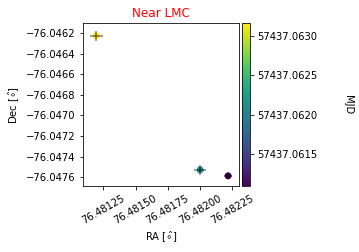

v_ra =  -75.4172670640318 , v_dec =  12.185553801552691


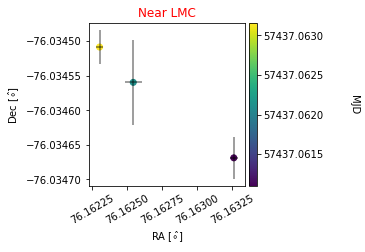

v_ra =  -92.37301140548276 , v_dec =  -32.51636247034264


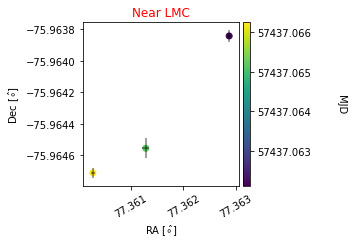

v_ra =  -21.83141533014789 , v_dec =  5.3394418262714565


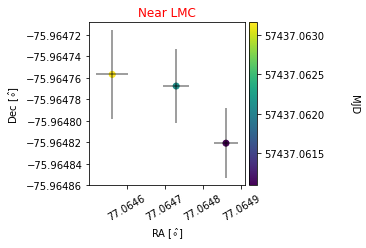

v_ra =  -33.00258760024091 , v_dec =  -6.082636918295659


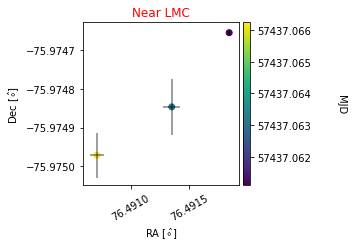

v_ra =  83.16877305379748 , v_dec =  -7.59584034753837


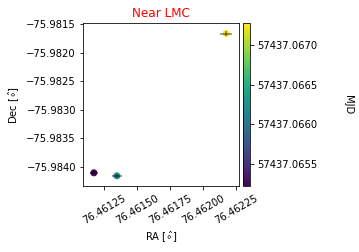

v_ra =  -163.56829795042395 , v_dec =  -1.8195982374445394


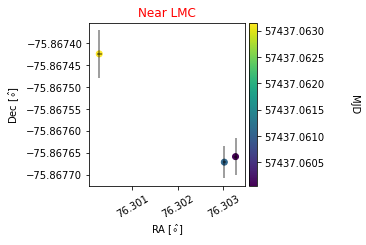

v_ra =  -14.821491994062464 , v_dec =  -2.178000074413671


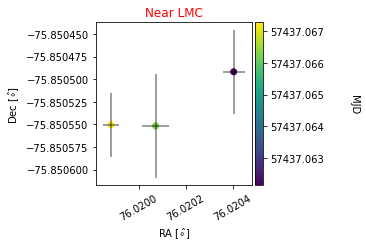

v_ra =  -36.59463504162385 , v_dec =  7.503943892777364


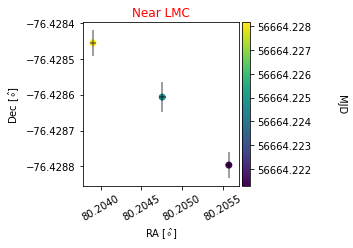

v_ra =  9.18754057358415 , v_dec =  14.033459473680239


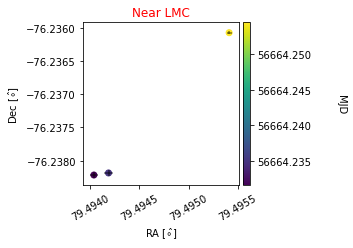

v_ra =  -14.807189895545394 , v_dec =  -0.2333590717753106


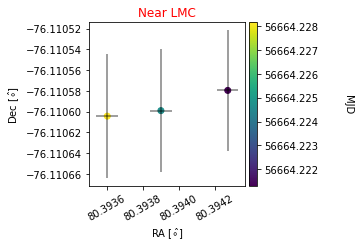

v_ra =  14.50725972041095 , v_dec =  -18.416203286905592


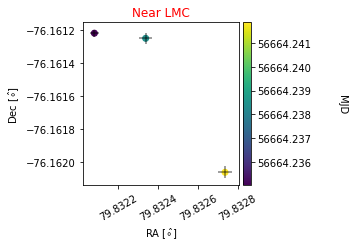

v_ra =  6.866465347311614 , v_dec =  0.07187060300921914


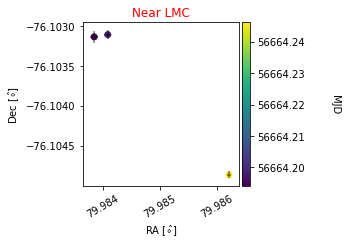

v_ra =  -48.005805868363105 , v_dec =  -5.974143266634992


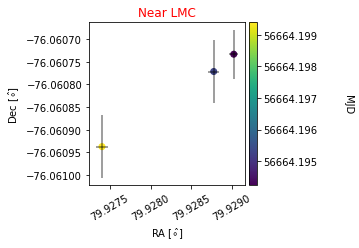

v_ra =  -28.553942958520196 , v_dec =  9.647386479073509


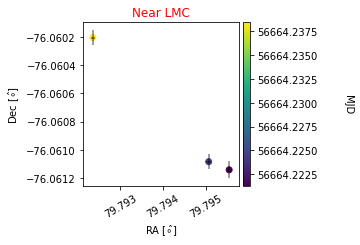

v_ra =  6.324877647940138 , v_dec =  -29.170345848422556


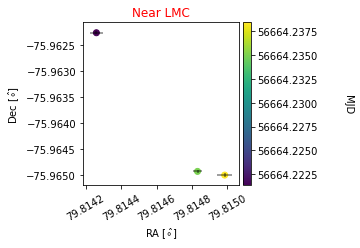

v_ra =  140.3392384803178 , v_dec =  114.89087646502246


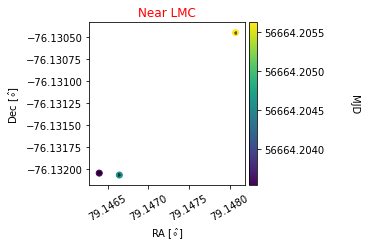

v_ra =  25.002866640147516 , v_dec =  -71.12761326462667


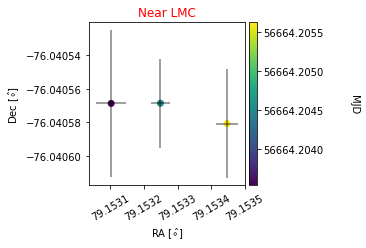

v_ra =  15.28568742107745 , v_dec =  -0.5759342921745425


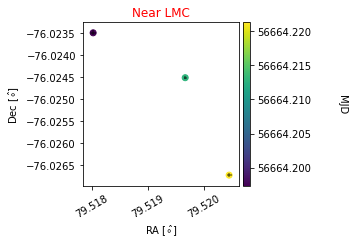

v_ra =  116.85895011320197 , v_dec =  -1.3938824786366053


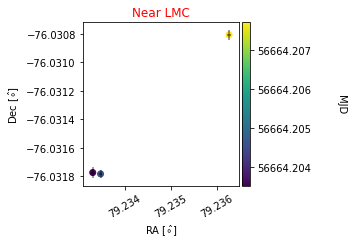

v_ra =  -74.30132347523278 , v_dec =  -168.83537698738473


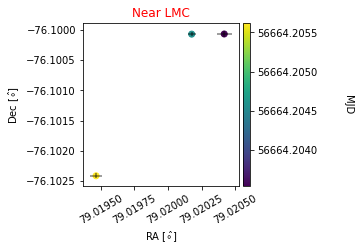

v_ra =  42.16856981533859 , v_dec =  32.68624964184114


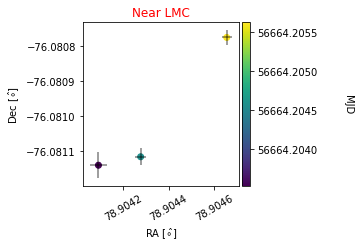

v_ra =  115.17675522965608 , v_dec =  12.62799818990843


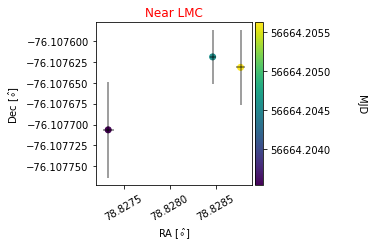

v_ra =  201.8485503404322 , v_dec =  -84.20875506898064


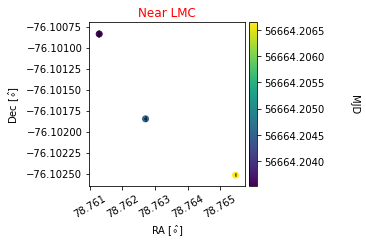

v_ra =  33.029344694368696 , v_dec =  -7.8207509803857205


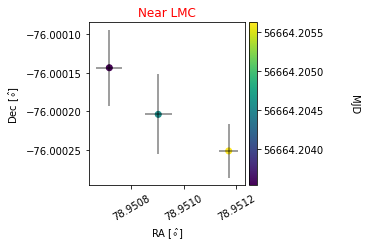

v_ra =  37.11883416858574 , v_dec =  -4.069402570027023


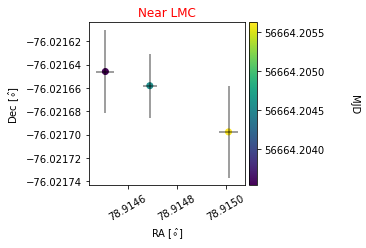

v_ra =  -47.64511965395667 , v_dec =  -191.69501233048763


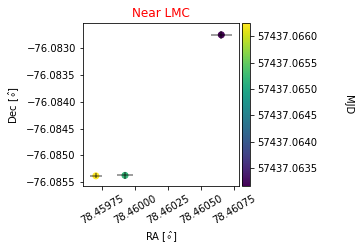

v_ra =  38.529540410426996 , v_dec =  -5.582156056340325


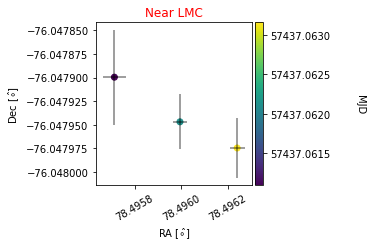

v_ra =  -25.71509699791318 , v_dec =  170.34632187409034


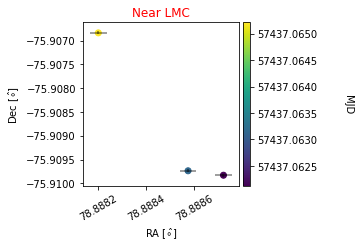

v_ra =  51.31439900503445 , v_dec =  -17.969832158578914


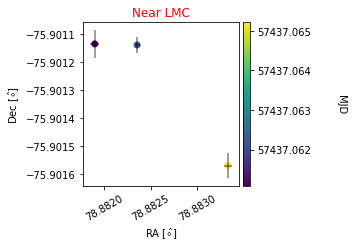

v_ra =  61.733841125228 , v_dec =  -116.5748982342791


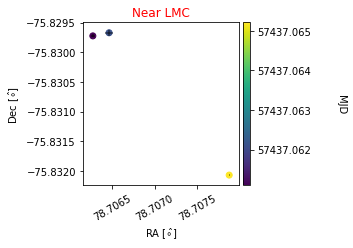

v_ra =  50.90280776117364 , v_dec =  -35.473005064068985


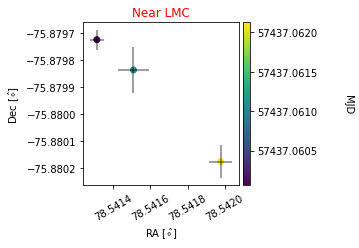

v_ra =  -97.99479996945162 , v_dec =  95.04152289847475


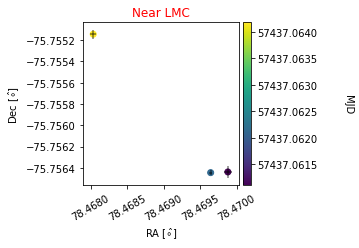

v_ra =  81.48369845052895 , v_dec =  44.6456596348807


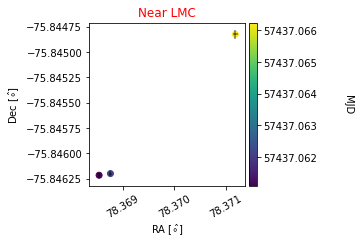

v_ra =  51.777918416358695 , v_dec =  -37.06330781517425


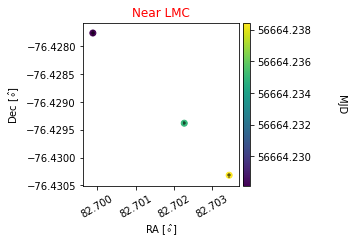

v_ra =  16.993496063873724 , v_dec =  -60.56835193683281


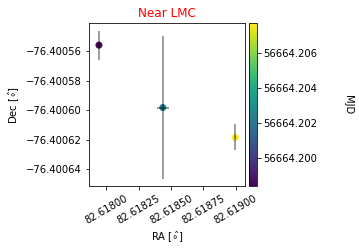

v_ra =  -104.77250003270082 , v_dec =  8.92978405019445


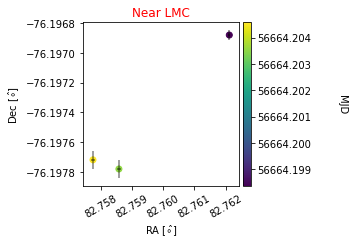

v_ra =  14.401985091006885 , v_dec =  -3.8927397354976816


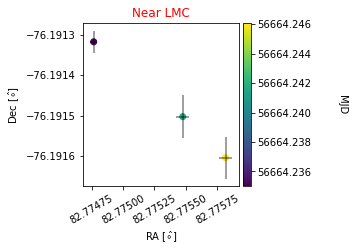

v_ra =  -30.17986778535982 , v_dec =  11.487623445419542


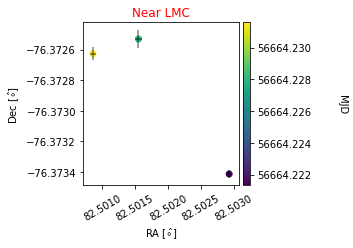

v_ra =  -6.5925571748938125 , v_dec =  -0.6255657741190486


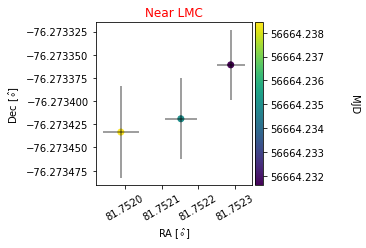

v_ra =  67.33983269084814 , v_dec =  -1.179279870050079


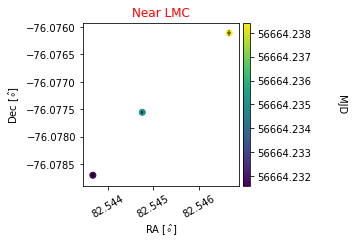

v_ra =  -4.990412251375801 , v_dec =  0.9037798037869793


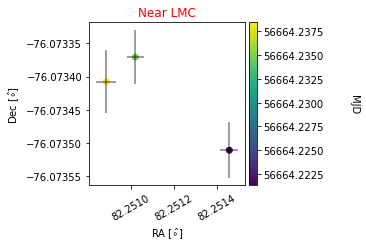

v_ra =  7.97802377475989 , v_dec =  1.9553129312839497


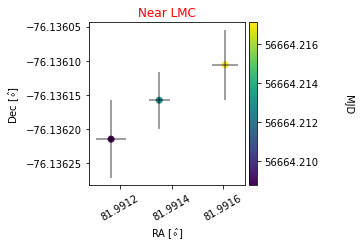

v_ra =  -8.858258152759026 , v_dec =  0.2501869501990549


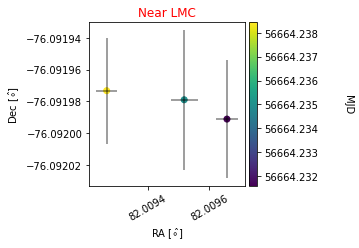

v_ra =  -17.40725590850065 , v_dec =  -0.740804122044901


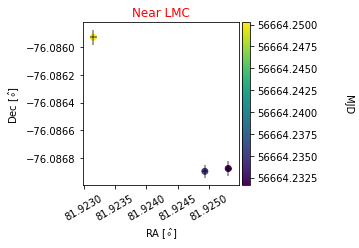

v_ra =  -64.23619449590932 , v_dec =  11.321078522100796


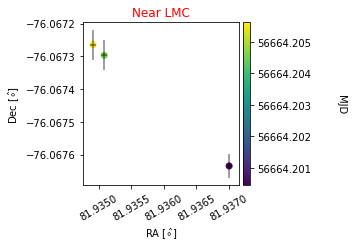

v_ra =  -145.24601798199475 , v_dec =  -3.5139437408610554


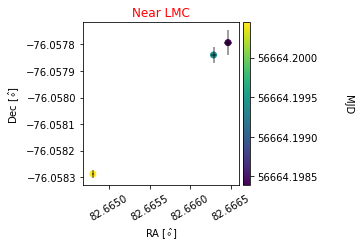

v_ra =  -3.142475087314933 , v_dec =  91.08173023207468


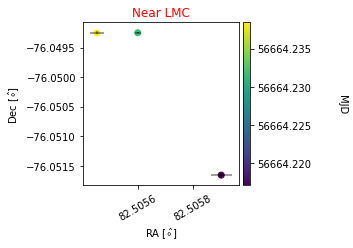

v_ra =  9.876417213930045 , v_dec =  -3.5048359831689457


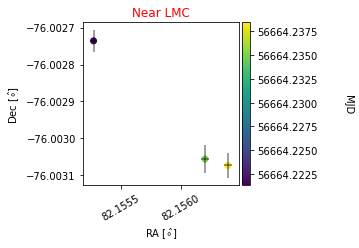

v_ra =  -12.794786621916193 , v_dec =  51.74562585590011


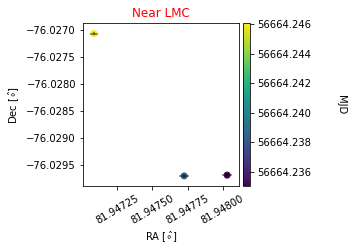

v_ra =  -77.24591181728603 , v_dec =  92.18473004515619


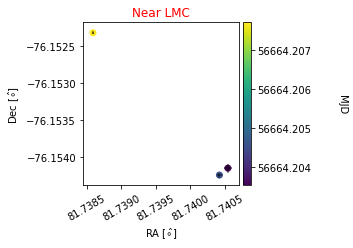

v_ra =  -10.039748392585524 , v_dec =  0.49147526946332126


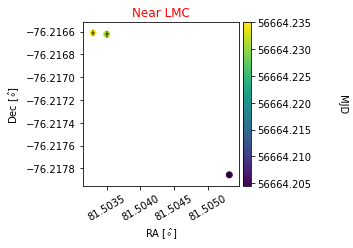

v_ra =  4.537710247237144 , v_dec =  -1.1878952882996068


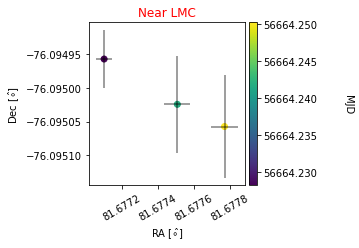

v_ra =  5.759897264204182 , v_dec =  -1.3473227910211392


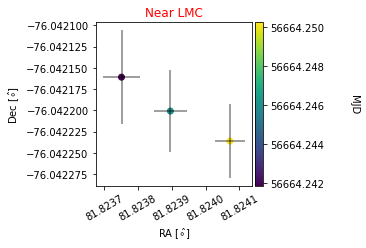

v_ra =  1.9301537289107067 , v_dec =  -70.76342664498685


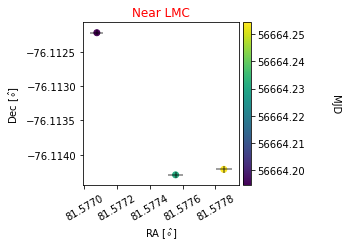

v_ra =  6.424577151067467 , v_dec =  26.92727569063567


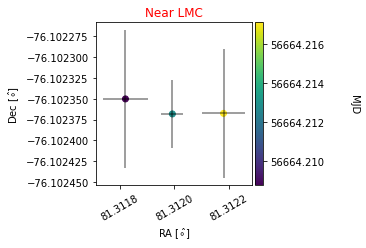

v_ra =  -30.438695559678248 , v_dec =  -0.9258506809589622


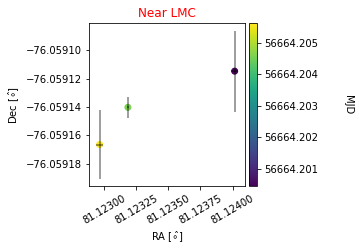

v_ra =  6.561878976350285 , v_dec =  0.020586974742234865


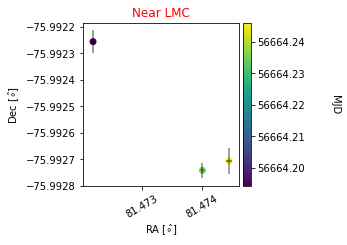

v_ra =  -11.004666891760577 , v_dec =  -0.9871477276172564


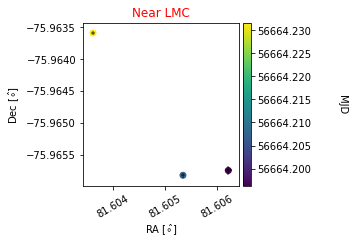

v_ra =  11.445374289117135 , v_dec =  0.885672753748674


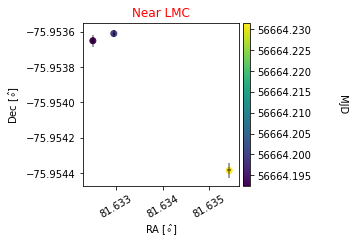

v_ra =  23.629506235486662 , v_dec =  -14.9980874727642


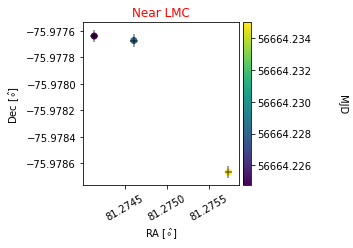

v_ra =  -8.161637519532249 , v_dec =  -9.838635298124144


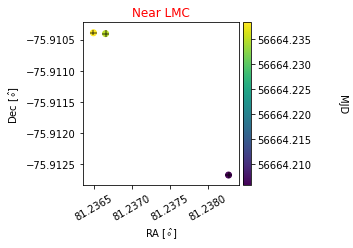

v_ra =  46.50071546894332 , v_dec =  -2.639424953984964


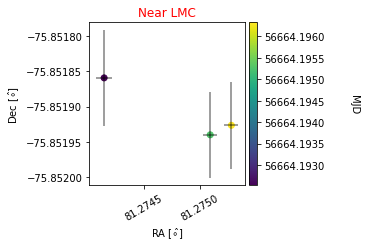

v_ra =  4.5351361959254435 , v_dec =  -4.417263799859912


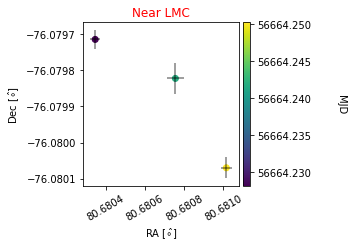

v_ra =  -4.478820110520298 , v_dec =  -0.4359271071440414


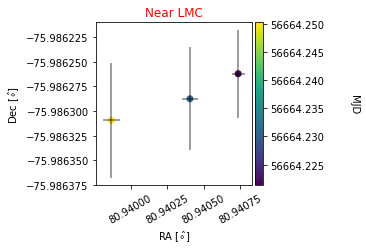

v_ra =  7.906008274694404 , v_dec =  2.5000645232634073


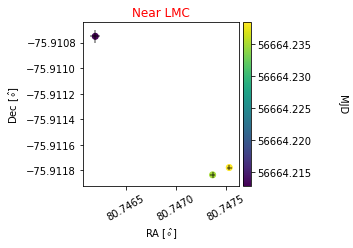

v_ra =  22.092661694607617 , v_dec =  -3.5855423476637855


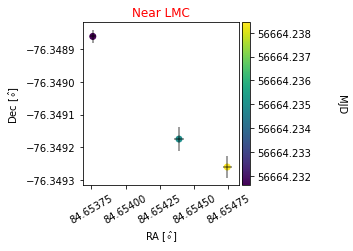

v_ra =  -7.557315350396634 , v_dec =  -0.7362961105882064


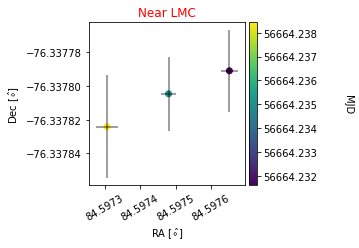

v_ra =  -7.825408680113585 , v_dec =  0.3923181520109163


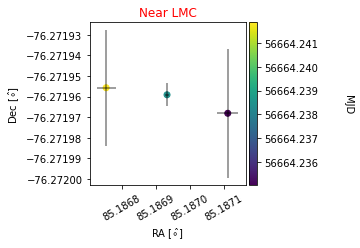

v_ra =  -71.76320890170562 , v_dec =  -47.56307747223036


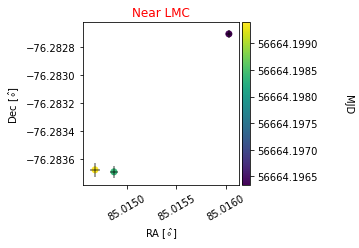

v_ra =  248.15157000942574 , v_dec =  1.0144664593819737


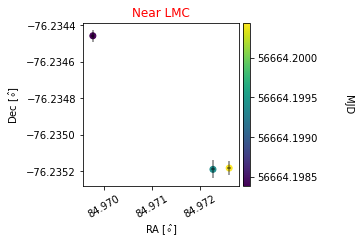

v_ra =  75.01902331726892 , v_dec =  -26.35502493343239


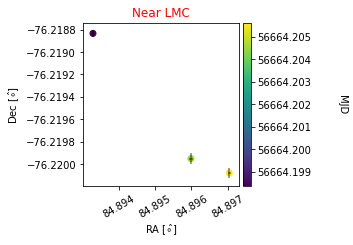

v_ra =  12.475706917322219 , v_dec =  -1.6895880388581077


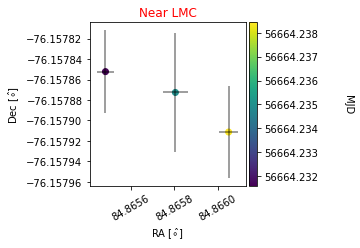

v_ra =  -16.063201358918274 , v_dec =  8.794734610966534


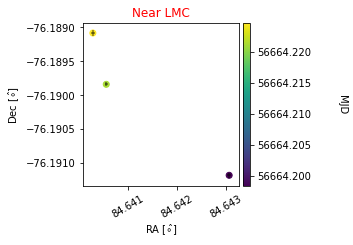

v_ra =  -15.402378599567614 , v_dec =  -0.5881661121431002


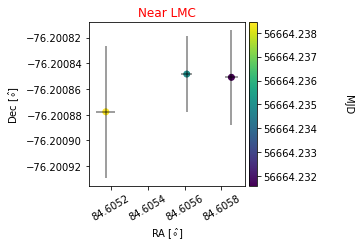

v_ra =  2.6576869251775173 , v_dec =  6.305818690395213


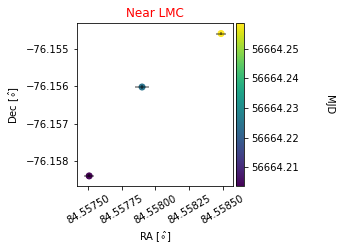

v_ra =  -5.330655279979581 , v_dec =  -1.5030936438207885


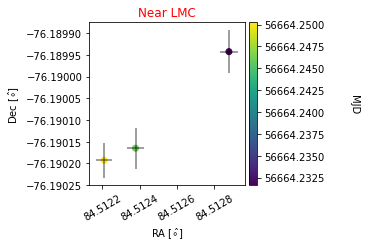

v_ra =  -10.843226416808898 , v_dec =  12.365698559682658


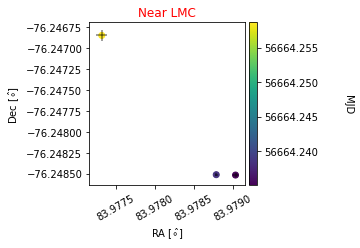

v_ra =  -2.8114298012230843 , v_dec =  14.956867948568279


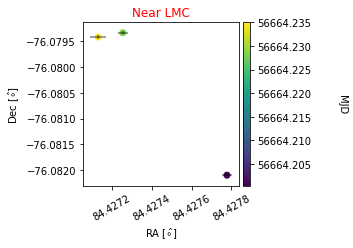

v_ra =  9.894954639564183 , v_dec =  -0.9922873074806818


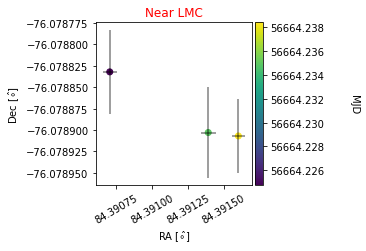

v_ra =  95.4319033196511 , v_dec =  77.98942569595843


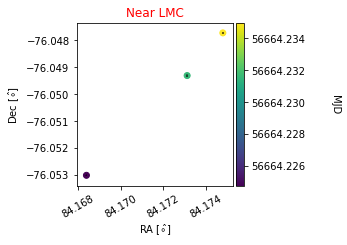

v_ra =  -60.88780337007648 , v_dec =  -5.16725666435141


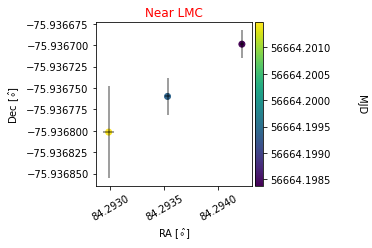

v_ra =  12.028646362068239 , v_dec =  -3.7259813894947307


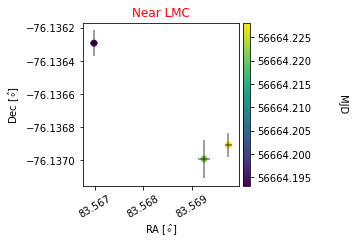

v_ra =  -16.37160865513484 , v_dec =  1.0914500809275884


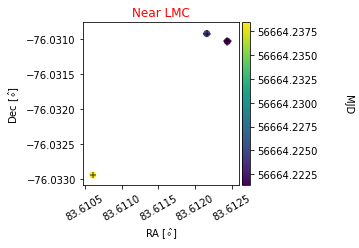

v_ra =  7.157394189514997 , v_dec =  -5.202995985788338


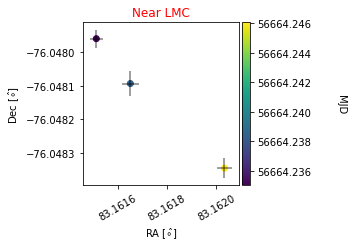

v_ra =  57.61383077328202 , v_dec =  6.54085698251707


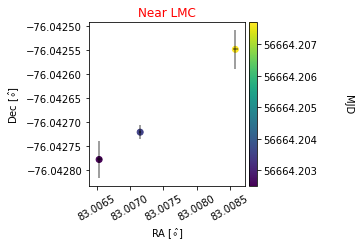

v_ra =  -35.62051533245357 , v_dec =  42.0793908062061


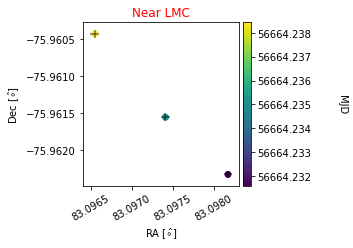

v_ra =  -38.4678031971439 , v_dec =  -16.402692568807844


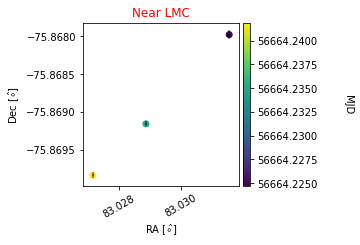

v_ra =  -26.826062103191955 , v_dec =  -163.6485356160754


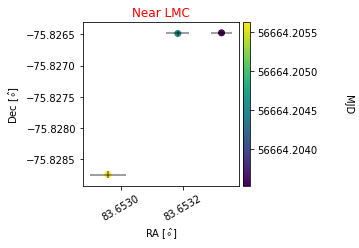

v_ra =  39.74216914464862 , v_dec =  97.18283336938048


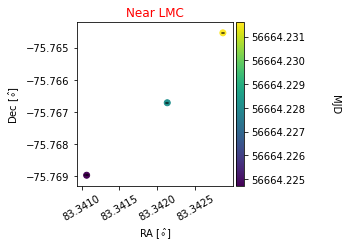

v_ra =  -7.383731140760243 , v_dec =  -2.494383604540364


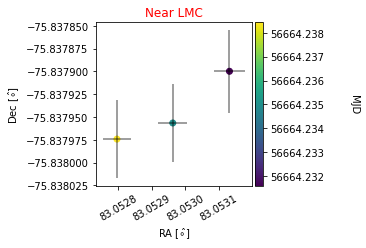

v_ra =  21.06694708258919 , v_dec =  3.266100849275188


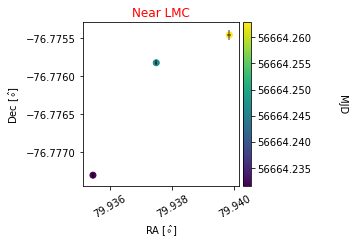

v_ra =  42.330267161313934 , v_dec =  -45.11834349049451


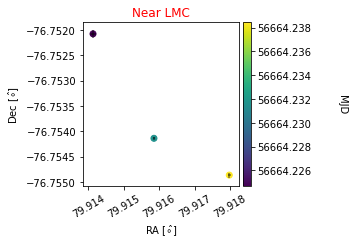

v_ra =  8.665882761662713 , v_dec =  -1.211685722694135


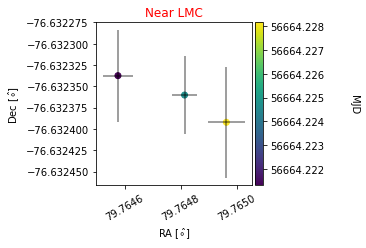

v_ra =  -27.28427702766582 , v_dec =  5.586946297630821


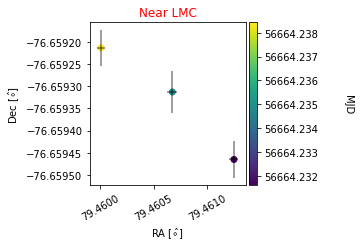

v_ra =  -5.308875910487599 , v_dec =  -0.5222123669993376


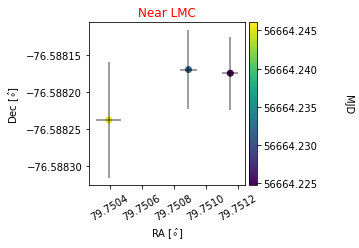

v_ra =  -13.112674534880986 , v_dec =  1.0463090910266457


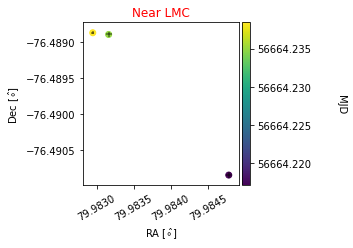

v_ra =  -12.125124524763857 , v_dec =  -26.391650557808408


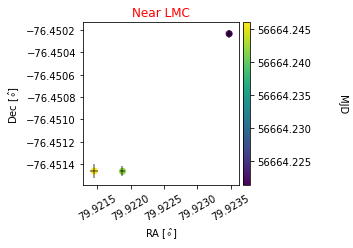

v_ra =  10.054490635069497 , v_dec =  0.5796706604031978


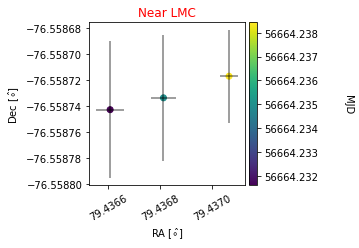

v_ra =  -16.963462157130056 , v_dec =  -6.070414744775885


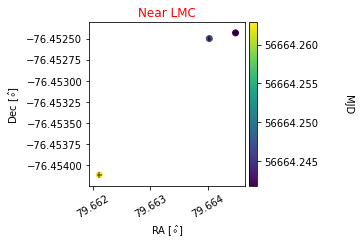

v_ra =  -51.95499830278962 , v_dec =  9.462363300077717


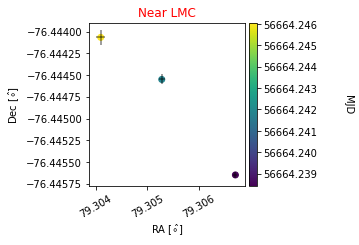

v_ra =  -14.563773769967172 , v_dec =  1.7682165829628562


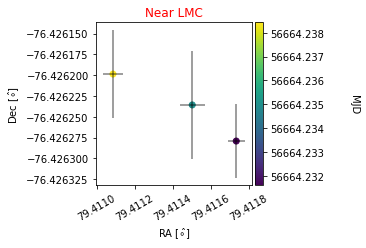

v_ra =  25.36270031975811 , v_dec =  11.440299296725195


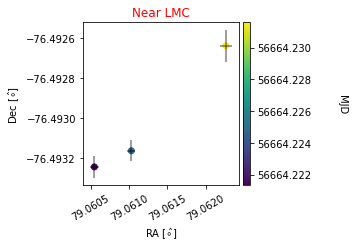

v_ra =  -7.588131496655083 , v_dec =  -0.39010157289426145


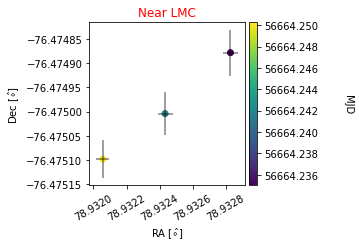

v_ra =  8.76544896849306 , v_dec =  -9.300266226407844


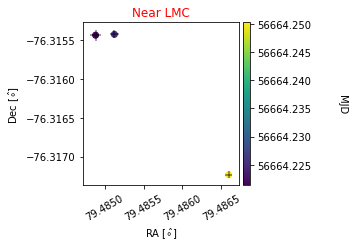

v_ra =  40.12838580639438 , v_dec =  28.546610170693555


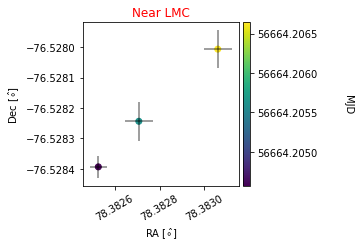

v_ra =  -7.550600451519951 , v_dec =  -3.3805257308350374


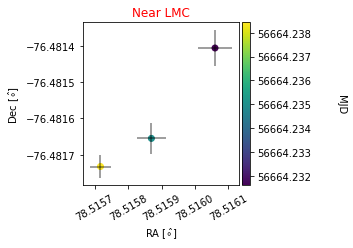

v_ra =  -25.239625916845167 , v_dec =  81.78082189241748


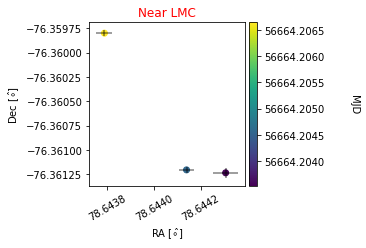

v_ra =  -7.456962405496504 , v_dec =  -1.664527019726967


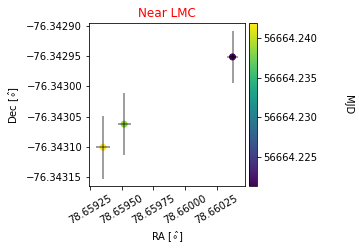

v_ra =  6.543307507946502 , v_dec =  0.30101466551230777


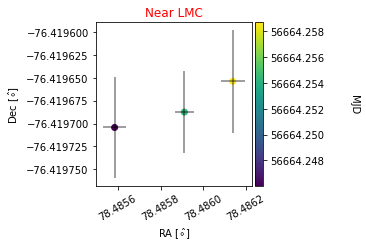

v_ra =  141.81007151323132 , v_dec =  -1.2896561820872108


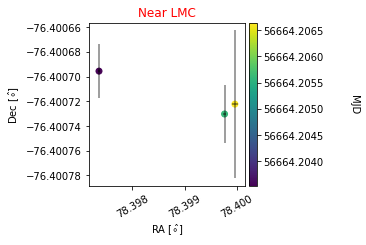

v_ra =  -127.69408112586537 , v_dec =  -272.9500118261831


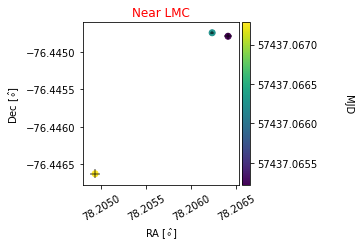

v_ra =  14.002234630823212 , v_dec =  0.30186368572775096


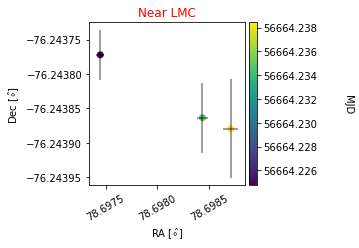

v_ra =  -9.977059439874067 , v_dec =  7.645376373278547


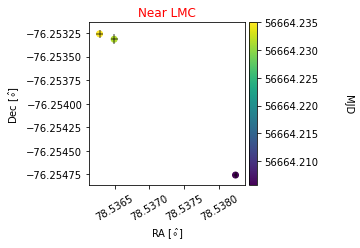

v_ra =  -147.53790402314095 , v_dec =  93.36649725680468


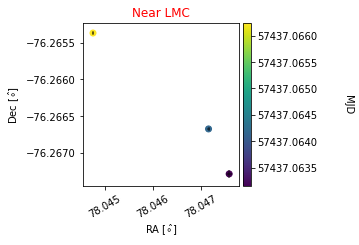

v_ra =  -6.689084427005063 , v_dec =  -42.14367575314902


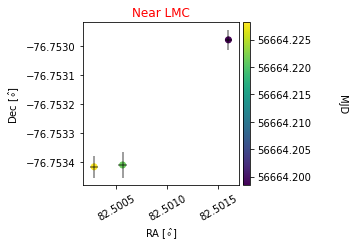

v_ra =  -15.867675477200116 , v_dec =  15.68616647542025


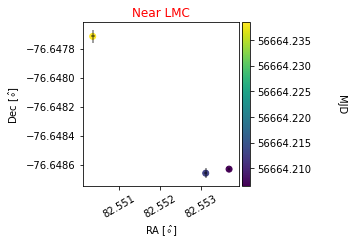

v_ra =  -10.714613708737623 , v_dec =  -2.8242017866216007


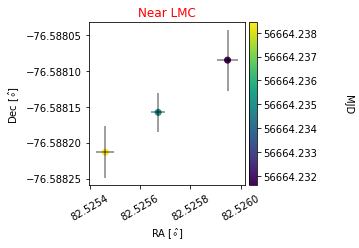

v_ra =  -72.24643740777084 , v_dec =  -14.107369128471122


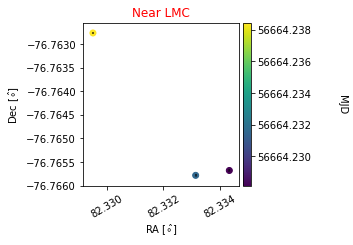

v_ra =  19.461848743202594 , v_dec =  89.02421123285332


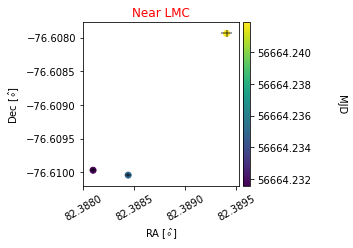

v_ra =  -18.828987761036792 , v_dec =  39.35959569929007


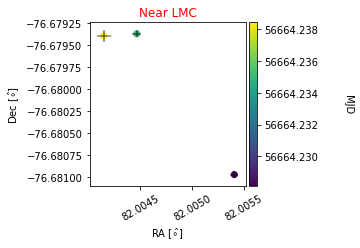

v_ra =  -6.743982698875964 , v_dec =  -0.5904295973541364


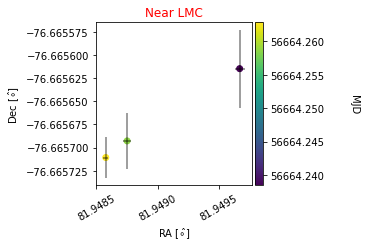

v_ra =  -52.61436195943359 , v_dec =  8.692454512831098


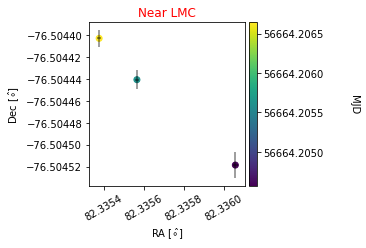

v_ra =  50.52224688004558 , v_dec =  22.329785163912533


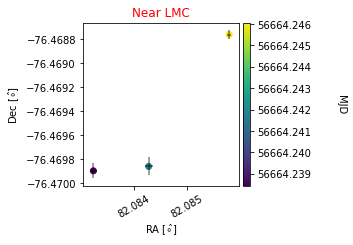

v_ra =  -12.919716067646211 , v_dec =  -11.59445135017742


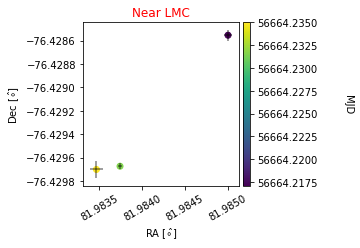

v_ra =  2.540953283666646 , v_dec =  -6.104756647767263


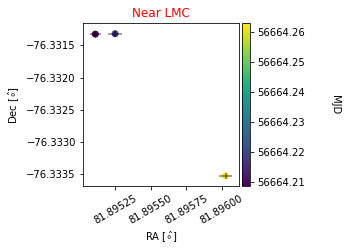

v_ra =  -11.064863290637811 , v_dec =  8.739081163925256


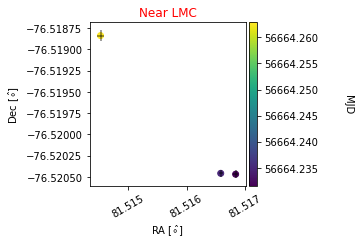

v_ra =  3.732071118021031 , v_dec =  0.23621538428623032


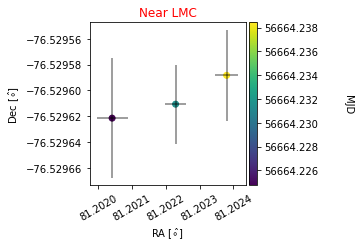

v_ra =  -27.823500742375828 , v_dec =  -0.43083455482388583


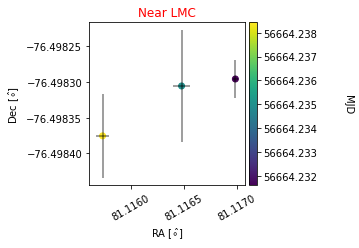

v_ra =  -6.308042466236913 , v_dec =  -0.8441997637502326


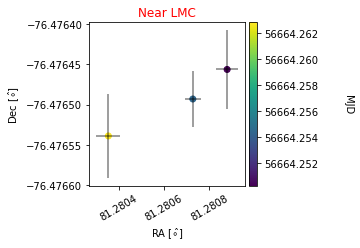

v_ra =  -13.476293198347856 , v_dec =  -16.54818389246857


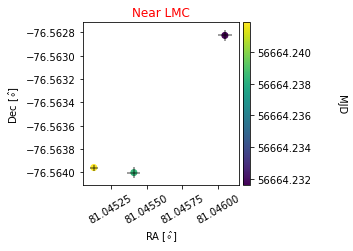

v_ra =  8.67238595208915 , v_dec =  -0.39079008065861337


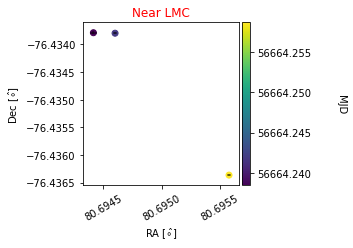

v_ra =  8.348775877513336 , v_dec =  0.5763425851689696


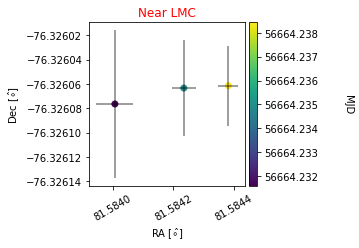

v_ra =  27.64274836962014 , v_dec =  2.1272055835785966


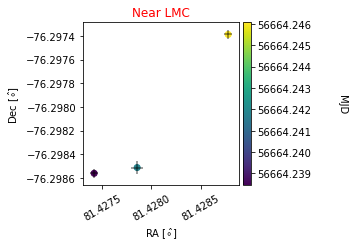

v_ra =  -22.678411647072434 , v_dec =  -2.8416996188158845


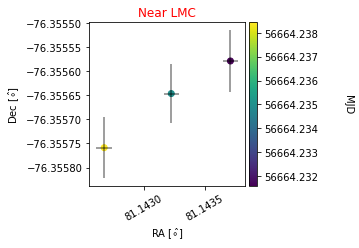

v_ra =  82.6762889664624 , v_dec =  96.13830916571766


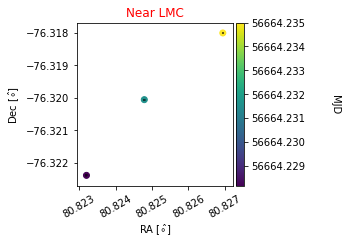

v_ra =  -23.333682281710782 , v_dec =  2.9622393698399763


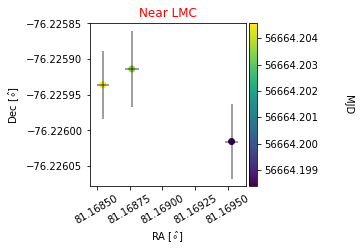

v_ra =  -7.300606042396563 , v_dec =  12.754976137929999


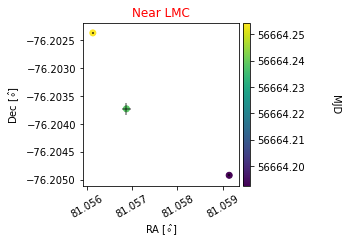

v_ra =  -63.02767469819776 , v_dec =  85.76584933414864


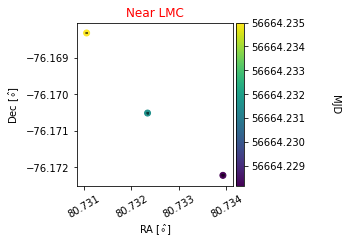

v_ra =  12.675866075300576 , v_dec =  17.688143097581662


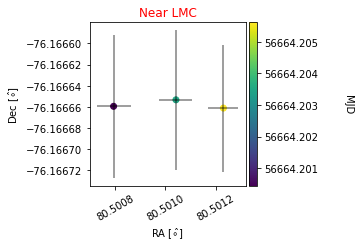

v_ra =  -15.996320338409612 , v_dec =  -19.559995990620997


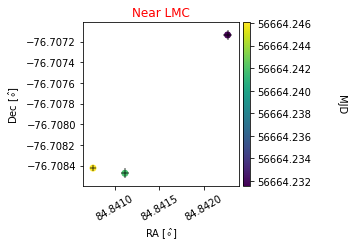

v_ra =  -1.8915582603732908 , v_dec =  -1.5634150207066673


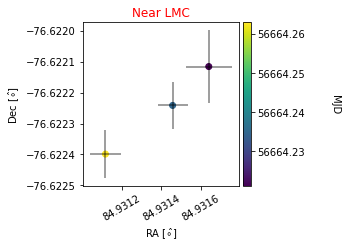

v_ra =  7.8558301604243 , v_dec =  -10.5895784469823


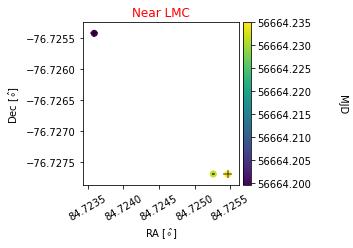

v_ra =  -6.8299500896127965 , v_dec =  -13.333526331321258


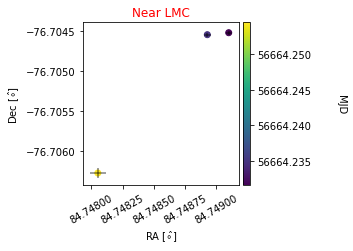

v_ra =  -6.6004206625640895 , v_dec =  -1.1760763165117696


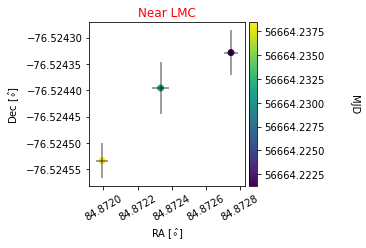

v_ra =  -3.367176688379363 , v_dec =  -0.2918779223053459


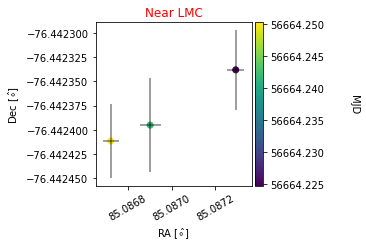

v_ra =  76.81384399097838 , v_dec =  188.14281770133906


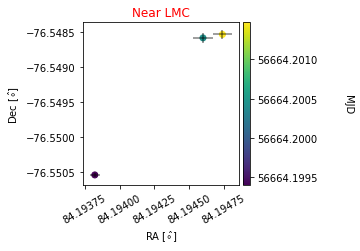

v_ra =  14.208119572576093 , v_dec =  5.336553389837721


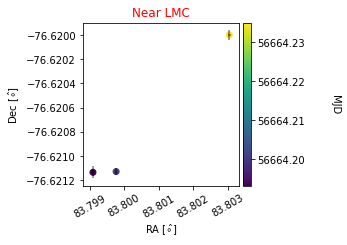

v_ra =  17.489998421171304 , v_dec =  92.04063916853313


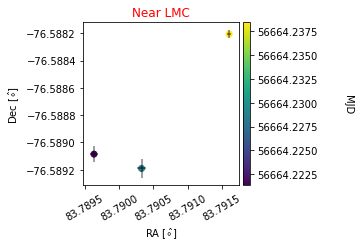

v_ra =  -7.49366244770312 , v_dec =  -4.427709675554131


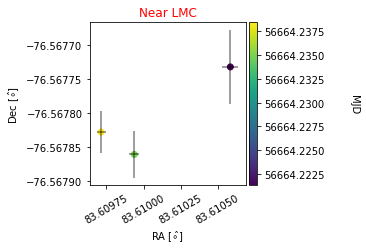

v_ra =  -15.991547805742279 , v_dec =  -1.309680460413517


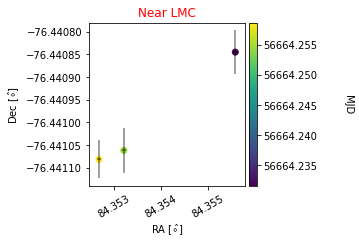

v_ra =  -71.54296837580655 , v_dec =  13.937944939019255


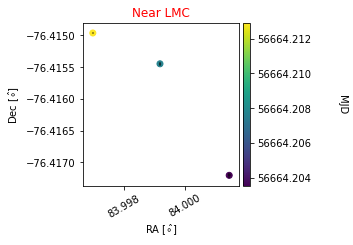

v_ra =  -36.10283933616888 , v_dec =  -13.91658968190834


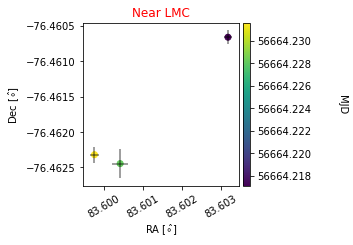

v_ra =  7.681020979302674 , v_dec =  -3.1455130605237738


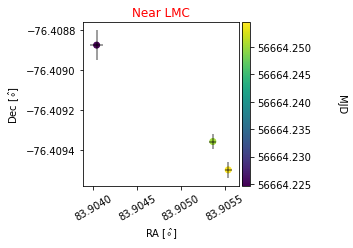

v_ra =  7.8738018945924635 , v_dec =  -0.18626771215943164


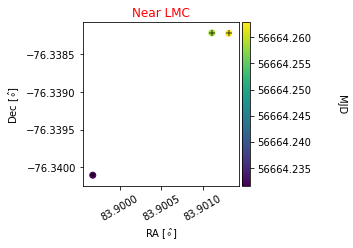

v_ra =  -14.32018401405584 , v_dec =  -1.700953724396105


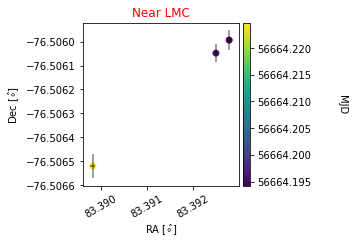

v_ra =  -13.785918529384764 , v_dec =  -1.121333556260104


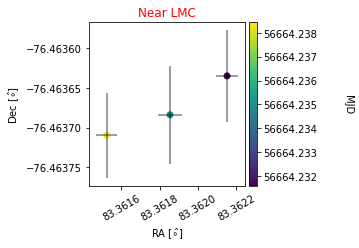

v_ra =  -24.70818527726725 , v_dec =  -2.5839775523661053


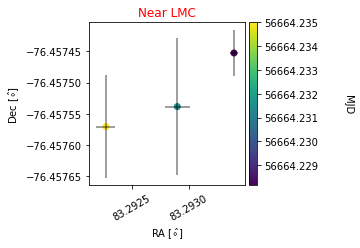

v_ra =  89.09093814234109 , v_dec =  66.08677623886742


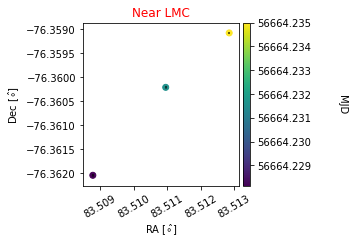

v_ra =  -26.671194301217366 , v_dec =  48.846175353672685


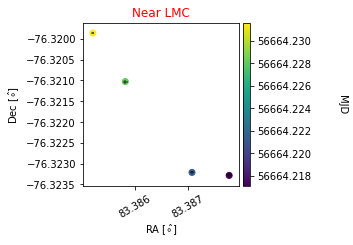

v_ra =  156.27145224525773 , v_dec =  170.98725198318073


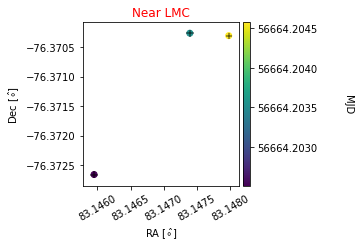

v_ra =  13.73496302400749 , v_dec =  -15.360356037846955


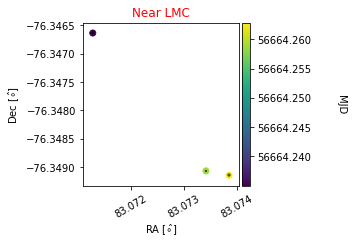

v_ra =  25.25765397907995 , v_dec =  6.708745640337529


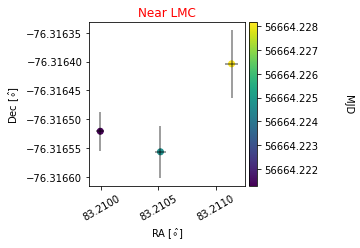

v_ra =  31.012771637179366 , v_dec =  3.039689556543605


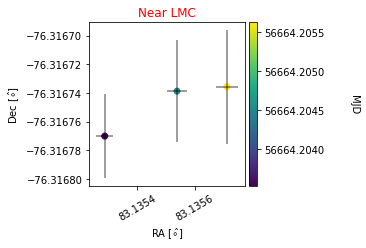

v_ra =  -14.66903262760581 , v_dec =  -11.499373416336217


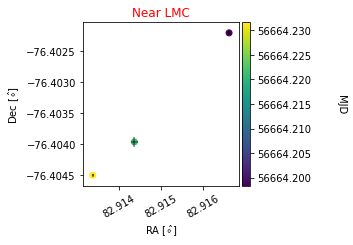

v_ra =  33.15482053018152 , v_dec =  -20.230706400711362


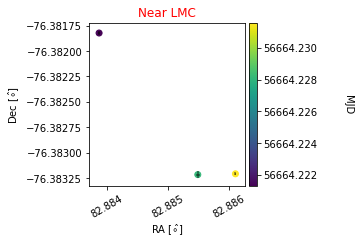

v_ra =  -27.868698333032366 , v_dec =  -4.610234708426371


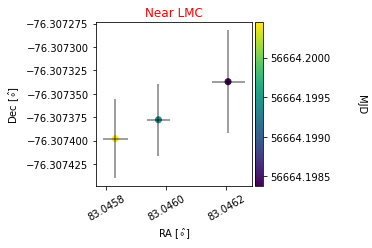

v_ra =  -42.35948239927496 , v_dec =  -0.21753774970872033


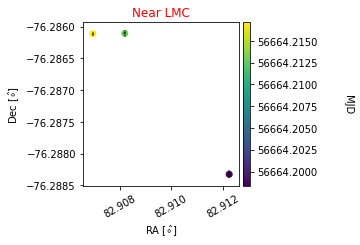

v_ra =  -60.06705371956888 , v_dec =  -10.508995776378622


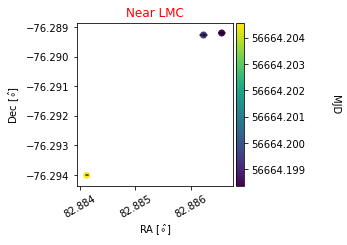

v_ra =  17.74220051030824 , v_dec =  5.526571490559653


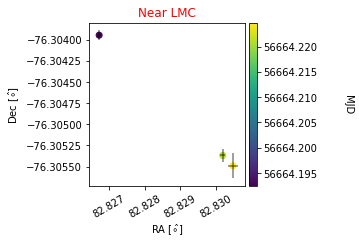

v_ra =  17.411902328371877 , v_dec =  -5.728436047617645


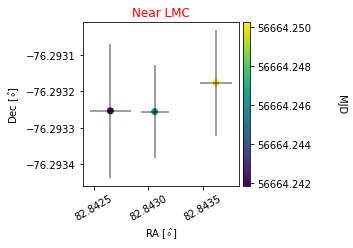

v_ra =  176.00589026331878 , v_dec =  52.05858262280424


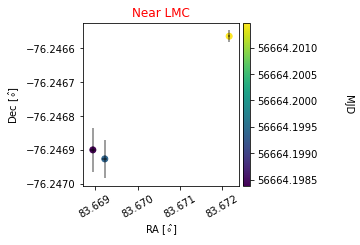

v_ra =  -13.743258162478226 , v_dec =  23.22284844958566


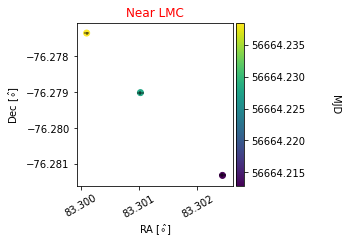

v_ra =  9.835111674216162 , v_dec =  -12.183377020975241


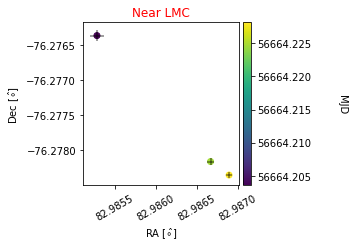

v_ra =  58.73880279879478 , v_dec =  3.758841598160777


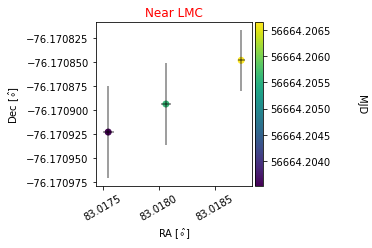

v_ra =  -62.07019862757542 , v_dec =  66.80965922311708


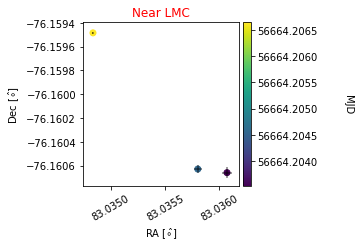

v_ra =  -7.189634359265438 , v_dec =  -0.3100064807486847


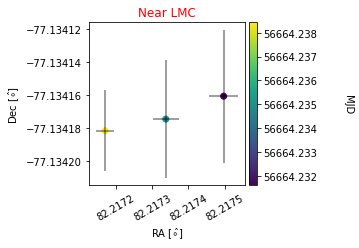

v_ra =  90.9307218334522 , v_dec =  -40.39933378496637


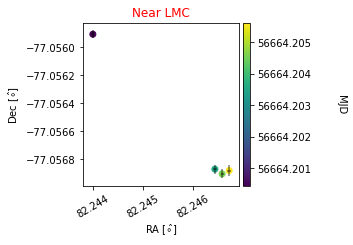

v_ra =  -8.081198707558025 , v_dec =  3.8490816825009837


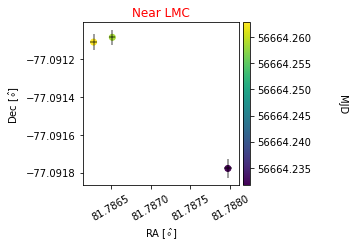

v_ra =  -10.133297644012183 , v_dec =  -2.023104752160108


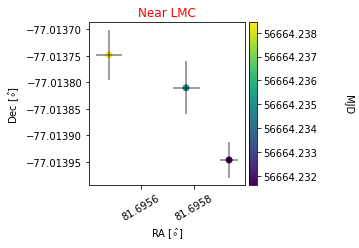

v_ra =  17.572474711813232 , v_dec =  -6.023939323335289


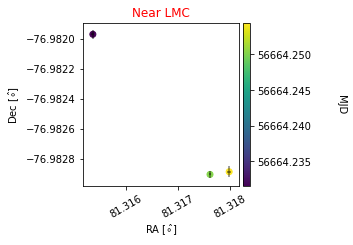

v_ra =  -6.693737471510052 , v_dec =  0.6397360691042225


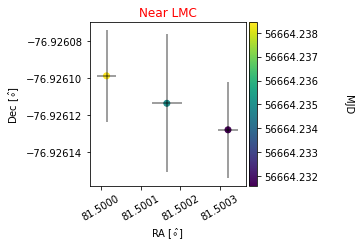

v_ra =  -6.000166695798884 , v_dec =  17.54690448159657


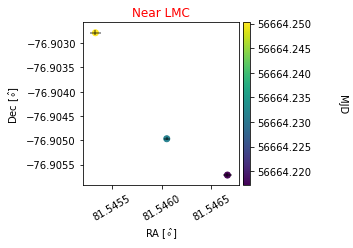

v_ra =  6.862500307611918 , v_dec =  -1.116505679526314


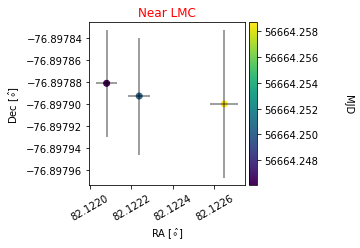

v_ra =  10.681579976439023 , v_dec =  -10.229020459304301


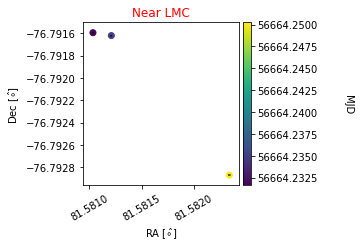

v_ra =  13.470869026209032 , v_dec =  -8.82979319390167


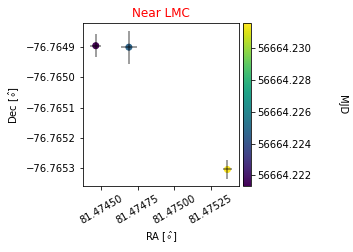

v_ra =  30.647206848679854 , v_dec =  -1.149410687292194


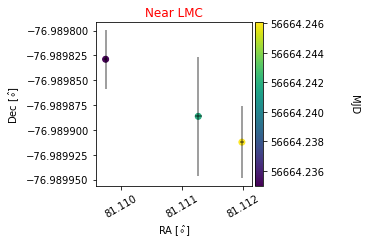

v_ra =  -10.253102534010313 , v_dec =  -0.9591538211482203


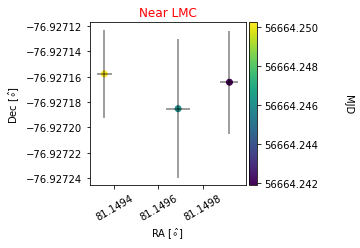

v_ra =  -54.97365454307339 , v_dec =  -15.520067876659425


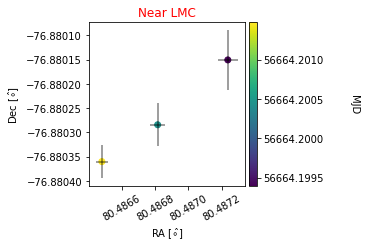

v_ra =  -7.946317791438901 , v_dec =  -1.0895723771172376


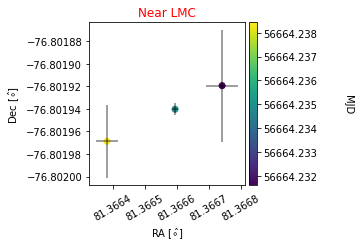

v_ra =  6.025317627115569 , v_dec =  -0.06929067471339427


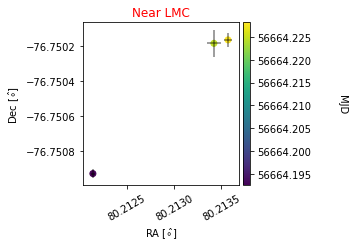

v_ra =  31.696478164519377 , v_dec =  1.7140329635284866


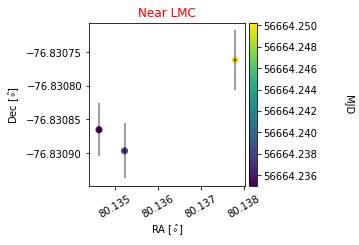

v_ra =  36.54760385733811 , v_dec =  0.2382233910588436


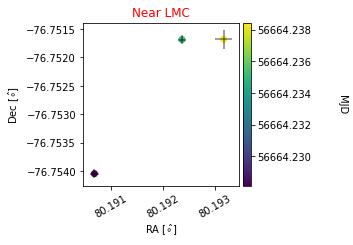

v_ra =  -122.80676136874085 , v_dec =  -230.92752979618658


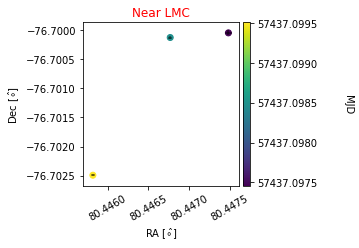

v_ra =  -16.986576817360483 , v_dec =  8.32605074783518


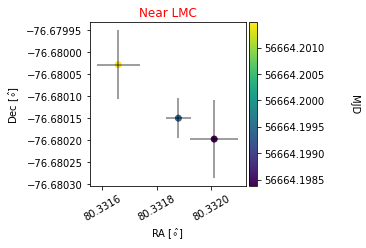

v_ra =  -152.57841417508004 , v_dec =  -2.5797821491129445


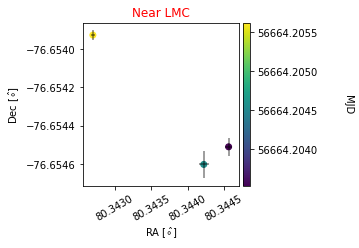

v_ra =  -21.219282862730235 , v_dec =  1.7943867481926405


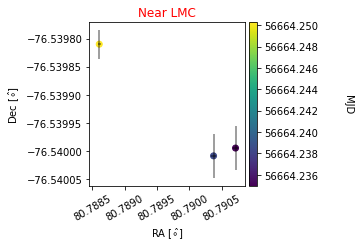

v_ra =  25.78639623654161 , v_dec =  3.141938410930884


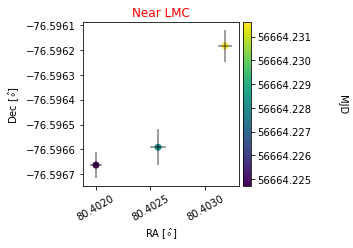

v_ra =  17.581533262865868 , v_dec =  -2.9008248029690455


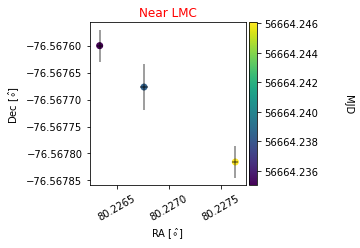

In [10]:
for i in np.unique(t_mmts['pix']):
    tx=t_mmts['pix']==i
    ptests=t_mmts[tx]
    for cl in np.unique(ptests['cluster_label']):
        clu=ptests['cluster_label']==cl
        clus=ptests[clu]
        print("v_ra = ",clus['v_ra'][0]*3600/24,", v_dec = ",clus['v_dec'][0]*3600/24)
        if np.mean(clus['ra'])>90:
            ptitle="From Galactic Plane"
            tcol="blue"
        else:
            ptitle="Near LMC"
            tcol="red"
        
        plt.figure(figsize=(3,3))
        #plt.subplots_adjust(wspace=0.5)
        plt.title(ptitle,color=tcol)
        plt.errorbar(clus['ra'],clus['dec'],xerr=clus['raerr']/3600,yerr=clus['decerr']/3600,c="k",alpha=0.5,fmt="none")
        tplt=plt.scatter(clus['ra'],clus['dec'],c=clus['mjd'])
        cbar(tplt,title="MJD")
        plt.xlabel("RA [$\^{\circ}$]")
        plt.ylabel("Dec [$\^{\circ}$]")
        plt.ticklabel_format(axis='both',useOffset=False)
        plt.tick_params(axis="x",rotation=30)
        plt.show()